In [1]:
import tensorflow as tf;
import numpy as np;
import matplotlib.pyplot as plt;
print(tf.__version__);
import pandas as pd;

from sklearn.metrics import mean_squared_error;

2.6.0


In [2]:
from constants import *;
from NN_predict_v1 import *;

In [3]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

get_available_gpus()

['/device:GPU:0']

### The goal of this file:
Try to set up the environment so that all the zip codes are fed into the data

#### Reading the zri csv file

In [4]:
multi_data = pd.read_csv('../data/zri_multifamily_v2.csv');
# multi_data = multi_data[multi_data["State"] == "NY"];
multi_data.head()

,zip,City,State,Metro,CountyName,year-month,zri
0,1013,Chicopee,MA,Springfield,Hampden County,2014-01,928.0
1,1013,Chicopee,MA,Springfield,Hampden County,2014-02,931.0
2,1013,Chicopee,MA,Springfield,Hampden County,2014-03,934.0
3,1013,Chicopee,MA,Springfield,Hampden County,2014-04,929.0
4,1013,Chicopee,MA,Springfield,Hampden County,2014-05,929.0


In [5]:
# In our first try, just look at the zip codes in NY.
multi_NY = multi_data[multi_data["State"] == "NY"];

#### Segmenting the csv file into tens of thousands of windows

In [6]:
@tf.autograph.experimental.do_not_convert
def windowed_dataset(series, window_size, batch_size, shuffle_buffer):
    series = tf.expand_dims(series, axis=-1)
    dataset = tf.data.Dataset.from_tensor_slices(series)
    dataset = dataset.window(window_size + 1, shift=1, drop_remainder=True)
    dataset = dataset.flat_map(lambda window: window.batch(window_size + 1))
    dataset = dataset.shuffle(shuffle_buffer).map(lambda window: (window[:-1], window[-1]))
    dataset = dataset.batch(batch_size).prefetch(1)
    return dataset

In [ ]:
# test_NY = multi_data[multi_data["zip"] == 10001];

# single_city_series = np.array(test_NY["zri"])

In [7]:
cities_stats = {};
dataset = windowed_dataset(np.zeros(1), WINDOW_SIZE, BATCH_SIZE, 60);
validset = windowed_dataset(np.zeros(1), WINDOW_SIZE, BATCH_SIZE, 60);

dataset_created = False;
for zip_num in multi_data["zip"].unique():
    test = multi_data[multi_data["zip"] == zip_num];
    single_city_series = np.array(test["zri"]);
    
    single_city_series_mean = single_city_series.mean();
    single_city_series_std = single_city_series.std();
    single_city_series = (single_city_series - single_city_series_mean)/\
    single_city_series_std;
    
    cities_stats[zip_num] = {"mean": single_city_series_mean,
                             "std":single_city_series_std};
    
    single_city_train = single_city_series[:SPLIT];
    single_city_test = single_city_series[SPLIT-WINDOW_SIZE:];
    
    cityset = windowed_dataset(single_city_train, WINDOW_SIZE, BATCH_SIZE, 60);
    cityvalid = windowed_dataset(single_city_test, WINDOW_SIZE, BATCH_SIZE, 60);
    
    dataset = dataset.concatenate(cityset);
    validset = validset.concatenate(cityvalid);

In [ ]:
# i = 0
# for x,y in dataset:
#     i += 1;
# #     print("x = ", x.numpy())
# #     print("y = ", y.numpy())
# i

In [ ]:
# Concatenate tensorflow dataset
# cities_stats

#### Messing up with the Tensorflow models

In [8]:
tf.keras.backend.clear_session()
# dataset = windowed_dataset(x_train, window_size, batch_size, shuffle_buffer_size)

model = tf.keras.models.Sequential([
#     tf.keras.layers.Lambda(lambda x: tf.expand_dims(x, axis=-1),
#                       input_shape=[None]),
    tf.keras.layers.Conv1D(filters=128, kernel_size=5,
                      strides=1, padding="causal",
                      activation="relu",
                      input_shape=[None, 1]),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64, return_sequences=True)),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64, return_sequences=False)),
    #  tf.keras.layers.SimpleRNN(16, return_sequences=True),
    #  tf.keras.layers.SimpleRNN(16, return_sequences=True),
    tf.keras.layers.Dense(64, activation="relu"),
    tf.keras.layers.Dense(32, activation="relu"),
    tf.keras.layers.Dense(8, activation="relu"),
#   tf.keras.layers.Dense(16, activation="relu"),
    tf.keras.layers.Dense(1),
    tf.keras.layers.Lambda(lambda x: x * 2.0)
])

model.summary();

cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath="./tensorflow_ckpt/{epoch:03d}_{mse:.4f}_{val_mse:.4f}",\
                                                 save_best_only=False,\
                                                 save_weights_only=False, verbose=1,\
                                                 save_freq="epoch");

optimizer = tf.keras.optimizers.SGD(learning_rate=3e-4, momentum=0.9)
model.compile(loss=tf.keras.losses.Huber(),
              optimizer="adam",
              metrics=["mae", "mse"])
with tf.device(tf.DeviceSpec(device_type="GPU", device_index=0)):
    history = model.fit(dataset, epochs=50, validation_data=validset,\
                    callbacks=[cp_callback])

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d (Conv1D)              (None, None, 128)         768       
_________________________________________________________________
bidirectional (Bidirectional (None, None, 128)         98816     
_________________________________________________________________
bidirectional_1 (Bidirection (None, 128)               98816     
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dense_1 (Dense)              (None, 32)                2080      
_________________________________________________________________
dense_2 (Dense)              (None, 8)                 264       
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 9

INFO:tensorflow:Assets written to: ./tensorflow_ckpt\001_0.0320_0.0353\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\001_0.0320_0.0353\assets


Epoch 2/50
2604/2604 [==============================] - 263s 101ms/step - loss: 0.0100 - mae: 0.1002 - mse: 0.0200 - val_loss: 0.0189 - val_mae: 0.1304 - val_mse: 0.0380s: 0.0101 - mae: 0.101

Epoch 00002: saving model to ./tensorflow_ckpt\002_0.0200_0.0380


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\002_0.0200_0.0380\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\002_0.0200_0.0380\assets


Epoch 3/50
2604/2604 [==============================] - 263s 101ms/step - loss: 0.0098 - mae: 0.0989 - mse: 0.0196 - val_loss: 0.0190 - val_mae: 0.1303 - val_mse: 0.0383

Epoch 00003: saving model to ./tensorflow_ckpt\003_0.0196_0.0383


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\003_0.0196_0.0383\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\003_0.0196_0.0383\assets


Epoch 4/50
2604/2604 [==============================] - 302s 116ms/step - loss: 0.0096 - mae: 0.0979 - mse: 0.0192 - val_loss: 0.0193 - val_mae: 0.1325 - val_mse: 0.0388

Epoch 00004: saving model to ./tensorflow_ckpt\004_0.0192_0.0388


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\004_0.0192_0.0388\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\004_0.0192_0.0388\assets


Epoch 5/50
2604/2604 [==============================] - 299s 115ms/step - loss: 0.0095 - mae: 0.0975 - mse: 0.0190 - val_loss: 0.0188 - val_mae: 0.1298 - val_mse: 0.0379

Epoch 00005: saving model to ./tensorflow_ckpt\005_0.0190_0.0379


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\005_0.0190_0.0379\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\005_0.0190_0.0379\assets


Epoch 6/50
2604/2604 [==============================] - 313s 120ms/step - loss: 0.0094 - mae: 0.0970 - mse: 0.0189 - val_loss: 0.0205 - val_mae: 0.1410 - val_mse: 0.0413

Epoch 00006: saving model to ./tensorflow_ckpt\006_0.0189_0.0413


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\006_0.0189_0.0413\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\006_0.0189_0.0413\assets


Epoch 7/50
2604/2604 [==============================] - 278s 107ms/step - loss: 0.0094 - mae: 0.0967 - mse: 0.0188 - val_loss: 0.0200 - val_mae: 0.1377 - val_mse: 0.0403

Epoch 00007: saving model to ./tensorflow_ckpt\007_0.0188_0.0403


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\007_0.0188_0.0403\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\007_0.0188_0.0403\assets


Epoch 8/50
2604/2604 [==============================] - 313s 120ms/step - loss: 0.0093 - mae: 0.0963 - mse: 0.0187 - val_loss: 0.0209 - val_mae: 0.1433 - val_mse: 0.0422

Epoch 00008: saving model to ./tensorflow_ckpt\008_0.0187_0.0422


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\008_0.0187_0.0422\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\008_0.0187_0.0422\assets


Epoch 9/50
2604/2604 [==============================] - 386s 148ms/step - loss: 0.0093 - mae: 0.0961 - mse: 0.0186 - val_loss: 0.0210 - val_mae: 0.1439 - val_mse: 0.0423

Epoch 00009: saving model to ./tensorflow_ckpt\009_0.0186_0.0423


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\009_0.0186_0.0423\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\009_0.0186_0.0423\assets


Epoch 10/50
2604/2604 [==============================] - 380s 146ms/step - loss: 0.0093 - mae: 0.0959 - mse: 0.0185 - val_loss: 0.0195 - val_mae: 0.1341 - val_mse: 0.0393

Epoch 00010: saving model to ./tensorflow_ckpt\010_0.0185_0.0393


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\010_0.0185_0.0393\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\010_0.0185_0.0393\assets


Epoch 11/50
2604/2604 [==============================] - 384s 147ms/step - loss: 0.0092 - mae: 0.0955 - mse: 0.0184 - val_loss: 0.0205 - val_mae: 0.1408 - val_mse: 0.0412

Epoch 00011: saving model to ./tensorflow_ckpt\011_0.0184_0.0412


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\011_0.0184_0.0412\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\011_0.0184_0.0412\assets


Epoch 12/50
2604/2604 [==============================] - 386s 148ms/step - loss: 0.0092 - mae: 0.0953 - mse: 0.0184 - val_loss: 0.0191 - val_mae: 0.1321 - val_mse: 0.0385

Epoch 00012: saving model to ./tensorflow_ckpt\012_0.0184_0.0385


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\012_0.0184_0.0385\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\012_0.0184_0.0385\assets


Epoch 13/50
2604/2604 [==============================] - 389s 149ms/step - loss: 0.0092 - mae: 0.0954 - mse: 0.0184 - val_loss: 0.0194 - val_mae: 0.1338 - val_mse: 0.0390

Epoch 00013: saving model to ./tensorflow_ckpt\013_0.0184_0.0390


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\013_0.0184_0.0390\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\013_0.0184_0.0390\assets


Epoch 14/50
2604/2604 [==============================] - 390s 150ms/step - loss: 0.0092 - mae: 0.0952 - mse: 0.0184 - val_loss: 0.0194 - val_mae: 0.1344 - val_mse: 0.0392

Epoch 00014: saving model to ./tensorflow_ckpt\014_0.0184_0.0392


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\014_0.0184_0.0392\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\014_0.0184_0.0392\assets


Epoch 15/50
2604/2604 [==============================] - 379s 146ms/step - loss: 0.0091 - mae: 0.0949 - mse: 0.0183 - val_loss: 0.0194 - val_mae: 0.1331 - val_mse: 0.0390

Epoch 00015: saving model to ./tensorflow_ckpt\015_0.0183_0.0390


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\015_0.0183_0.0390\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\015_0.0183_0.0390\assets


Epoch 16/50
2604/2604 [==============================] - 373s 143ms/step - loss: 0.0091 - mae: 0.0948 - mse: 0.0182 - val_loss: 0.0190 - val_mae: 0.1312 - val_mse: 0.0383

Epoch 00016: saving model to ./tensorflow_ckpt\016_0.0182_0.0383


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\016_0.0182_0.0383\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\016_0.0182_0.0383\assets


Epoch 17/50
2604/2604 [==============================] - 373s 143ms/step - loss: 0.0091 - mae: 0.0948 - mse: 0.0182 - val_loss: 0.0191 - val_mae: 0.1313 - val_mse: 0.0384

Epoch 00017: saving model to ./tensorflow_ckpt\017_0.0182_0.0384


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\017_0.0182_0.0384\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\017_0.0182_0.0384\assets


Epoch 18/50
2604/2604 [==============================] - 372s 143ms/step - loss: 0.0091 - mae: 0.0948 - mse: 0.0182 - val_loss: 0.0194 - val_mae: 0.1337 - val_mse: 0.0390

Epoch 00018: saving model to ./tensorflow_ckpt\018_0.0182_0.0390


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\018_0.0182_0.0390\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\018_0.0182_0.0390\assets


Epoch 19/50
2604/2604 [==============================] - 375s 144ms/step - loss: 0.0091 - mae: 0.0946 - mse: 0.0181 - val_loss: 0.0189 - val_mae: 0.1299 - val_mse: 0.0381

Epoch 00019: saving model to ./tensorflow_ckpt\019_0.0181_0.0381


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\019_0.0181_0.0381\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\019_0.0181_0.0381\assets


Epoch 20/50
2604/2604 [==============================] - 370s 142ms/step - loss: 0.0091 - mae: 0.0945 - mse: 0.0181 - val_loss: 0.0201 - val_mae: 0.1384 - val_mse: 0.0405

Epoch 00020: saving model to ./tensorflow_ckpt\020_0.0181_0.0405


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\020_0.0181_0.0405\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\020_0.0181_0.0405\assets


Epoch 21/50
2604/2604 [==============================] - 375s 144ms/step - loss: 0.0090 - mae: 0.0945 - mse: 0.0181 - val_loss: 0.0206 - val_mae: 0.1412 - val_mse: 0.0414

Epoch 00021: saving model to ./tensorflow_ckpt\021_0.0181_0.0414


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\021_0.0181_0.0414\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\021_0.0181_0.0414\assets


Epoch 22/50
2604/2604 [==============================] - 372s 143ms/step - loss: 0.0090 - mae: 0.0943 - mse: 0.0180 - val_loss: 0.0198 - val_mae: 0.1360 - val_mse: 0.0399

Epoch 00022: saving model to ./tensorflow_ckpt\022_0.0180_0.0399


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\022_0.0180_0.0399\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\022_0.0180_0.0399\assets


Epoch 23/50
2604/2604 [==============================] - 375s 144ms/step - loss: 0.0090 - mae: 0.0943 - mse: 0.0180 - val_loss: 0.0192 - val_mae: 0.1319 - val_mse: 0.0387

Epoch 00023: saving model to ./tensorflow_ckpt\023_0.0180_0.0387


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\023_0.0180_0.0387\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\023_0.0180_0.0387\assets


Epoch 24/50
2604/2604 [==============================] - 372s 143ms/step - loss: 0.0090 - mae: 0.0941 - mse: 0.0180 - val_loss: 0.0194 - val_mae: 0.1333 - val_mse: 0.0390

Epoch 00024: saving model to ./tensorflow_ckpt\024_0.0180_0.0390


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\024_0.0180_0.0390\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\024_0.0180_0.0390\assets


Epoch 25/50
2604/2604 [==============================] - 371s 143ms/step - loss: 0.0090 - mae: 0.0941 - mse: 0.0179 - val_loss: 0.0195 - val_mae: 0.1343 - val_mse: 0.0393

Epoch 00025: saving model to ./tensorflow_ckpt\025_0.0179_0.0393


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\025_0.0179_0.0393\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\025_0.0179_0.0393\assets


Epoch 26/50
2604/2604 [==============================] - 373s 143ms/step - loss: 0.0090 - mae: 0.0941 - mse: 0.0180 - val_loss: 0.0193 - val_mae: 0.1328 - val_mse: 0.0389

Epoch 00026: saving model to ./tensorflow_ckpt\026_0.0180_0.0389


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\026_0.0180_0.0389\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\026_0.0180_0.0389\assets


Epoch 27/50
2604/2604 [==============================] - 375s 144ms/step - loss: 0.0089 - mae: 0.0939 - mse: 0.0179 - val_loss: 0.0205 - val_mae: 0.1411 - val_mse: 0.0414

Epoch 00027: saving model to ./tensorflow_ckpt\027_0.0179_0.0414


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\027_0.0179_0.0414\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\027_0.0179_0.0414\assets


Epoch 28/50
2604/2604 [==============================] - 380s 146ms/step - loss: 0.0089 - mae: 0.0937 - mse: 0.0178 - val_loss: 0.0201 - val_mae: 0.1378 - val_mse: 0.0404

Epoch 00028: saving model to ./tensorflow_ckpt\028_0.0178_0.0404


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\028_0.0178_0.0404\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\028_0.0178_0.0404\assets


Epoch 29/50
2604/2604 [==============================] - 368s 141ms/step - loss: 0.0089 - mae: 0.0938 - mse: 0.0178 - val_loss: 0.0194 - val_mae: 0.1334 - val_mse: 0.0391

Epoch 00029: saving model to ./tensorflow_ckpt\029_0.0178_0.0391


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\029_0.0178_0.0391\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\029_0.0178_0.0391\assets


Epoch 30/50
2604/2604 [==============================] - 376s 144ms/step - loss: 0.0089 - mae: 0.0936 - mse: 0.0177 - val_loss: 0.0197 - val_mae: 0.1347 - val_mse: 0.0396

Epoch 00030: saving model to ./tensorflow_ckpt\030_0.0177_0.0396


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\030_0.0177_0.0396\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\030_0.0177_0.0396\assets


Epoch 31/50
2604/2604 [==============================] - 376s 145ms/step - loss: 0.0089 - mae: 0.0937 - mse: 0.0177 - val_loss: 0.0197 - val_mae: 0.1350 - val_mse: 0.0396

Epoch 00031: saving model to ./tensorflow_ckpt\031_0.0177_0.0396


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\031_0.0177_0.0396\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\031_0.0177_0.0396\assets


Epoch 32/50
2604/2604 [==============================] - 372s 143ms/step - loss: 0.0088 - mae: 0.0935 - mse: 0.0177 - val_loss: 0.0205 - val_mae: 0.1407 - val_mse: 0.0414

Epoch 00032: saving model to ./tensorflow_ckpt\032_0.0177_0.0414


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\032_0.0177_0.0414\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\032_0.0177_0.0414\assets


Epoch 33/50
2604/2604 [==============================] - 376s 145ms/step - loss: 0.0088 - mae: 0.0934 - mse: 0.0176 - val_loss: 0.0190 - val_mae: 0.1308 - val_mse: 0.0383

Epoch 00033: saving model to ./tensorflow_ckpt\033_0.0176_0.0383


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\033_0.0176_0.0383\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\033_0.0176_0.0383\assets


Epoch 34/50
2604/2604 [==============================] - 378s 145ms/step - loss: 0.0088 - mae: 0.0932 - mse: 0.0176 - val_loss: 0.0212 - val_mae: 0.1451 - val_mse: 0.0427

Epoch 00034: saving model to ./tensorflow_ckpt\034_0.0176_0.0427


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\034_0.0176_0.0427\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\034_0.0176_0.0427\assets


Epoch 35/50
2604/2604 [==============================] - 373s 143ms/step - loss: 0.0087 - mae: 0.0931 - mse: 0.0175 - val_loss: 0.0209 - val_mae: 0.1427 - val_mse: 0.0421

Epoch 00035: saving model to ./tensorflow_ckpt\035_0.0175_0.0421


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\035_0.0175_0.0421\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\035_0.0175_0.0421\assets


Epoch 36/50
2604/2604 [==============================] - 372s 143ms/step - loss: 0.0087 - mae: 0.0931 - mse: 0.0175 - val_loss: 0.0194 - val_mae: 0.1322 - val_mse: 0.0390

Epoch 00036: saving model to ./tensorflow_ckpt\036_0.0175_0.0390


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\036_0.0175_0.0390\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\036_0.0175_0.0390\assets


Epoch 37/50
2604/2604 [==============================] - 374s 144ms/step - loss: 0.0087 - mae: 0.0930 - mse: 0.0174 - val_loss: 0.0214 - val_mae: 0.1457 - val_mse: 0.0430

Epoch 00037: saving model to ./tensorflow_ckpt\037_0.0174_0.0430


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\037_0.0174_0.0430\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\037_0.0174_0.0430\assets


Epoch 38/50
2604/2604 [==============================] - 373s 143ms/step - loss: 0.0087 - mae: 0.0931 - mse: 0.0174 - val_loss: 0.0231 - val_mae: 0.1552 - val_mse: 0.0465

Epoch 00038: saving model to ./tensorflow_ckpt\038_0.0174_0.0465


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\038_0.0174_0.0465\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\038_0.0174_0.0465\assets


Epoch 39/50
2604/2604 [==============================] - 382s 147ms/step - loss: 0.0087 - mae: 0.0930 - mse: 0.0175 - val_loss: 0.0205 - val_mae: 0.1410 - val_mse: 0.0413

Epoch 00039: saving model to ./tensorflow_ckpt\039_0.0175_0.0413


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\039_0.0175_0.0413\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\039_0.0175_0.0413\assets


Epoch 40/50
2604/2604 [==============================] - 372s 143ms/step - loss: 0.0087 - mae: 0.0928 - mse: 0.0173 - val_loss: 0.0210 - val_mae: 0.1429 - val_mse: 0.0423

Epoch 00040: saving model to ./tensorflow_ckpt\040_0.0173_0.0423


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\040_0.0173_0.0423\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\040_0.0173_0.0423\assets


Epoch 41/50
2604/2604 [==============================] - 373s 143ms/step - loss: 0.0086 - mae: 0.0926 - mse: 0.0172 - val_loss: 0.0198 - val_mae: 0.1340 - val_mse: 0.0399

Epoch 00041: saving model to ./tensorflow_ckpt\041_0.0172_0.0399


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\041_0.0172_0.0399\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\041_0.0172_0.0399\assets


Epoch 42/50
2604/2604 [==============================] - 372s 143ms/step - loss: 0.0085 - mae: 0.0924 - mse: 0.0171 - val_loss: 0.0201 - val_mae: 0.1364 - val_mse: 0.0404

Epoch 00042: saving model to ./tensorflow_ckpt\042_0.0171_0.0404


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\042_0.0171_0.0404\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\042_0.0171_0.0404\assets


Epoch 43/50
2604/2604 [==============================] - 374s 144ms/step - loss: 0.0085 - mae: 0.0922 - mse: 0.0170 - val_loss: 0.0203 - val_mae: 0.1371 - val_mse: 0.0409

Epoch 00043: saving model to ./tensorflow_ckpt\043_0.0170_0.0409


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\043_0.0170_0.0409\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\043_0.0170_0.0409\assets


Epoch 44/50
2604/2604 [==============================] - 381s 146ms/step - loss: 0.0085 - mae: 0.0922 - mse: 0.0170 - val_loss: 0.0207 - val_mae: 0.1412 - val_mse: 0.0417

Epoch 00044: saving model to ./tensorflow_ckpt\044_0.0170_0.0417


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\044_0.0170_0.0417\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\044_0.0170_0.0417\assets


Epoch 45/50
2604/2604 [==============================] - 372s 143ms/step - loss: 0.0085 - mae: 0.0921 - mse: 0.0170 - val_loss: 0.0207 - val_mae: 0.1390 - val_mse: 0.0419

Epoch 00045: saving model to ./tensorflow_ckpt\045_0.0170_0.0419


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\045_0.0170_0.0419\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\045_0.0170_0.0419\assets


Epoch 46/50
2604/2604 [==============================] - 372s 143ms/step - loss: 0.0084 - mae: 0.0918 - mse: 0.0168 - val_loss: 0.0205 - val_mae: 0.1388 - val_mse: 0.0412

Epoch 00046: saving model to ./tensorflow_ckpt\046_0.0168_0.0412


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\046_0.0168_0.0412\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\046_0.0168_0.0412\assets


Epoch 47/50
2604/2604 [==============================] - 387s 149ms/step - loss: 0.0083 - mae: 0.0916 - mse: 0.0167 - val_loss: 0.0211 - val_mae: 0.1433 - val_mse: 0.0425

Epoch 00047: saving model to ./tensorflow_ckpt\047_0.0167_0.0425


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\047_0.0167_0.0425\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\047_0.0167_0.0425\assets


Epoch 48/50
2604/2604 [==============================] - 338s 130ms/step - loss: 0.0083 - mae: 0.0915 - mse: 0.0166 - val_loss: 0.0208 - val_mae: 0.1409 - val_mse: 0.0418

Epoch 00048: saving model to ./tensorflow_ckpt\048_0.0166_0.0418


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\048_0.0166_0.0418\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\048_0.0166_0.0418\assets


Epoch 49/50
2604/2604 [==============================] - 269s 103ms/step - loss: 0.0082 - mae: 0.0912 - mse: 0.0165 - val_loss: 0.0211 - val_mae: 0.1433 - val_mse: 0.0425

Epoch 00049: saving model to ./tensorflow_ckpt\049_0.0165_0.0425


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\049_0.0165_0.0425\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\049_0.0165_0.0425\assets


Epoch 50/50
2604/2604 [==============================] - 268s 103ms/step - loss: 0.0082 - mae: 0.0912 - mse: 0.0165 - val_loss: 0.0195 - val_mae: 0.1312 - val_mse: 0.0392

Epoch 00050: saving model to ./tensorflow_ckpt\050_0.0165_0.0392


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\050_0.0165_0.0392\assets


INFO:tensorflow:Assets written to: ./tensorflow_ckpt\050_0.0165_0.0392\assets


#### Prediction, checking results

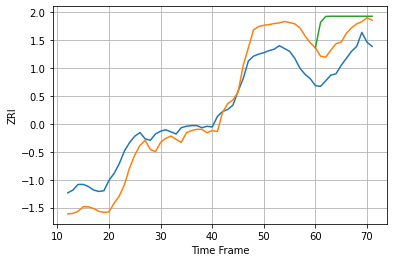

1013 30.47077009606191 36.973805279453 64.64185181721538


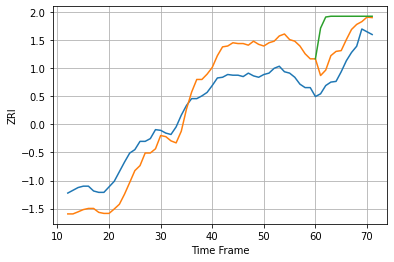

1020 36.870515930784556 32.57324544284746 68.84591558861362


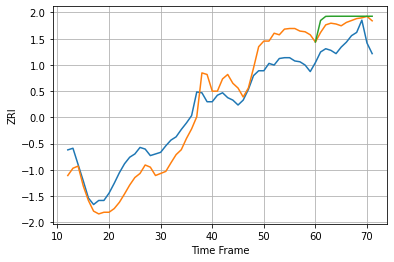

1040 26.699901825989127 27.514214491336386 34.33901093487757


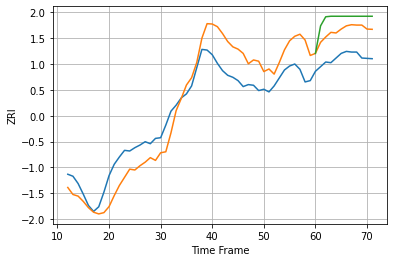

1085 34.96047083649771 40.35456544223681 59.02655812612368


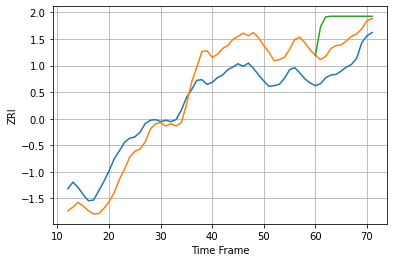

1104 36.18234894236828 35.94887058482623 69.6174953857057


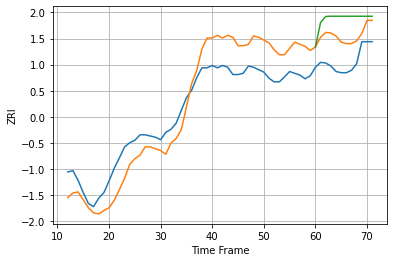

1108 39.61350265964223 43.25452367647171 72.22280945249791


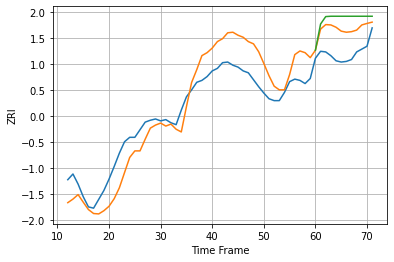

1109 34.898333058800326 39.71336559750725 55.88585645852981


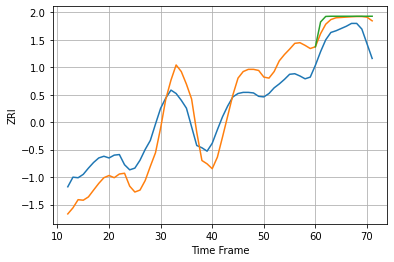

1420 41.11981009399342 31.568220738648243 37.1781384530747


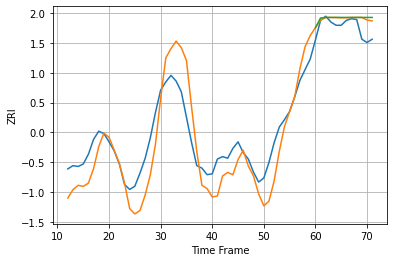

1440 30.3846980455199 14.148672672015667 15.310678059737958


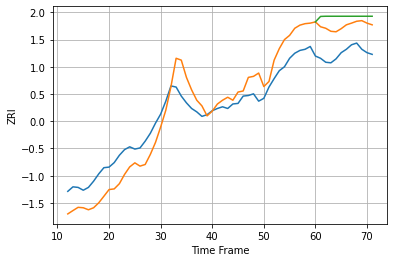

1453 35.893593810833885 50.49952581925663 66.45608616978112


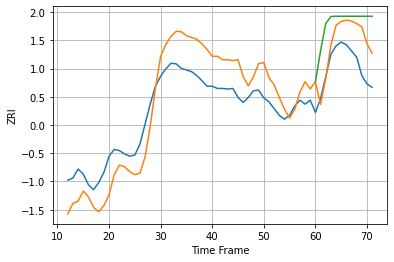

1545 46.547811333998986 50.74714908097298 82.94017330030516


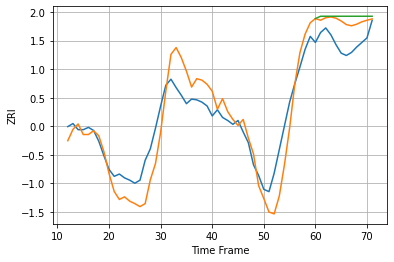

1550 28.506919445380664 28.7760581181389 34.722106155182765


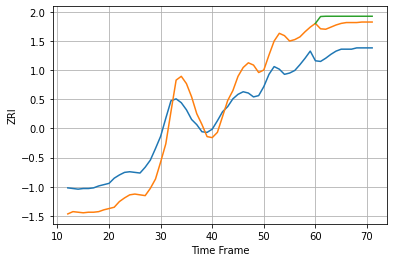

1602 36.989136738706115 43.51204219546259 54.99084579480797


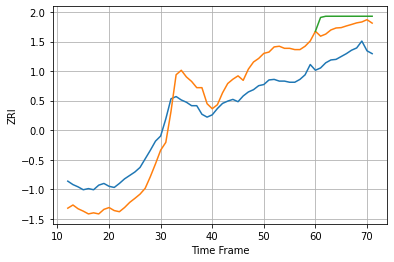

1603 43.49040502805802 51.485627224445324 68.48698645319308


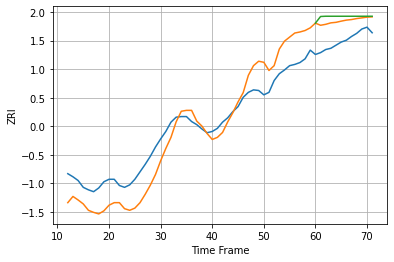

1604 34.19972364629809 34.03945186002753 40.947073951391104


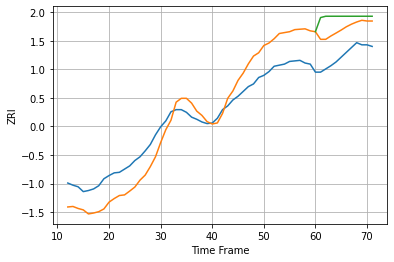

1605 41.632328883991434 52.48198607524725 74.52135237546489


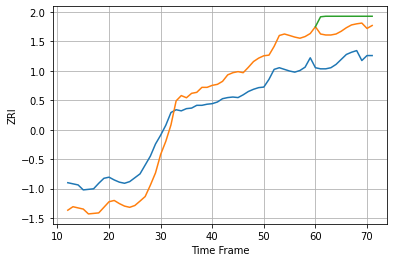

1610 44.49774786993914 57.31989377561405 79.14791730061829


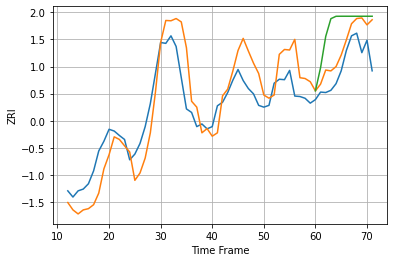

1702 58.5258772123611 50.85769864081002 99.2810491411372


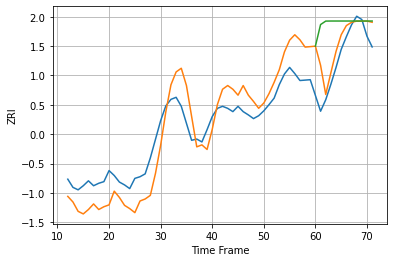

1752 58.294651371608985 55.4012832136474 109.85013344272767


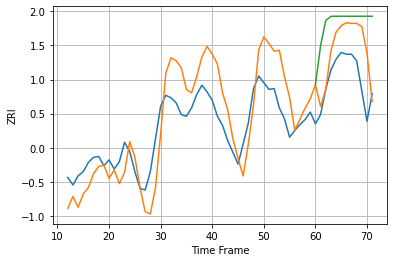

1757 35.82136926793614 43.02043113547328 72.65605870317427


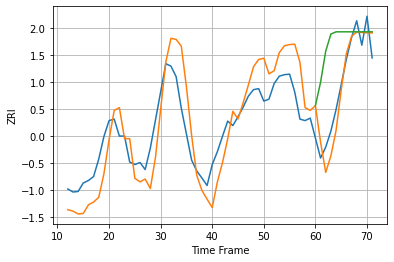

1760 55.96135561569918 37.67709095747725 110.1093155887237


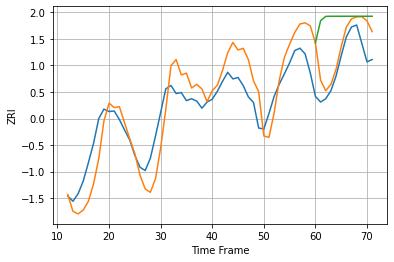

1801 51.009380526798545 51.018660876321036 109.7197097996949


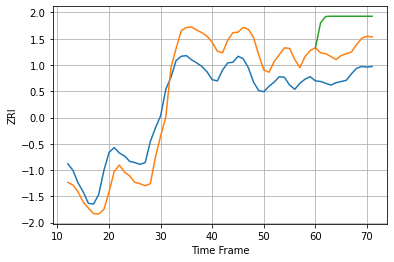

1830 43.818389078417 46.101317481437476 96.32682398885302


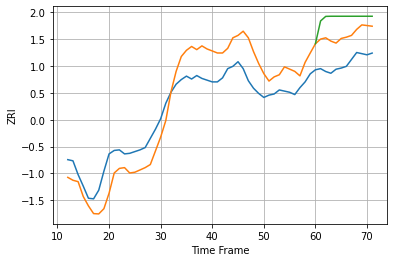

1832 41.87578635321819 49.22141049459008 78.70009154438235


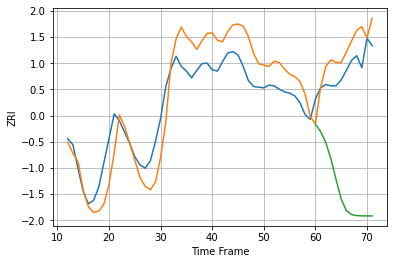

1841 38.91580392343605 34.059214513352124 185.66026363708193


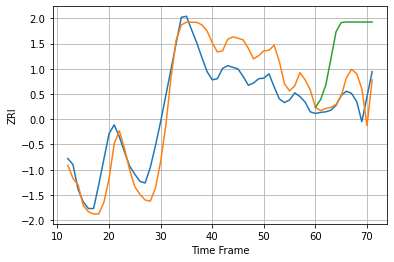

1843 46.159780797978826 31.77125928142992 116.94037922784497


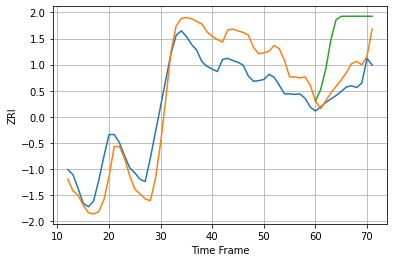

1844 45.710631522260215 29.277757472692105 100.64561354876628


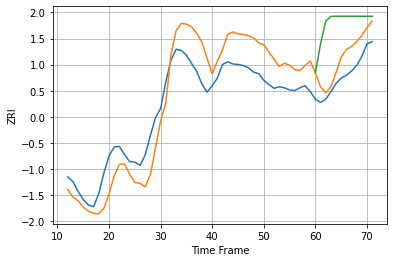

1845 47.64320264277456 35.71967858947804 101.21905530915897


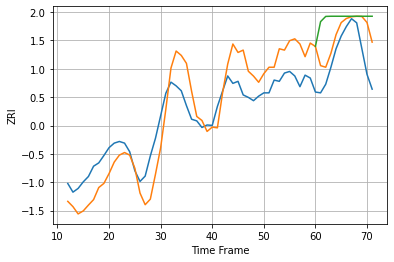

1850 63.03195358842722 69.06469487515909 112.30003934688705


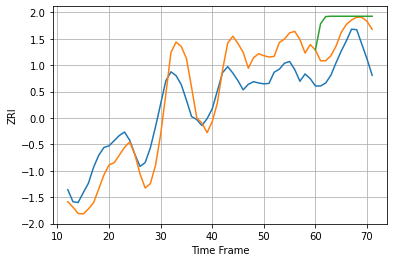

1851 59.77460806332008 60.81937759699831 102.8779824558487


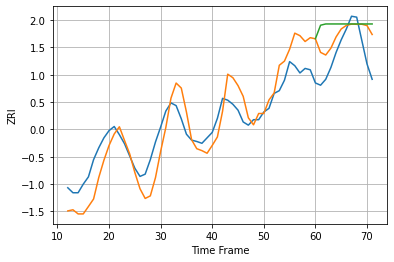

1852 46.89449599536985 57.692296868857596 82.08569090309476


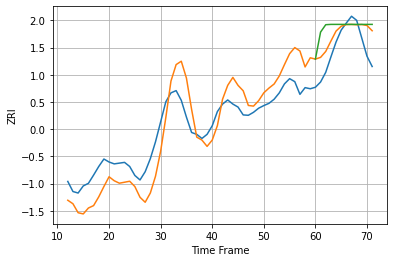

1854 60.73571659210644 53.09800327224761 77.33213152571156


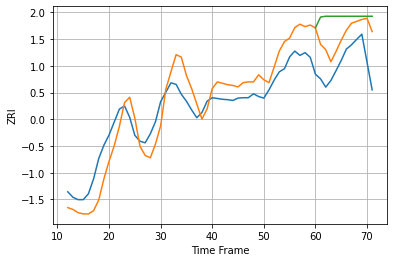

1876 52.77822550146374 82.46121126703139 128.16429913062208


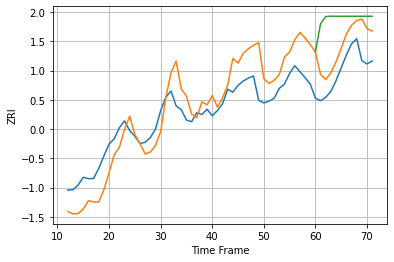

1880 57.006288890186646 64.7564948148673 128.12925507112115


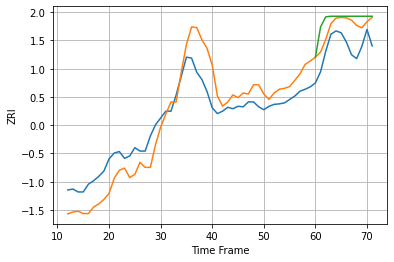

1902 45.40253329521138 45.252055620958075 61.035126581982325


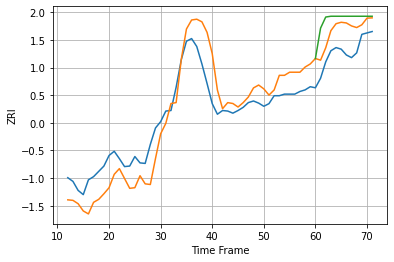

1905 42.84130299499262 43.139394118977876 64.62948356570138


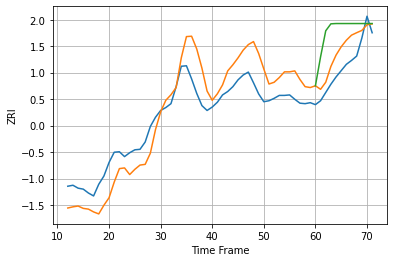

1915 48.60802595015916 37.27598433669677 82.45242965556575


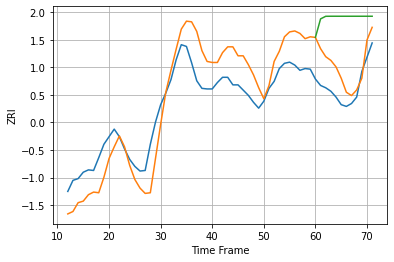

1930 46.07829948101269 42.97624952182165 120.39579508427731


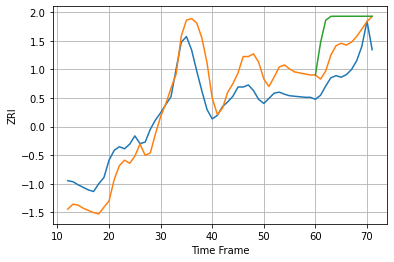

1960 47.72177642710297 47.80668927781207 95.49097937015856


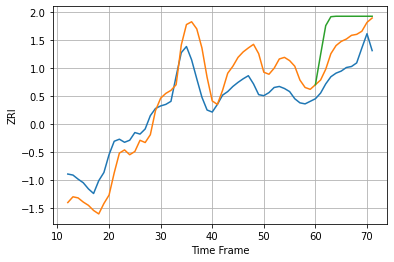

1970 48.17693079654534 46.57859708950486 88.65866014837016


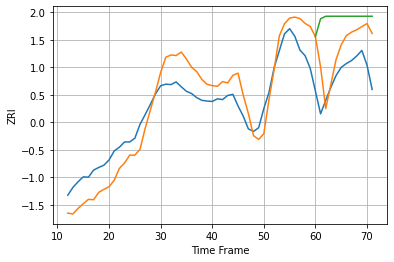

2026 59.681870611291735 90.04044427622642 163.10358642797607


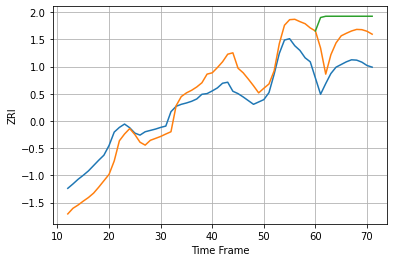

2062 60.36547455745701 94.90933766948596 158.7439992564618


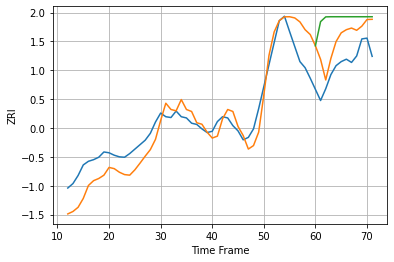

2072 46.723999552608255 71.009069795521 121.30688692979466


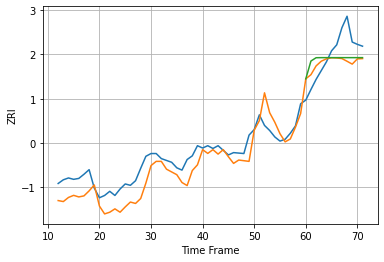

2111 34.17602656090621 44.30889063786084 45.555904034095626


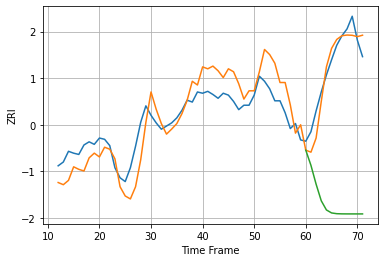

2113 32.99525256809012 22.546674140280988 227.99026312175187


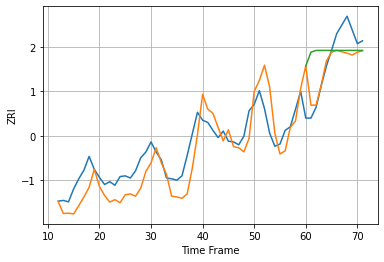

2114 28.059729074786006 31.216885373206267 48.0375552461441


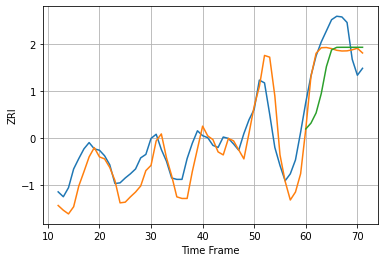

2115 31.60206277910836 32.325964455146284 50.808459880611665


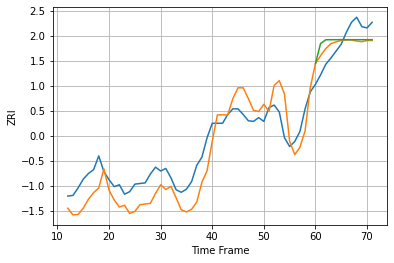

2116 33.521774425647486 25.245232953064832 29.02859842270017


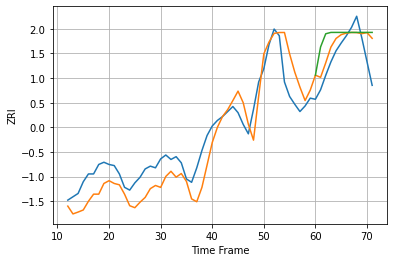

2118 38.6008062385631 35.54071611430095 50.34800492793778


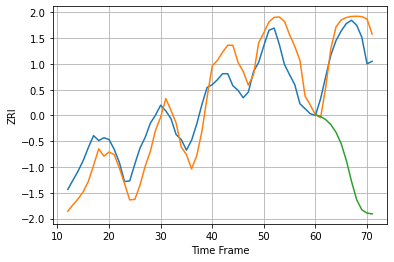

2119 67.3650569629548 52.46023079630967 344.92876403713876


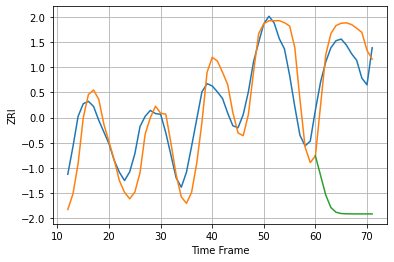

2120 65.2370512216794 70.10845571042671 369.56956490467155


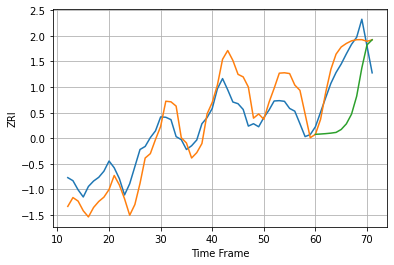

2121 66.34922184577078 43.51481755650421 144.69502164535342


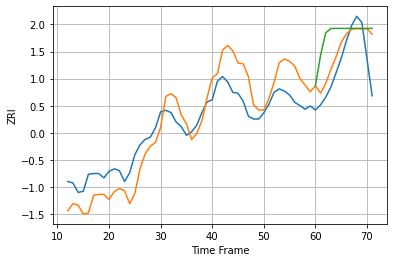

2122 64.17213915610955 65.08438968233222 110.5534281247142


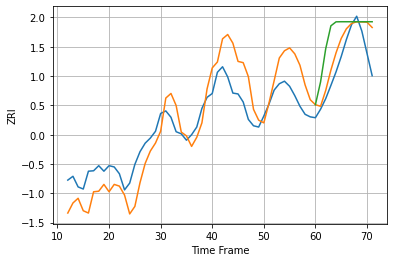

2124 60.46267410785245 46.62177720309309 83.39059374895116


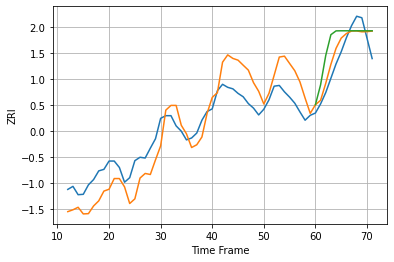

2125 59.67786769628377 34.565003168594735 61.652229360301


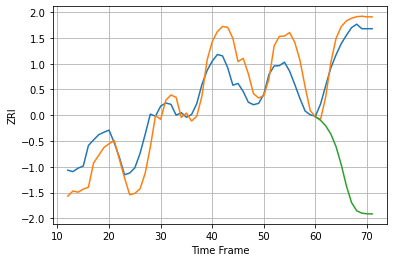

2126 67.74623682000137 34.563382266434076 388.3196608356878


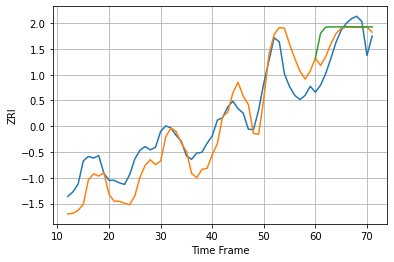

2127 52.6998956409849 39.487246531079215 64.00106291897643


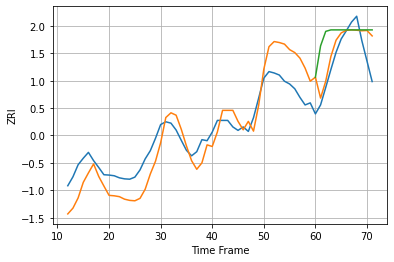

2128 62.850228619104094 60.31527155691548 99.85401219741425


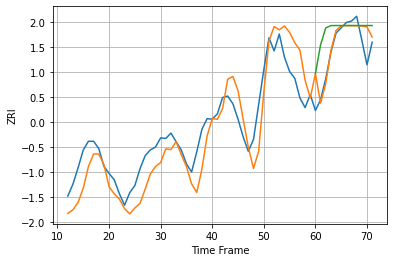

2129 49.37765768995674 33.93431181023095 59.74218764599944


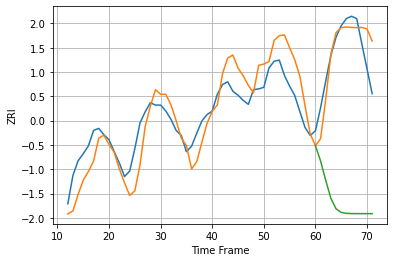

2130 56.97745641815231 58.66443110059364 384.5850196268898


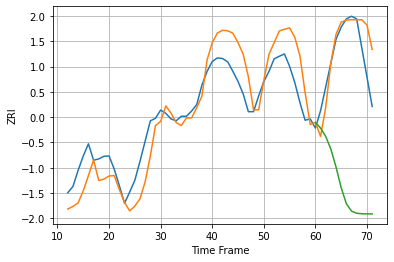

2131 74.14908088096188 78.45500910615051 412.81556215431874


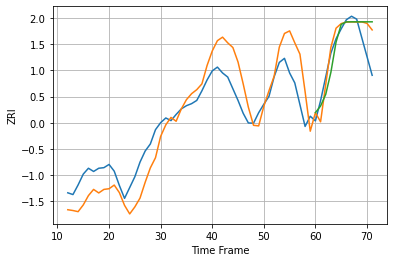

2132 81.9426303345981 64.0137307396682 71.00871692496793


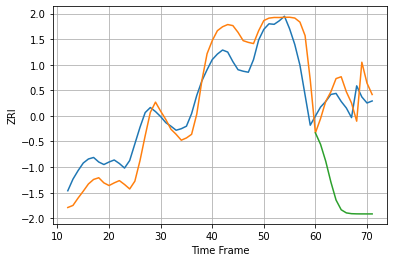

2134 46.760530571819324 38.90219150956487 191.0066475363321


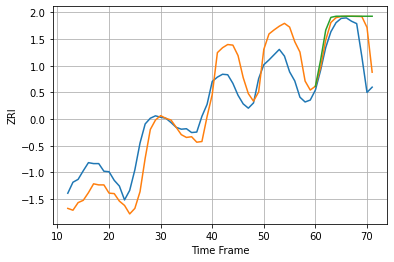

2135 50.35923803593469 48.05293048830586 69.45305689802468


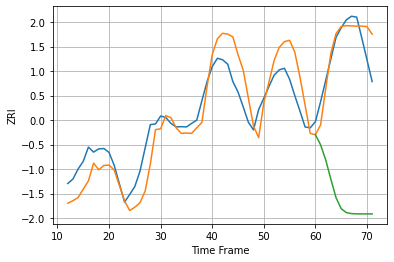

2136 77.89047913682433 65.60945023124431 505.18043108238123


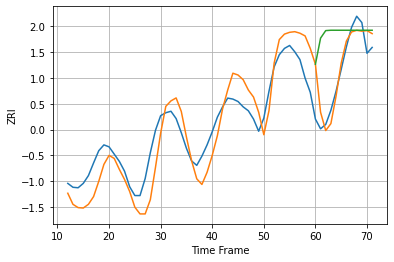

2138 45.73736763109788 40.11439218787796 107.71749924384194


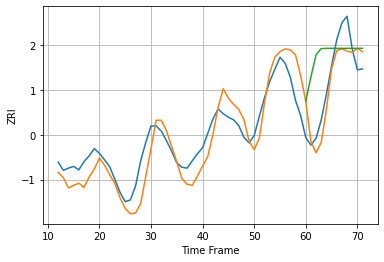

2139 43.81962561212978 47.24547277304064 100.80882635641309


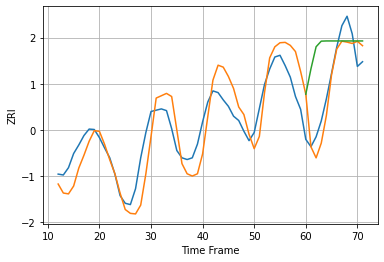

2140 52.0911688941695 48.30188358609393 114.49258366477707


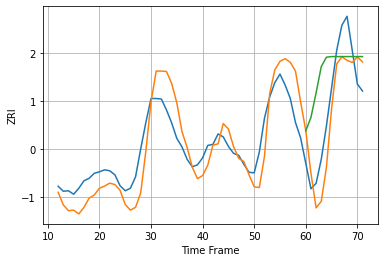

2141 45.96969799850565 59.81026950936343 105.62647237174428


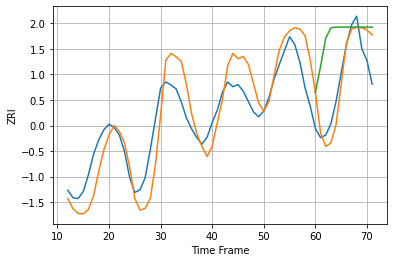

2143 58.53645741180737 53.19818076687377 129.12681703901725


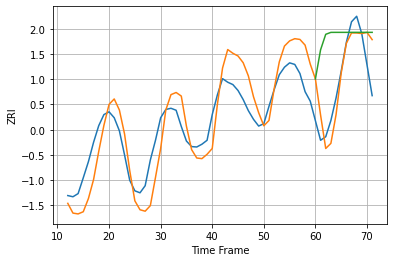

2144 62.14429286078023 65.04502057658146 145.30544246017297


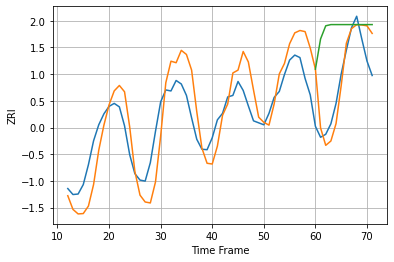

2145 54.04808709684256 50.661328538014736 127.073698667182


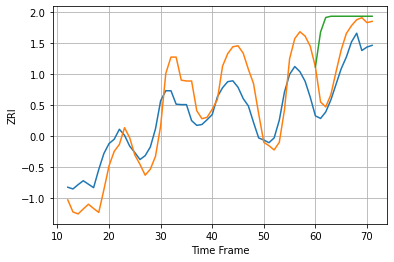

2148 61.65752506338387 53.721000666030484 131.3396223244462


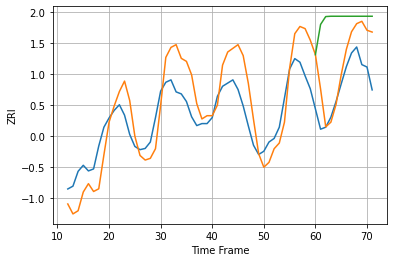

2149 69.64978016581584 80.60055512188599 181.16218005921212


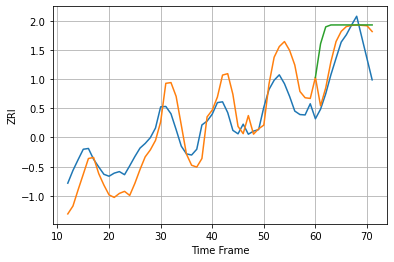

2150 60.053649221786905 58.16220975027489 102.78989295166126


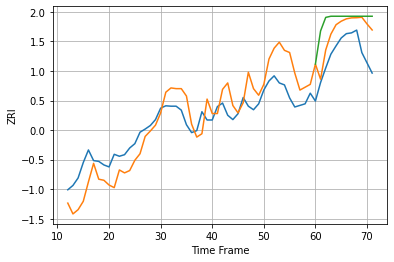

2151 55.193035962211695 65.69458703749238 95.09824914811355


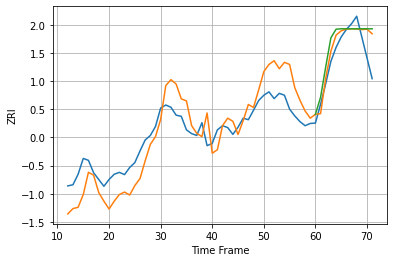

2152 58.38628648858553 45.851192587770704 53.99666526614039


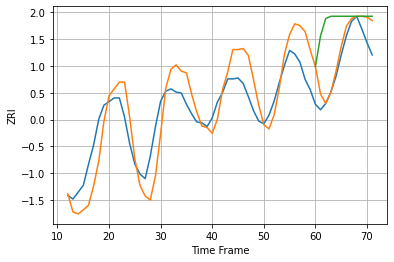

2155 56.131384864920086 39.49376187100583 105.94412832111213


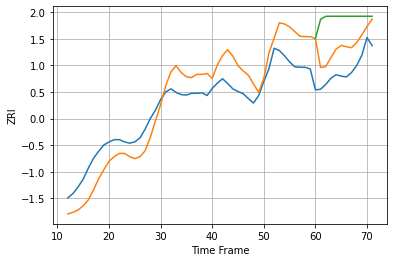

2169 50.74868673607167 61.076522573420874 122.52055954976926


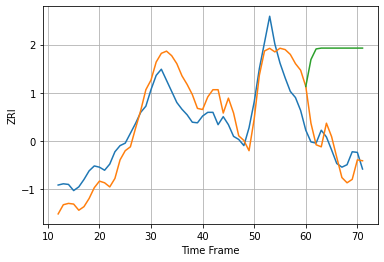

2170 36.544927316932664 30.628737709070254 162.28054268026457


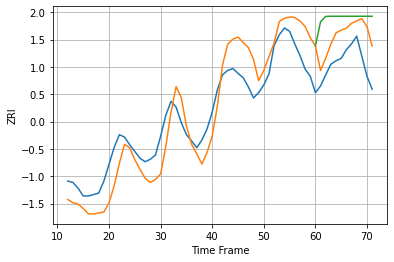

2171 49.91935372706113 64.20927195653319 101.08430078465415


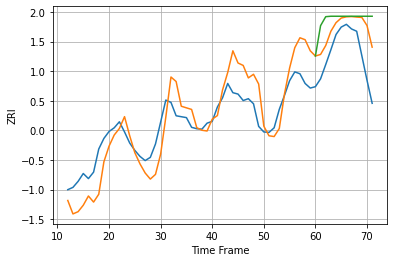

2176 50.02044771212979 63.997033811737666 91.23339337853493


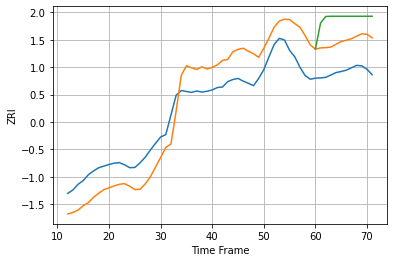

2184 94.71976338131117 114.93579321140543 198.87866115402431


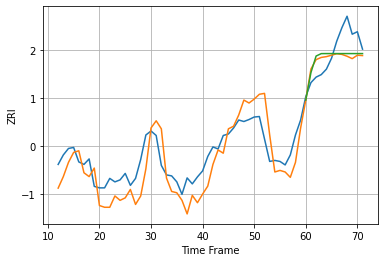

2210 40.9844003226545 39.33836418841033 38.162336286478826


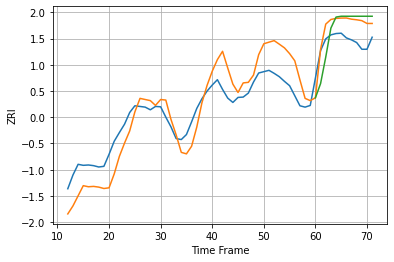

2215 64.43355645490834 56.740028339506146 70.94852015722986


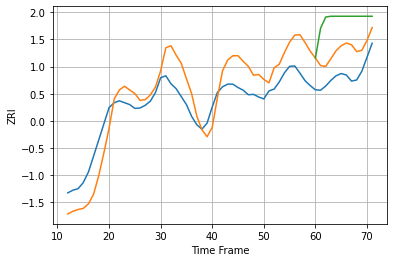

2301 62.4394055931621 68.09945537464587 147.9912448813193


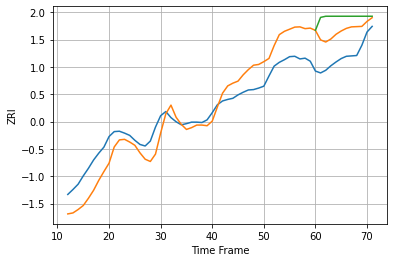

2302 52.32078643214846 71.52703520768657 107.6162048653161


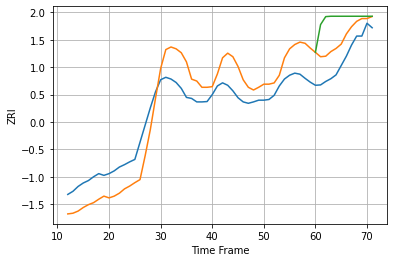

2360 70.80125952548134 64.03822882955124 123.80151071247283


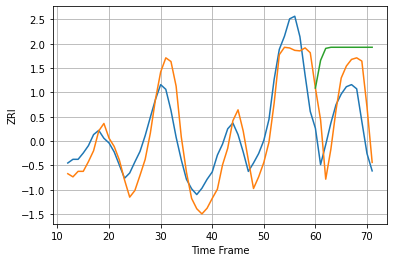

2445 44.408008810422864 64.21408350153744 144.88330192400434


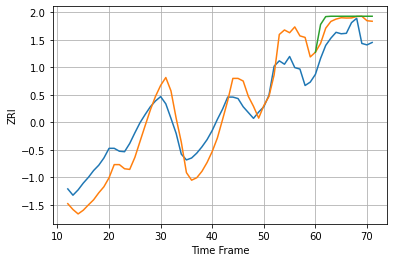

2446 45.90731785598068 36.58664358614827 46.63056225471841


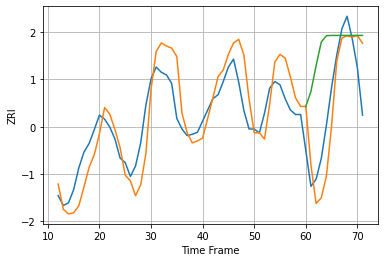

2451 38.3027972004468 54.18312887848027 103.88135118646177


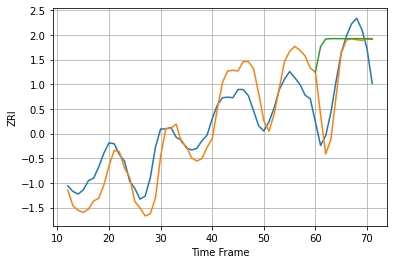

2453 43.47983604745504 49.06857524453299 100.53839364832612


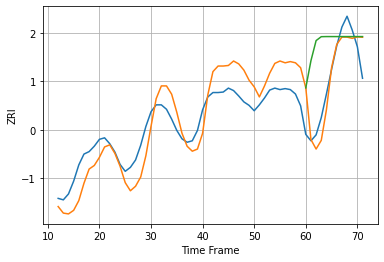

2458 44.80335397908654 43.5904430263884 103.04418678590868


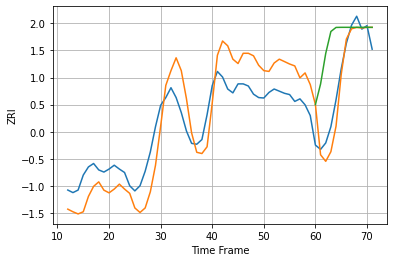

2460 64.51641019918272 42.637597198571484 118.38765289834129


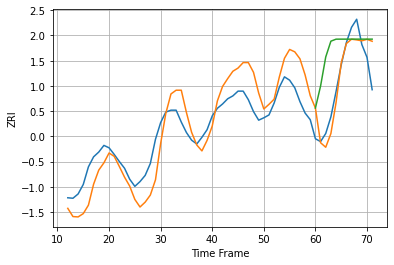

2472 48.08246015134087 41.95653976663324 90.91856936739673


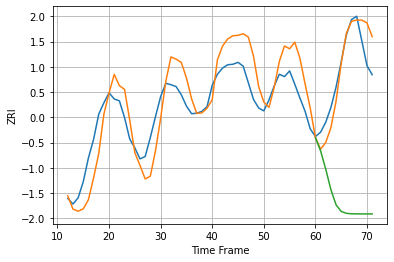

2474 52.5448535704884 43.144457310639254 288.27301805355887


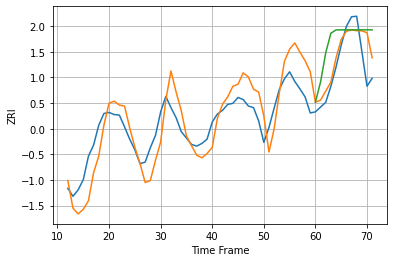

2476 42.48982602726588 36.241077993258756 63.795722033566314


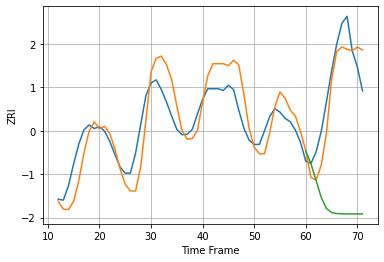

2478 49.21334588608243 55.050099161089044 295.0508678971512


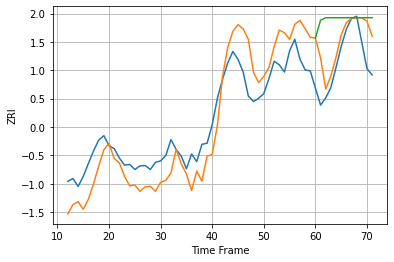

2494 72.26809869910862 78.47648697829031 141.04232937727562


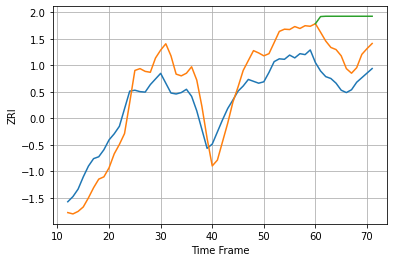

2703 50.73735935769161 62.81430380845758 133.9787888493377


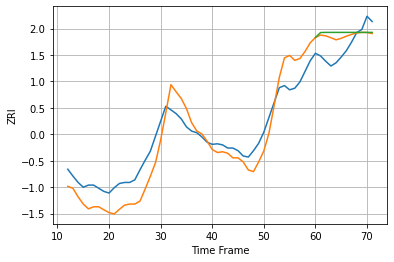

2721 36.03286187806227 33.14518892492538 38.972559907182095


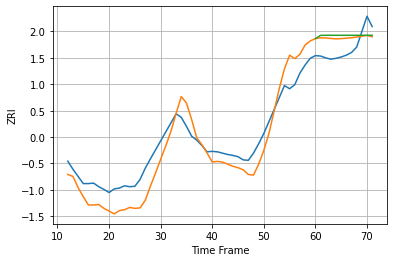

2723 40.23982646633347 36.85800208700671 41.23404729282036


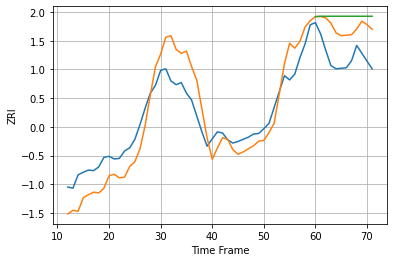

2740 42.54611740583523 58.298535828622796 78.93880468482706


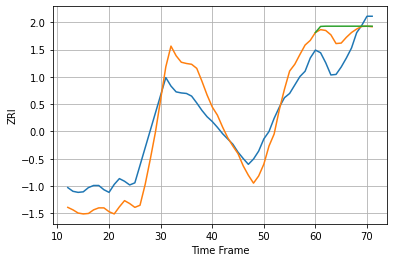

2746 43.16942263860831 41.967779109269074 55.76723933745217


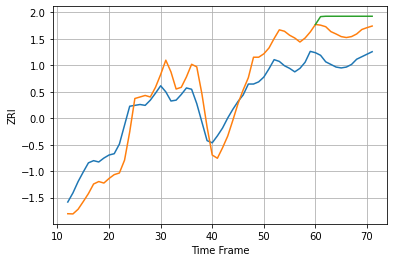

2780 51.67022534214167 67.87758073594753 100.61948345789017


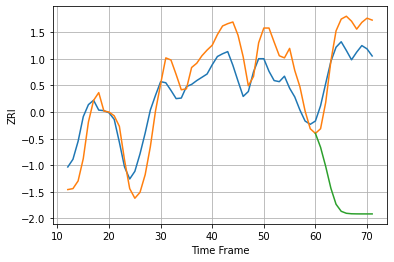

2840 46.920318528499166 46.573782375842896 256.061543098162


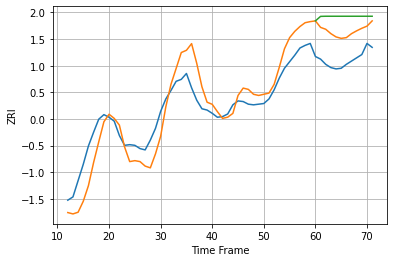

2860 30.000749545905332 45.19844731625835 66.65655736565132


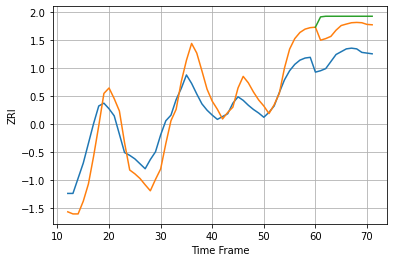

2861 31.31625676875756 41.48402109162949 57.38603971365264


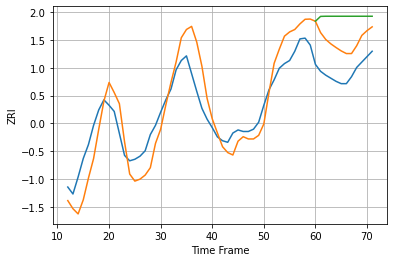

2863 29.695499776326187 40.85710836115194 71.73023124466378


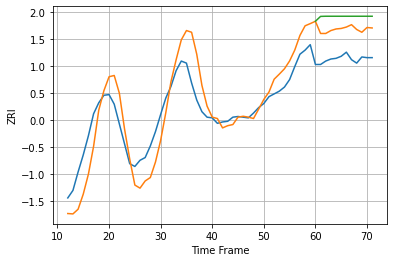

2864 32.21699576481079 45.09730763779441 62.366067439136


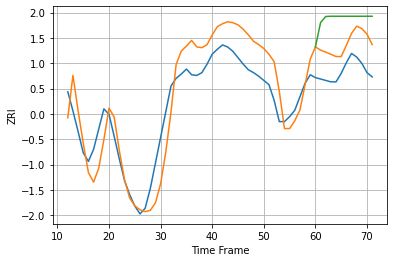

2891 35.6692140467263 39.921745995829674 75.35866169773655


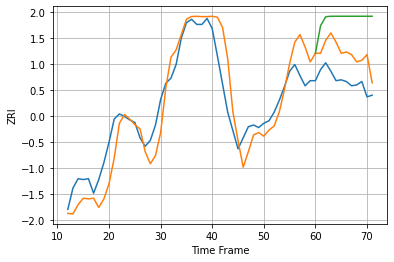

2893 27.05502726535843 33.794006385110954 73.28372282648121


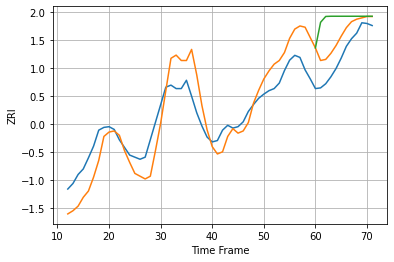

2895 33.472404013754975 31.02595879683492 59.675336073488666


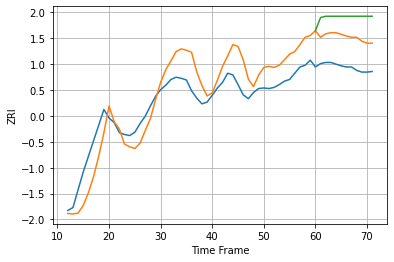

2904 38.45869724725597 53.96153855647392 87.96328804462796


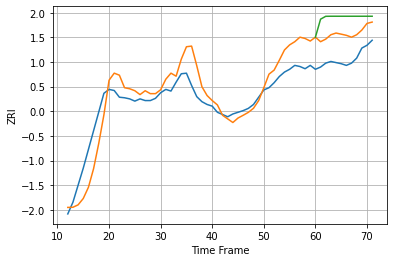

2905 32.83690067202346 46.1542968220438 74.49711973476587


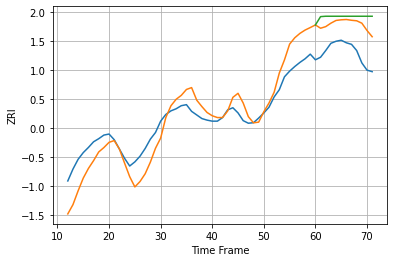

2906 34.50256526309892 56.73141846963189 72.56162401989205


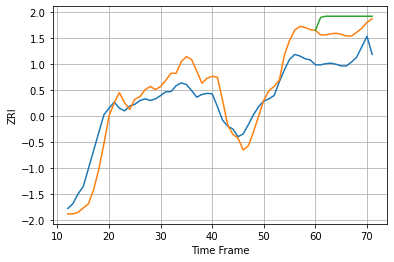

2907 34.752764790992444 51.926851897988634 77.49750798775771


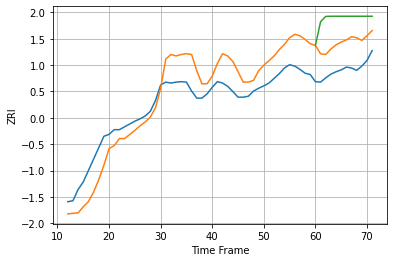

2908 48.08737466027172 58.90950401998387 109.433166576678


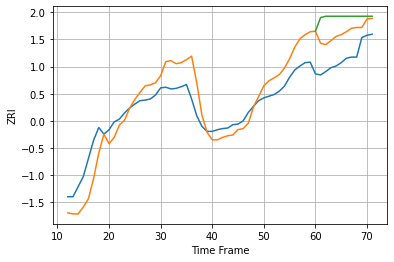

2909 35.432547028426704 48.9289535080884 76.11806973454328


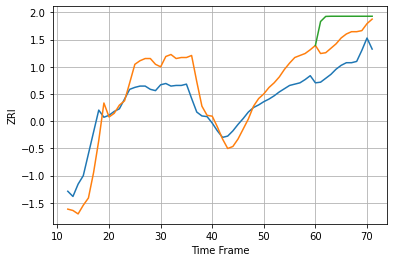

2910 33.65493574305216 42.45613809412931 72.49167711919432


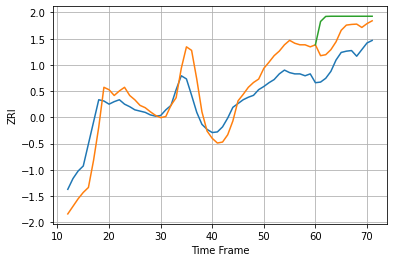

2914 32.99929855588517 39.97485002649017 67.277556058284


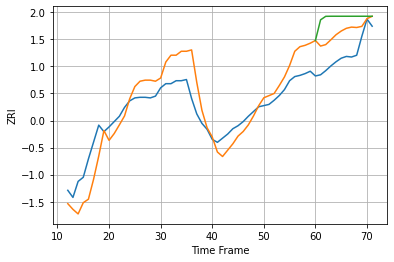

2920 34.330069048343184 42.38998425429432 66.87975297946295


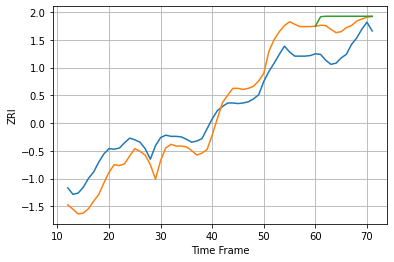

3038 33.44706160237943 42.27441523404907 57.27331314748068


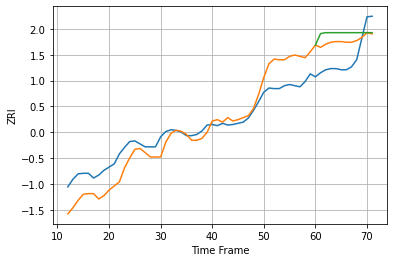

3060 30.226874207641295 40.53448853203261 53.09486214400403


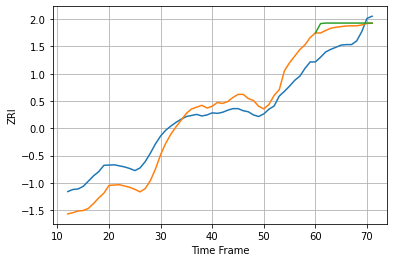

3102 34.668809276988064 35.28362019704633 42.403408068113684


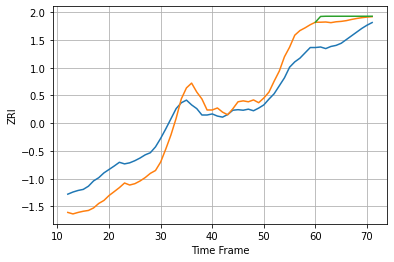

3103 35.226564739586046 36.825460654192966 44.00603310436313


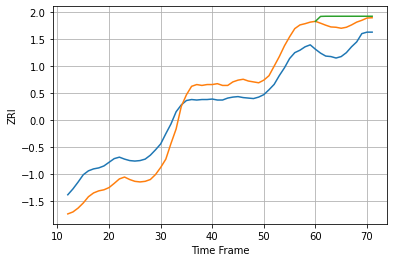

3104 40.984930827461945 50.68106121217724 65.92252494056365


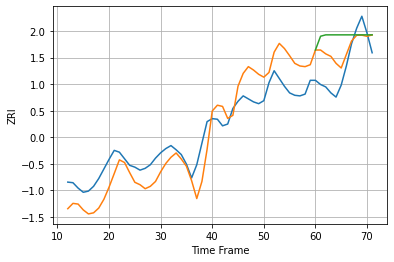

3301 37.70596183201367 39.870473769567155 63.74462541181456


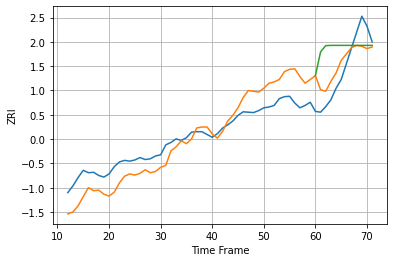

3820 45.27432512127828 49.540636881610574 92.75920981474206


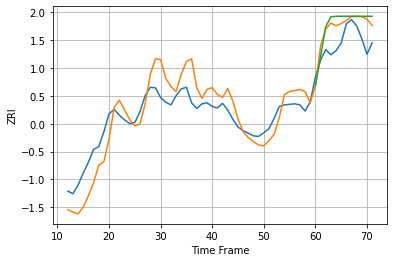

4101 37.051705994147746 38.83645058995621 46.01547289816937


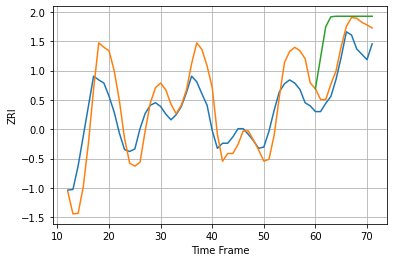

4102 42.28348693167651 31.49609289915473 74.99047828723008


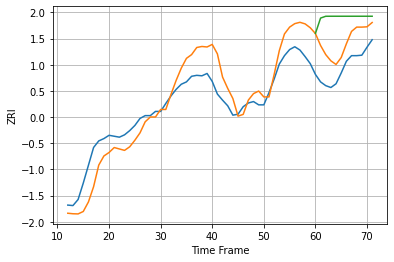

4103 43.098092233625856 56.785422198639864 109.50785450107459


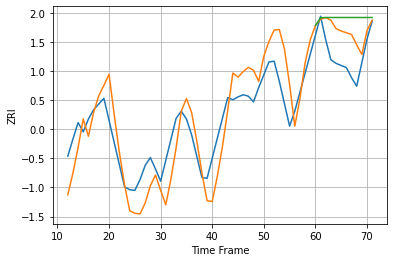

4210 37.865242955211656 39.40388996373786 57.419507218987356


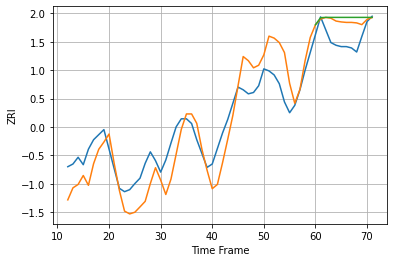

4240 36.175915498933236 27.970835831591074 32.82838154314635


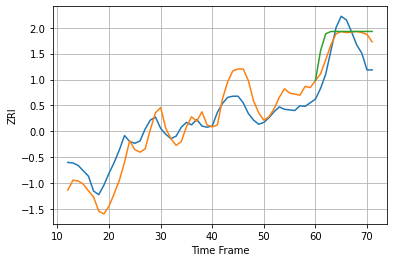

4401 29.262493231448268 30.196352204249866 42.64449280990615


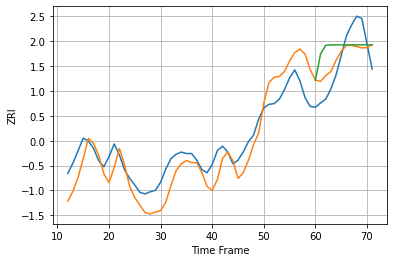

4901 27.167431894655497 28.28554403276499 42.30485516865599


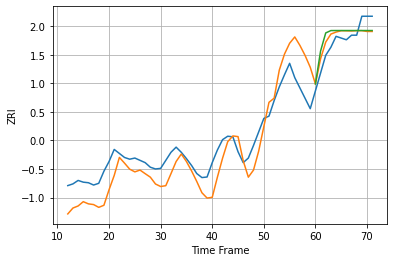

4937 37.31371216552152 19.225563075835137 23.27744773960161


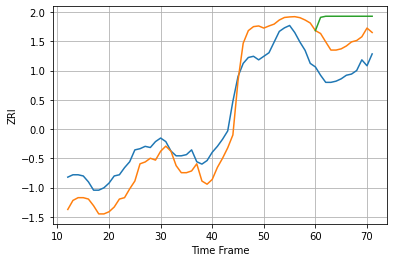

6010 18.978699058180084 27.579536106722276 46.91913292053733


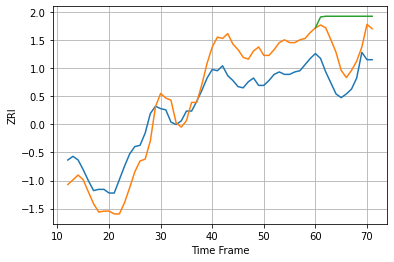

6040 20.32774377299219 24.97278774820602 48.83848714035634


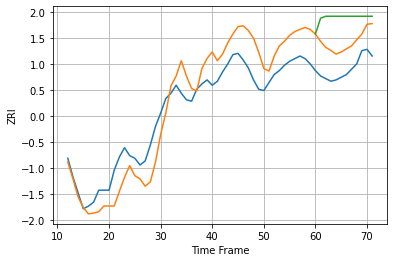

6051 17.919433939476168 21.188658641460453 39.416055907284225


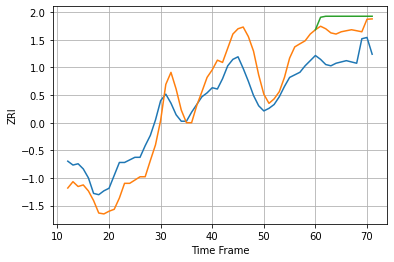

6053 18.07030066466633 22.95850189169156 31.828779225872367


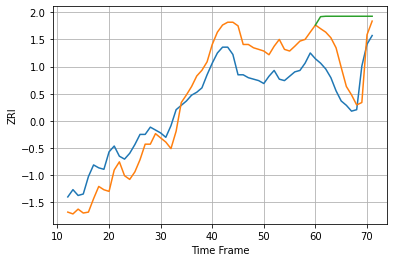

6082 16.750458567817653 20.36884979325018 45.233229793167375


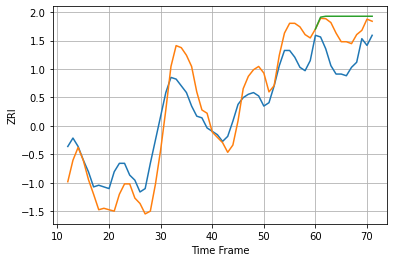

6106 14.718401740829494 16.53331074308791 24.59089473852188


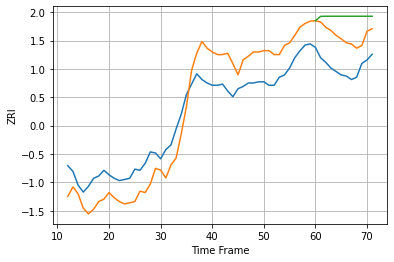

6108 22.730687178893543 27.806649051342127 43.961168645645216


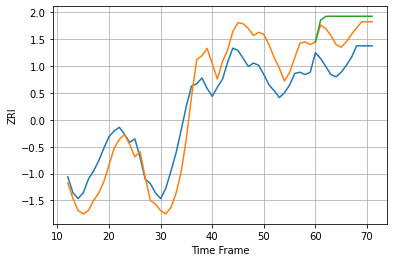

6112 22.332805401612475 23.85297424508168 37.19062993495816


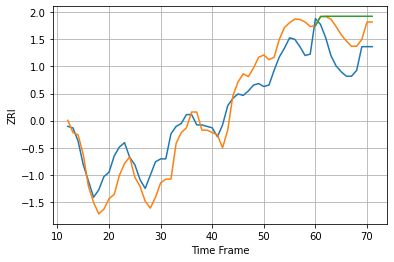

6114 14.022783182393699 18.337820314088972 28.02248707194308


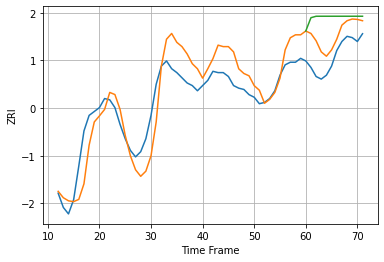

6119 17.024808222200157 17.71807603143405 31.90325115452702


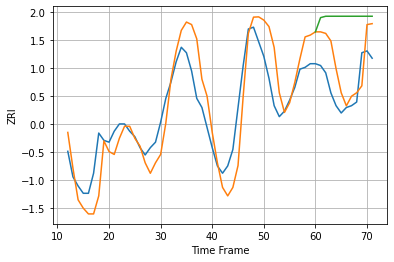

6320 15.220805066929428 16.847072111698587 37.999961815913004


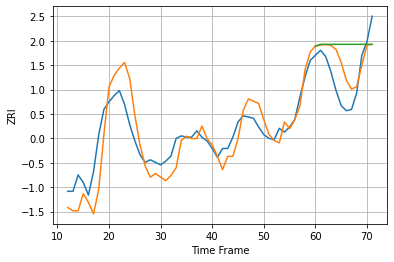

6360 15.738976774632295 18.887497858053063 31.473650191551418


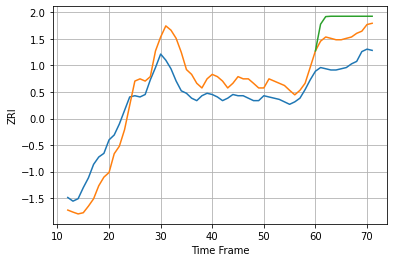

6401 16.84063934182075 22.32575137753959 36.46046402360467


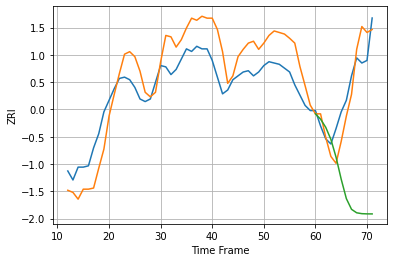

6405 21.182288979070346 16.345631159746567 84.52960696153421


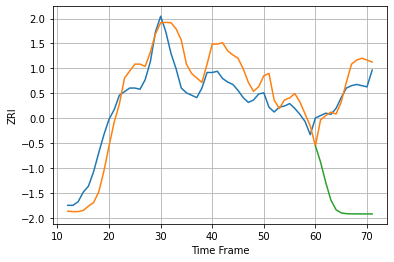

6418 18.52306729031348 14.22682761736656 90.53848168693199


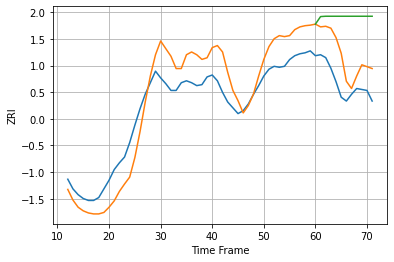

6450 25.028619201331953 31.44186716599013 69.69050470688222


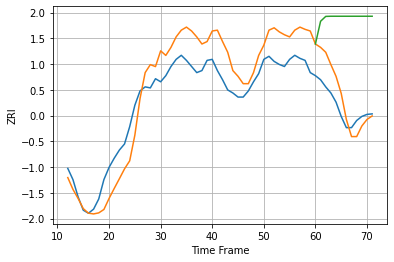

6451 24.93173062948867 21.539761887168382 88.49256917676776


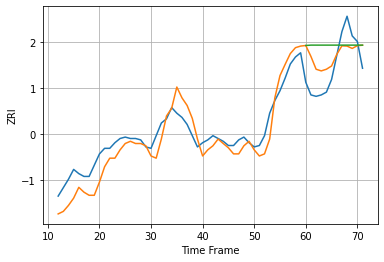

6457 10.727133303441164 16.747251990929115 24.380485720859863


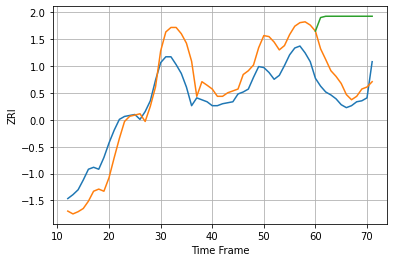

6460 24.192652329669325 24.888768624368293 79.79417869011372


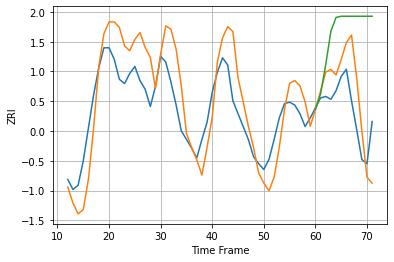

6484 22.09781714014691 24.336306579246752 60.76105321774798


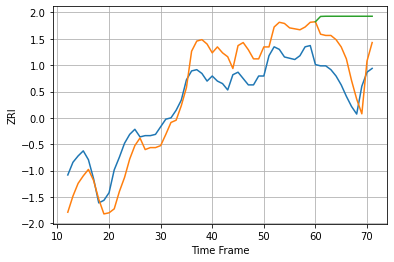

6489 19.379037280461706 24.458890337646913 52.24678680661025


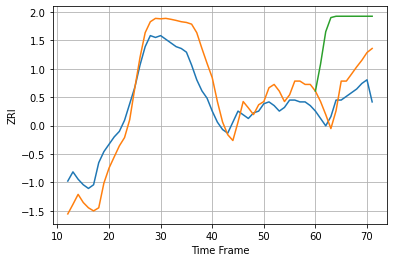

6492 12.349079155075177 12.769209110399405 41.34690607781671


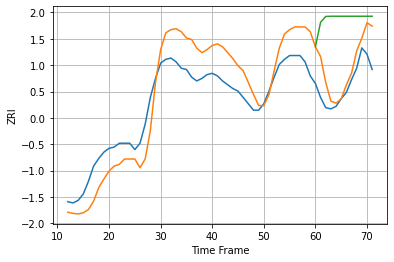

6511 20.155908329274403 19.122890279136737 54.05547916075127


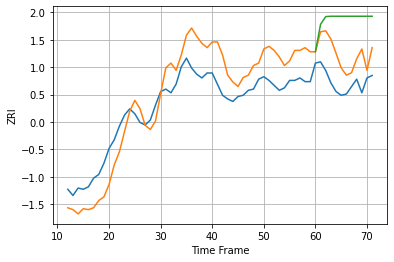

6512 20.55968346213849 23.855388597441348 51.611268151666216


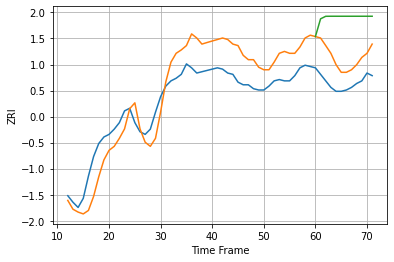

6513 18.565321216657207 20.62214000099592 49.71837262878741


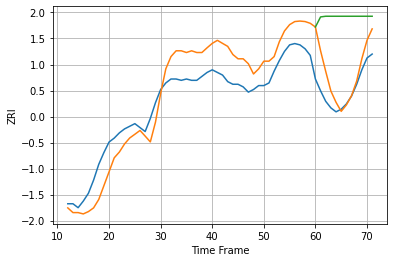

6515 17.59518273194183 17.9396166790379 56.61388504323783


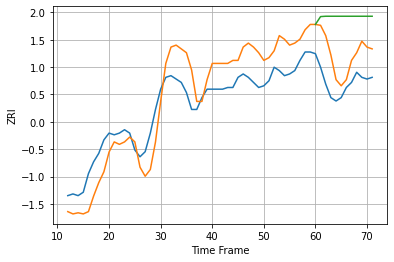

6516 15.221025318631408 18.271737187810448 39.125441090175514


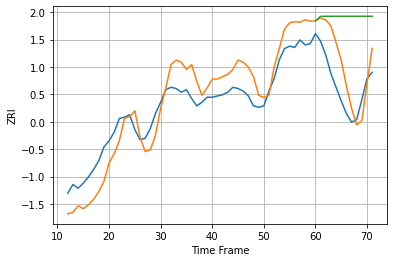

6519 17.126168385973287 23.008518878586656 58.20771592462777


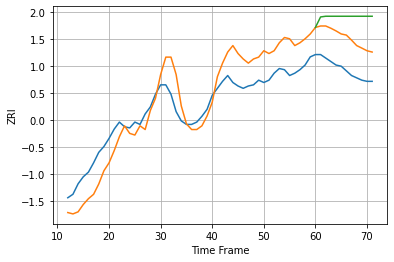

6604 19.719812791943035 27.490010464251842 45.50151565472224


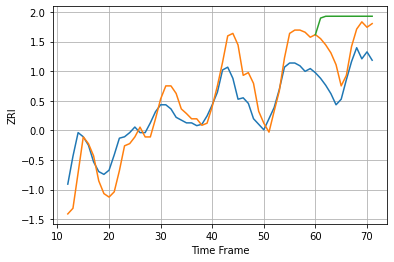

6605 16.801126319863705 22.724733769775074 42.82800501717653


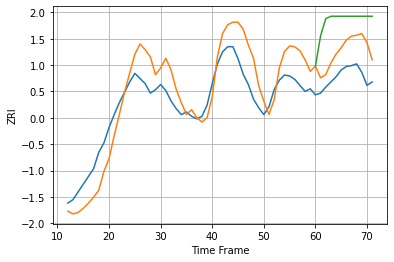

6606 28.20215411054005 31.451917788913118 66.42926982018918


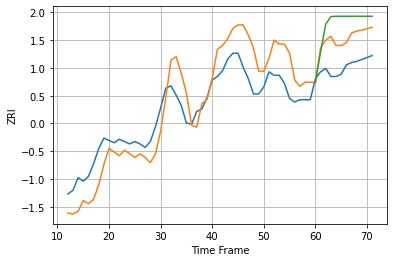

6607 21.7620010877658 24.273677315146646 38.955902207473976


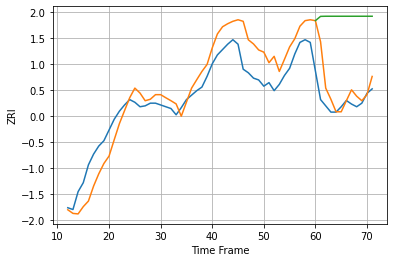

6608 23.132047568997763 26.742076642052822 94.6266256328318


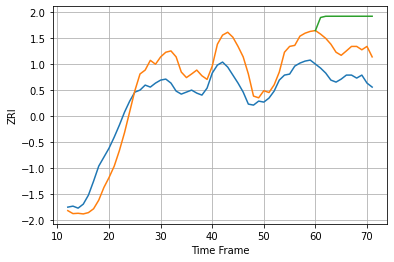

6610 22.786006893624386 30.99741287894419 59.829332705567445


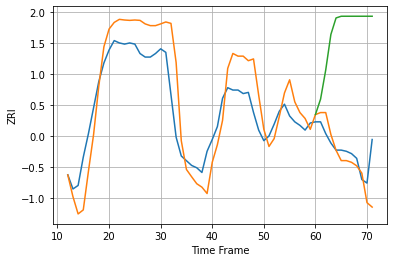

6614 24.89972301786932 18.943948211546424 103.65302684157976


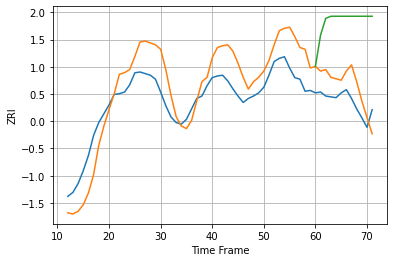

6615 32.11232118595358 27.658461284737573 102.44601747549333


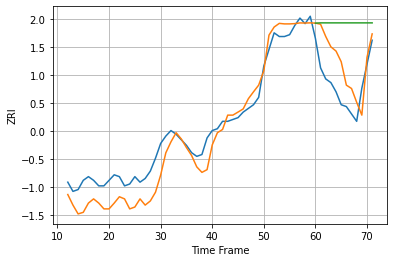

6704 9.599053859465354 16.42820167968729 35.600249261190164


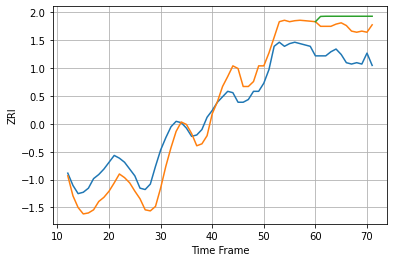

6705 15.168519196307034 22.939890788638085 30.49095822993967


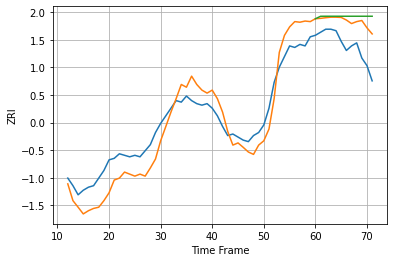

6708 12.368656077529543 17.43363207665403 21.52441089904417


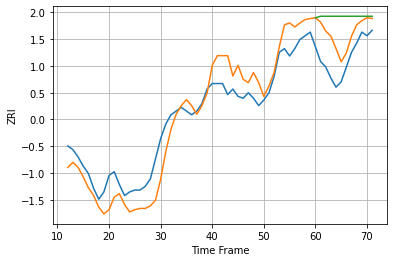

6710 11.025369663812091 14.674722809068399 24.367945569517136


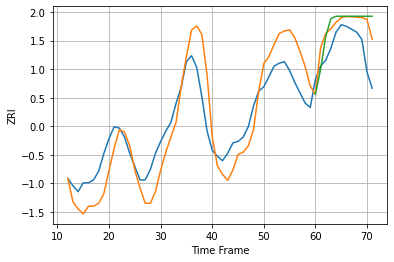

6770 18.327700280564972 17.402744270802337 20.82866064253901


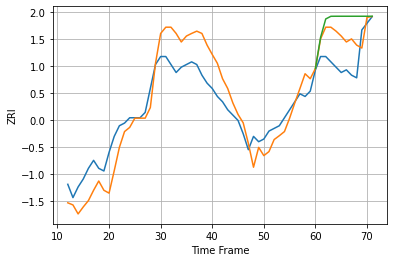

6790 8.67000109669991 10.017667064078926 15.333471828251446


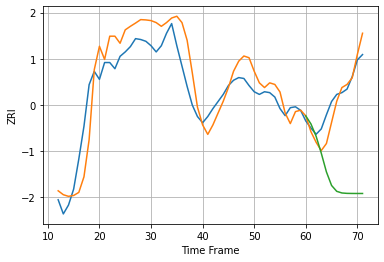

6810 25.30843374932418 16.02020673464026 98.94248537598781


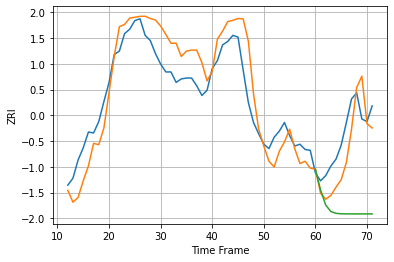

6824 28.554160725403555 30.44232959956914 91.46173705862157


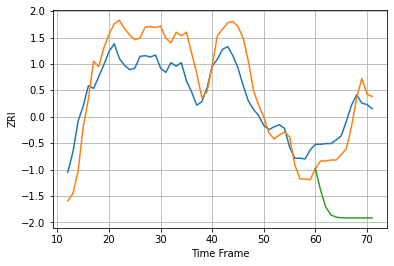

6825 39.372864618472086 27.041422144456316 130.5692167429394


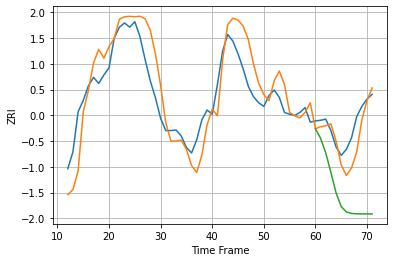

6830 40.81246286019866 27.826626616291282 122.76801482975506


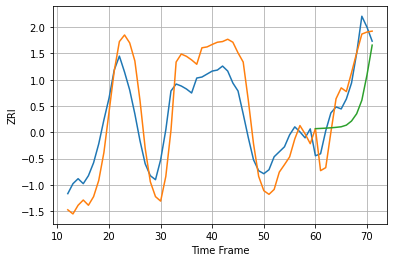

6851 29.183317140428315 17.99337499163218 38.31826495129434


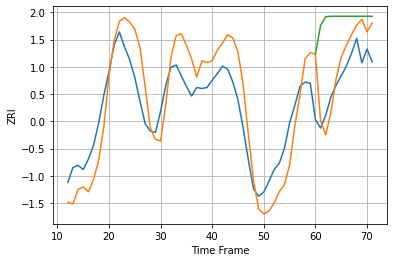

6854 27.97615933831522 27.07555814940154 59.90136304409251


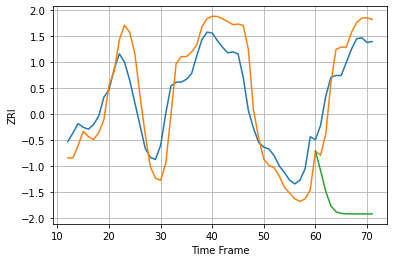

6855 28.155773424708965 24.17305630493624 148.81548560023188


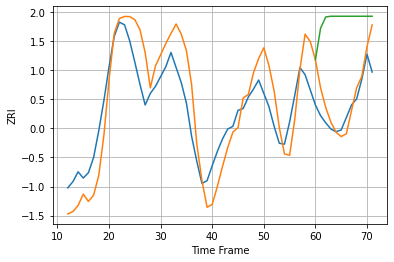

6902 34.49714497325271 24.764582613248443 98.99420003756163


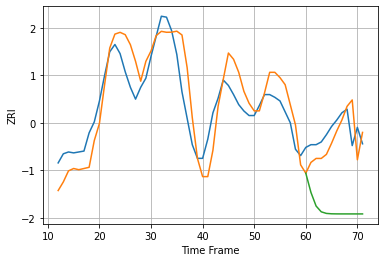

6906 26.759498151898857 23.607044219233465 85.32053046785549


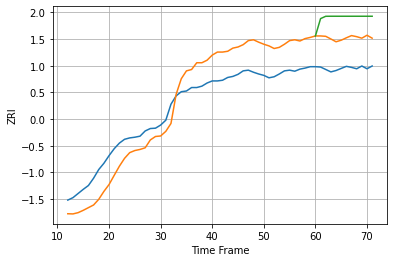

7002 68.98961242517731 88.11209967676562 145.0728760443035


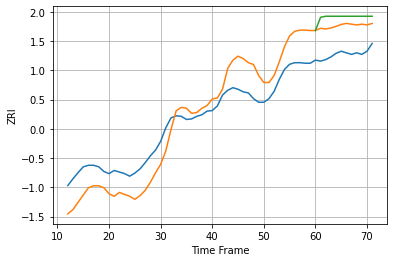

7003 44.2243758736139 54.711529727287186 71.16477524688167


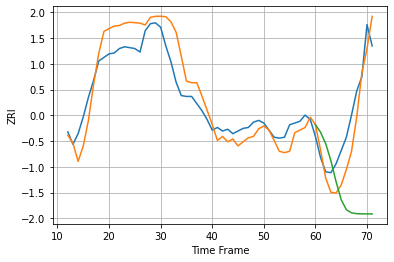

7030 21.86813026176107 27.558076462497503 111.3954244257545


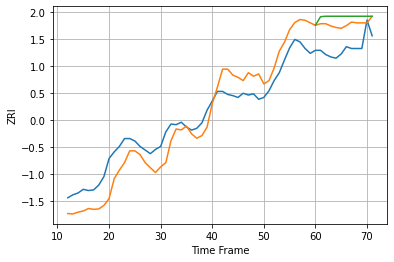

7055 32.19618021952245 41.88602380245646 53.418245590309006


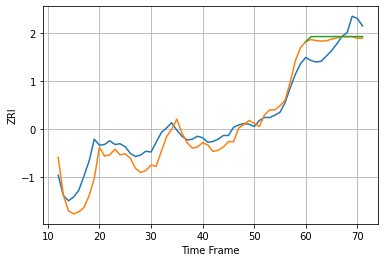

7093 18.42681213522075 20.834476948066218 23.001375174261906


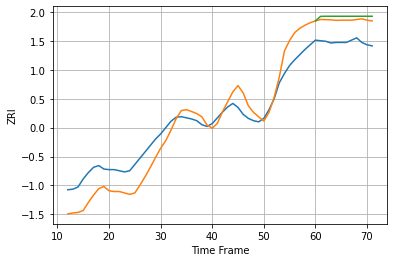

7109 32.1646538700303 38.28609868766783 44.246095401768564


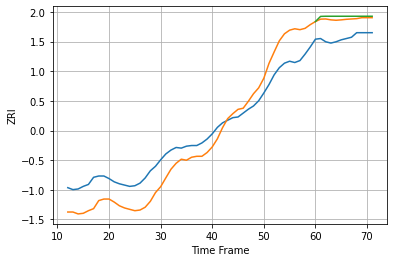

7111 33.07715806249455 28.792673900283283 32.70858260974395


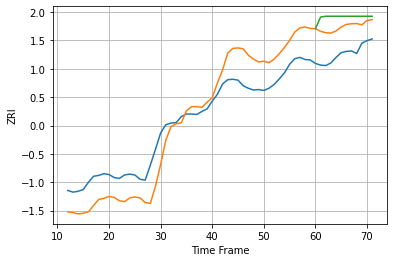

7201 56.25721565936382 64.34368583092493 87.19060917407288


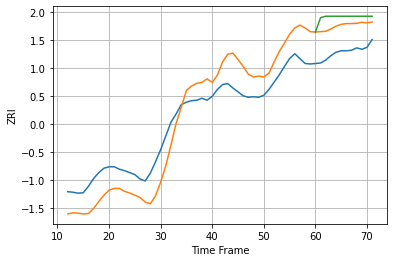

7202 48.8610525776873 54.63350368125368 72.14541867284876


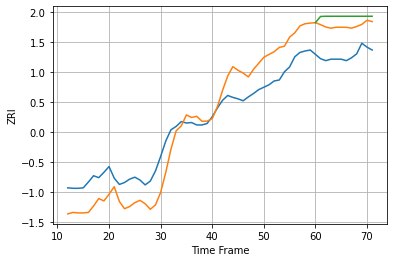

7206 49.15053877709064 62.404927520045824 80.6078458760189


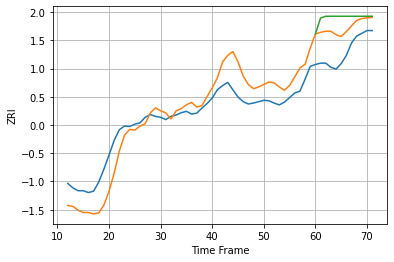

7302 41.01416552202792 55.435698763447874 79.91429461546034


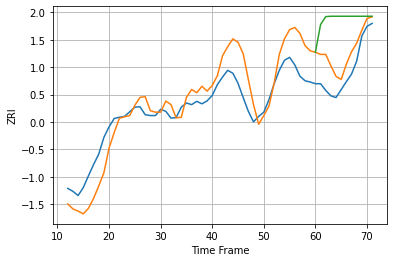

7960 51.7149416632915 52.78857145904062 135.14297844281487


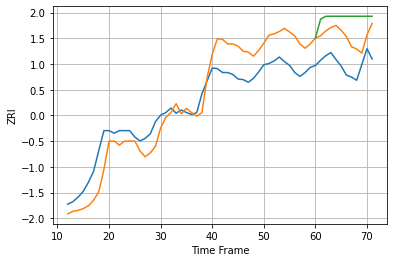

8901 34.712980036786725 44.78388794574049 72.31391732147144


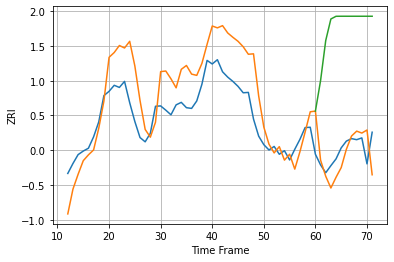

10001 88.81483815264913 64.20514408289343 345.9583153994942


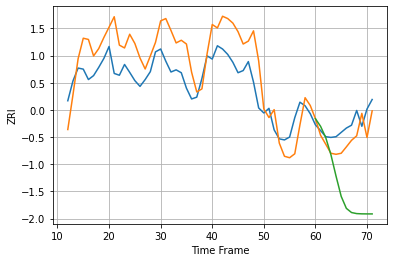

10002 79.17171232872865 47.15811195807639 200.79758851636572


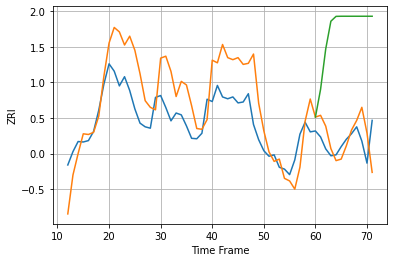

10003 72.43808843073357 49.6736549569683 247.91998003928438


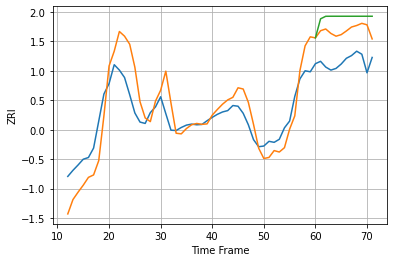

10005 65.85512203390081 94.17585872052518 132.0420926337463


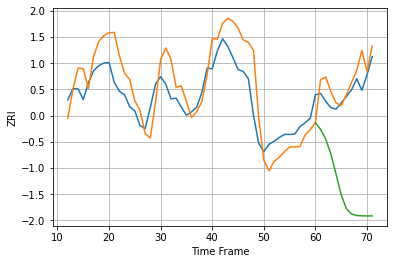

10009 73.15270790757914 51.33804533417628 299.68404156926374


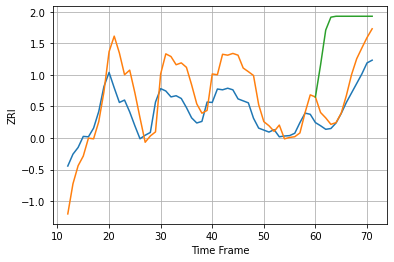

10010 68.38625893475869 47.76417143639086 197.1252568741421


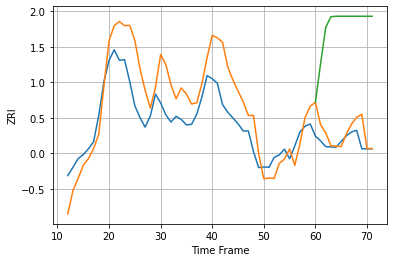

10011 95.49738032090943 50.09971137295321 367.7180668483771


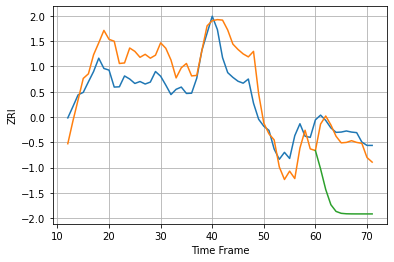

10012 90.6021832433305 45.42788832887423 258.9108490815281


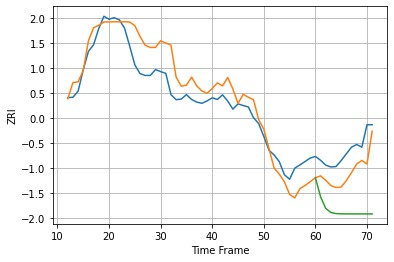

10013 95.27640473288182 109.98511127257485 299.8956674324418


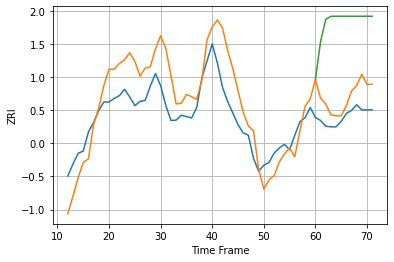

10014 94.61910888413347 74.50625261312072 312.1988235641423


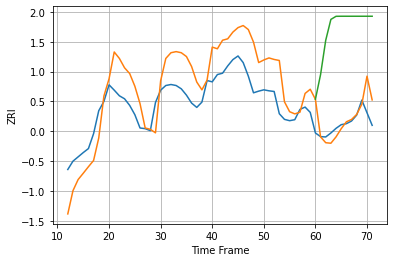

10016 86.83529310168736 50.464609773308695 291.127060460805


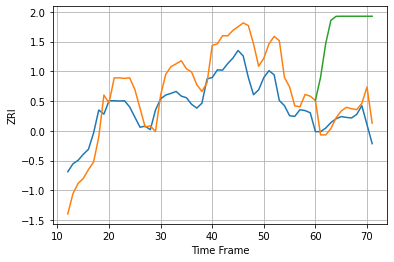

10017 100.61975432079625 59.2777975302714 347.70601474875514


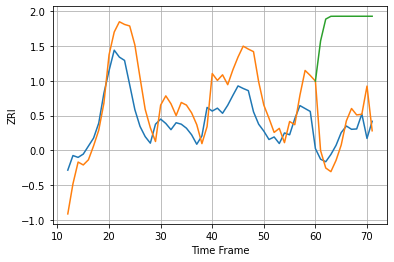

10018 79.88502086981556 74.40161769455267 317.9534270273498


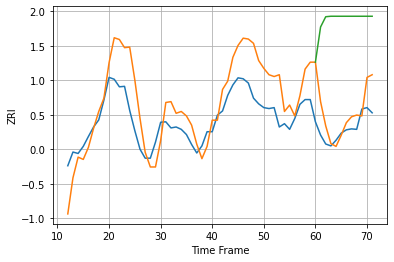

10019 61.834285355862946 54.13786372445107 230.09629557249514


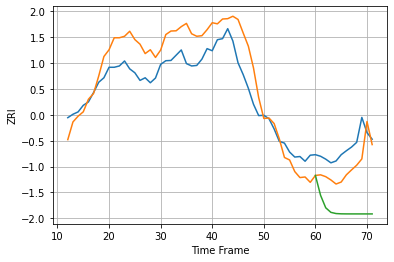

10021 92.06182622760815 86.26934083380422 241.23221921377012


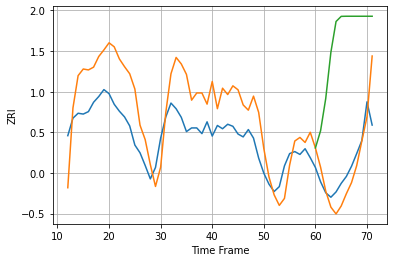

10022 89.41006484582897 60.887873319584166 309.8420568004572


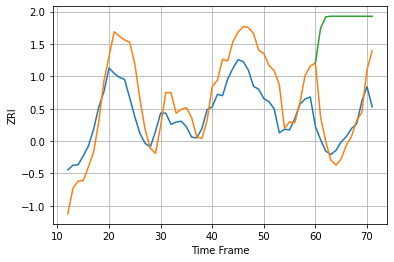

10023 67.69038074391786 63.80426369243398 258.76197306454065


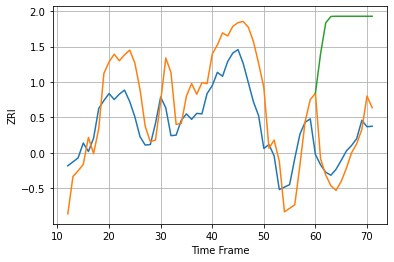

10024 68.18439436591164 47.18536256318044 256.21271519396316


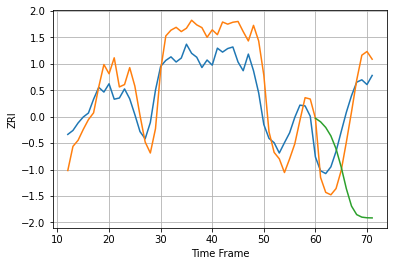

10025 67.52529001296394 67.9939677597622 231.58094145859639


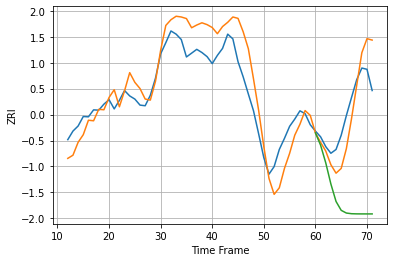

10027 70.73912981720858 77.01699955055994 299.49722674328484


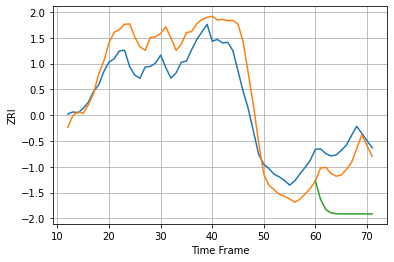

10028 103.5256599740487 85.35478103000501 280.1599652431383


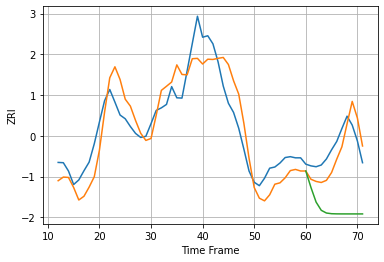

10029 75.1067122194228 61.900413908442786 221.9361259318005


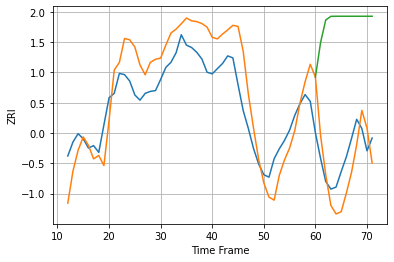

10031 74.11452966436246 75.4126339215256 336.8910733583896


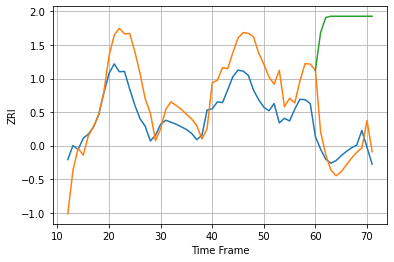

10036 91.05828812646378 72.47918226291031 397.9634357709577


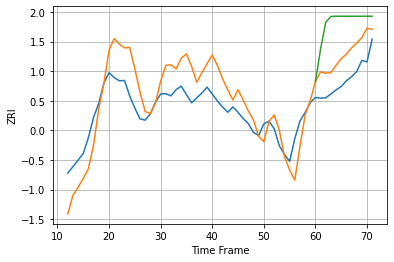

10038 80.21771719536525 79.36693749382273 183.86998211788264


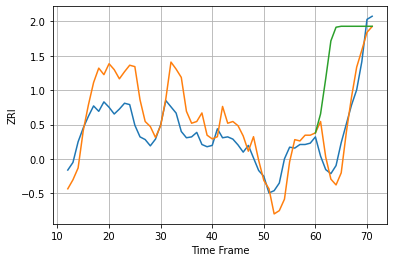

10065 58.17810215932531 39.337912198293054 183.8616031451271


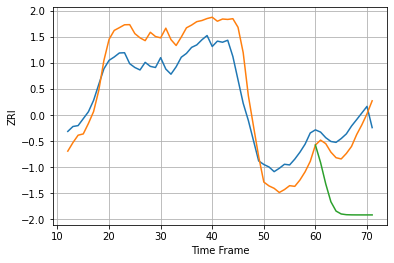

10075 115.88986282289463 71.13357031594258 343.28056854792186


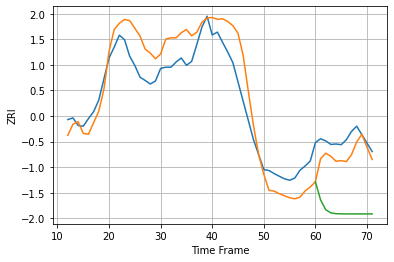

10128 99.5995559990417 78.25826561392434 297.17133272833155


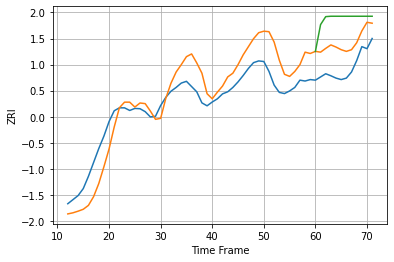

10302 73.13418261175286 86.3580242969731 170.36837800099826


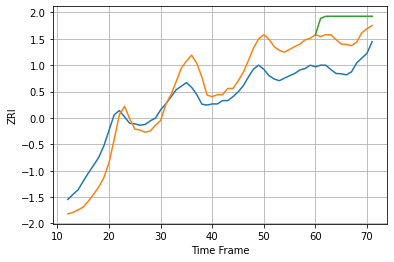

10303 77.16164523159767 102.07670239344236 172.97502416189326


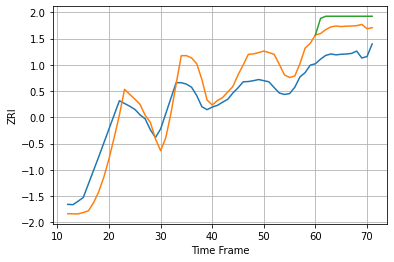

10304 72.80224331795912 94.46082180040293 129.36162146209608


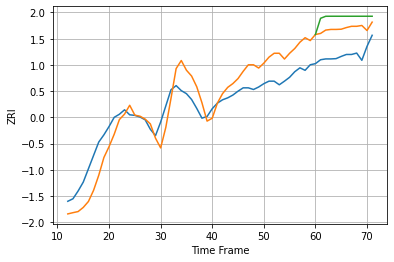

10305 72.30170810814904 96.89417911453785 135.8143610743086


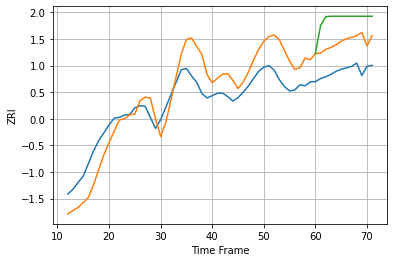

10306 87.84875318955972 111.4899305703489 200.45398520366805


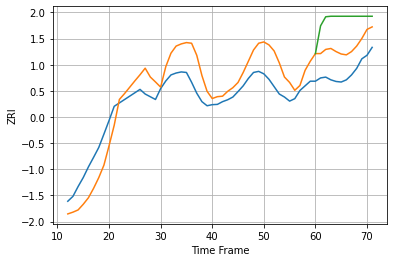

10310 80.75931939370503 94.35329451037049 195.79639536693273


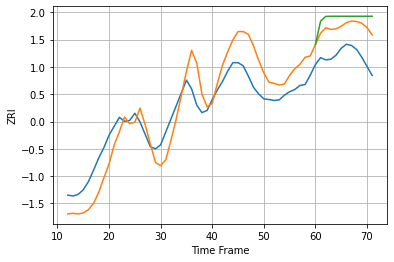

10312 72.92250841031046 93.65945624647779 125.63694026772463


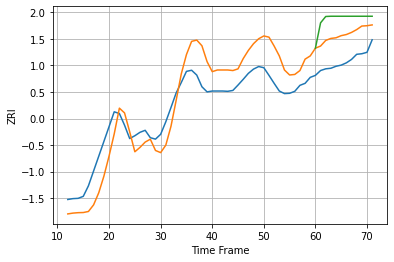

10314 81.98154610824447 93.77875792578564 150.72782678051848


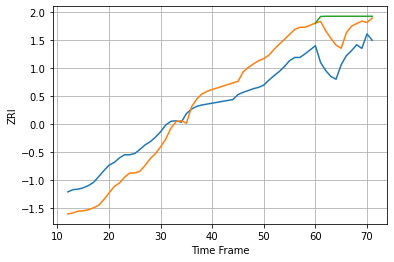

10453 46.53491041147123 62.48538585191 92.37895371497338


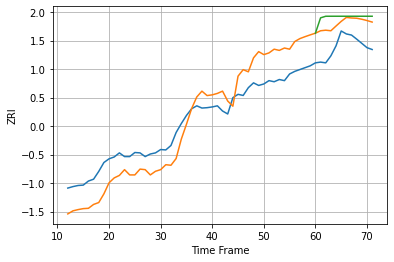

10455 61.4948090132526 65.70103239691642 84.23310583592979


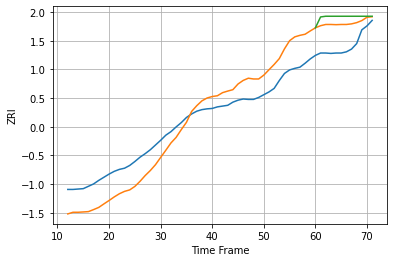

10456 53.490872297193526 60.43946973694165 76.60922719108301


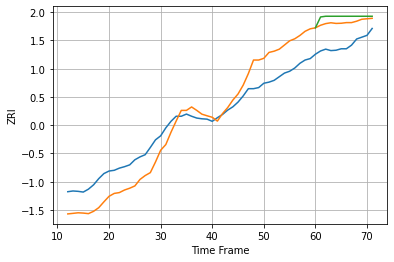

10457 58.40346882710216 63.48578218984969 78.3282369187286


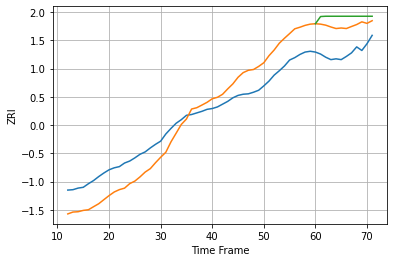

10458 52.959113177294796 69.35323244657225 90.79428104726134


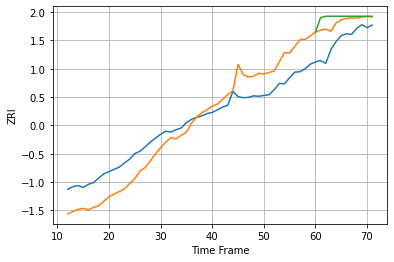

10459 54.98473925896368 52.94706962070249 69.17595932933448


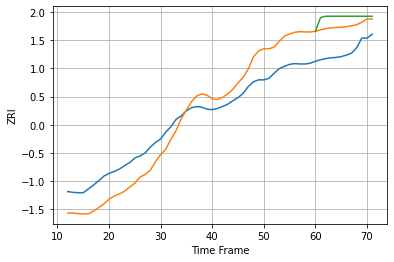

10460 57.11888893021745 68.00373880466604 90.43945744495906


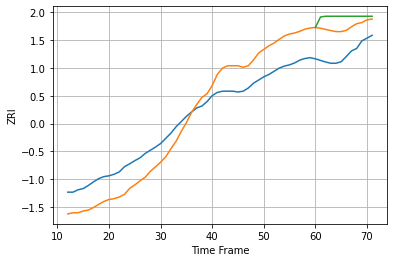

10461 57.62400139307154 68.1289898330005 93.63937290263065


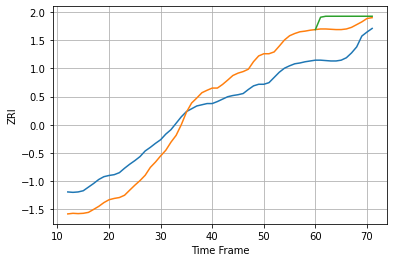

10462 55.94531411357938 65.50940025186173 89.37151273146716


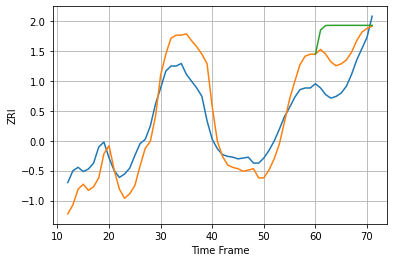

10463 28.47846058772636 32.66315625140056 61.24630462466371


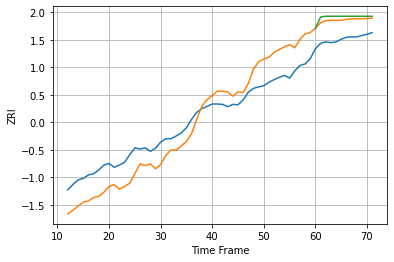

10465 55.01715994000471 49.80336563853835 58.181683963710945


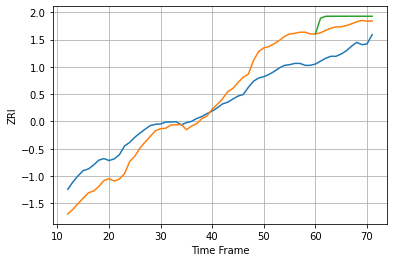

10466 62.85300017403786 78.41130704395123 104.90334605748203


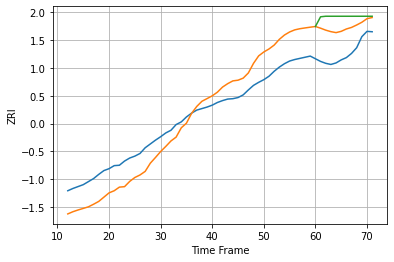

10467 56.181976219766426 70.54228451967386 97.85235852678255


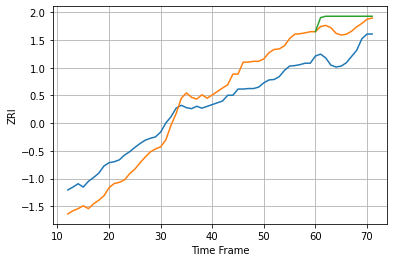

10468 45.599277999348104 56.061942516280446 79.16803768959562


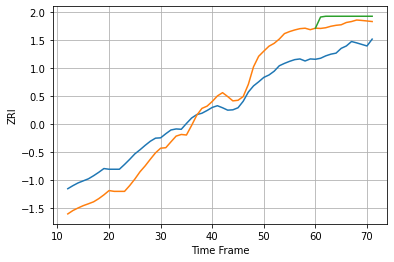

10469 61.468766374624565 74.35063248065075 94.48256629305057


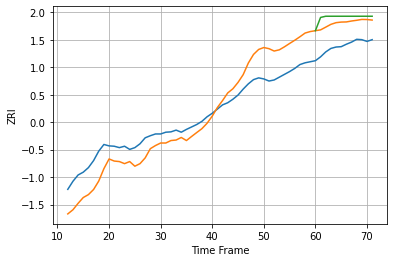

10470 58.49169995509921 66.89830761247406 83.799128257725


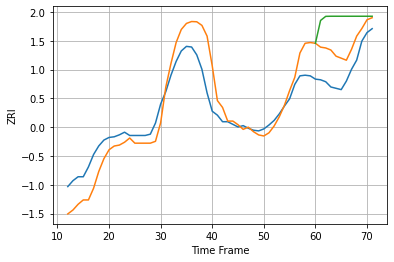

10471 32.201751555235546 41.17870907405312 82.01323238572134


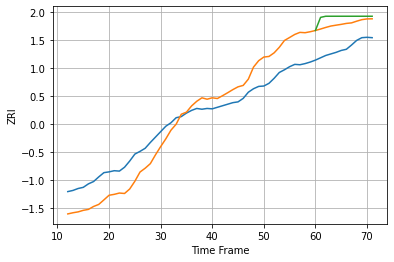

10472 54.94325236925928 63.498589332958964 81.12859363660444


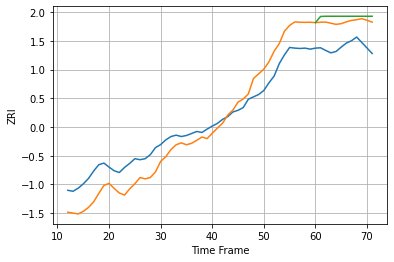

10473 58.175137587535396 75.66317173339267 90.80448274413682


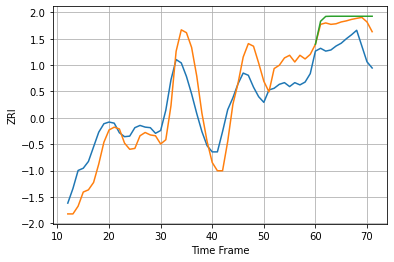

10528 42.75534841403279 44.23214176113292 54.7990440432882


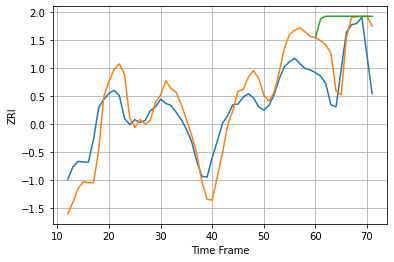

10543 33.86881746609832 49.59853429586795 79.99928633582736


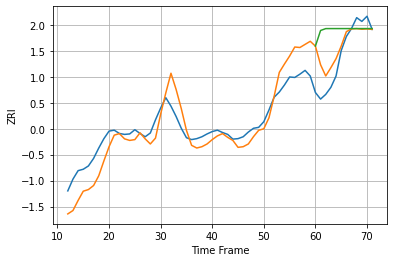

10562 36.74794192247043 42.24823182238109 81.72485107152053


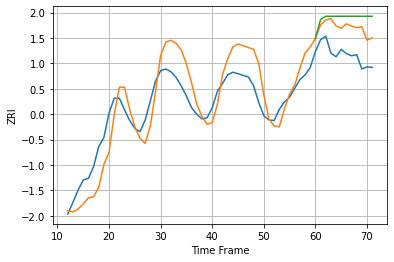

10573 41.70211270983068 51.81676278402003 71.90345210872651


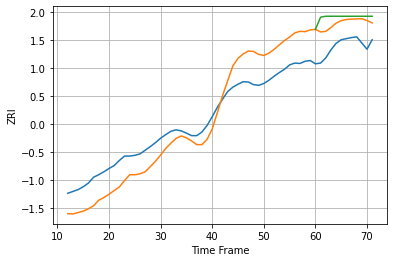

10701 61.9966146098738 65.59101194816066 83.74354151668926


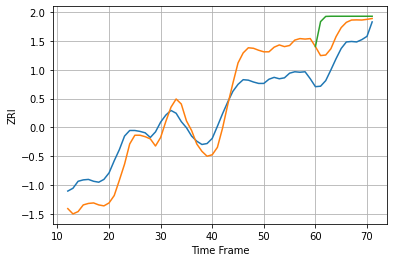

10703 49.89906546440374 50.268815397806286 84.41136324262497


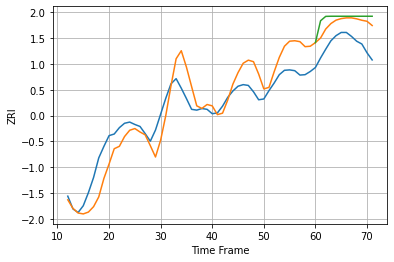

10704 49.925893202742 55.917298639373136 71.11577699694944


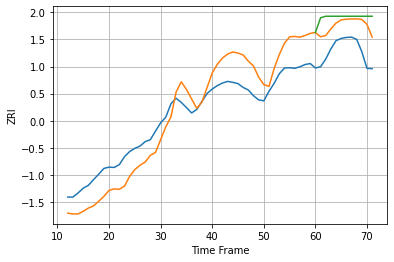

10705 70.41273013847947 85.07440507853573 113.83469950357794


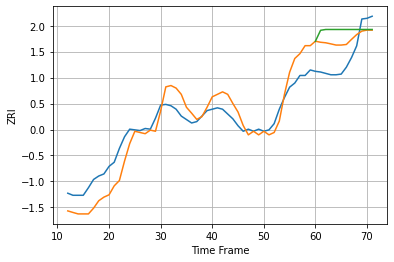

10940 24.68382914821925 34.73071145267036 48.81555326059538


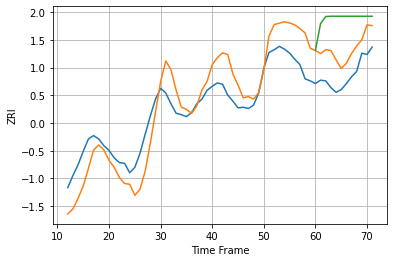

10960 35.52484510083801 39.99424618692278 85.14712835742286


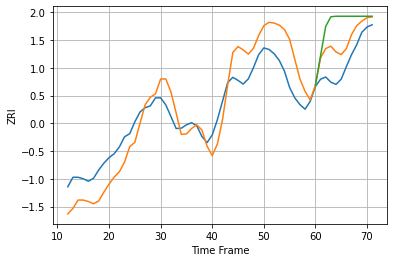

10977 76.67825375414147 70.3754143876044 137.39452961487592


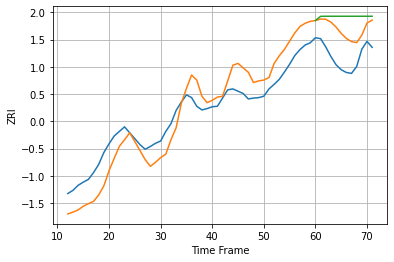

11001 43.20881315385962 61.209617017035576 89.80390605872259


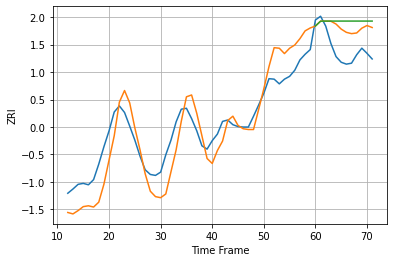

11003 45.998657512938045 52.37731259131178 65.99452359660653


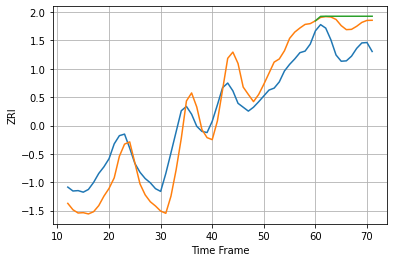

11010 59.4276603378493 63.74180803465914 79.9704482593167


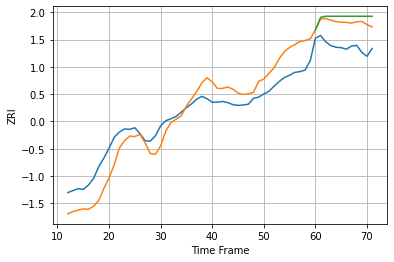

11050 47.76147646164274 61.78810912671848 75.81303251424082


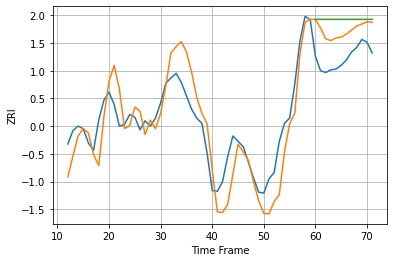

11101 27.518168233373675 32.55216678990024 45.15430354548036


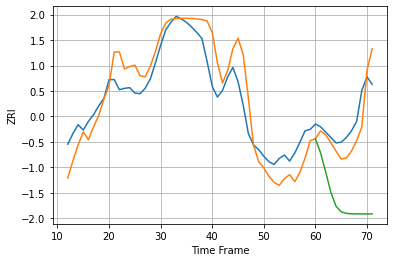

11102 33.8817099743983 28.570756112669883 125.993222025464


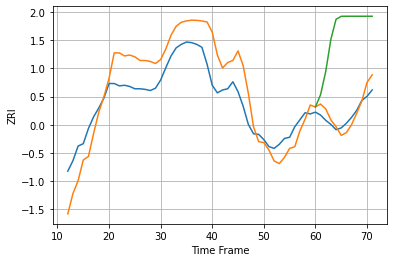

11103 43.885452532010696 15.111438644477682 143.38383515835284


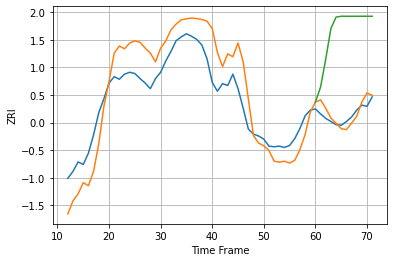

11104 42.04151486980464 12.149342414140117 136.36503625951212


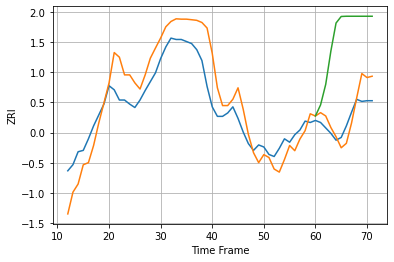

11105 35.476739204052954 22.22626125827448 125.17132660496297


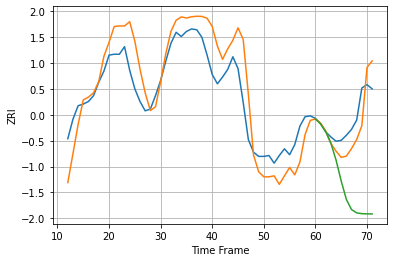

11106 31.073149484776668 21.92637458686293 90.03443845754366


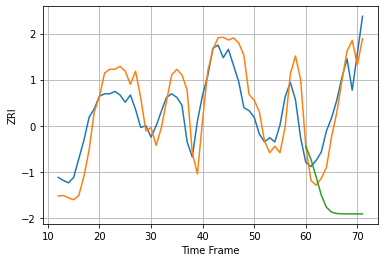

11201 44.0538856157945 39.559744958971 187.6218830212666


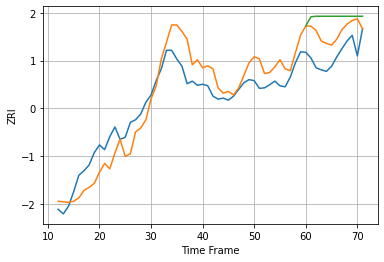

11203 38.493233481180354 49.29609581798036 77.07053403968918


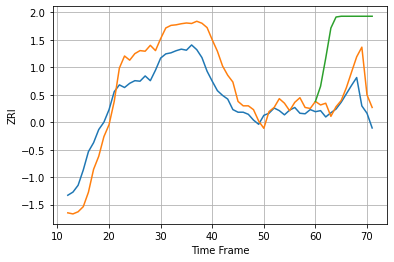

11204 45.070748026313346 39.60810453943322 147.06630442650015


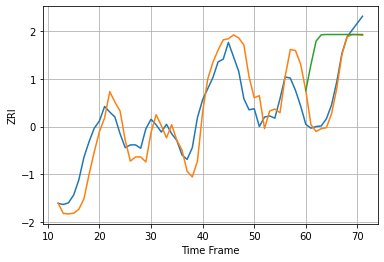

11205 39.73717119598436 22.568315837700823 98.2687899763352


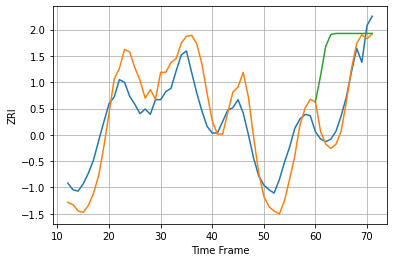

11206 38.48764979163467 22.6532068875822 94.92614830451615


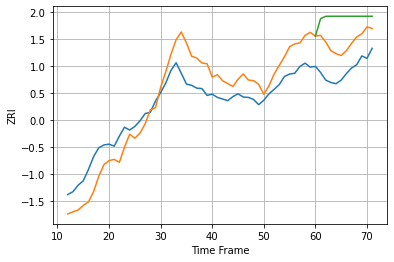

11207 55.29496780670168 71.7895096039919 131.35028038668736


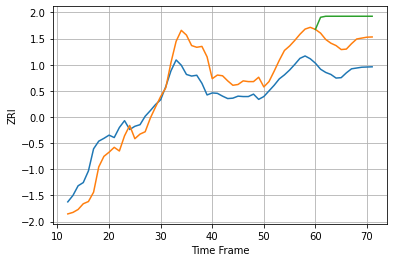

11208 53.4325006752114 75.39262934605408 133.11700856581567


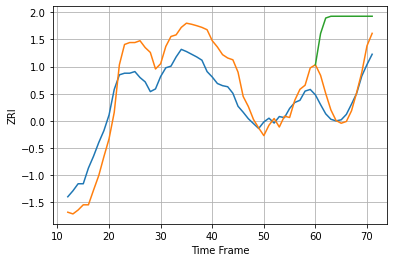

11209 46.61443931640167 30.014718277700705 148.8283705443823


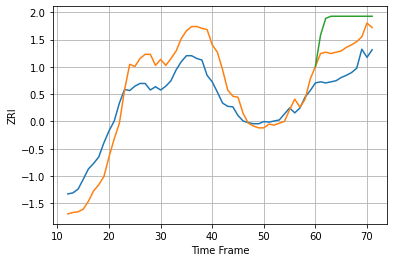

11210 42.146621622559366 48.65704807474772 95.05048850493525


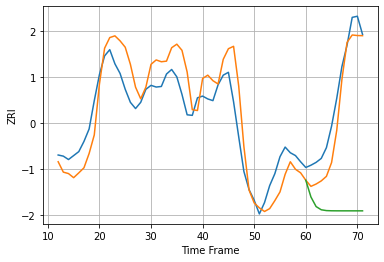

11211 43.623687580998855 38.19323853586331 218.76223533130613


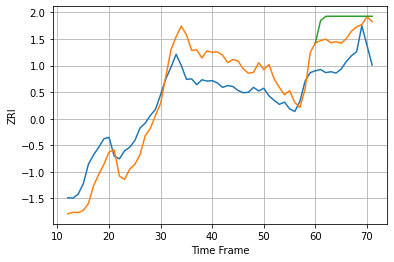

11212 52.55571980879706 63.53081410595918 99.26631455959631


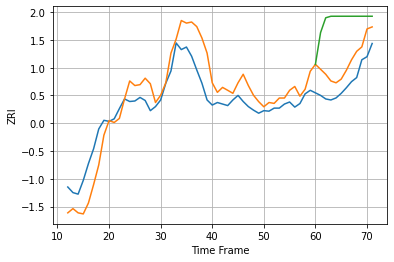

11213 42.142812748689565 42.36110942302175 124.77948953596072


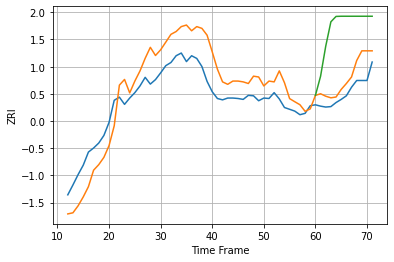

11214 53.043416461198575 35.745641255762344 146.33135920092386


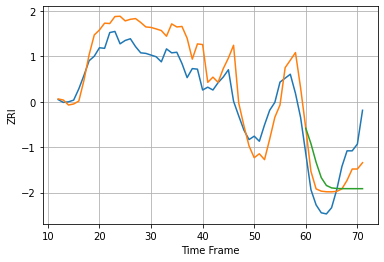

11215 41.12326936123423 44.44084944772781 69.71725024767873


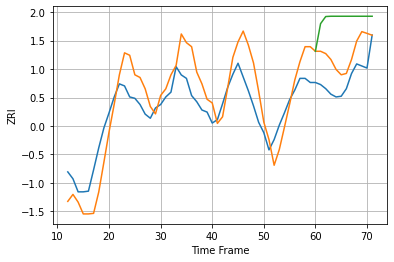

11216 38.059602695135204 39.978429679001344 89.23672013104282


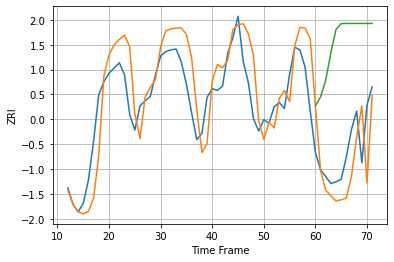

11217 36.28105946515708 43.98314473164986 128.8693106569927


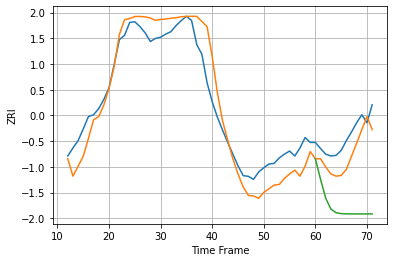

11218 33.03808175601759 31.87003330053591 118.34353629772875


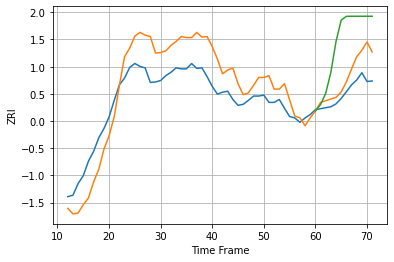

11219 51.951524347376484 37.734019268981434 115.17341888929879


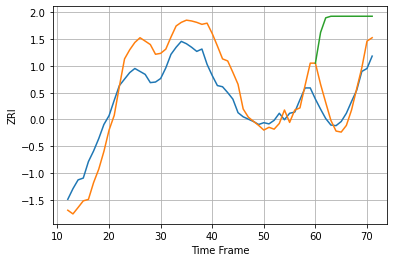

11220 40.21083330829429 29.6148844463818 140.06160213419204


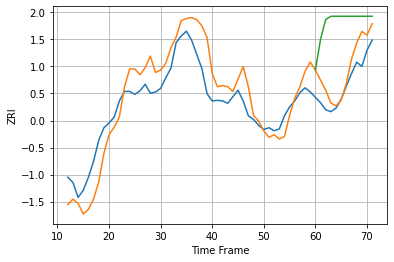

11221 37.62708742264269 30.72335383512587 110.33390206883321


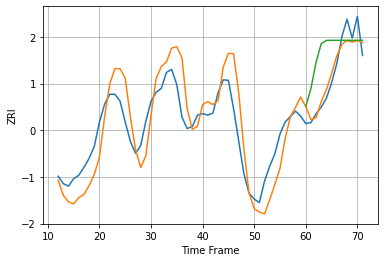

11222 50.80937417589709 24.936215606005163 71.49620852824604


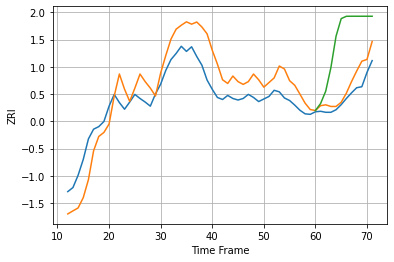

11223 44.93622352740921 23.647446544117987 117.15358730070169


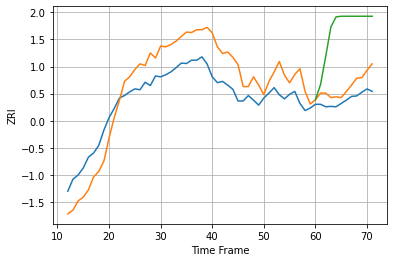

11224 61.37561922769273 33.825188853010246 171.9905493733785


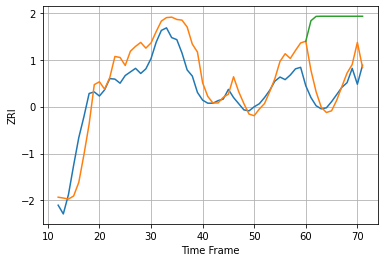

11225 39.55499520102234 39.53108178952815 144.10047698399669


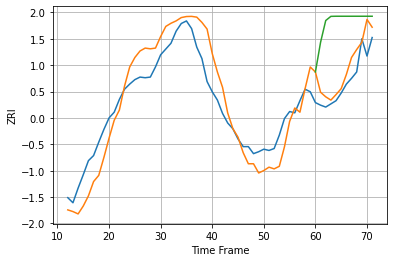

11226 35.03867450319739 27.784104824128 98.2869096325716


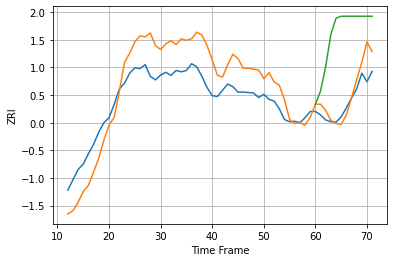

11228 58.001569825825186 32.44446004818229 161.0235435397924


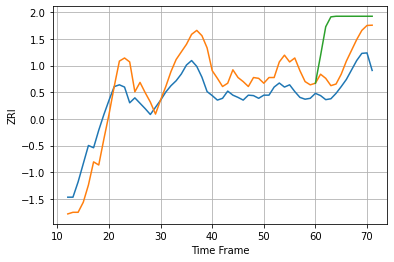

11229 52.01287801041403 49.378044834571774 127.04331104856357


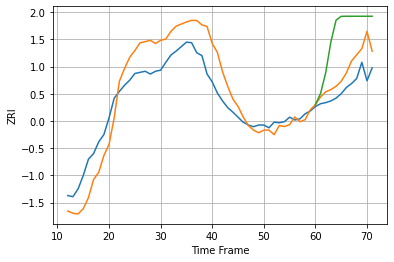

11230 41.044224403365 35.6514411186247 101.81062247397223


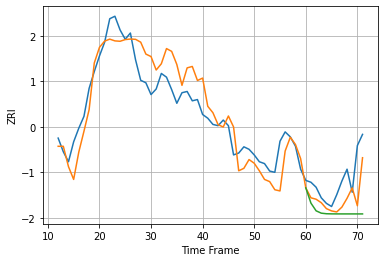

11231 34.29848790965305 37.50354593696438 59.39239009095249


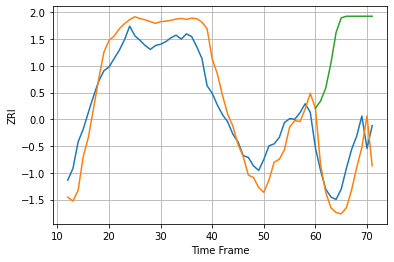

11232 35.850027412200994 45.357423077983796 192.62686361842063


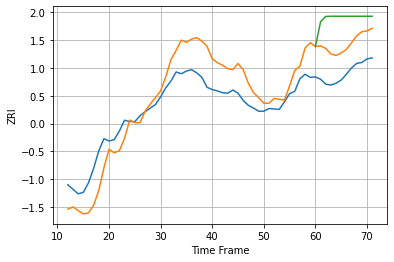

11233 50.28254887970531 65.24056944508744 121.49659245524448


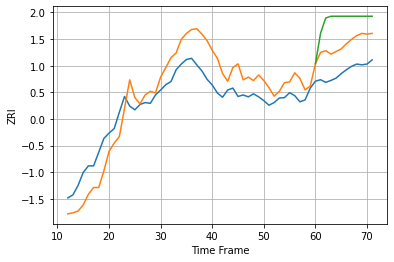

11234 58.505634307291125 71.25352648118293 135.56212395562602


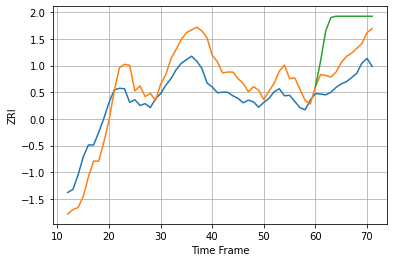

11235 51.46964441045241 51.06067878466585 128.54332315293837


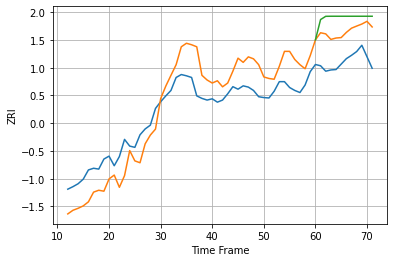

11236 57.995322242723425 73.03390907545557 105.82985209557545


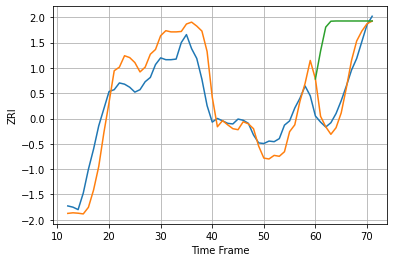

11237 37.175009017999784 23.24888823657081 105.61976295430833


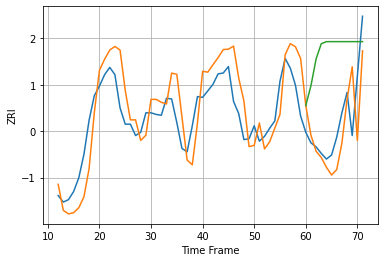

11238 33.75819646381408 41.153408339200034 99.22146256226496


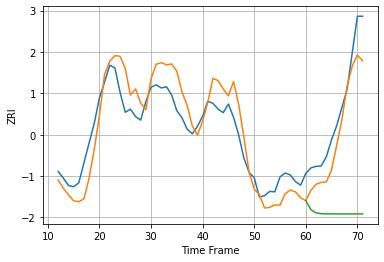

11249 54.362740775816356 64.13498967691815 289.41431310475406


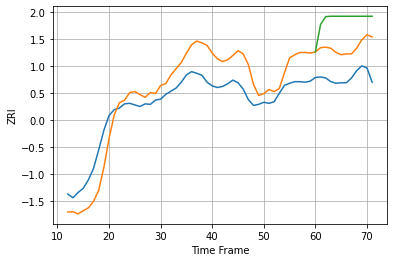

11354 43.90584298971522 57.56854997395441 110.86005991634154


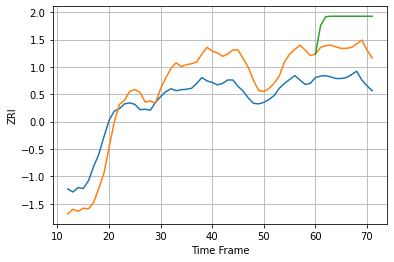

11355 48.9255664189207 63.56748428615196 122.45354261001341


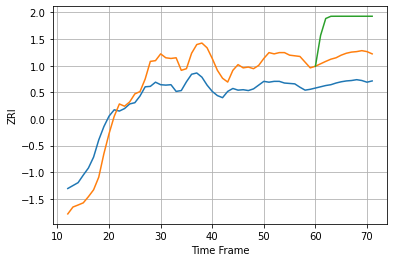

11356 58.34658793550443 63.62053258710982 148.00099406762783


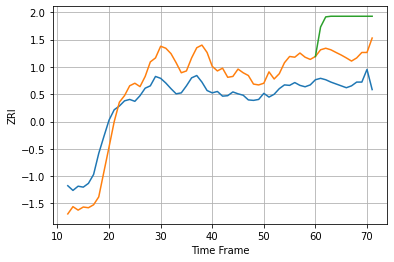

11357 52.13306898360768 65.25474523181646 134.45194676396594


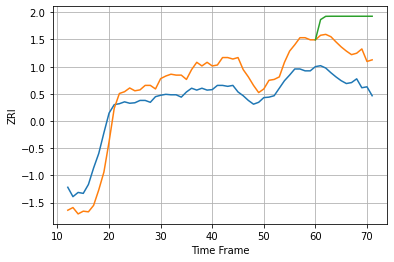

11358 48.07125542234914 68.38068191030897 131.61095523276487


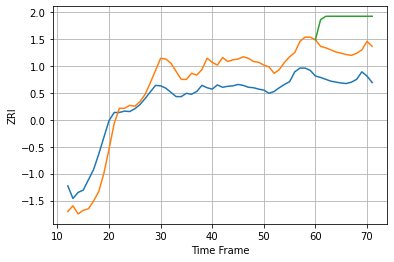

11360 49.866674001204224 65.59308714429045 131.80986101013653


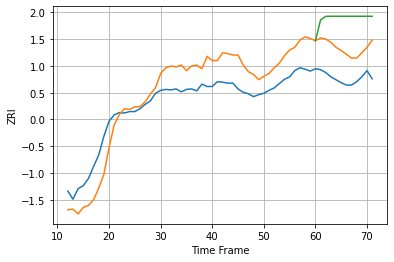

11361 47.30246400828783 62.97600447787813 124.05591968008704


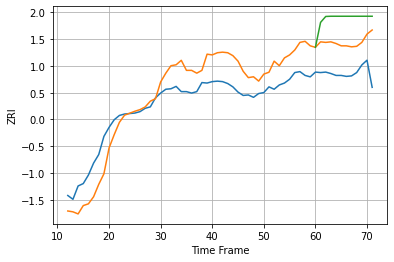

11364 47.38639087610827 67.14187807991574 115.30405532273075


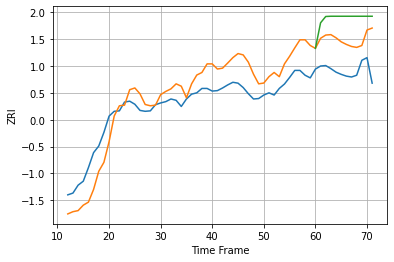

11365 48.48452320355165 72.68235796896155 118.97793171885326


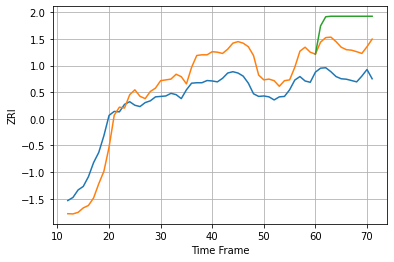

11366 51.47238069779607 67.46504544552901 127.64118812475857


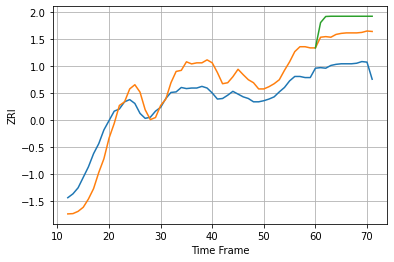

11367 37.42636524237614 57.09569448547564 86.01478004952962


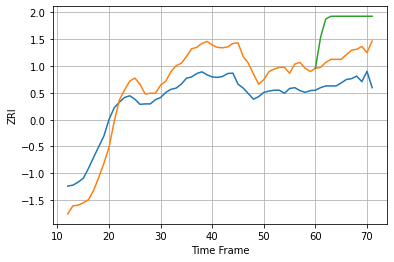

11368 55.743987280138434 65.22063192833332 144.03986057481615


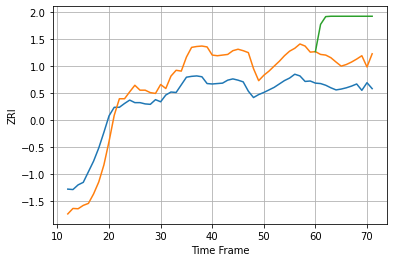

11369 57.75176306987158 65.87153467796374 159.37149340241643


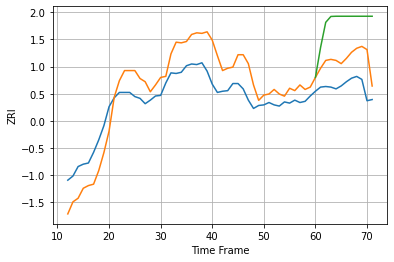

11370 40.21541536442574 46.69203549377107 109.75478101700034


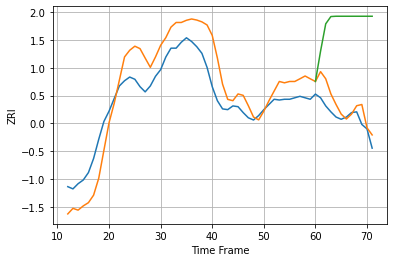

11372 32.64168130681601 20.25845445193712 128.87242460893512


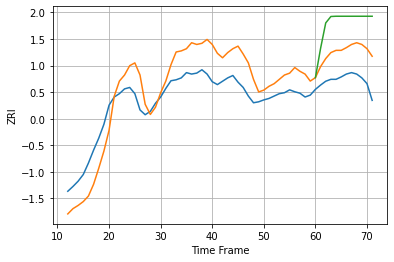

11373 50.00963035443206 60.35800868459462 123.31491886582425


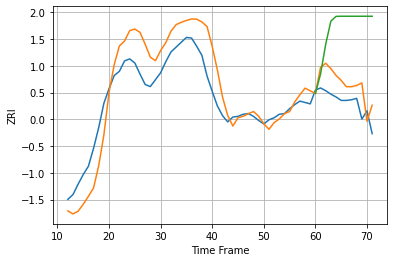

11374 33.80492442607356 30.809370635332126 114.49418176060016


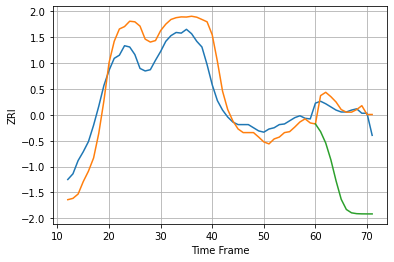

11375 35.24427736989517 16.298616348326 125.97355529406806


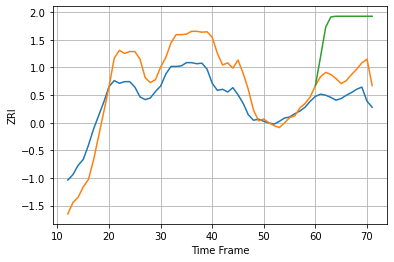

11377 45.83074507153542 40.87947698468337 134.76172717691765


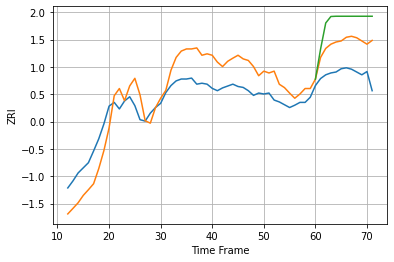

11378 49.622568812932904 65.64747569683156 112.60483312631712


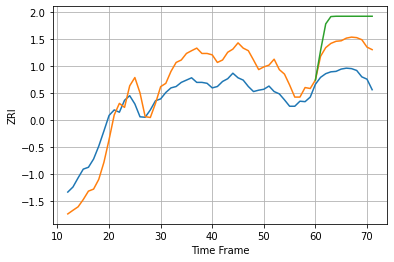

11379 51.548173270052075 64.8857112762946 115.13719783692812


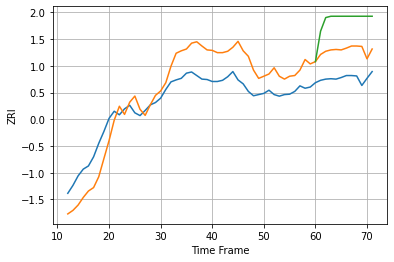

11385 58.91008777498967 70.18825817759263 146.62448443460767


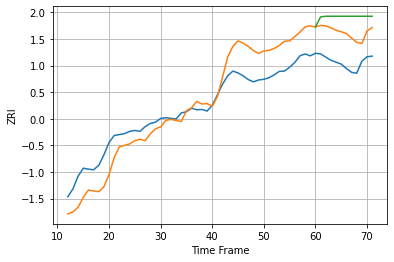

11412 66.33151776312842 94.34554718677373 142.20583491547973


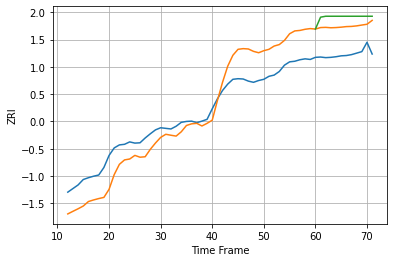

11413 72.62699054930364 94.34372638721385 124.07919120856383


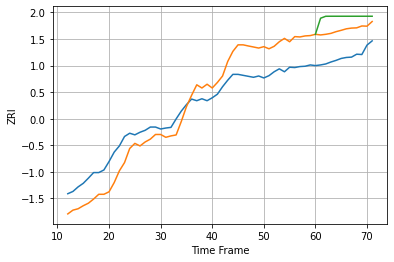

11414 67.92859816116443 84.67027145805969 122.26821520464037


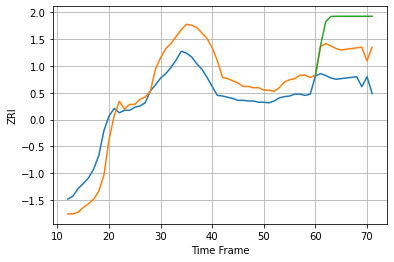

11415 35.42021964894609 48.73993914678142 94.24445043900322


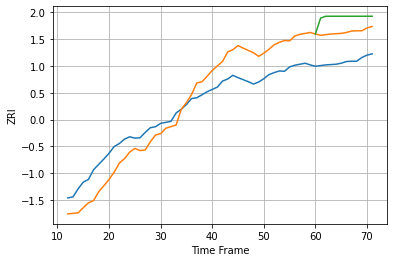

11416 66.98744283595644 88.10854493425688 130.98437800129537


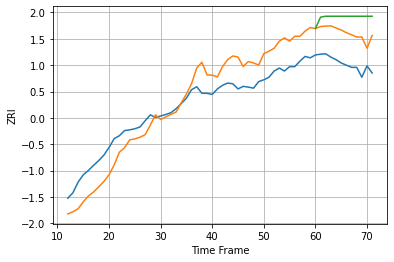

11417 58.27877010831579 85.34531194806509 127.96112985438317


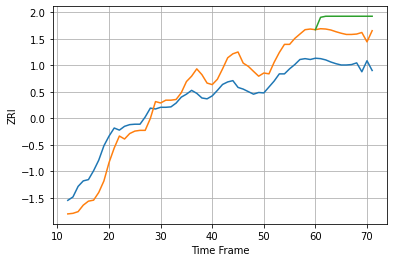

11418 48.349188910753135 74.36962838526323 110.1500765705624


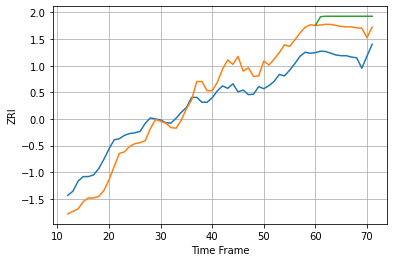

11419 57.94199944937653 81.44493384886512 110.31152037710825


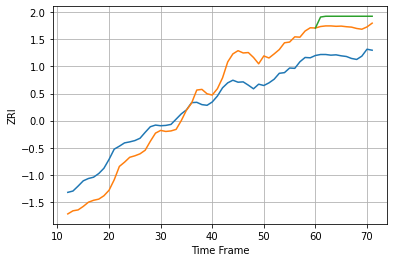

11420 65.52420005495954 86.16212184560354 115.09982619184606


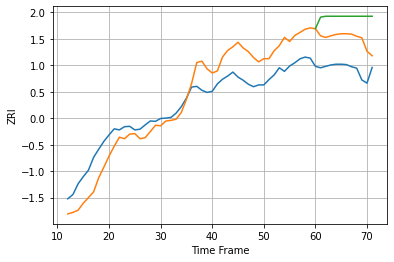

11421 61.315868521330295 88.24186006427598 145.12924639251491


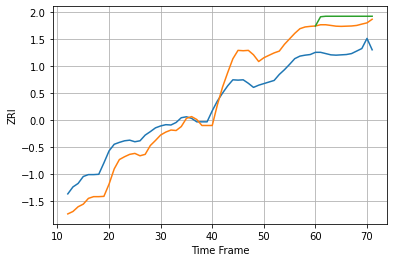

11422 66.42814674289961 85.67998243806238 110.29454666917499


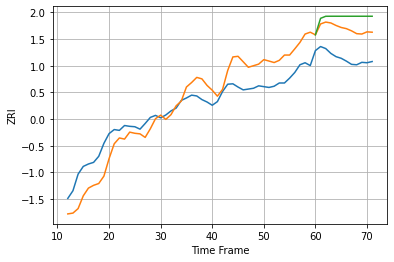

11423 50.105793526425394 71.53891974603553 100.53879386199641


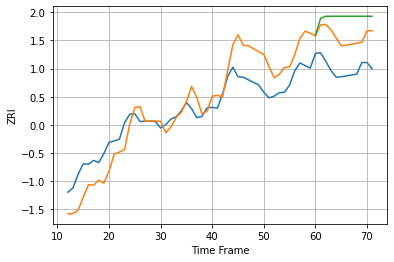

11426 51.241292256180024 74.3915096443471 118.42387430746982


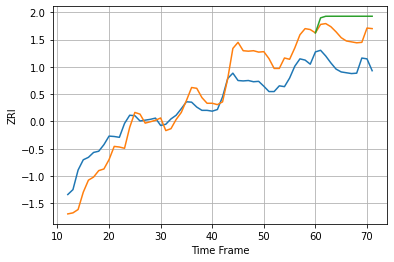

11427 51.64429528390521 76.93100448717533 116.76383800532149


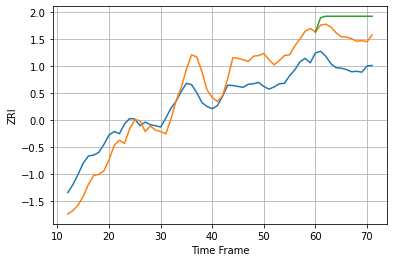

11428 48.85370310779113 68.79752008624732 107.81371609246634


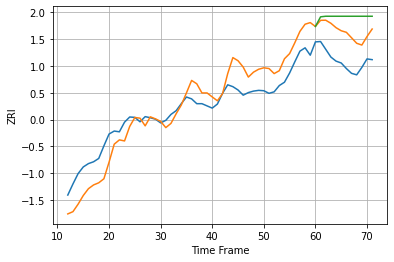

11429 51.2582551159508 79.36943381680868 119.73839984797323


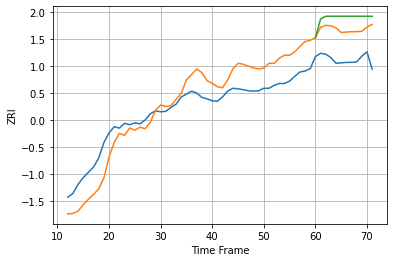

11432 42.24092758964044 63.25284254084741 87.30371731615584


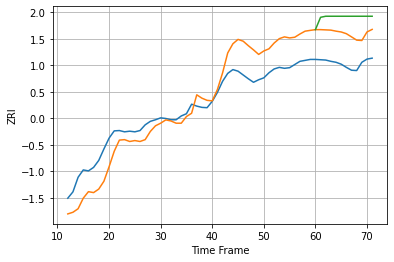

11433 67.16889203236414 94.87621998130183 144.45007996616465


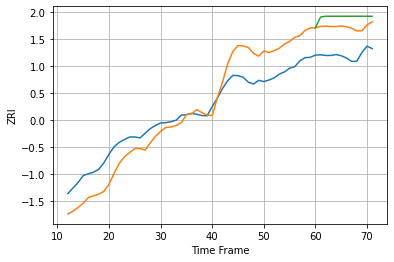

11434 68.55942875691419 90.68611834162202 122.16828846001073


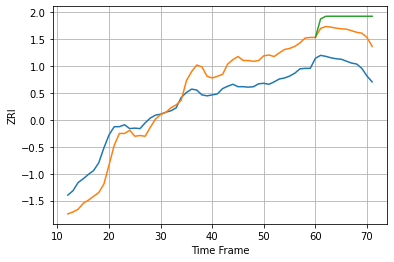

11435 45.28233207796118 65.40933831779525 96.2999735699025


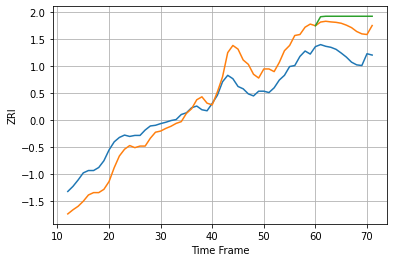

11436 59.662712160705645 82.92591879508464 111.51188768703412


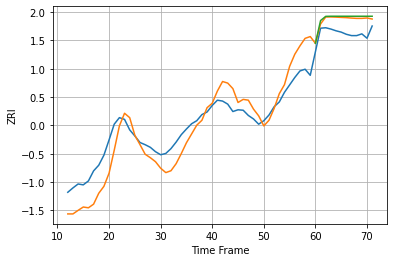

11542 42.68358148910487 31.955386669312787 35.33058330190414


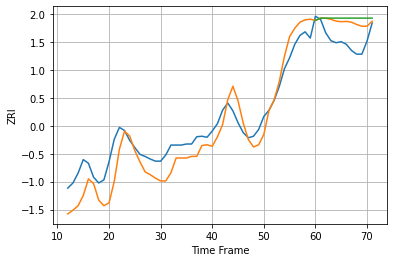

11550 36.130475485441856 38.38762278991613 45.80693860333491


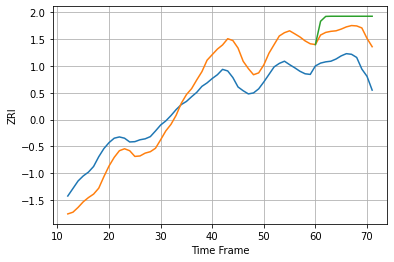

11561 73.37213622768509 100.91998243499353 148.39233581071016


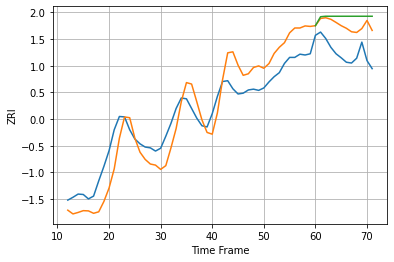

11563 54.1827368598188 70.22667252832576 91.88870147098982


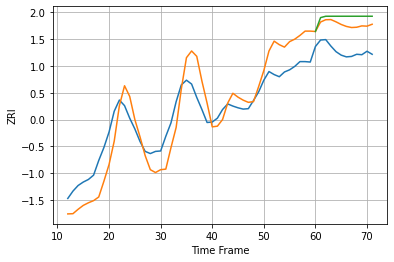

11580 52.242233693670215 61.058459794012904 78.56210861869374


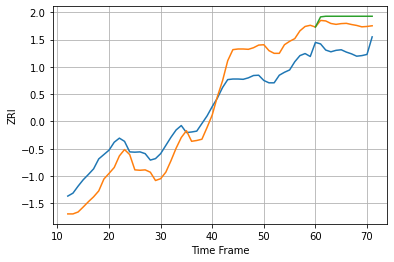

11590 78.12513066821928 89.13133432718973 114.11555053983432


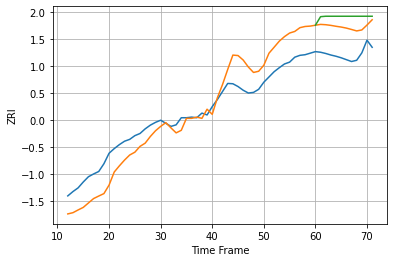

11691 65.38464554484612 90.69333344394416 121.5767979769028


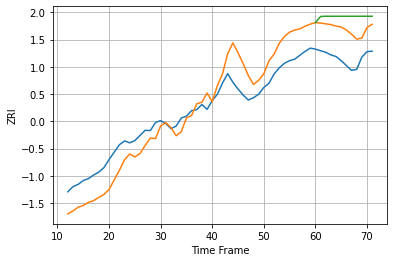

11692 64.52581079683803 91.44230888482694 128.610285107465


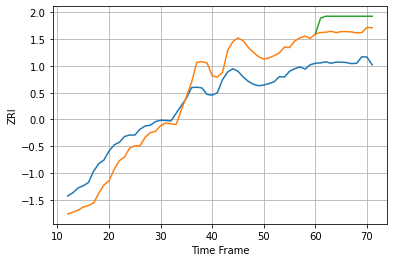

11694 62.909734835716975 84.3465283650675 122.45468295783232


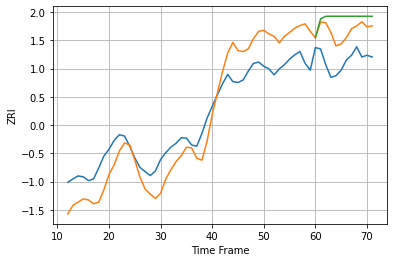

11758 59.25435777628345 70.71937114122177 102.4172379450785


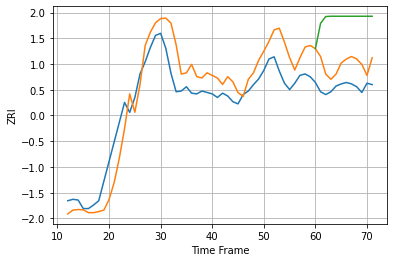

12047 32.844710496735225 34.33058531318434 95.86485699953224


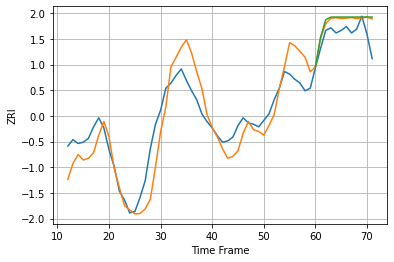

12180 16.797020888334803 12.113236377425778 12.90206241381236


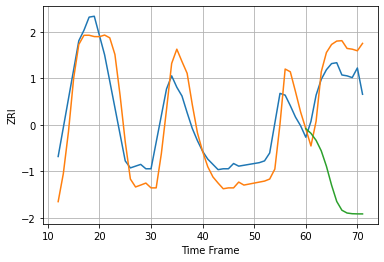

12182 30.32688079835412 29.74827318715292 124.07132796262458


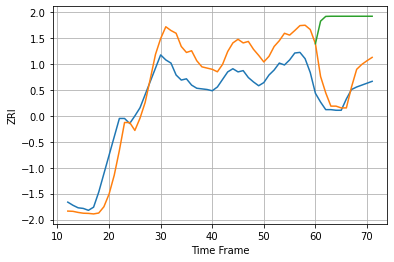

12189 39.716390024890565 33.52885834575053 125.463759393666


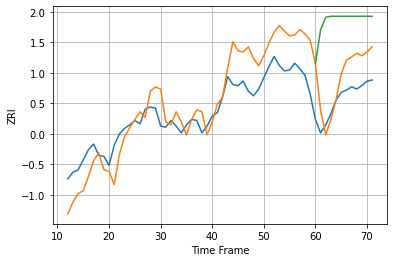

12202 22.704381470336255 25.652635029277732 71.02610882903542


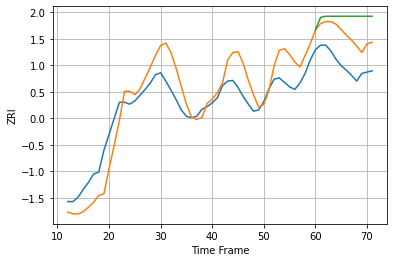

12203 34.04036132831497 46.29001817818989 74.6514386347087


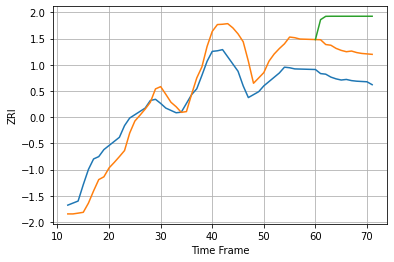

12206 38.188997808667004 51.05688744231549 104.08489115661072


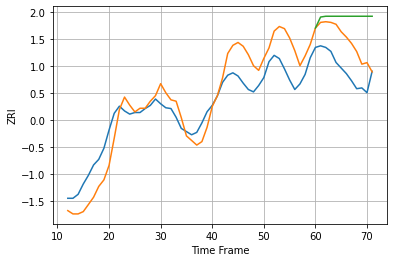

12208 27.586888210606126 37.749704474548864 67.94482595521099


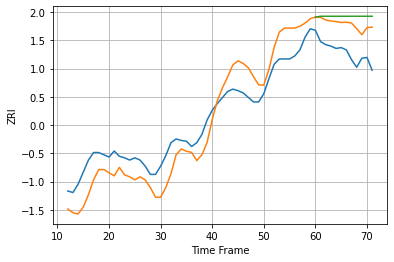

12209 28.639258257812816 38.7595219161732 49.19764598565358


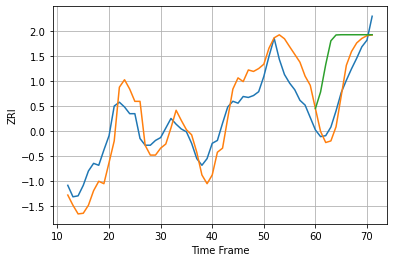

12210 23.545788626167266 14.1205555815892 50.89197393380443


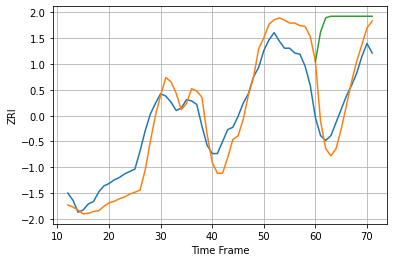

12303 17.84314773187817 19.527172901777877 68.72382392917868


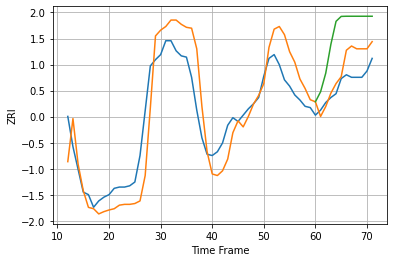

12304 21.691707272559437 15.071025343764154 41.37178256738663


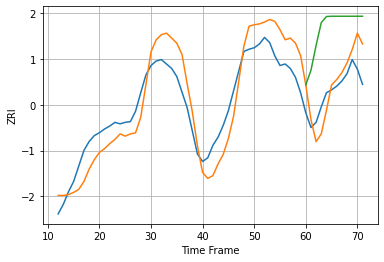

12306 31.76141125374016 29.08120417094367 87.38549048357523


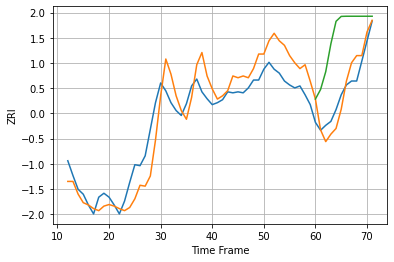

12307 21.826288288597986 15.059843812661919 59.21782346367905


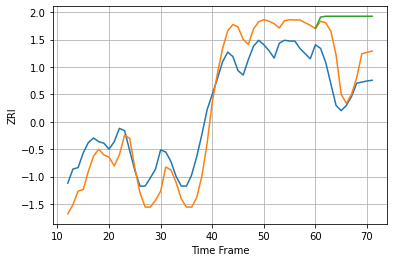

12401 33.99029325566848 40.310709243087096 92.56397057838808


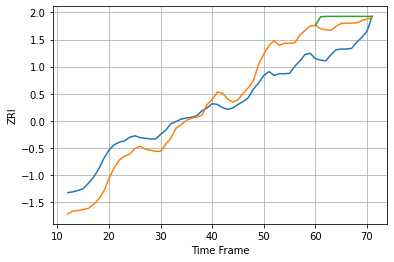

12508 53.15277193714805 67.68871270372917 88.8170449664813


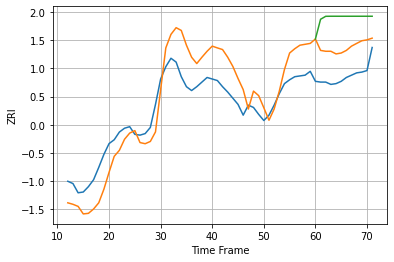

12550 32.32530042324557 39.34757877109109 75.99529702769408


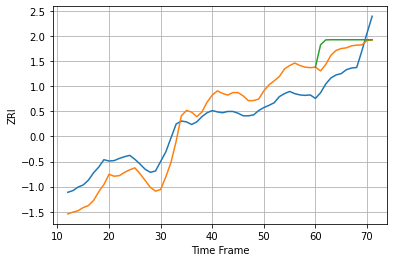

12590 45.49798998145523 50.15350950665877 73.54893236086201


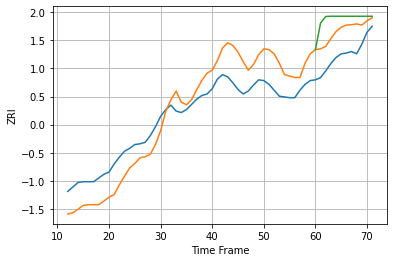

12601 31.55825636934725 33.189198390132475 51.128739384485826


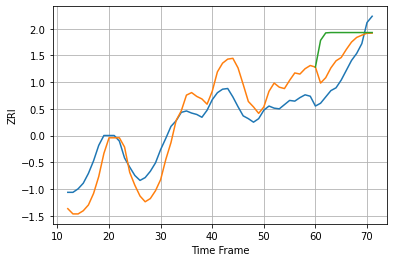

12603 30.93963939320331 30.64492717462505 60.166433538647574


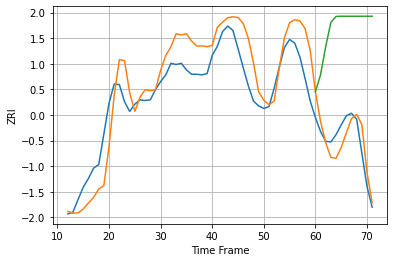

12866 42.82270621873436 27.77278775798914 193.46419755933778


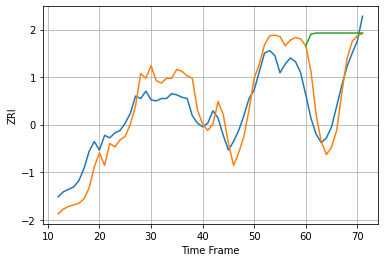

13203 16.68041302542951 19.450172364485702 58.244277866710696


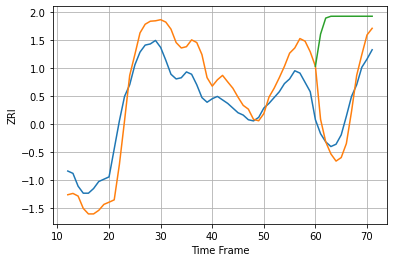

13204 22.37297467482712 19.466457844688904 79.15315035830355


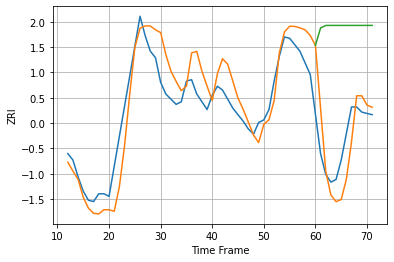

13205 18.324673948331878 25.214332738363098 88.36193422861561


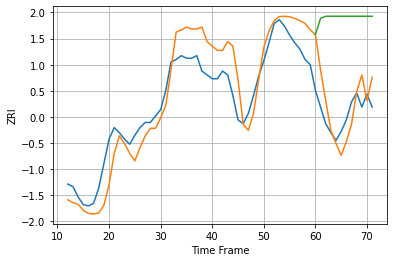

13206 18.63667488925685 20.741047460557073 74.98658157165494


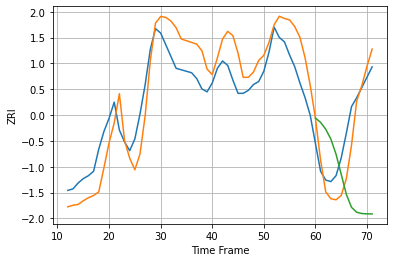

13208 18.857020178573112 16.66200230171472 59.34799224236944


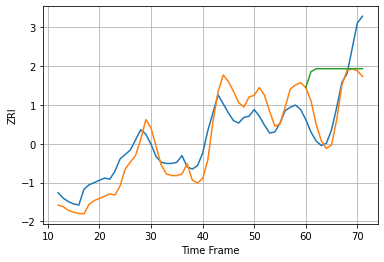

13440 15.978234645012796 24.49035167329944 45.95861893457232


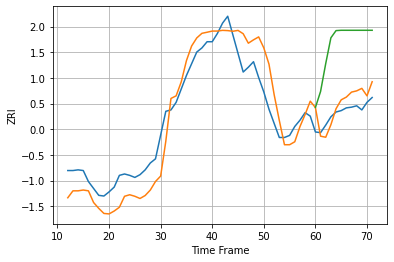

13501 31.895119812333178 19.965281663546563 101.87119898730396


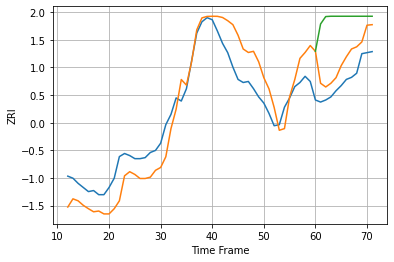

13502 23.081938466506667 23.932505774485097 60.96095261773817


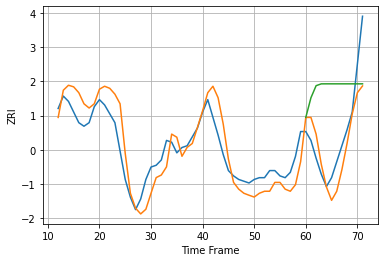

13601 10.991592241126465 15.632529253771043 37.299453218192774


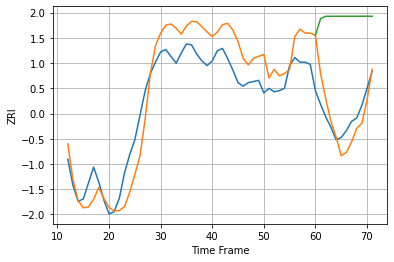

13760 22.122246351782827 19.8910584937251 85.20341273739888


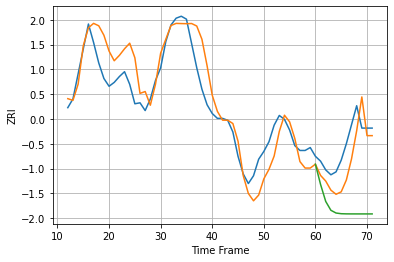

13903 22.854478669397313 23.598326556620087 69.03670393530518


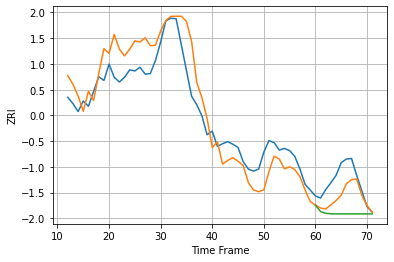

14020 42.356556539754024 33.8871977814798 64.91841054744238


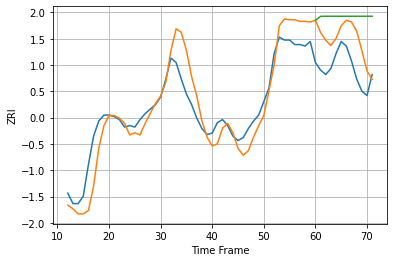

14043 13.109111097874706 21.22535848068196 35.98212878483283


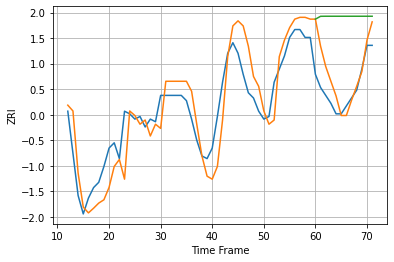

14150 9.52366232764578 9.232677770417933 28.087861316125377


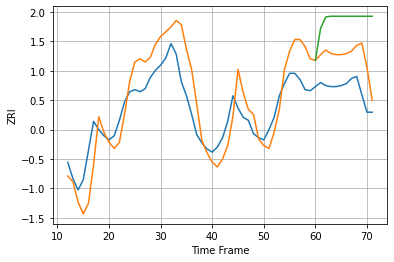

14201 25.958662558194575 32.45071693686203 68.88295541753133


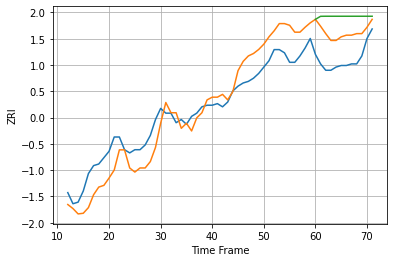

14206 12.602792464787868 17.975943409408075 27.874850522468


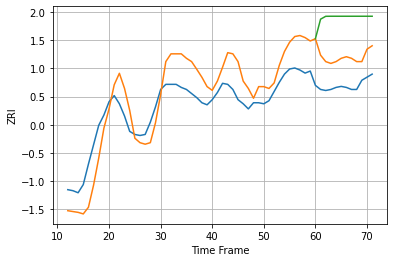

14207 24.07194651692132 29.532319442447623 66.15407082845184


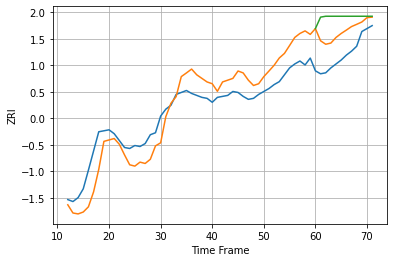

14208 20.27150842728908 25.787391870494133 40.65098183079244


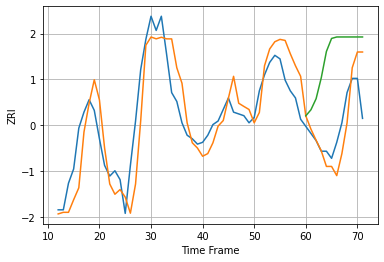

14209 15.23780542454856 15.081673927911996 41.048290690906704


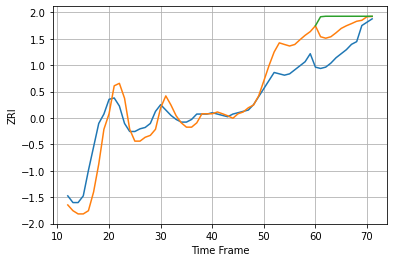

14210 13.126167205060693 17.99737859197838 26.339063257816992


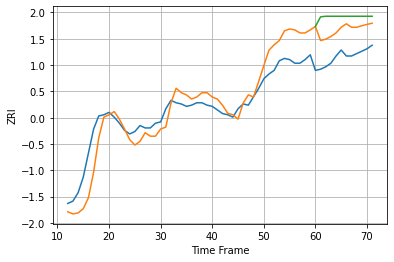

14211 14.914130719741411 23.5376993129505 33.89501767224575


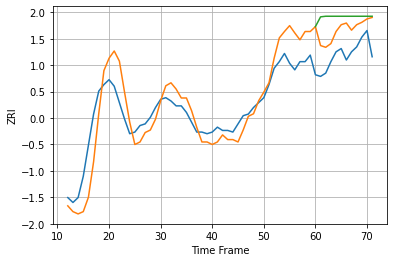

14212 12.711557090217816 17.15322486391957 24.8486687195047


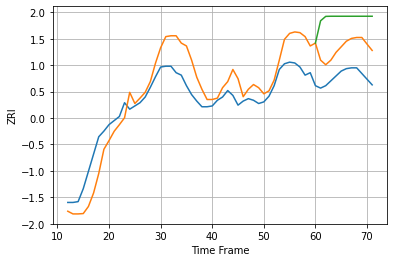

14213 27.022029693906855 37.10834272616572 72.869759408166


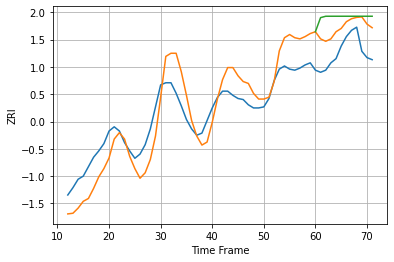

14214 21.72225636691496 25.8443319180945 36.71014230367158


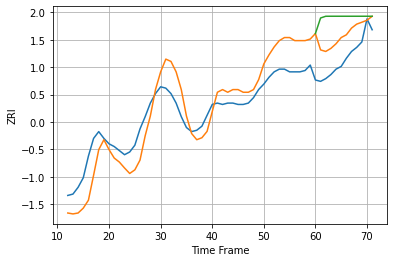

14215 16.043066732255102 19.321132472637558 32.66259735505765


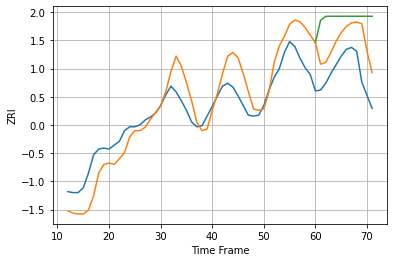

14216 22.714260704791045 34.7847731008422 60.59611675994588


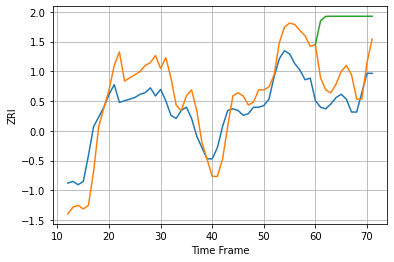

14217 16.146494677770637 17.173084901645478 49.685542211168745


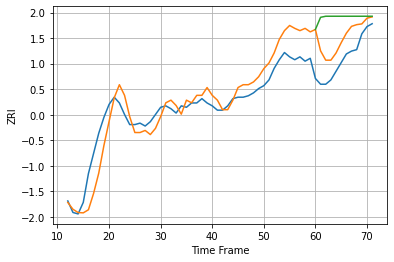

14218 12.127612713922112 16.877479531167605 31.647818448038354


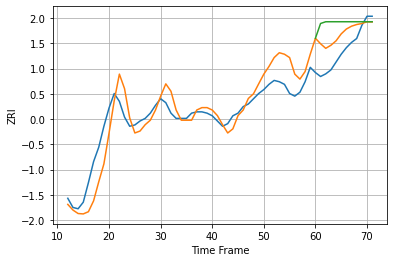

14220 13.19694516896218 15.966239504502594 25.291156171952352


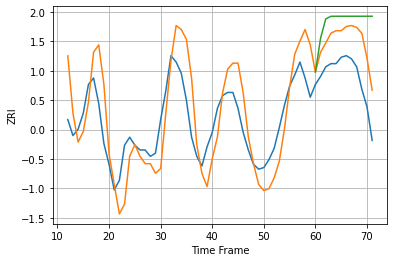

14221 20.332230148763042 22.522609364500397 38.27910619085872


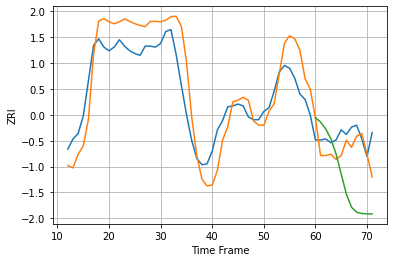

14222 28.131913891467253 21.655801587008067 59.66675494262839


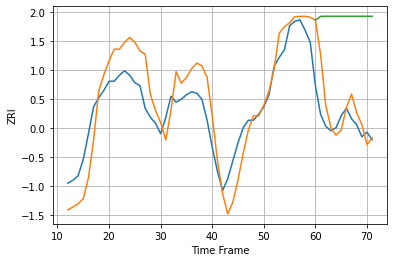

14224 17.4711031523529 18.941563690173027 70.84871296948631


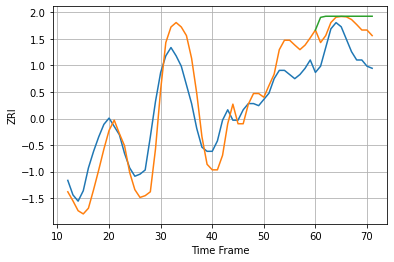

14225 12.192094700665887 13.000697240407414 17.749060247901383


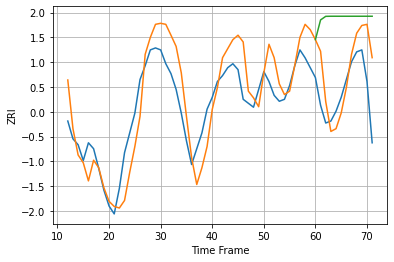

14228 13.70160390702137 19.07387424953743 40.11736994238509


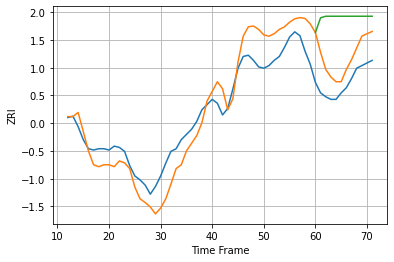

14301 16.264167099335307 21.64514171023477 50.96148956204059


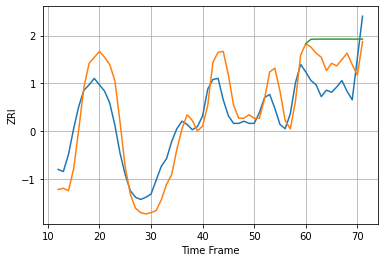

14607 22.13994208236385 27.198323985026626 42.27663741418608


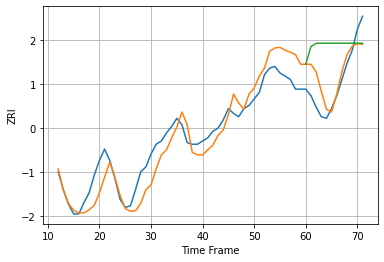

14609 10.71722771579092 12.28259644348299 29.721677954814318


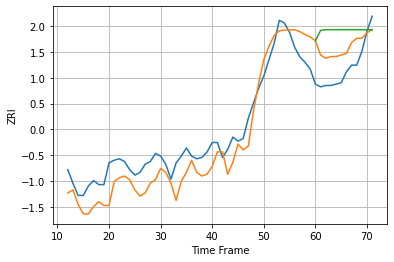

14611 14.742960472236755 18.93521337178808 31.565881536514155


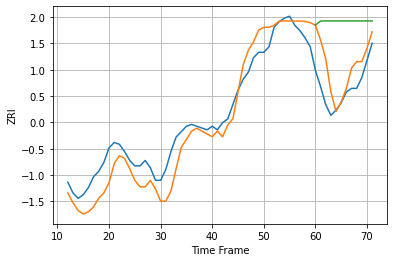

14613 10.087237968318206 14.783882913249617 37.992432943116086


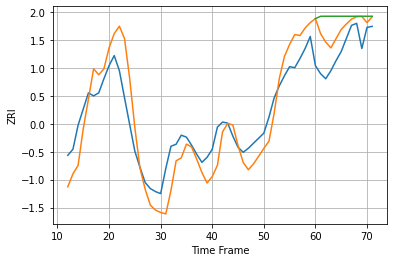

14620 24.13789205108519 25.761540686276348 37.90179122204615


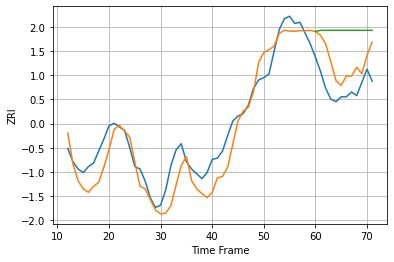

14621 15.102124574765499 22.989672858879754 47.5882737032109


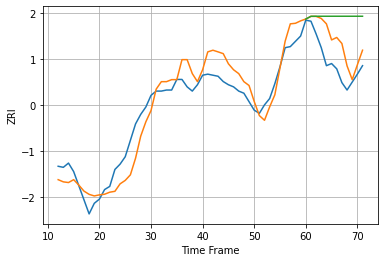

14701 15.8056310943832 22.68651753077724 46.23283336722445


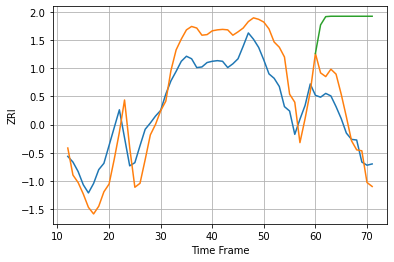

14850 43.66223977507167 36.34173445958876 175.8875453551399


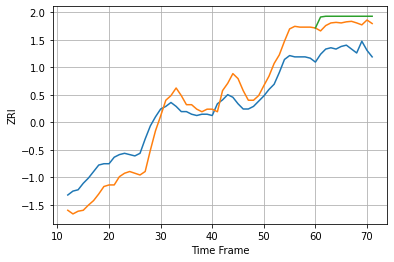

15202 15.08696678095493 20.612636106273555 25.554881228392443


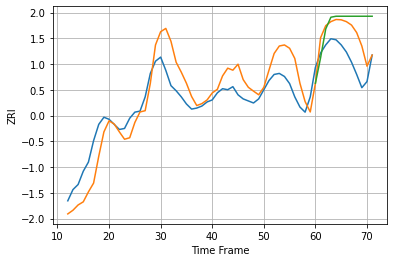

15206 20.998509219235753 25.682763695340803 40.09430182262615


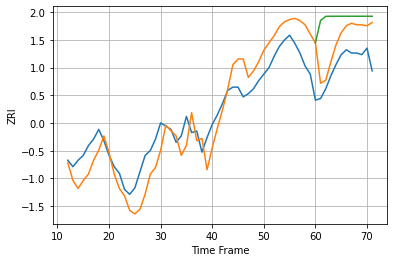

15210 13.932726371214427 18.34423648118894 31.427207088030563


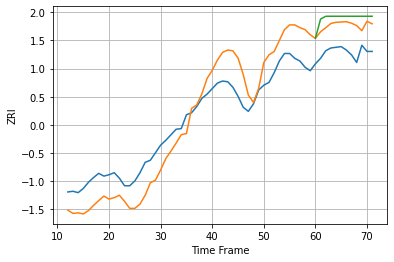

15212 35.25903178505469 39.23069352558374 50.22089409864452


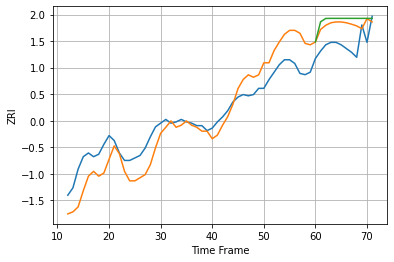

15216 16.178799348678623 17.210533973824955 20.607133798781135


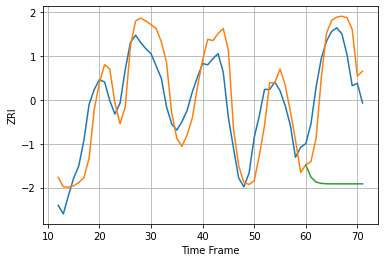

15217 21.76947512863242 24.68267797753652 94.01642872532658


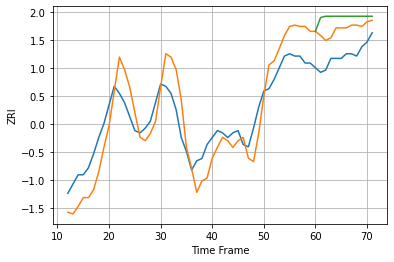

15221 10.591436333891206 11.943460092864077 17.015888104714612


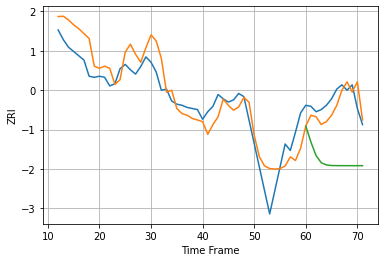

16365 18.060552598611824 13.257731254392084 56.316946582576584


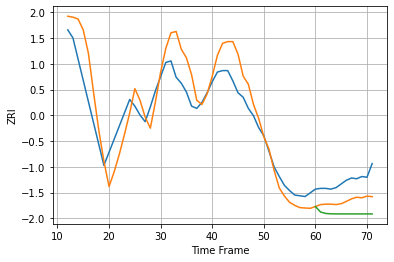

16502 31.82853204864684 27.120472176490203 43.77931698765225


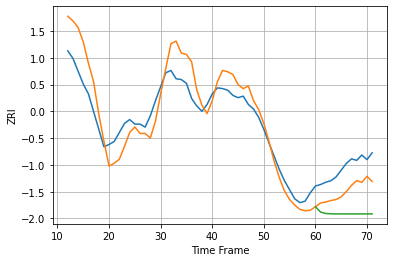

16503 26.964541525652447 30.839140583907533 60.59576276680182


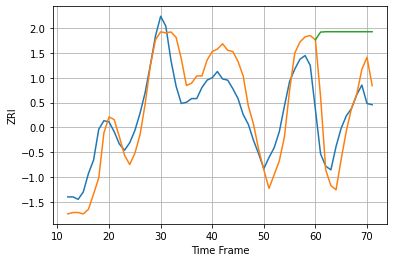

17013 19.85199007700743 28.00656160791419 77.75485583261693


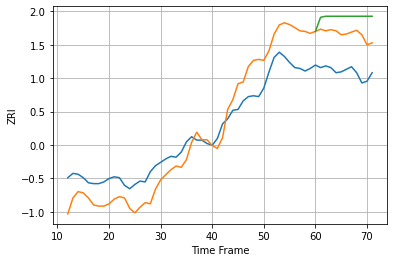

17022 27.890756662104785 44.381025859999774 63.71750255482566


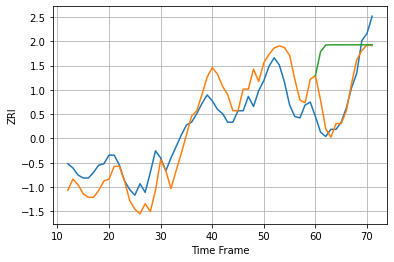

17401 15.441097357126829 12.99205406568861 42.49887974557606


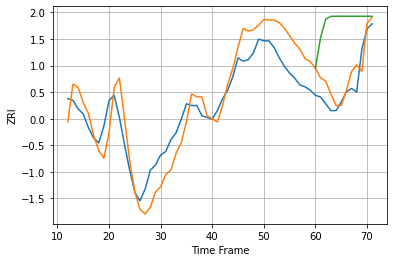

17404 13.70585667472154 10.061177567244345 39.62621775356483


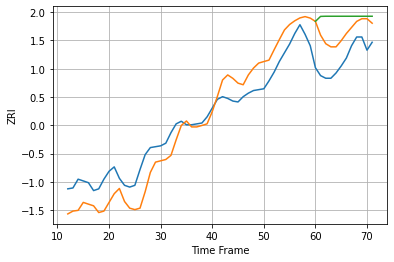

17512 23.712116074594917 33.137881082609084 51.30739309746058


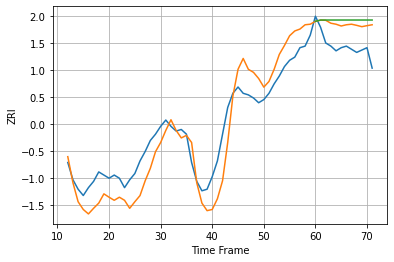

17522 14.182872130725361 15.384521854769583 17.960941817072424


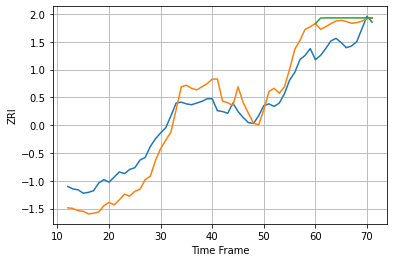

17543 22.80015725792324 24.465634165543822 29.546229229298707


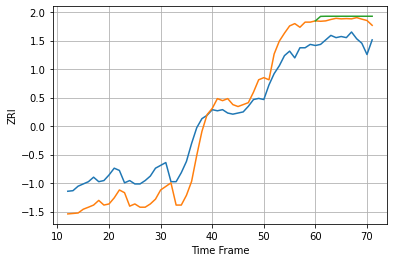

17552 19.758154452302396 18.80700711136966 21.69354780140886


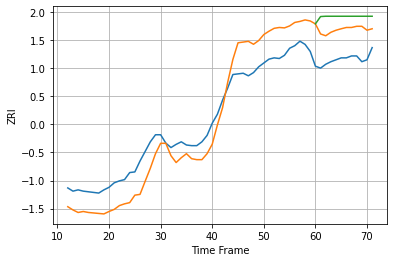

17602 35.550194874375585 48.207477666645076 67.23549850898267


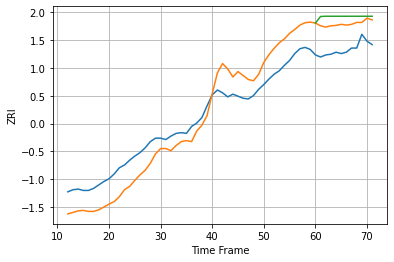

17603 30.930830645383235 38.43036510415812 48.5030719230063


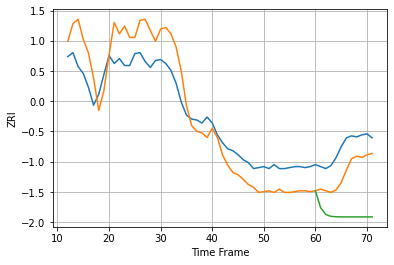

17701 26.060761704145232 25.792385854126376 68.01963821402124


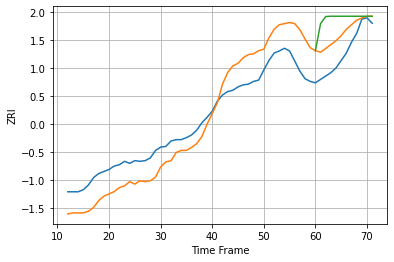

18018 34.728895180267685 32.40059885746368 57.0142252839883


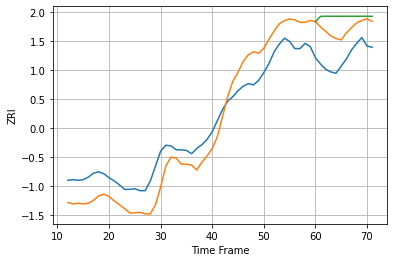

18042 34.67208825620559 45.83684944680561 64.82819023401355


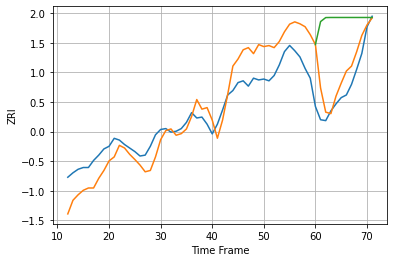

18102 25.51351837277302 26.787038438920597 80.75528013794263


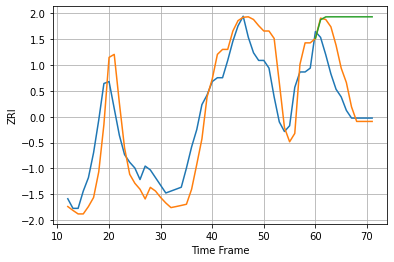

18232 14.377574451932357 13.08483336964753 41.618145475707884


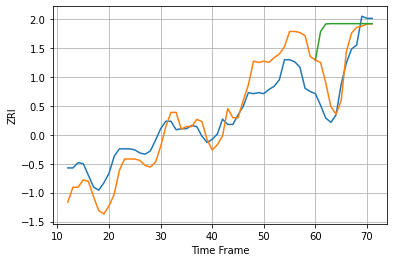

18951 20.338283971154603 20.340289095732626 54.367684716570345


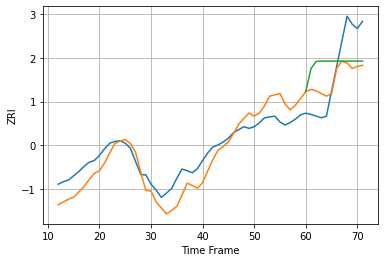

19007 36.92050377116642 70.34319869392343 94.35256426439453


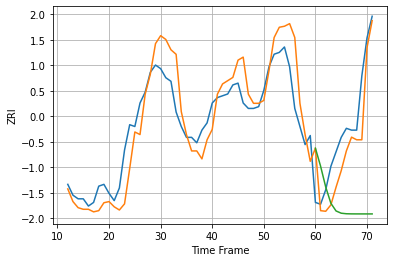

19103 13.890060355066613 17.60393108816799 56.56276094257789


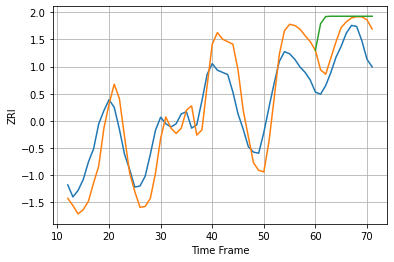

19104 24.593658458187292 22.247194509236 39.78101655686571


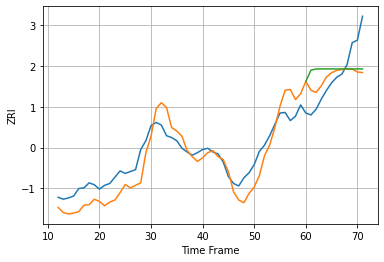

19106 25.987328153563958 39.29516580884923 47.31301880854999


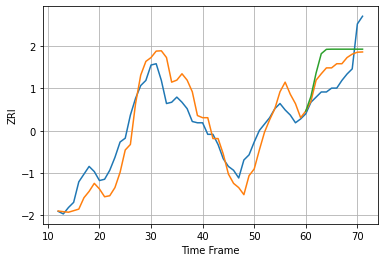

19107 15.169547908646894 15.988407234471497 23.203967665750525


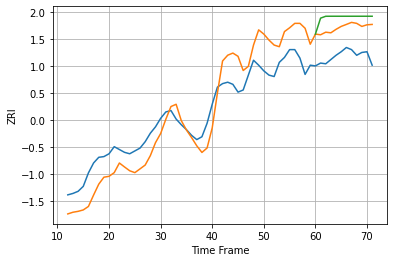

19120 32.80764025435185 41.148042542417066 55.461676244349206


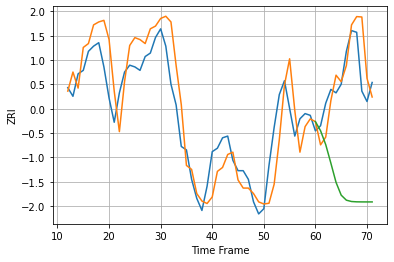

19121 16.29694360978473 15.62664158138097 63.41094548330327


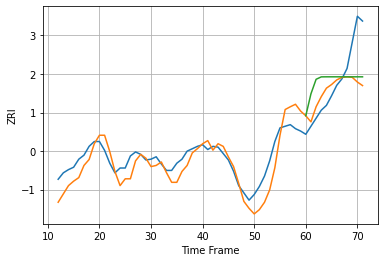

19123 17.6292925623893 37.55428965107981 41.47117667633988


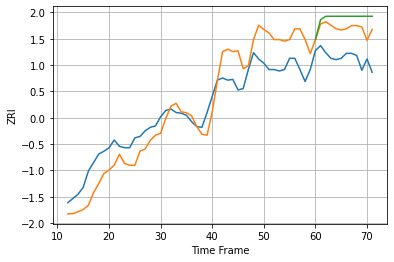

19124 32.35143893796594 42.43176049892138 57.55982231671048


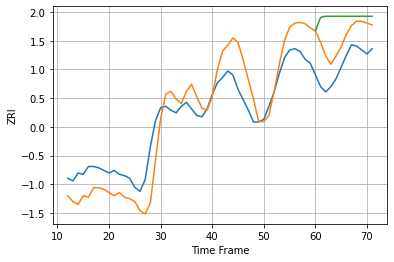

19128 18.516293990185513 22.526984128543713 38.70668084761546


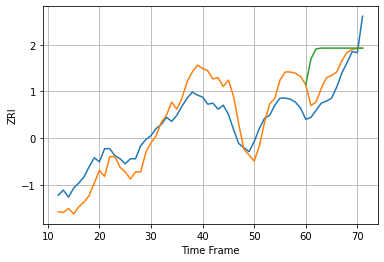

19130 20.148216795550418 18.536770350706266 40.50299231164496


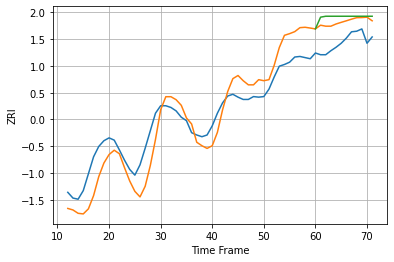

19131 35.39626008207637 37.54898811972866 46.73419799755419


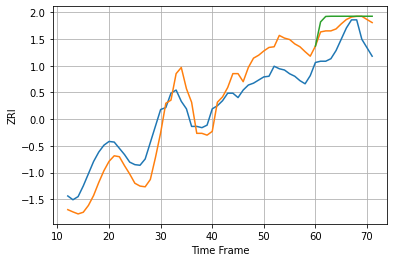

19139 36.417598425909105 35.883850872408175 47.45632930944428


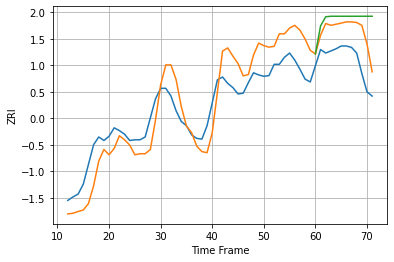

19140 34.287561575186004 41.65271616500095 63.039288150561475


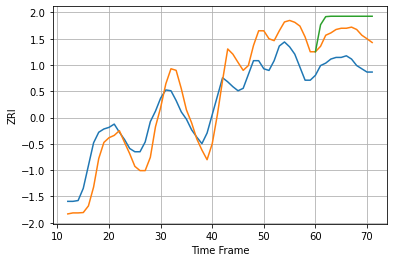

19141 29.078590774951167 35.86021616492995 55.47729499958206


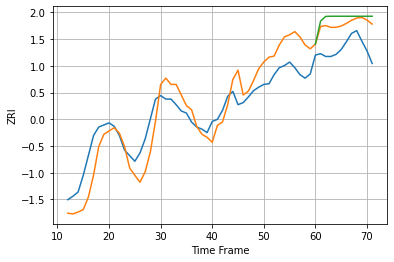

19143 30.729606739248332 36.20505166676513 45.585880499900256


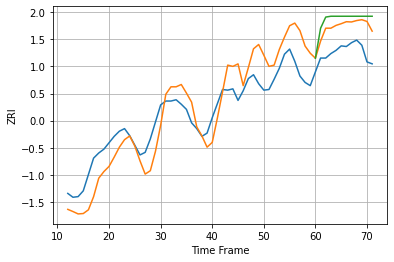

19144 36.060280843033425 40.018874613175434 52.405816305135225


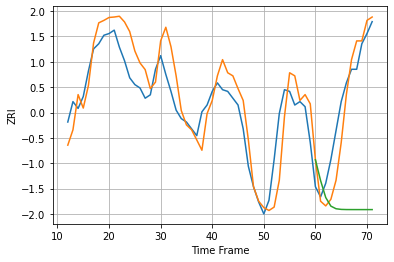

19146 15.101159801969231 15.39070285047871 70.02175677735113


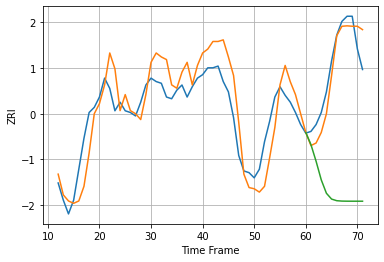

19147 14.263160725329199 10.557886596144813 75.86826774134748


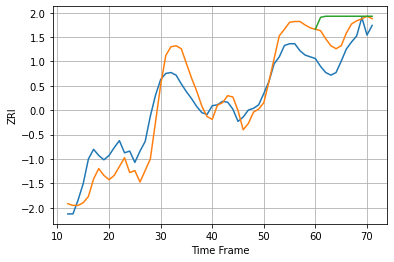

19148 23.436508224407227 25.941884893548313 43.9579798475079


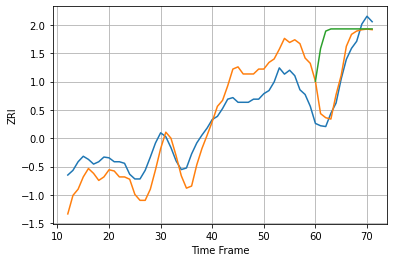

19401 30.477695867806347 19.693860264312 67.68776146550685


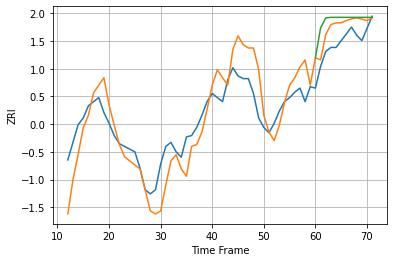

19464 17.849960976634563 13.064532124850658 18.10775692251105


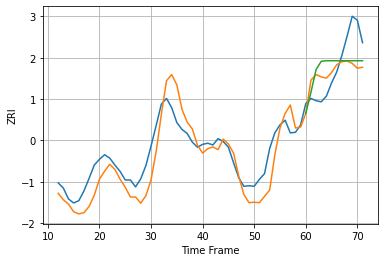

20001 31.755810240358432 44.92295806472125 48.15713551778901


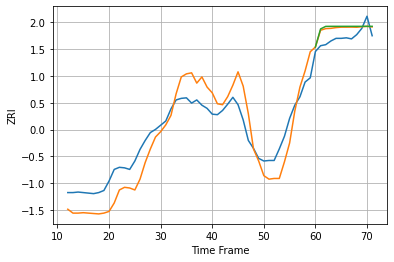

20002 39.22853289960237 20.584347502692804 22.56334657071829


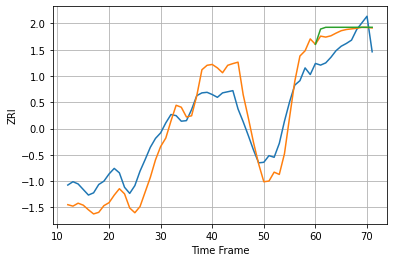

20003 40.89271574620367 32.545166757741775 39.97115643058446


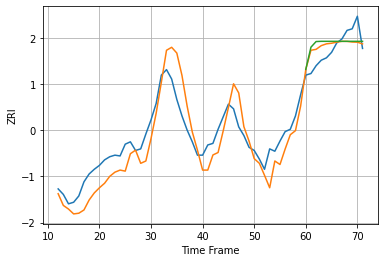

20005 25.555508913696254 17.742239087789645 20.228760101761655


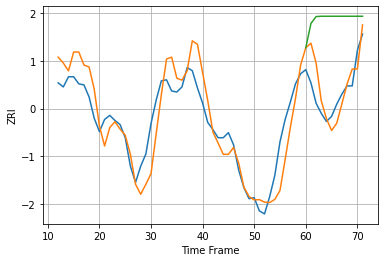

20007 22.135483328562717 20.50590888699232 73.55735559283302


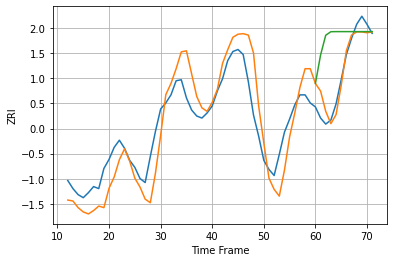

20008 24.91130602394301 12.828823256263513 48.51624213482448


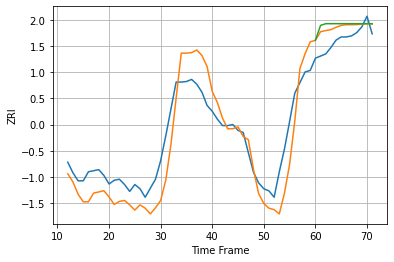

20009 45.53912973747346 27.610726244706694 33.35685327582958


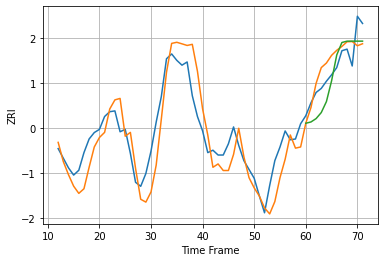

20010 28.21394906170097 21.457843362368816 22.69489564747269


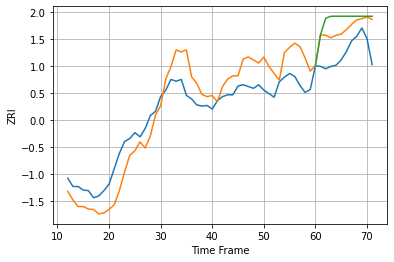

20011 38.60061112290985 44.0511421694125 61.07861734556115


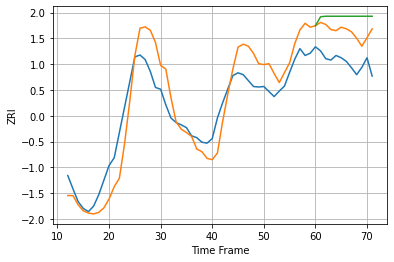

20019 51.553621257645354 68.26129997345141 99.17934861170923


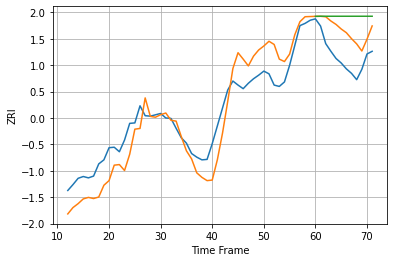

20020 47.430474549459305 60.95514526069494 94.14824635586358


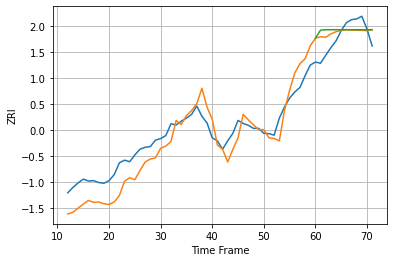

20024 45.2901946643326 39.02029646817304 44.945023553629426


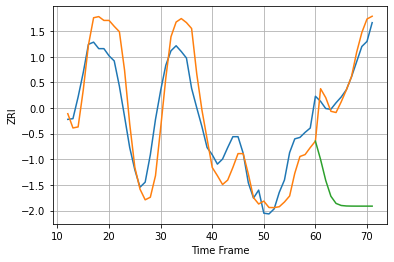

20037 37.742119999577454 22.771158312400466 168.47148867421163


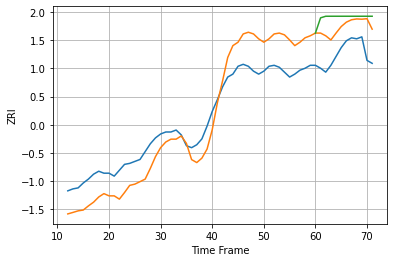

20109 25.153282236677995 28.71221477775311 39.35380851094474


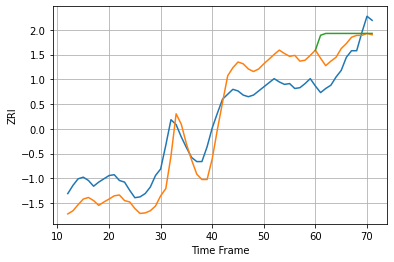

20110 28.58090307987319 26.21026045511009 43.335282538875695


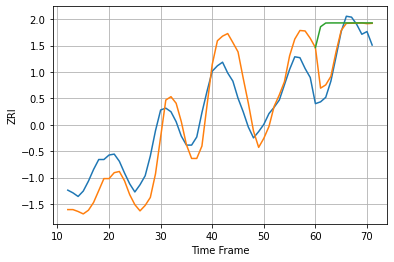

20147 26.708841449552633 20.971119709954074 44.9519120392158


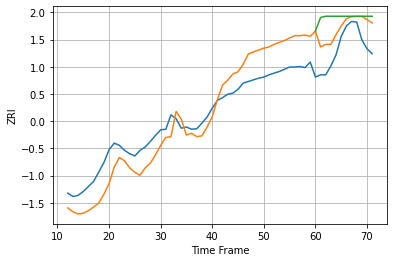

20175 39.02330981089906 44.24027352393862 66.46392915151404


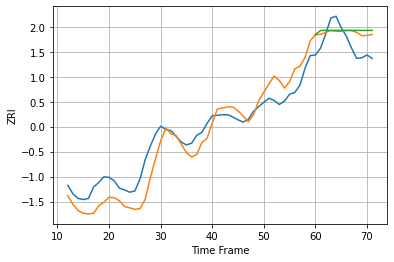

20176 29.066931373538047 29.797857583062612 33.505255690034005


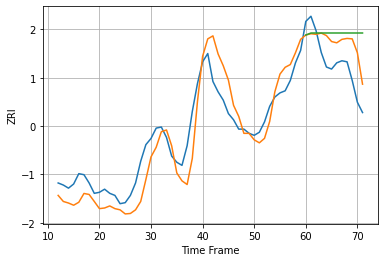

20740 20.313968543924446 26.46265972670988 38.59668256495226


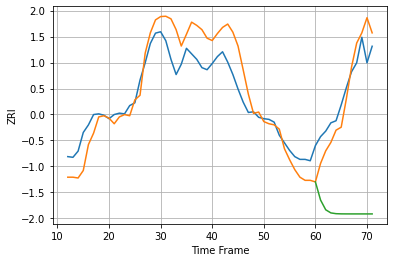

20814 32.29023983200187 32.84829807004574 178.1778815197785


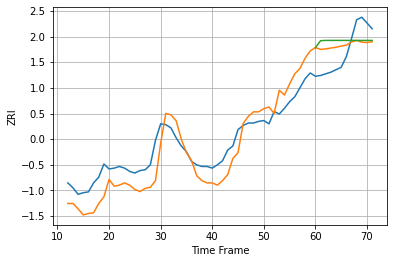

20850 22.52330425629078 25.892019525009825 30.30069335901161


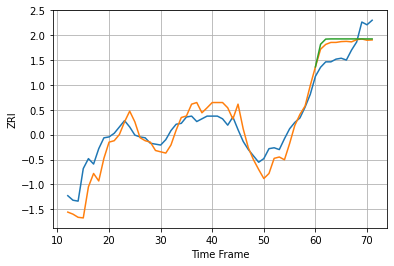

20852 16.739575426179737 17.441977729862913 19.822261549919535


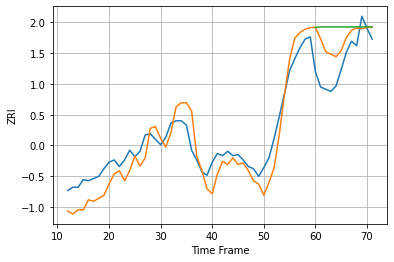

20878 16.56159437224396 25.506638176025124 37.84333935294068


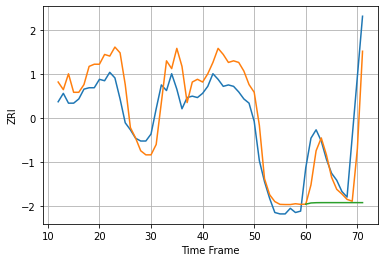

20902 15.783760114306622 24.947949091888972 55.639126399752705


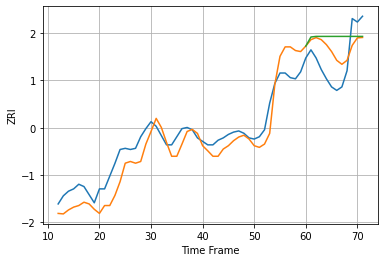

20906 14.41890493834389 20.710022047987966 29.258394807794627


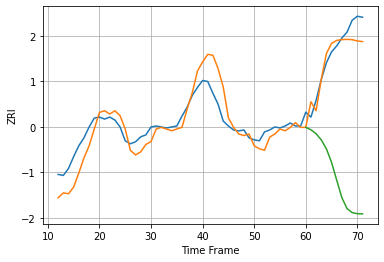

20910 15.559161862424778 14.313922079465714 135.1444120634129


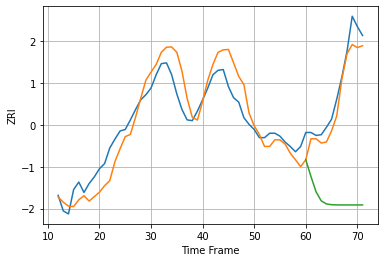

21043 24.974280155725292 20.827125329149595 161.15155774545917


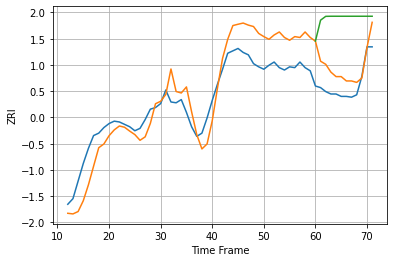

21044 28.598197861408913 27.721163604046932 85.01807730923645


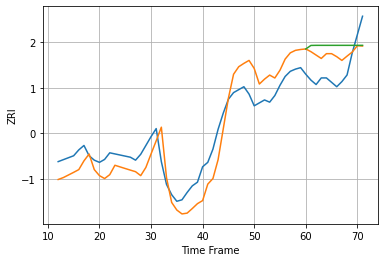

21046 27.09877895116071 32.470972644367095 42.702354478483215


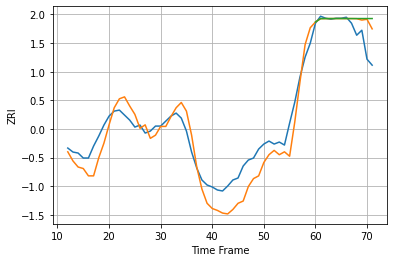

21061 17.310086913793313 16.657297410368653 18.891942673596162


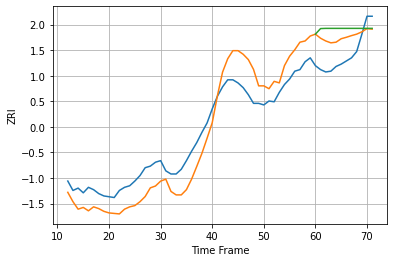

21117 27.696493640841766 30.02053375070773 40.19352170496982


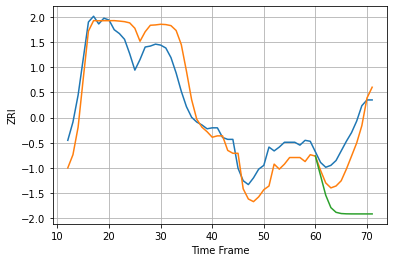

21202 22.44744282730282 20.668115536964432 77.99292268997189


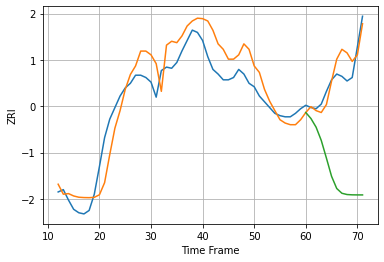

21204 18.308822733273544 12.293453424538038 87.53617828162012


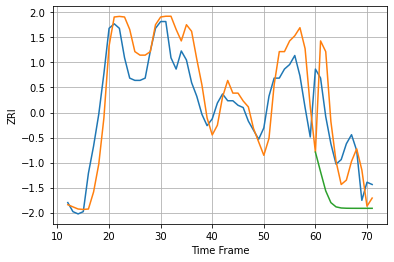

21217 12.257648169538065 16.799762571292263 26.46394357102267


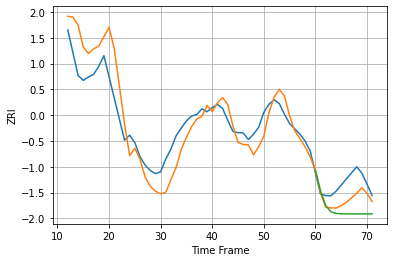

21231 68.08456764855984 52.20843160678219 90.82680613447245


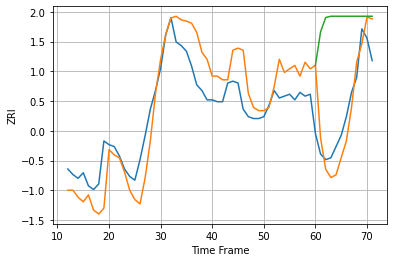

22030 14.928364565302576 15.551403167044732 51.98348054943863


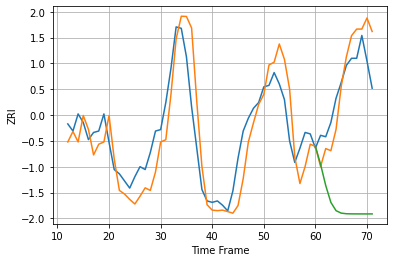

22031 19.545020451475178 19.68509212427505 86.02978607559783


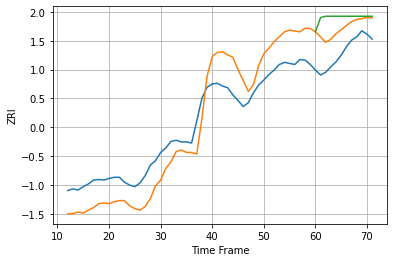

22033 46.538174237877406 46.639340392904245 68.12566732800398


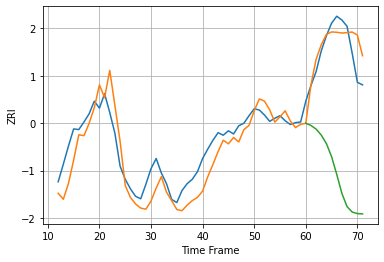

22102 29.63690308653667 31.64034799762249 199.13385498009174


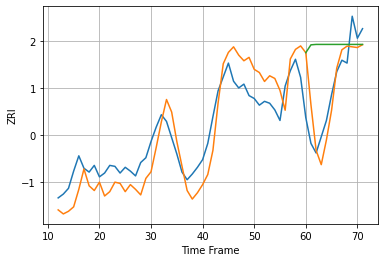

22180 24.633403873752883 28.33908419352794 64.020038313896


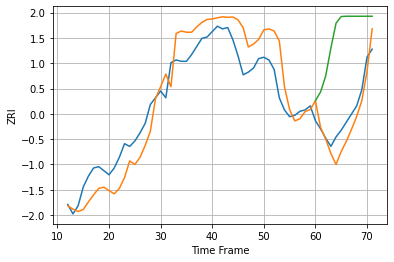

22191 17.41836902552793 11.94179037126203 59.75191726323214


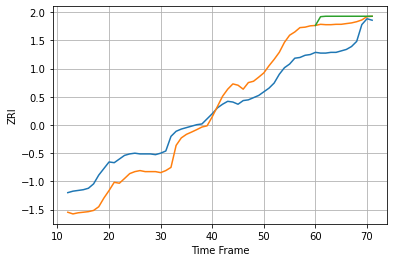

22192 27.902526381884986 31.296168984770926 39.426963608114356


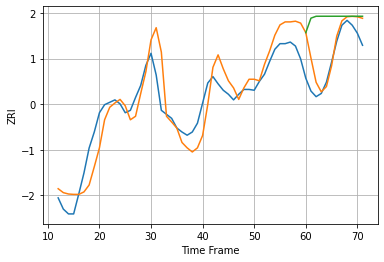

22201 25.604949621160358 24.241112143945493 60.37355909636073


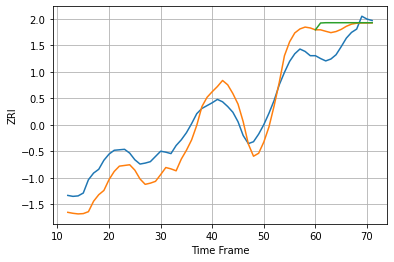

22202 39.770972337622915 39.42216417978726 49.863316662677


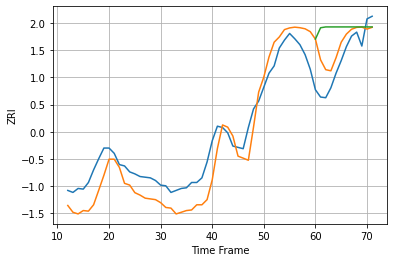

22203 32.066475519392235 34.905658572563844 62.255161381760026


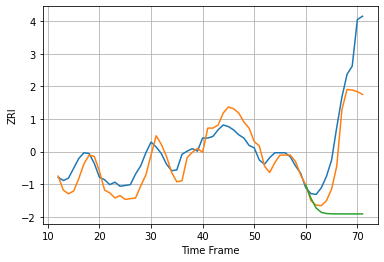

22204 15.967389430125543 44.238584277605035 134.18767957208988


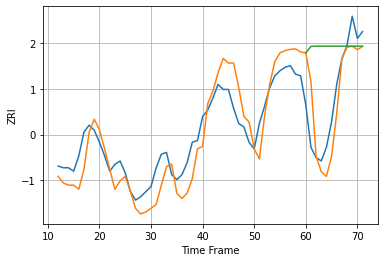

22206 12.561799322938226 18.00085198666045 40.561957412634115


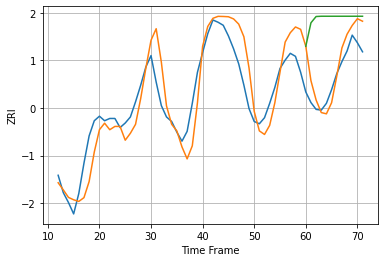

22209 31.035169533244165 27.012296623200623 83.28133093306742


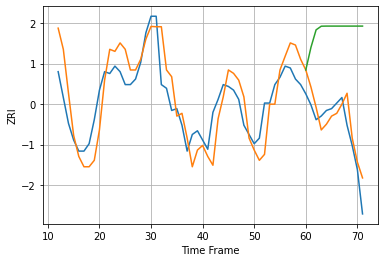

22303 13.65999094798004 9.956479115178865 55.23383410555903


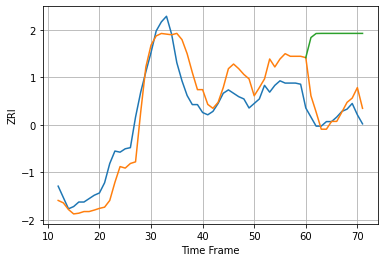

22304 19.259948187898285 16.773015125061473 72.14251893615014


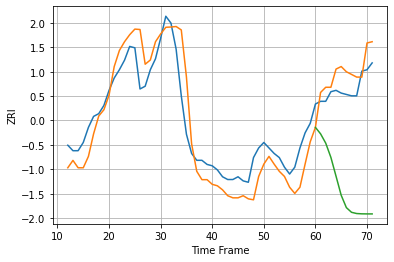

22305 17.320020585913845 14.144467236774469 75.76294199729985


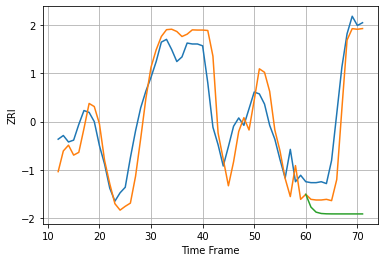

22312 26.858524379687033 30.00998044741815 133.05168329711395


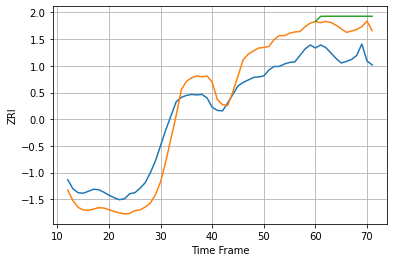

22901 43.06272689466026 59.208120745445726 78.4545770644003


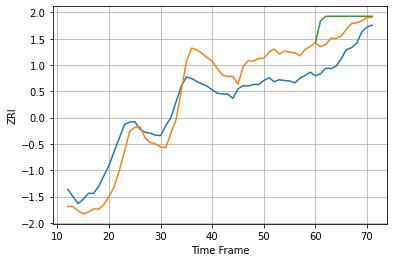

22903 56.67223330059826 57.86643387118058 94.8700529222963


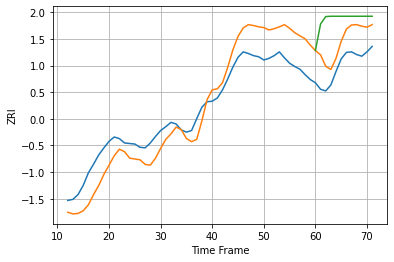

23220 41.14203588285701 46.73738227920897 89.45435739163067


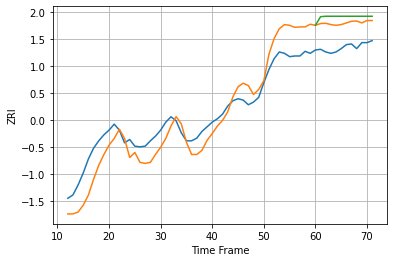

23223 28.015406310556397 36.76054016147214 45.84266339561748


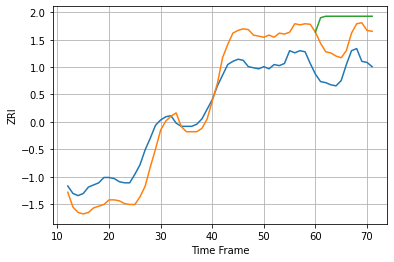

23294 22.0424060050937 29.038781669967957 50.84308304437871


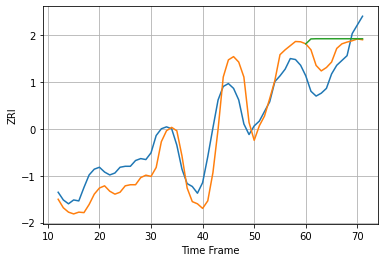

23451 22.284408026326435 23.829865309960173 37.859552607922694


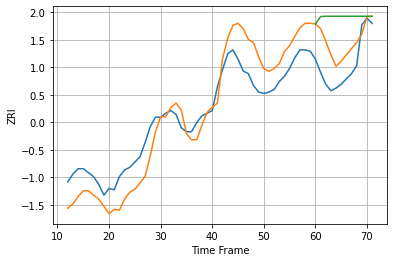

23452 17.600600260501842 20.95521182353122 40.35846494510862


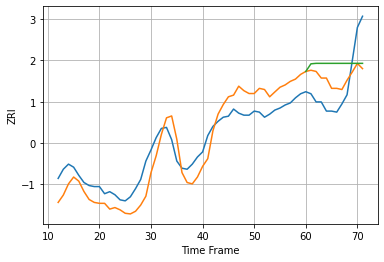

23454 18.292708677492897 27.1713030822442 37.30024157944124


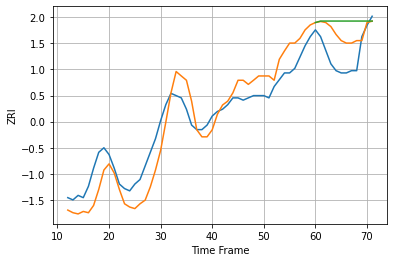

23503 8.926864971766788 10.951412324495386 16.118696322203697


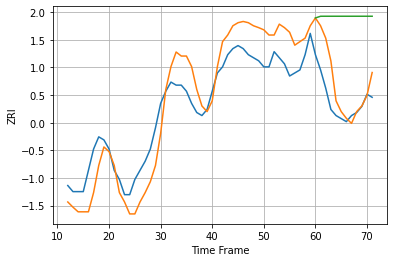

23518 8.670855909443054 9.057637782179285 28.377300475373545


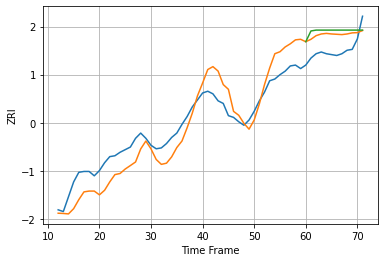

23602 21.207140728010977 20.90723447133292 25.060190544385218


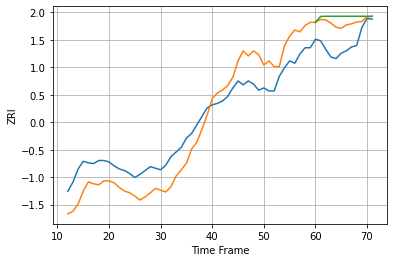

23666 29.738560753431987 29.34395909102207 37.22974645206211


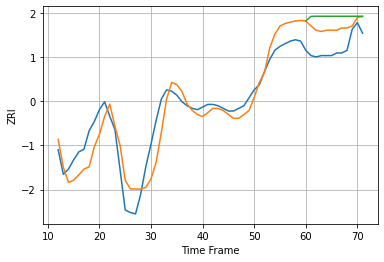

23803 13.488494747481827 17.331946101126267 24.98741576801703


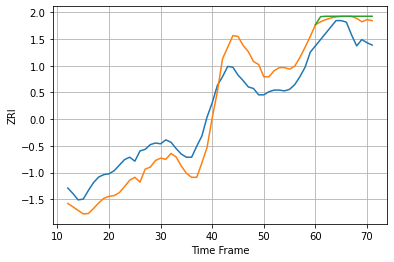

23831 28.4617534749658 22.034488673025024 25.16894119097211


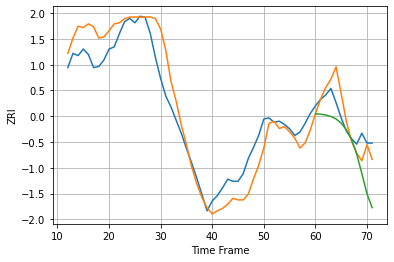

26003 19.596983931725077 15.12130941445178 26.71775502503669


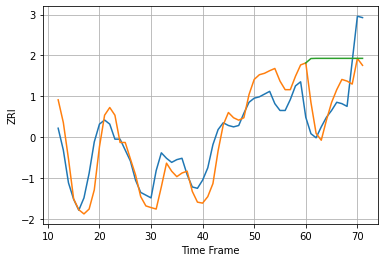

26505 14.783452592426299 21.306344325174177 39.845021595142484


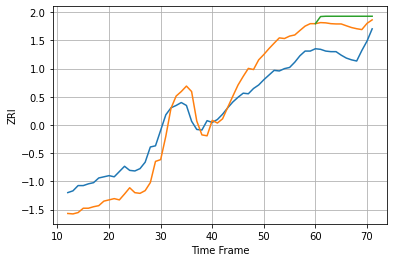

27513 38.34759460611832 45.85411235859562 59.537222418396894


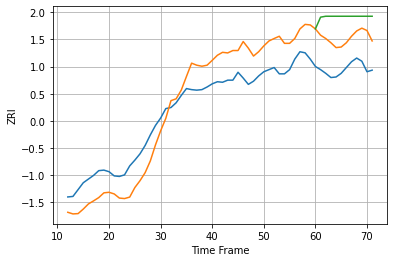

27560 47.18545293490112 60.650746218754584 99.04384502308662


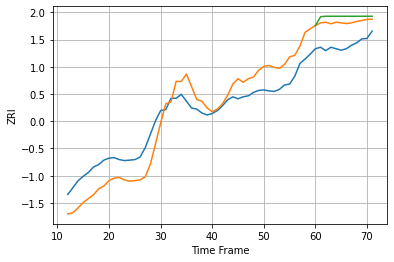

27606 41.38576015166859 46.94392511021089 57.780890159199835


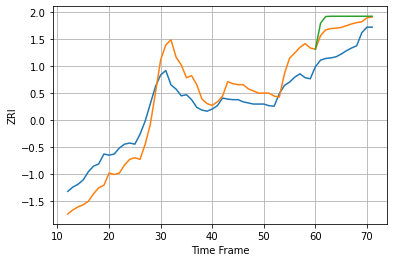

27609 38.76180873882489 41.30644938959654 57.14725320351226


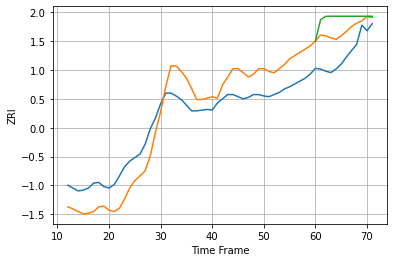

27612 33.180027707176265 36.434575052046604 55.32895560233371


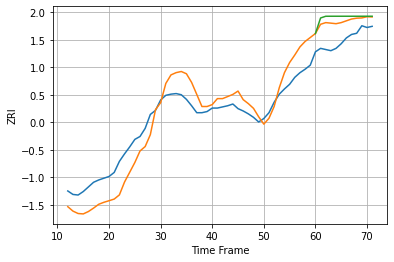

27613 32.27746520626279 33.31314328123593 40.90552907179234


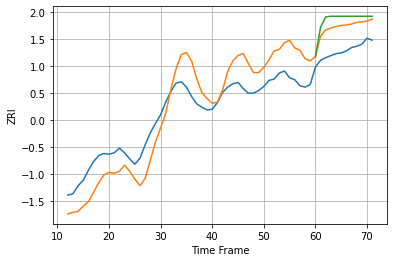

27615 35.38491482856471 35.376328223395696 47.325706718084476


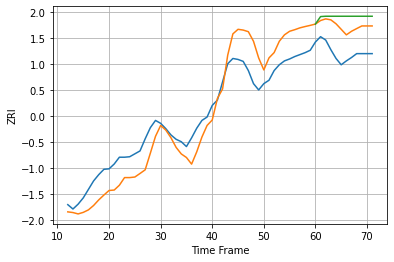

27703 45.4540537542185 55.566418895236886 75.05967317197396


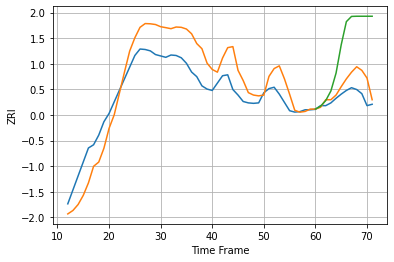

27705 50.738839615843524 30.303558933957536 125.67904544860716


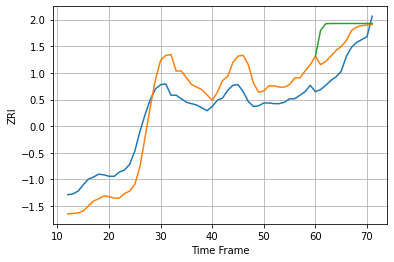

27707 32.247669820327886 30.41898476365325 57.06587569864707


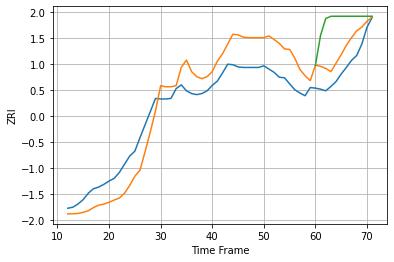

27713 42.76365242784828 35.309884705433625 89.15771988746107


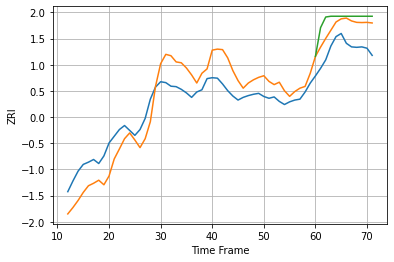

28202 46.60662349439824 50.90459778248695 69.55053811190074


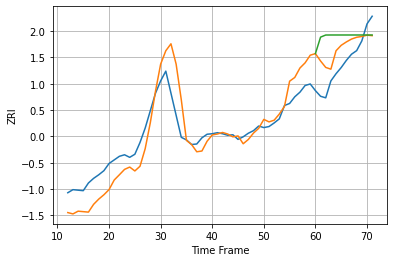

28210 37.95571639117317 43.46378580343304 69.47011538609146


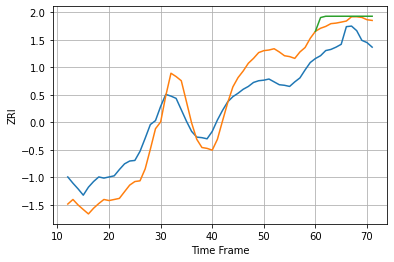

28216 39.608526657962194 38.902480579121985 47.735042810487705


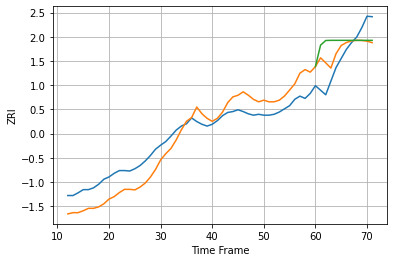

28262 37.22165438493042 42.60570912430379 61.91256165245526


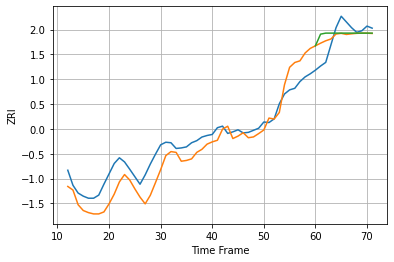

28269 32.02340331191155 26.288502010713234 31.28634707690796


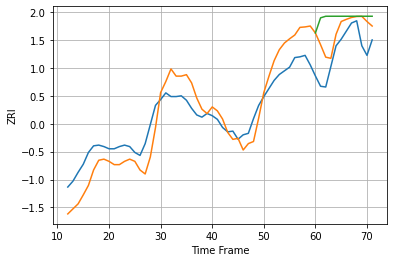

28273 28.129718955602833 33.68516981349691 53.666650577969044


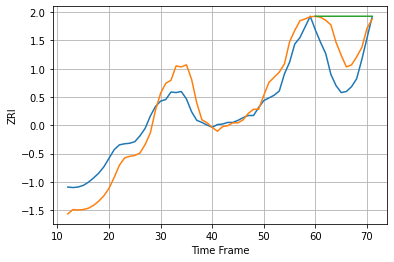

28277 33.463484637773966 52.60137872125663 98.51916810245609


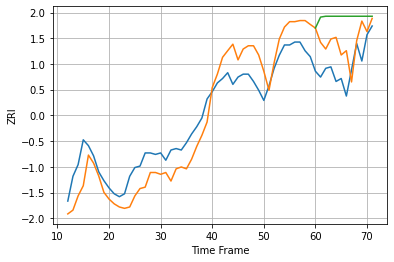

29205 15.92619992744826 20.35415884027718 34.99092721736994


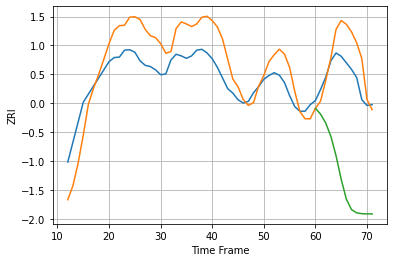

29403 64.91452083431282 62.65922600687851 251.47622201651126


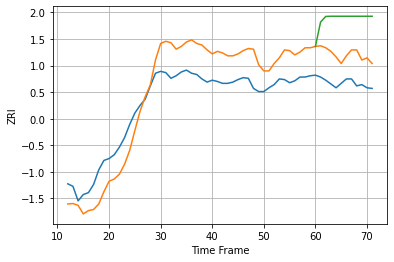

29414 41.07000083546882 45.82580857615621 101.99635047370725


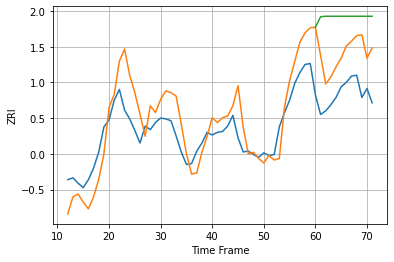

29464 27.57815979505879 49.35054602835533 87.47970494481791


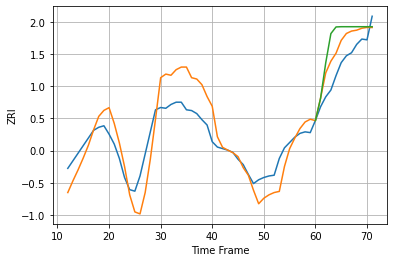

29607 29.234373436817346 24.147860104413354 38.591073301113745


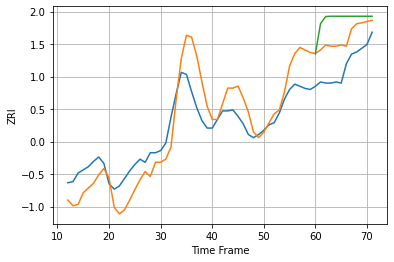

29615 22.678744071304806 27.84380621734882 46.026584330779826


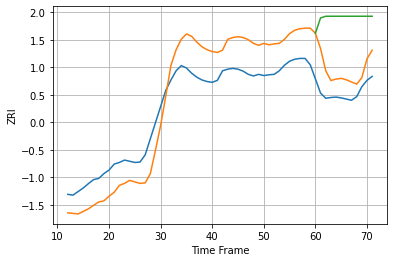

30024 69.3944689655499 64.42610802282464 187.93354306030457


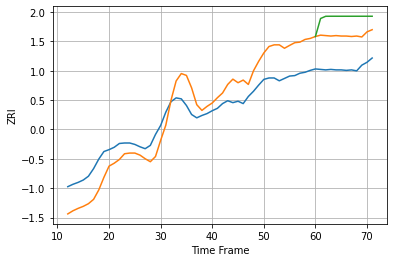

30043 47.60607419541959 68.96325823233755 105.58170810966257


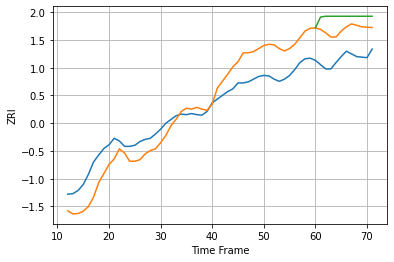

30044 39.72028661620085 55.59037314369241 78.54685000065592


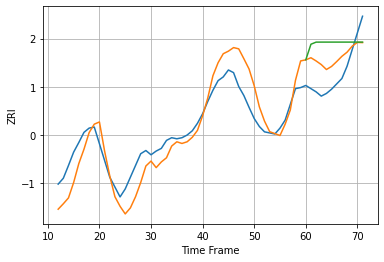

30046 36.50409125004281 44.099897814878666 71.25556410447436


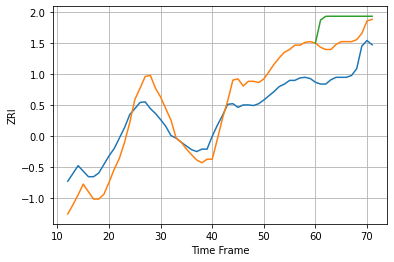

30080 37.09134255310431 51.139803697517415 86.78538234057395


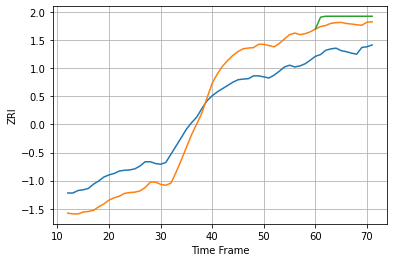

30093 69.83697610554545 74.46919890629937 93.96531745152436


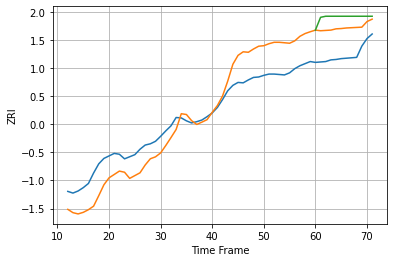

30096 53.402938978862636 66.68474187005695 91.58259099087147


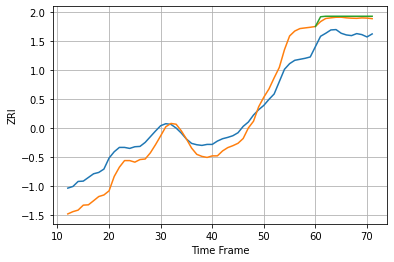

30097 54.59212602574745 48.11125657921328 53.55982951760719


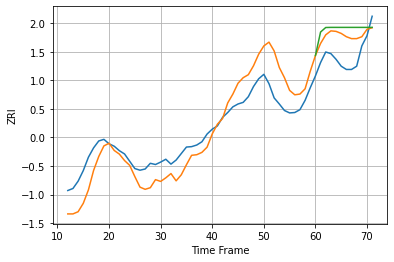

30305 51.06593730425837 57.236241579882694 73.6656337749238


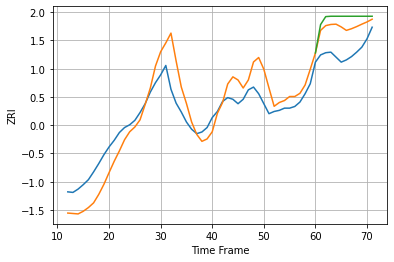

30306 37.94442535036856 45.677361547723805 61.13092920329022


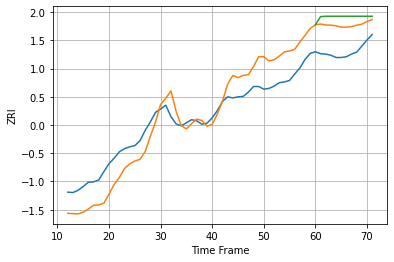

30308 54.622969065524316 70.511188310564 91.44812330473887


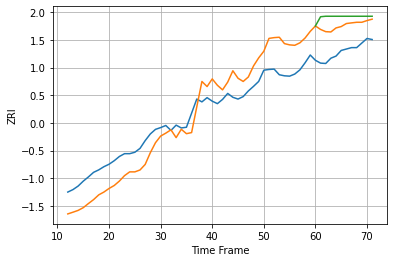

30309 62.04103314883488 75.31440032082631 99.92678208035639


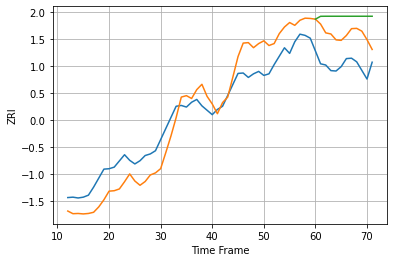

30310 52.69396549914603 80.29318773795084 122.24061843481876


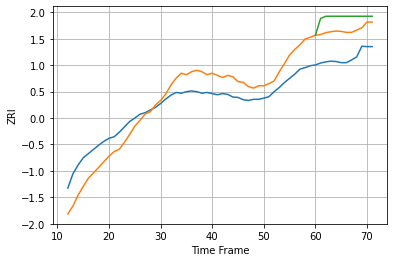

30318 48.98147876548749 72.74512625245387 105.93386767188491


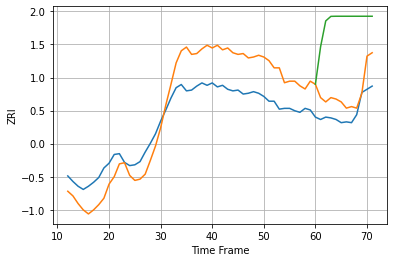

30319 36.47369332339 27.534669997808745 112.57848117325035


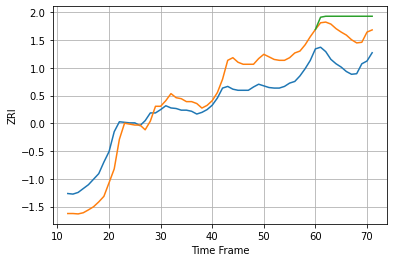

30324 38.22790684298926 54.42540278265015 81.91873772602547


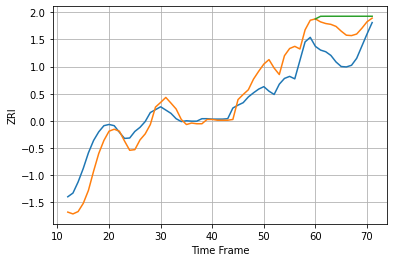

30326 40.43764659954383 65.89006052442083 92.43786595126564


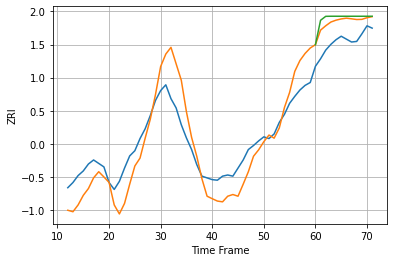

30328 39.93811394759773 35.040112384140514 42.354414848054084


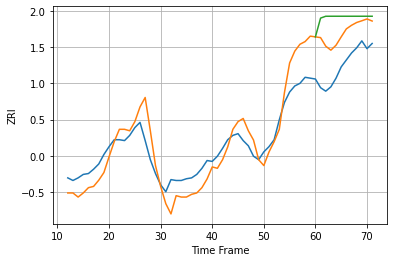

30329 22.089924295511537 39.12153236383607 57.921696892851976


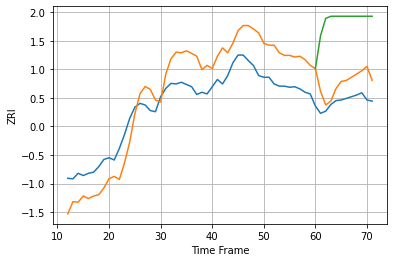

30338 50.147123654715564 38.97327480158751 144.7403309853273


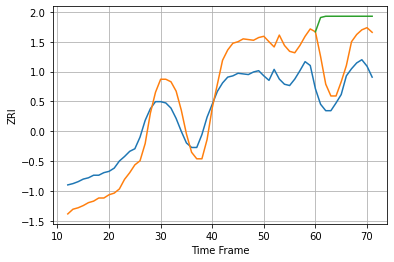

30339 40.88496598401313 50.385902085290816 108.50843070885237


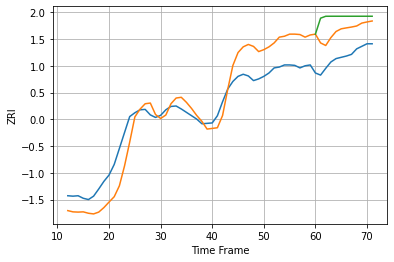

30341 50.06838757917632 63.98784164211934 95.36444201485108


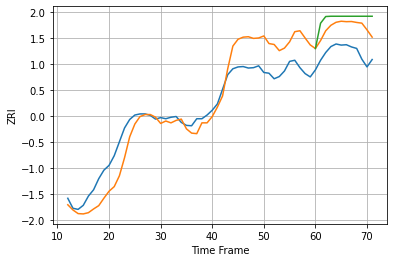

30345 56.70674602135242 69.05809933492597 94.6388902234857


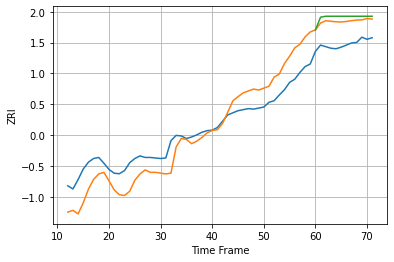

30350 37.68236660797486 43.76646345747764 51.74016097921002


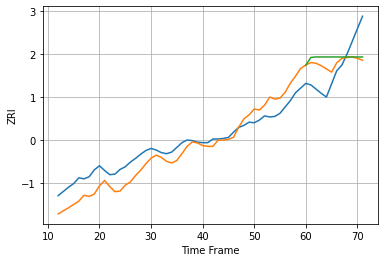

30605 26.969710607042522 43.91481036208527 51.45518171678113


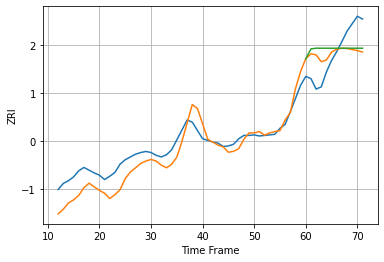

30606 25.16307704347063 41.30829746173136 46.48141964730447


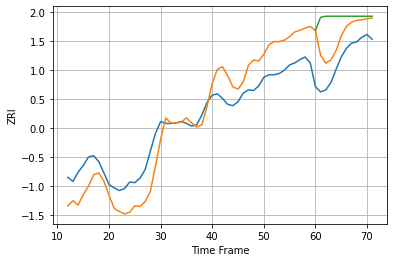

31401 36.171887288023434 41.40765432692775 71.76725707946852


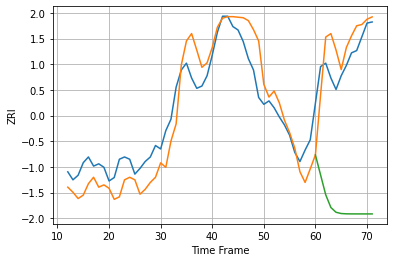

32204 20.933327648929367 24.13826324369817 129.1176845379318


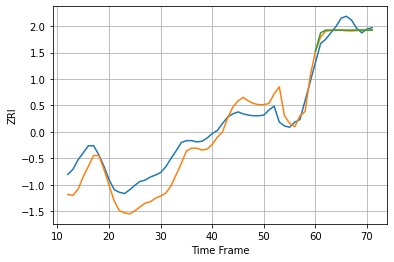

32205 26.665823703827275 12.423109582107324 12.804853057116727


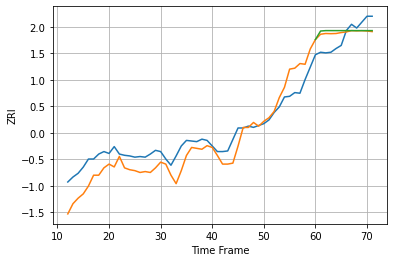

32207 26.74480563603843 22.023775379286743 24.2324703782653


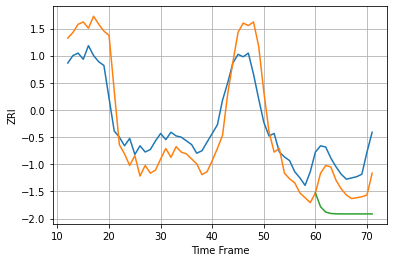

32209 21.618378591046188 21.386755662841644 42.06252568637601


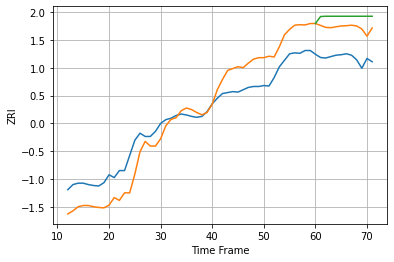

32224 45.78485636353561 65.95215435886062 88.20127592414664


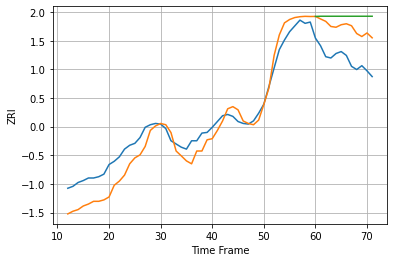

32225 24.85195927493365 50.4506254192329 68.67338494104499


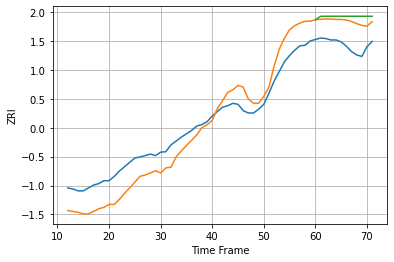

32246 39.94228706956785 49.37106505282903 59.58163497714453


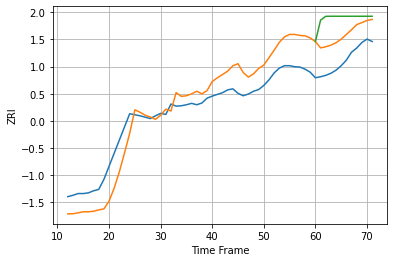

32250 60.79053865394471 75.47118560588248 125.8606730431414


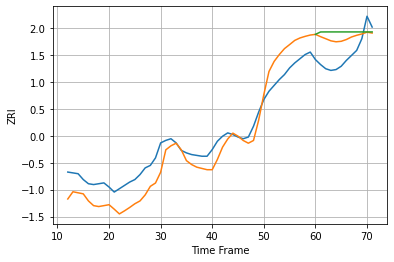

32256 22.088049548860464 26.610438962853777 33.138389483096084


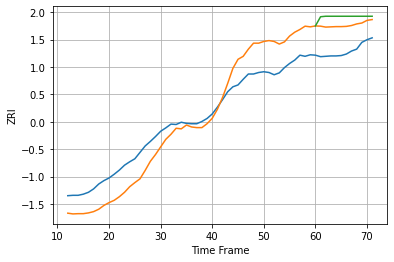

32701 57.5926935463123 69.86882790739126 91.19596080860238


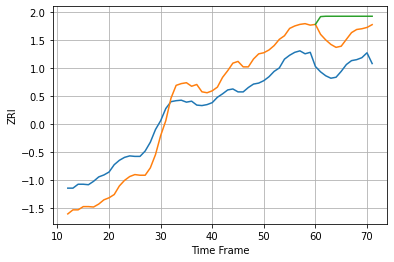

32703 46.77299460277999 65.94785855797795 103.09996095688959


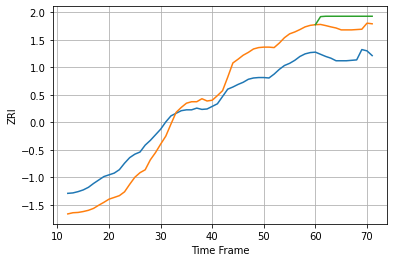

32714 51.129617005021075 69.03561286384158 92.91599964202389


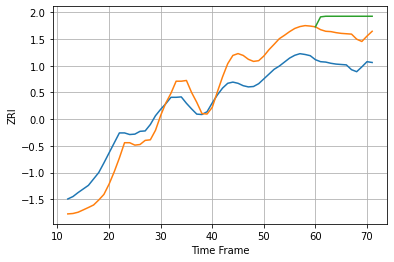

32771 52.54319076798217 77.62423910144442 118.6929922951773


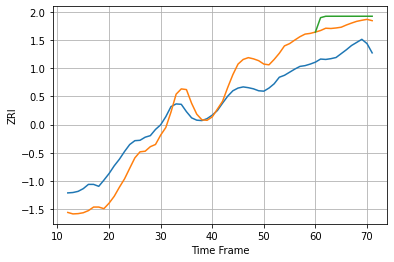

32792 56.25014092030912 69.68862699988199 90.3910504804897


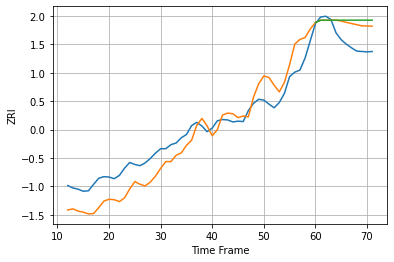

32801 46.4618697684081 46.58203412465144 54.42033086018583


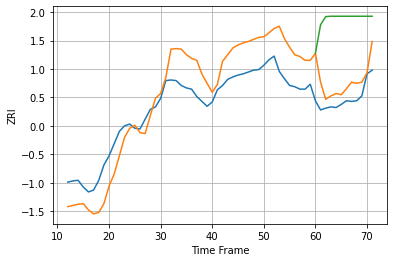

32803 43.61917424525026 34.49865091132297 130.36451503881813


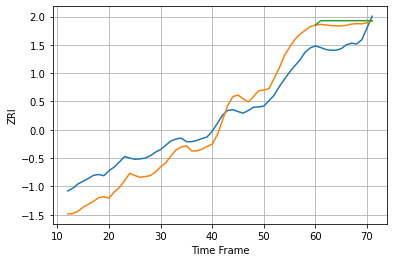

32810 47.98389464788771 50.950618724492934 59.871799970449615


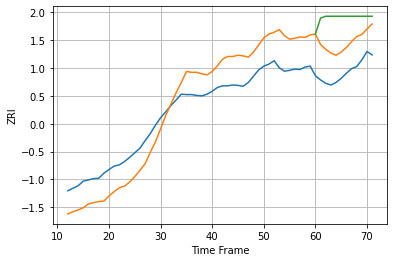

32811 59.675199229247276 72.43487719133596 131.35785474109863


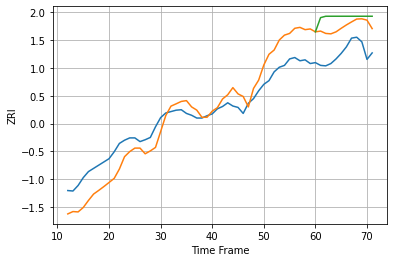

32812 42.36057573862715 59.80814292190498 81.12719967363614


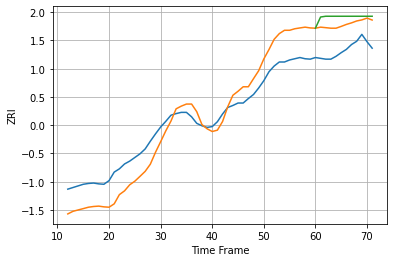

32822 51.259350298795994 64.83086720041419 83.17188993701653


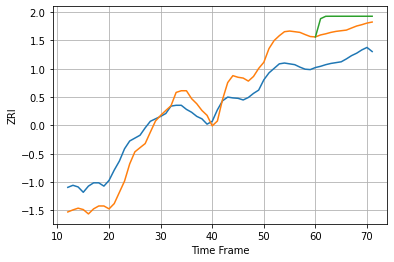

32825 52.97200430020687 71.10071287142365 99.72236070678464


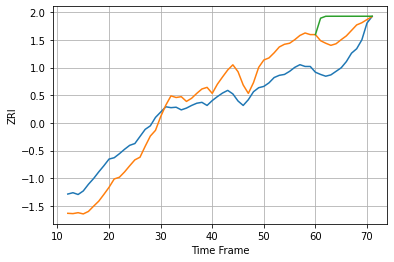

32835 47.98832324125814 58.701071661467836 97.48400561383691


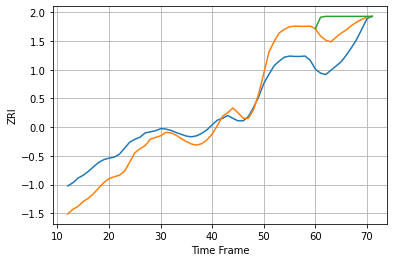

32837 52.363353984047386 73.33188529548187 111.13309629421323


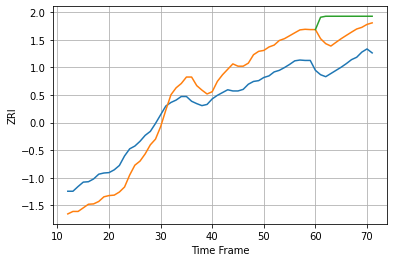

32839 57.82054525290466 75.95264322521929 119.50245007377977


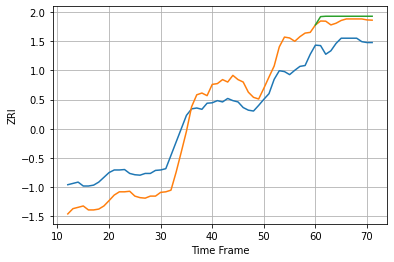

32935 53.52752614009262 52.203125649967276 61.69918944556678


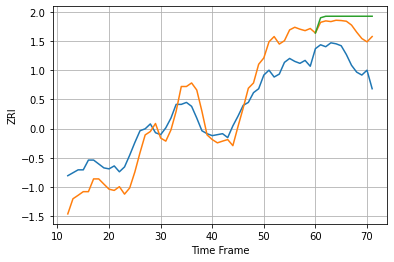

33009 22.614232374805905 32.6853149953923 44.66737995390239


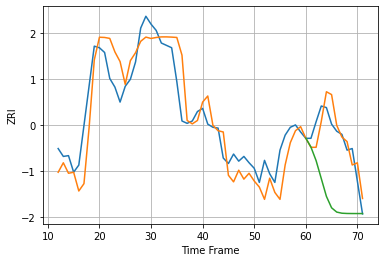

33010 30.77643899710362 20.270545553366144 76.67796845304076


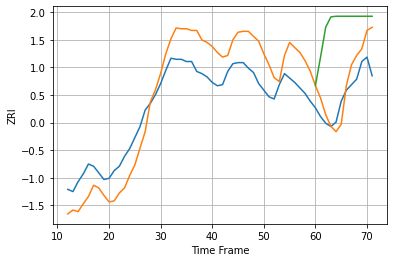

33020 25.584549610685592 19.861930639423193 66.83700057035269


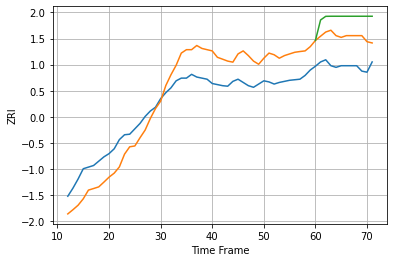

33024 44.05159310506365 54.65977173798206 88.58660864564871


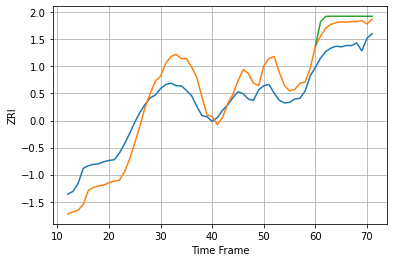

33025 31.63625612210248 34.252238875519176 44.320535103008886


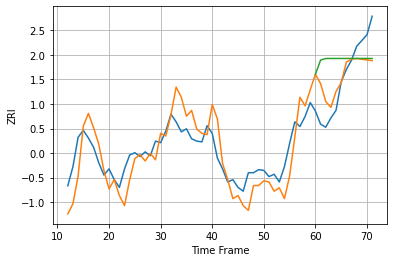

33062 26.816950582040842 31.992050766471003 52.814487269600406


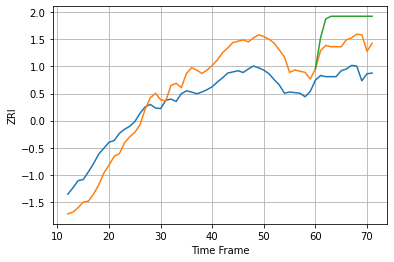

33065 39.60687784412334 49.38139231432901 89.41952096371948


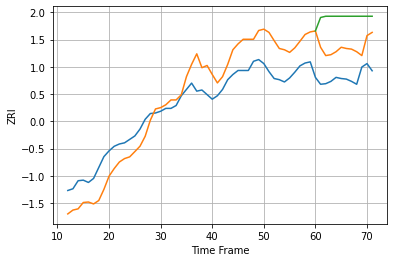

33066 41.5142981808989 55.27202644170304 105.02257471176429


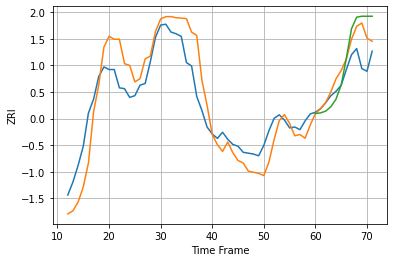

33125 27.746921110471042 22.263262912785585 31.527763956980376


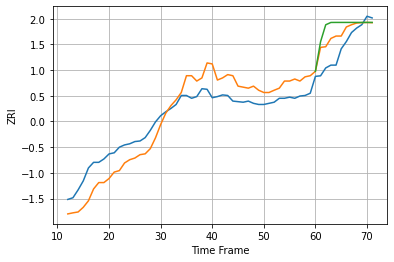

33126 32.587658947478566 29.82030991851701 45.829320696715214


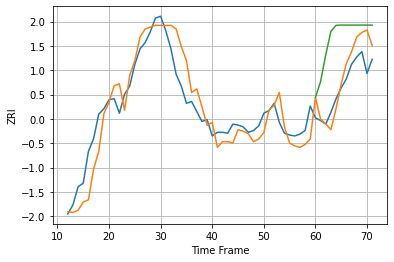

33127 21.727487775942315 20.29184890533165 57.19166005772037


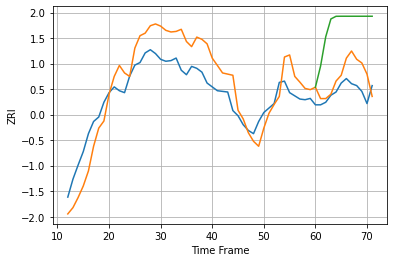

33130 37.421039776428586 30.26619080072723 104.13736747083132


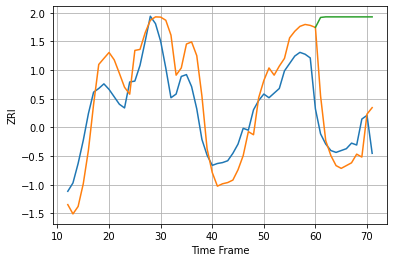

33131 30.48456705740382 35.37546535957905 131.85211304241554


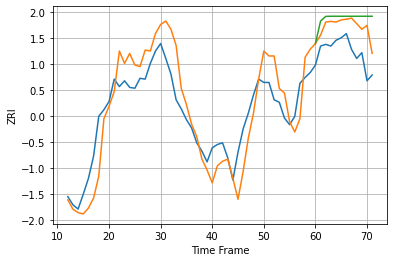

33132 31.728471303625277 32.773401727433146 44.029860354997496


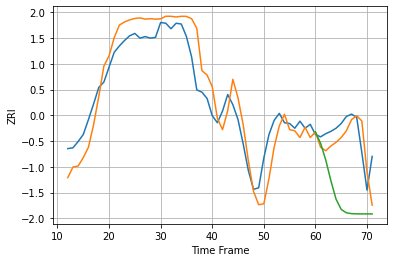

33133 27.758022694167344 25.90474874530675 83.80473873077189


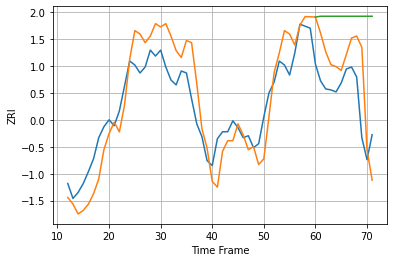

33134 26.329045419974346 41.37975395832166 84.8557603588796


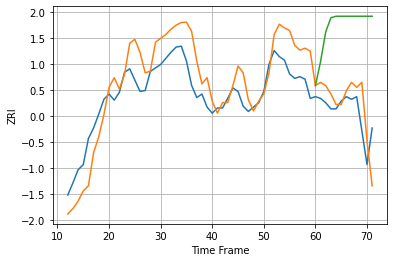

33135 29.978484458467072 28.876837883303864 103.80089023489239


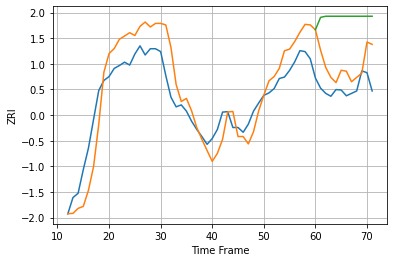

33137 49.603792149819455 57.89816409146366 147.40471387399097


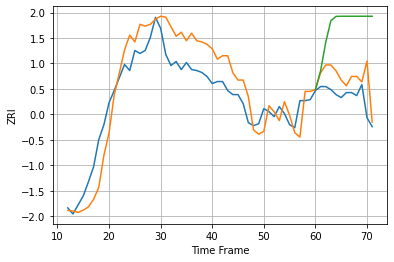

33138 23.72179429402681 22.36019983690525 73.26697591067938


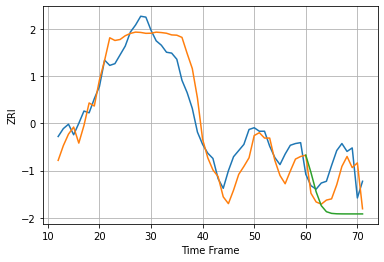

33139 22.21562886246316 26.698013968417285 49.663962838290914


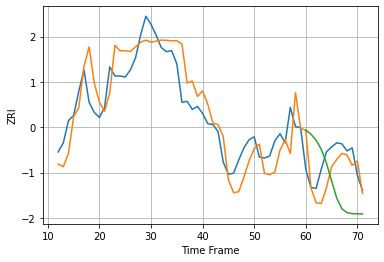

33140 22.893372505945592 21.107565400742683 45.76286142782235


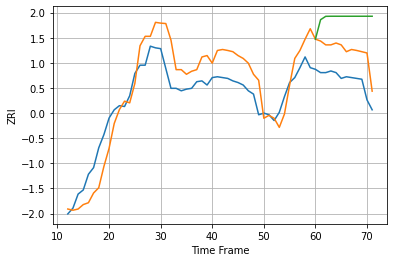

33141 28.079116290135527 36.41287924747744 76.47929112654884


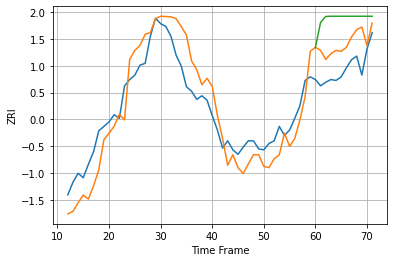

33142 25.767723694098212 30.542258263939686 57.44638604538081


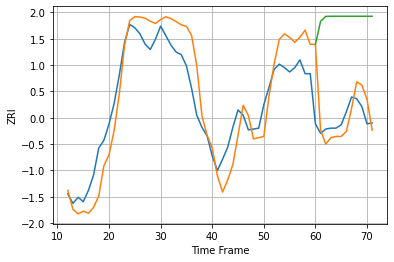

33145 29.72453191398775 31.27088184506582 116.56532397383963


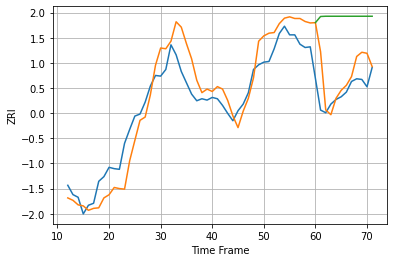

33147 31.279129143780754 41.39069997869442 112.92266217643973


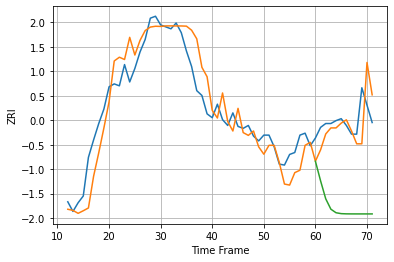

33150 22.08850364773641 25.1916215037181 89.8811588470099


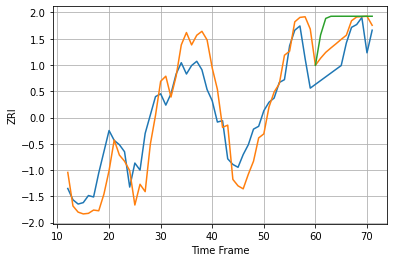

33157 19.007297963467103 14.373434531679356 26.44446591236469


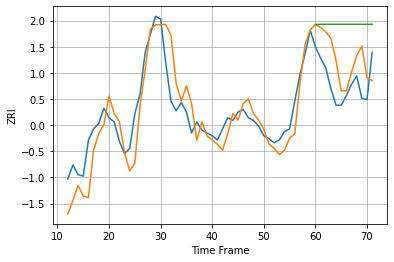

33160 15.927992569772845 22.782189116304554 43.5594336270908


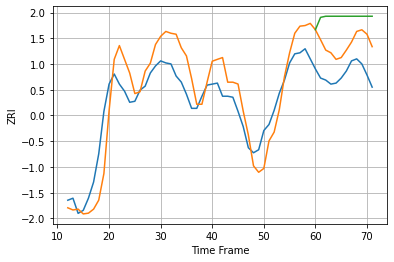

33161 24.995096640962096 31.167479857326846 57.0090726161071


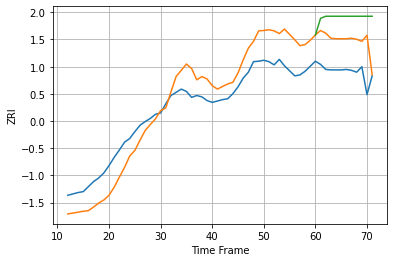

33178 49.767322509005304 72.7972562565327 118.69497822075535


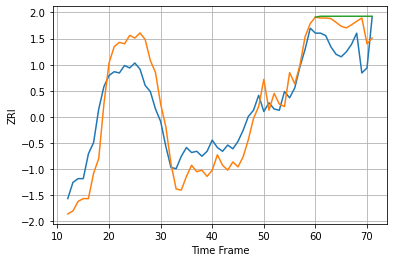

33180 19.50294839473766 21.637843142950143 26.648248872295145


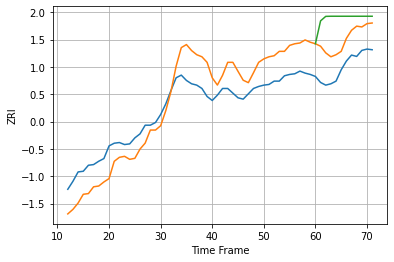

33186 35.93983287764149 41.35390854254928 74.54068785671656


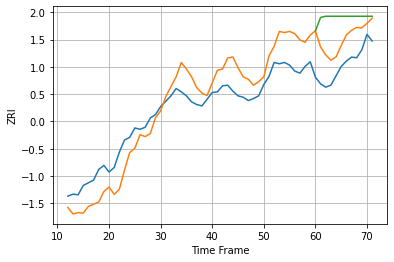

33196 33.503412766432234 41.8785520530414 74.6252935139487


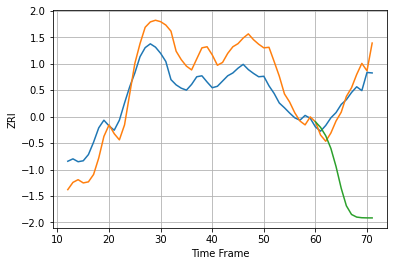

33301 52.359984459319094 30.08099574559782 202.8067385734308


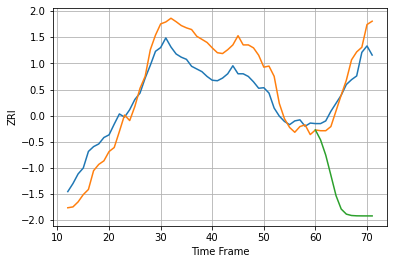

33304 45.12672109786313 30.00611582721754 217.92625891555122


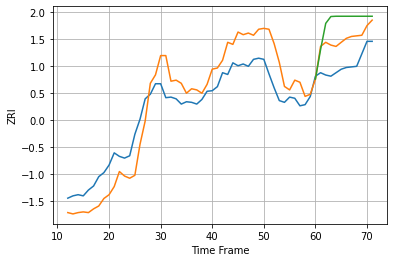

33305 41.853266618876454 44.172102583349755 75.58559460549786


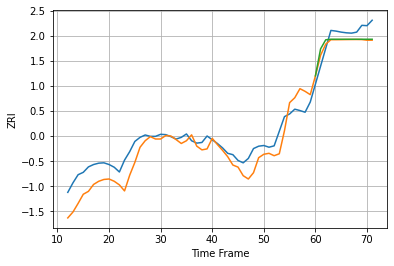

33308 44.71094072876311 31.523386271522234 32.982461781795955


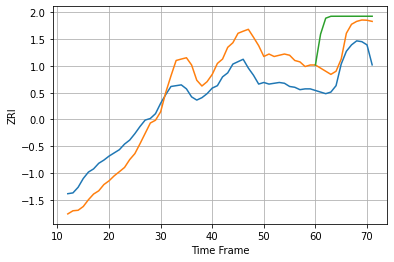

33311 30.17399893198345 28.791847149075156 61.48939854339079


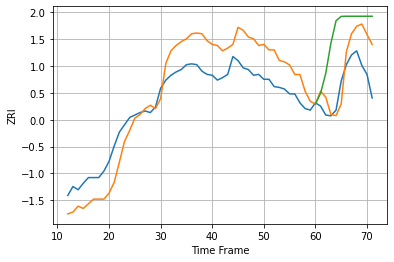

33312 31.96683718044577 32.76707322506279 68.20206254819978


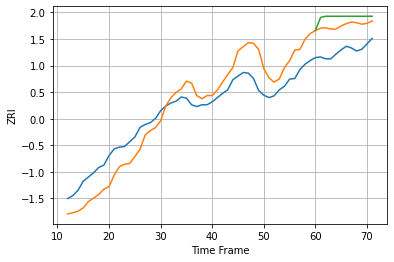

33313 34.07339598249531 43.104700364001985 57.083805651595206


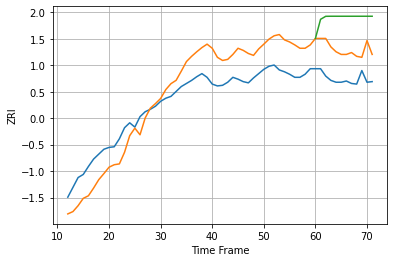

33324 39.345833204000186 49.601140065930224 99.22921845165196


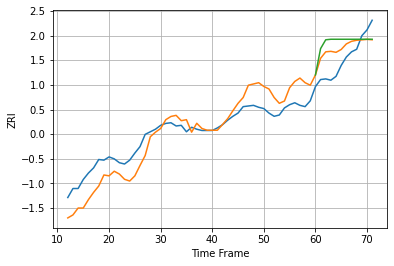

33334 25.75848538249853 27.722896722135246 38.49453457397603


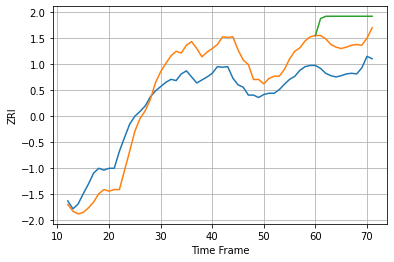

33401 38.686851724040885 47.57105444732446 87.15421770928945


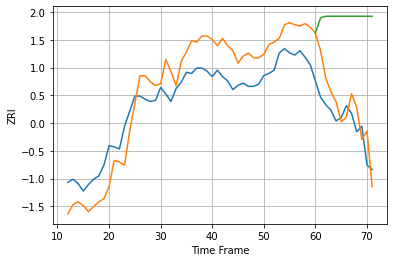

33404 25.3347401792157 24.883062434303483 98.27382695804378


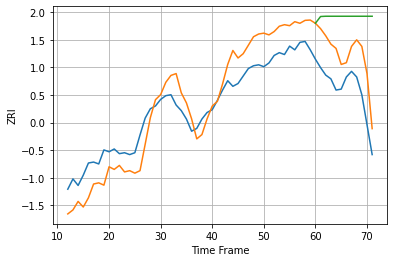

33407 24.2989873062579 38.71162028062985 81.37829831763332


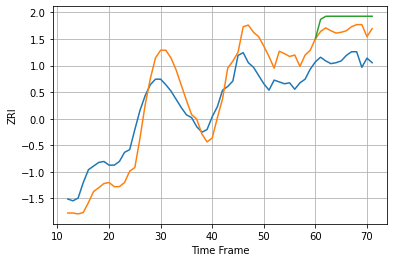

33413 26.724241776214797 32.32452805818826 45.67298956486316


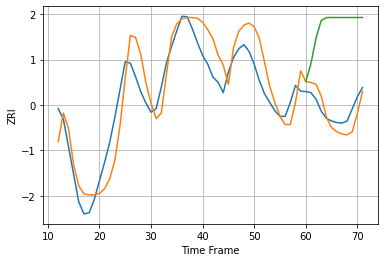

33414 45.907624286510035 24.435835657585496 164.30220870440473


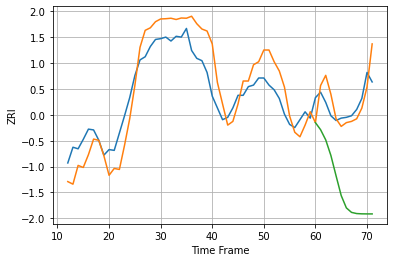

33418 29.349355992836593 22.715810620630066 112.00669866786254


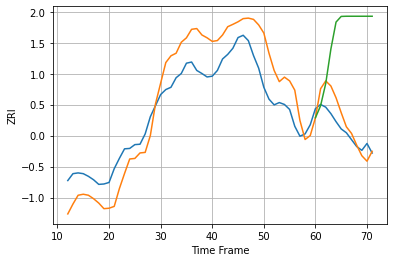

33432 73.01147083643203 41.63446641229963 268.10154435016017


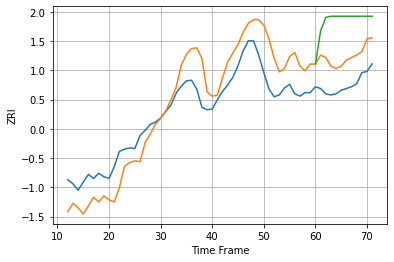

33433 44.33501952873926 48.267040441440685 110.36364194246389


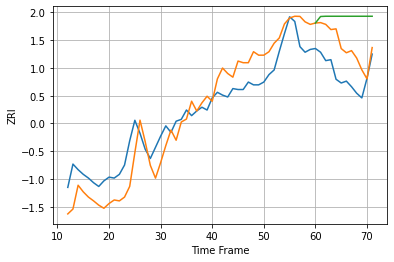

33435 24.23676557274096 33.42304363083946 62.90659793484386


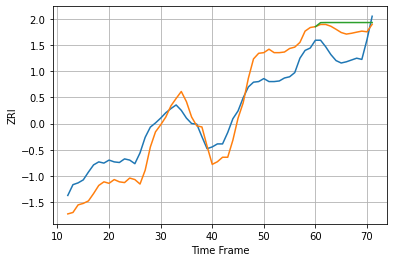

33436 34.37729972517785 39.51757753417142 50.753369633721995


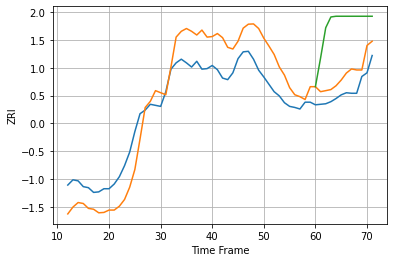

33444 51.39164528162398 33.49972594146283 128.43137635784757


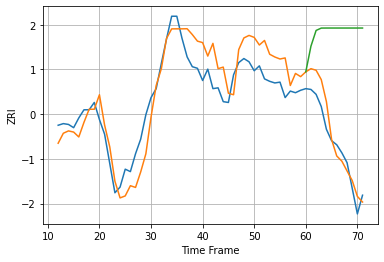

33460 27.736143933197642 20.879787428574488 146.69135461594055


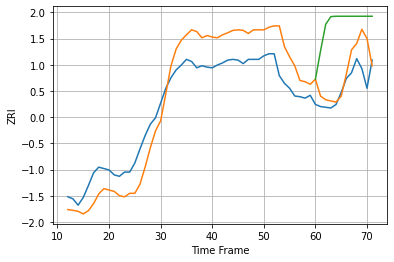

33461 36.9754427402951 30.895691699781477 92.81698357632807


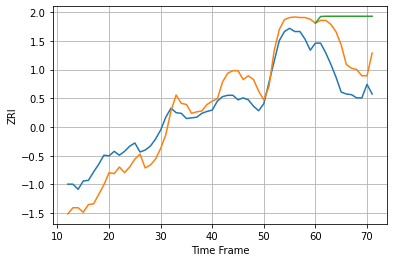

33510 29.457026784112475 50.04737052327265 100.65776231923807


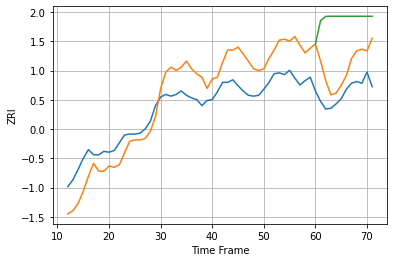

33511 29.605649767105007 34.75467265820321 86.5750154715392


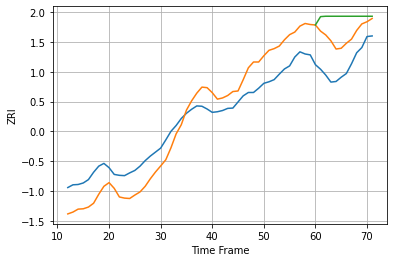

33602 74.64878267260829 100.56190666013461 160.1543842503893


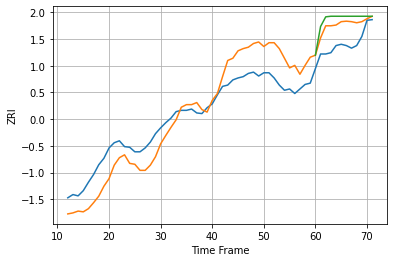

33604 33.40959046220203 31.30925803299942 40.98745878435178


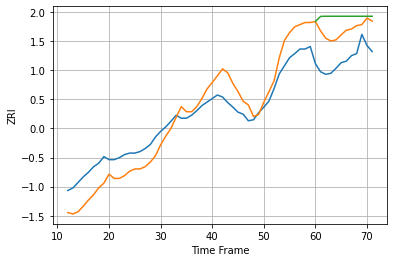

33606 38.140324685983884 61.50439387041422 87.99366524946521


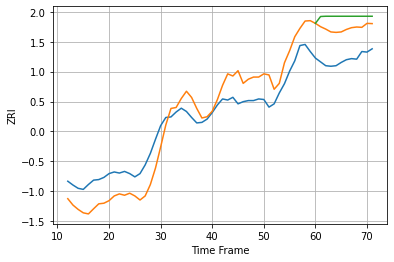

33607 39.653850582321894 57.926961181921264 78.41627520460368


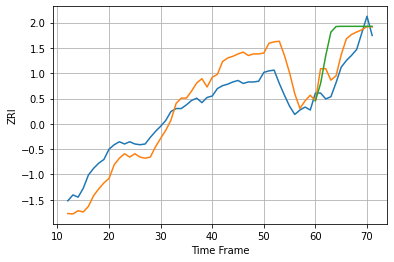

33612 29.0906988954493 22.950472239852267 45.90651052623931


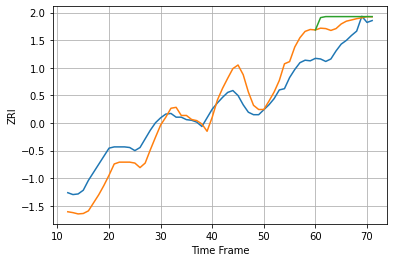

33613 29.738136072680366 34.15299135800462 45.29469040273597


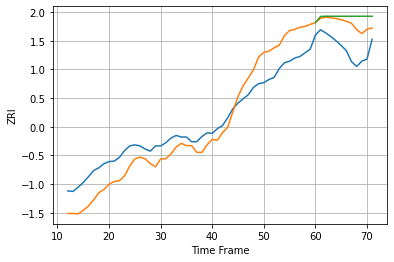

33615 39.14722510791478 47.785348760204464 62.011037646944494


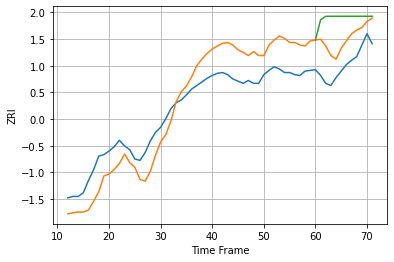

33617 34.03367611254518 36.81297406741968 66.88957154182687


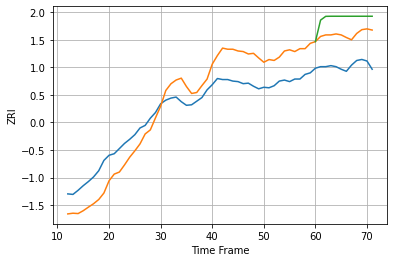

33626 45.821885391984544 60.87491080111383 92.53585724964657


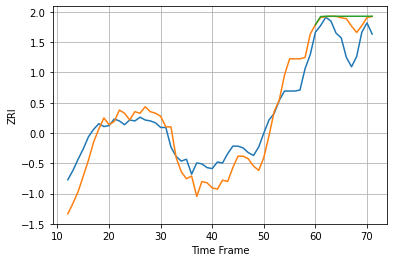

33634 19.826819330078006 21.707187884205155 26.574547083820626


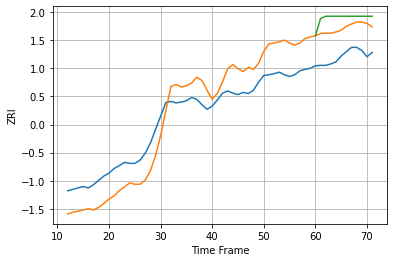

33701 66.32726804151238 79.46596500524271 109.64479227836883


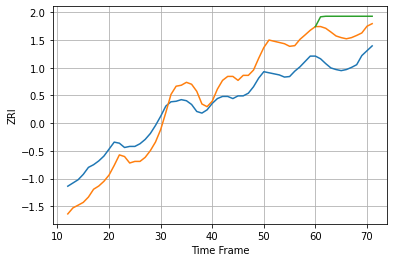

33702 39.942095650740164 56.2306896380983 84.50907728290092


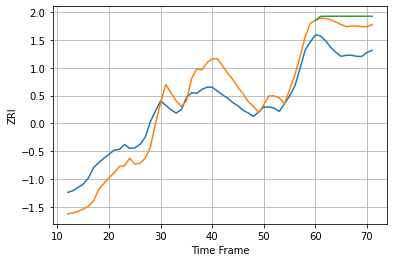

33705 35.00915033814703 48.42422694621794 61.681652985814964


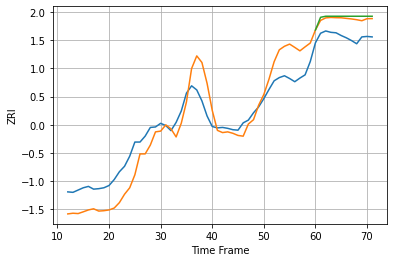

33706 46.2706490181386 37.889448607866825 42.899878005798584


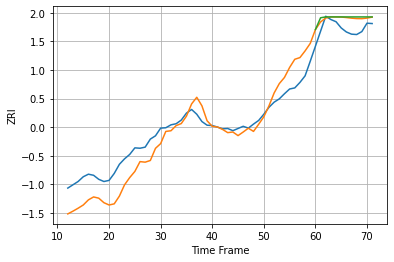

33708 47.74984946924262 30.251344849123775 32.95278867531811


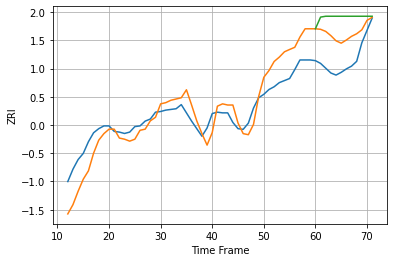

33712 25.933339463049354 41.39010359964875 64.94568301526375


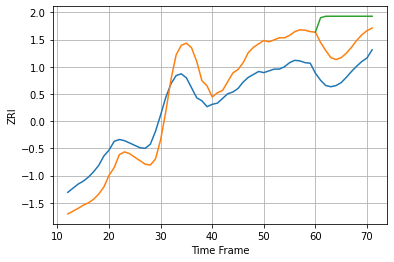

33716 41.661661301094 49.79507650260179 96.8668069319244


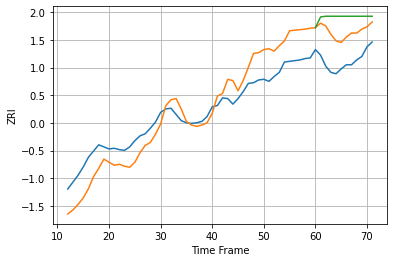

33755 29.722029336448095 42.6426998305931 64.11235054407285


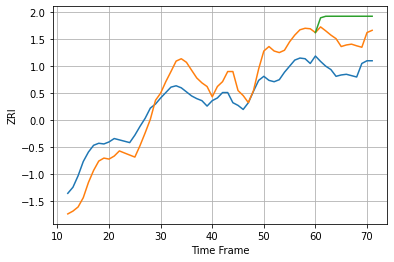

33756 31.934828886997213 45.18913375131245 75.90232481096092


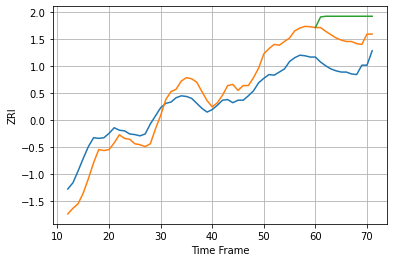

33771 30.89128526606633 48.736090935915804 80.03136421802367


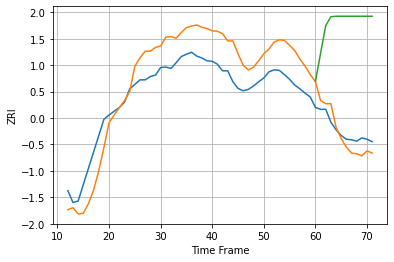

33907 56.4267697486652 28.0218512249638 227.75115314958975


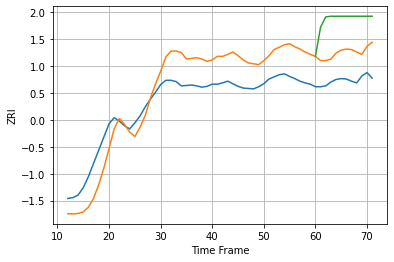

33916 58.06832992975975 65.77939966557221 141.90977885304207


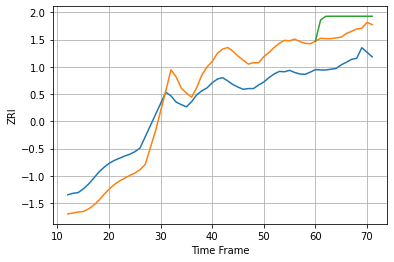

33973 66.83652440282125 79.90725542592045 121.90184466604985


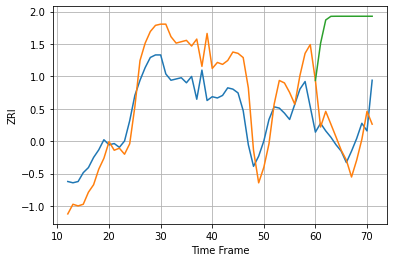

34203 25.404585528629067 19.08979279343027 89.47211802217896


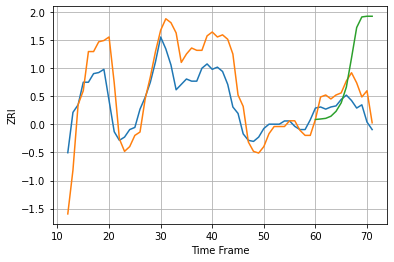

34207 26.4747338467191 15.535505795977226 54.07085527553194


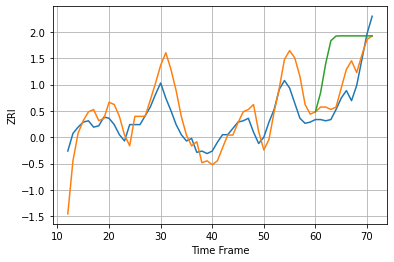

34208 16.704130170542353 13.065027326494286 39.800326212983705


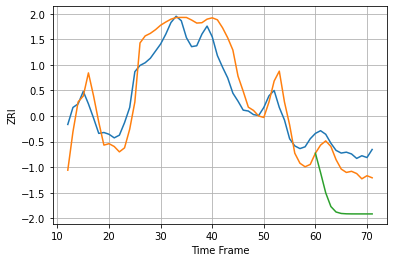

34210 24.272463833558156 19.37318721075526 63.11752244119558


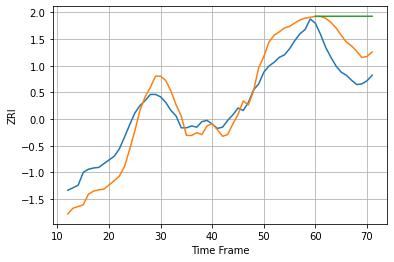

34232 29.258868458167708 47.79129626933803 84.96022507942433


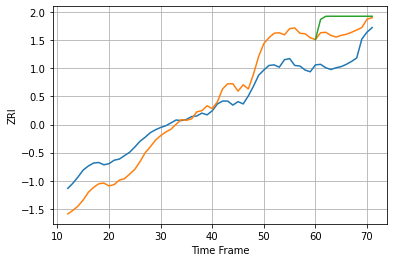

34683 36.89488152885559 47.44882135647218 71.67579405813669


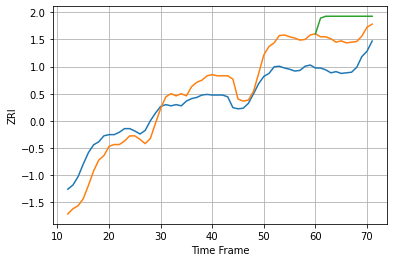

34698 33.60156955014022 48.31581061951268 81.23059972214556


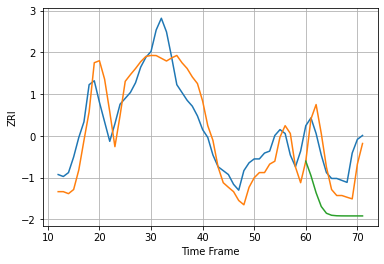

37040 11.658401620687323 11.666638107795592 27.167424327114436


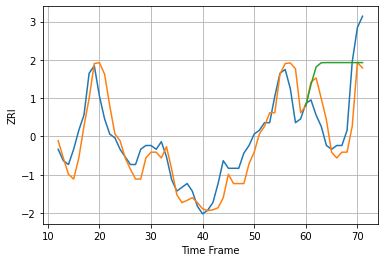

37042 4.97481971525666 8.274212451540084 15.69258719107021


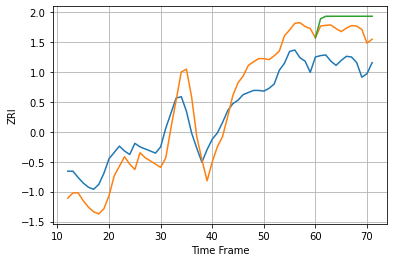

37075 34.737213759418026 46.309861826699446 64.4599157618445


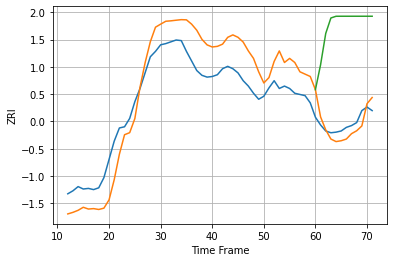

37076 44.55098679806819 20.09076818982274 163.8274655008586


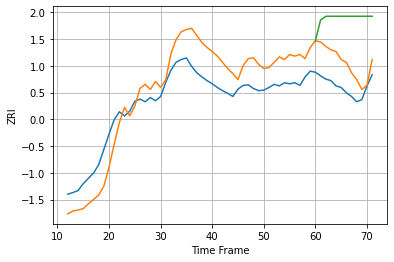

37115 46.23956298078324 50.217288994245045 130.47947102501269


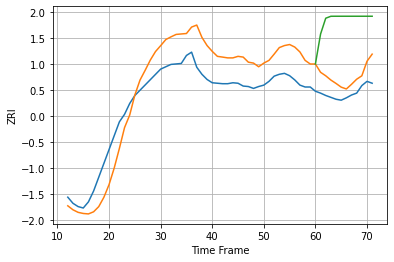

37211 53.66894003935237 38.84774047322574 153.9205987073228


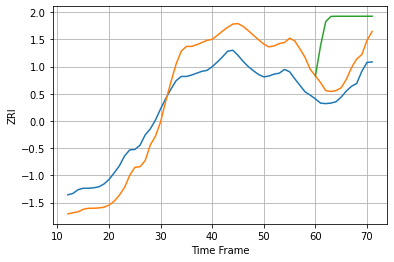

37214 57.08280989602455 40.19524775961229 143.5779968407358


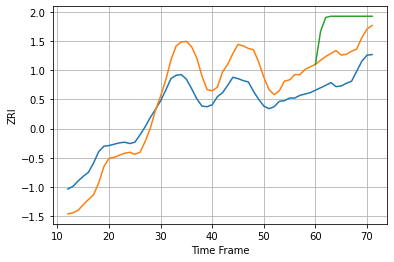

37221 36.59863632054275 42.44536726238418 85.63819290783876


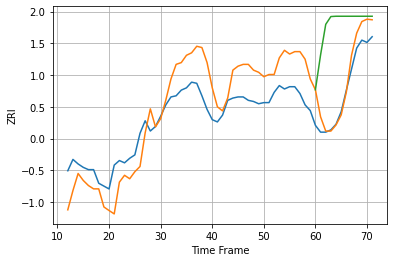

38104 24.824105054014638 14.147391654119545 63.98013771528341


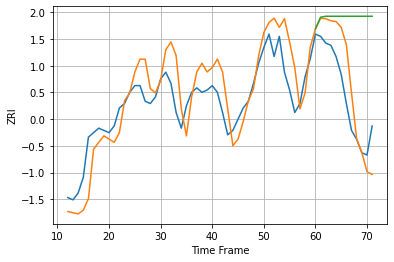

40391 11.590803362720829 14.406653360871916 39.248594744623674


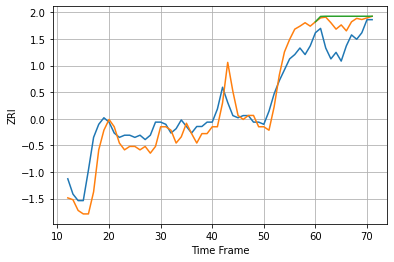

40502 8.291617854625596 9.69649772295738 12.174463433563366


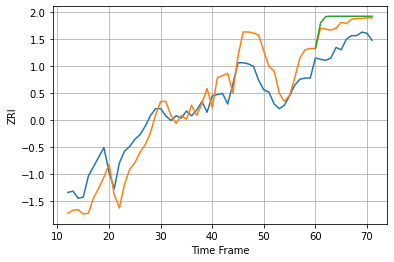

40515 19.144561153640396 18.41590243440392 23.97807725750147


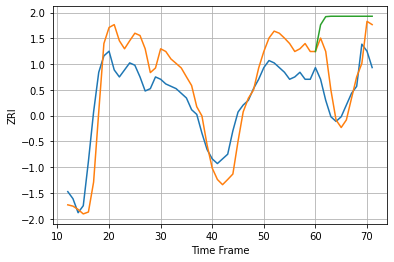

40517 11.992810522452514 11.445127669059575 31.400726918429026


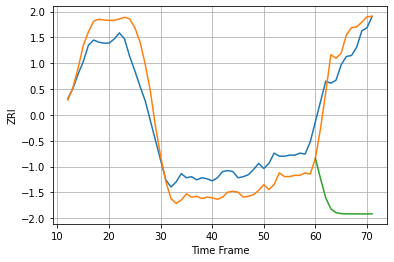

43055 21.845587494403333 20.745766035703536 143.58694544534384


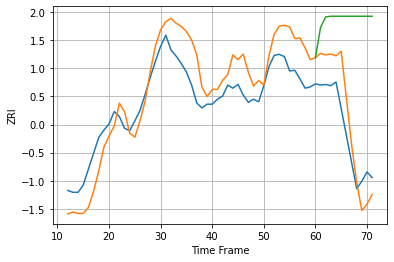

43201 42.7753862781742 50.20394577557076 192.45828543932174


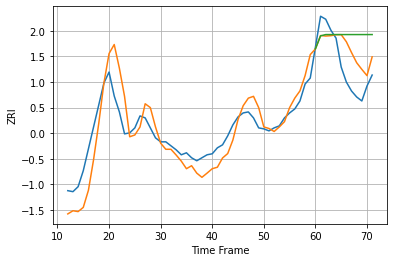

43202 19.369170501829146 25.017376230706592 40.69003826094644


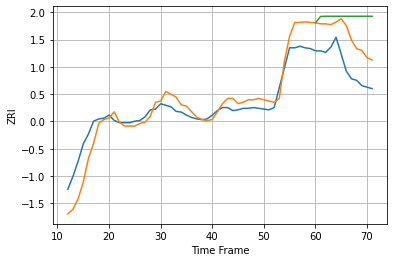

43204 19.332600403376052 41.45114865614162 68.49654213700889


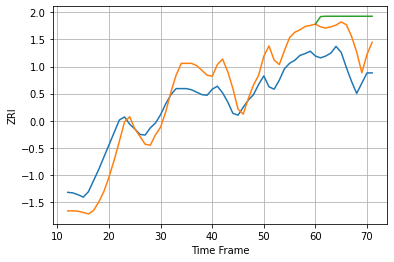

43205 35.757206629051005 52.02301685134935 85.10817893833473


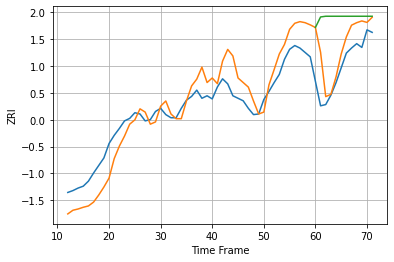

43206 31.37528796281161 41.79230200718998 87.7432362433596


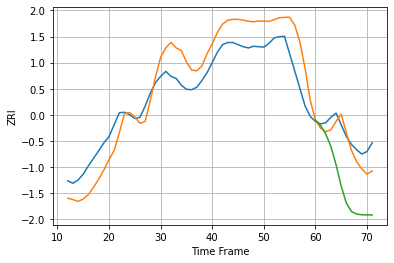

43212 57.8147093843018 32.10911926870112 126.25318067974366


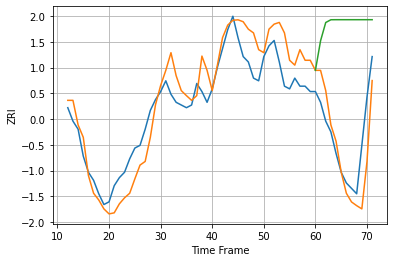

44035 8.937420398690636 11.661333071736266 45.056357801875


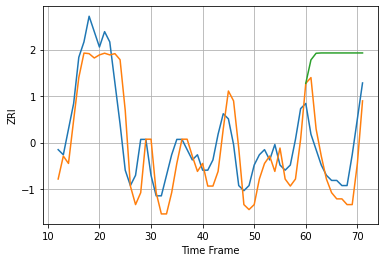

44052 5.433246172128505 5.614594952572586 19.975169338891295


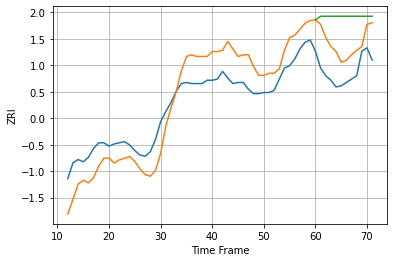

44102 20.94245679787163 27.099033556986218 49.81156728294592


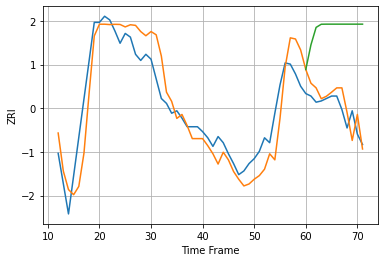

44103 19.087615833173718 12.958720894742981 67.61832968599998


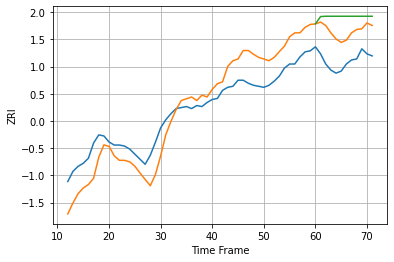

44107 21.62152007912645 29.685618867204553 43.60301720967374


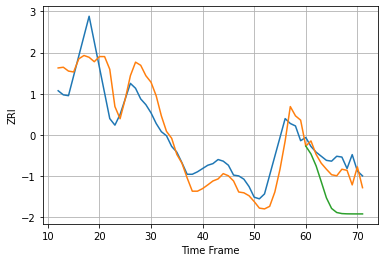

44108 25.69517896946113 15.872533572240409 49.64387487569523


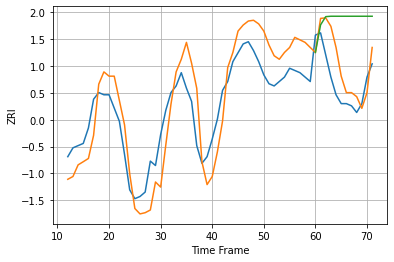

44109 13.229925734358542 12.063738240185126 31.40778971772595


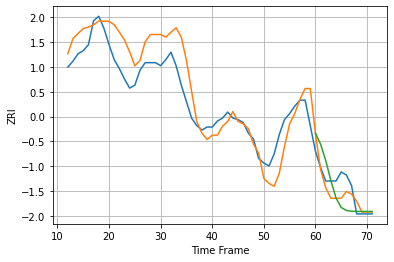

44110 15.117237725473663 9.002034636120841 13.335775521255972


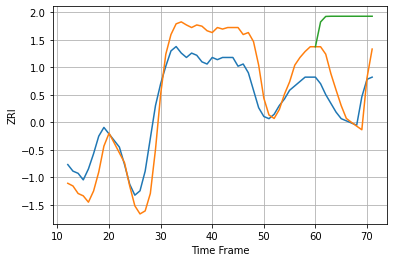

44111 12.374316767906068 11.325489379421315 38.849451750660585


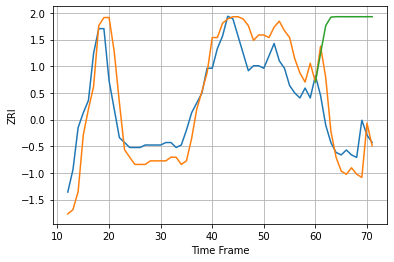

44112 11.285123951369782 11.426040667222846 46.945708844392946


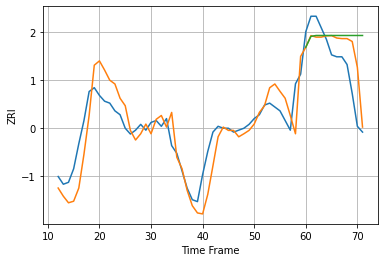

44118 10.940586298407506 14.242245072538221 23.23973227751539


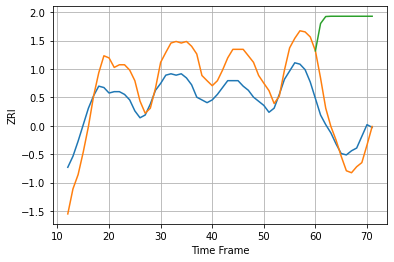

44120 19.995686536172844 16.4723666697542 85.11412913270519


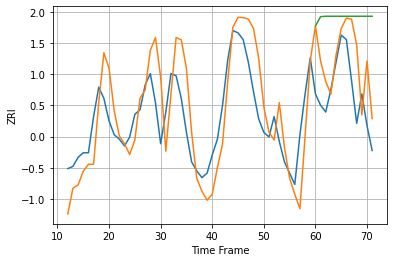

44133 15.606714160331423 19.60581486527427 36.44074314773628


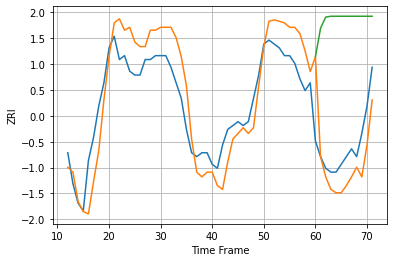

44646 7.358652954306542 9.079946983646018 33.10925496838763


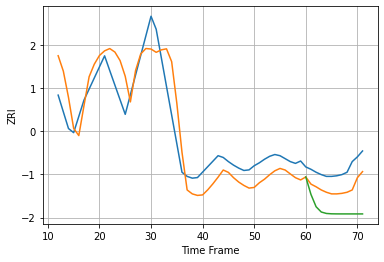

44720 38.391589261039684 31.15331732006749 70.4177622318474


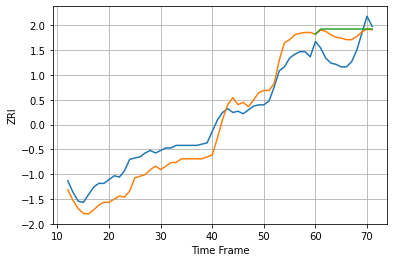

45205 13.411444710502023 16.20118503007092 20.708052197660603


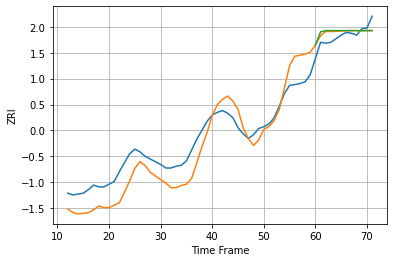

45211 20.726995130074577 9.071142703961952 9.723465348406139


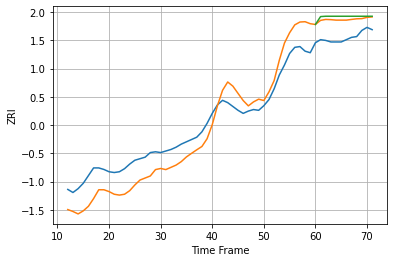

45212 25.54451223371122 23.832592022565375 27.48328105288221


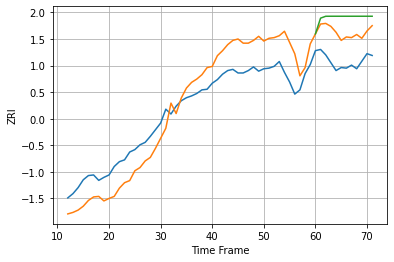

45219 39.73407840395527 48.479712579252514 73.01866752863133


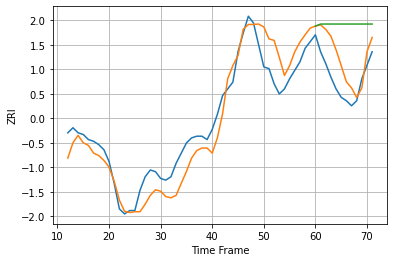

45405 11.340469105312994 14.648500589743627 33.61298205581767


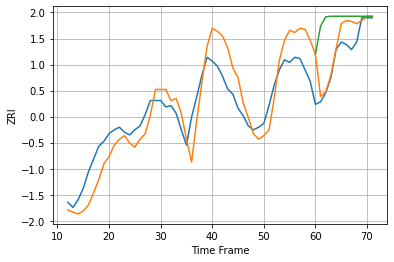

45840 18.09766042065906 15.3974306778514 33.756295618750855


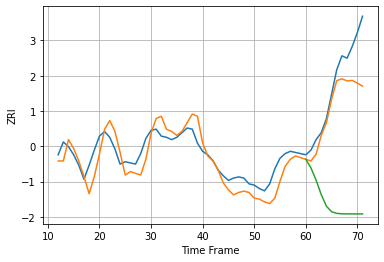

46143 11.999559701583975 24.977296290813584 110.08404635839688


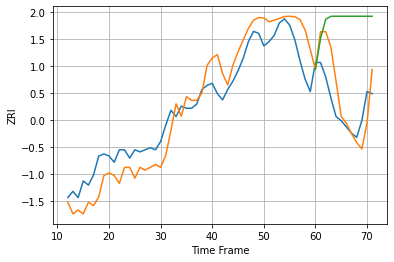

46201 10.83276358031428 13.405071783773085 42.7503312995743


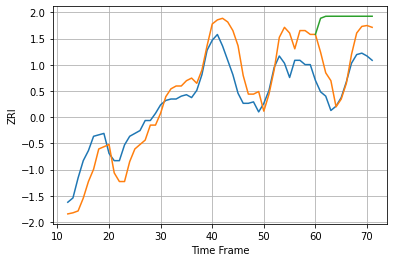

46203 15.939950372634089 18.447114059546116 45.18238562016584


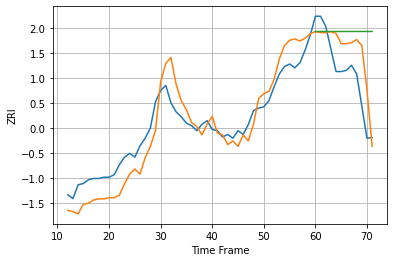

46208 15.039213312237582 24.65934837439734 43.995506016229584


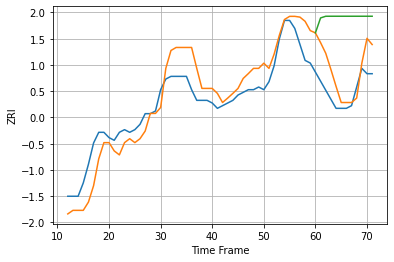

46219 7.679720262505592 9.75145912107179 27.76878124300833


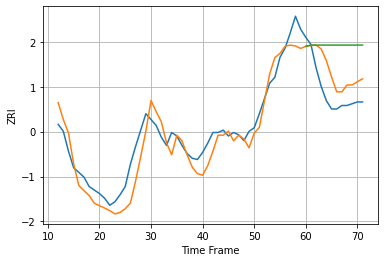

46312 13.473234370036854 20.345604042988104 43.15686383345987


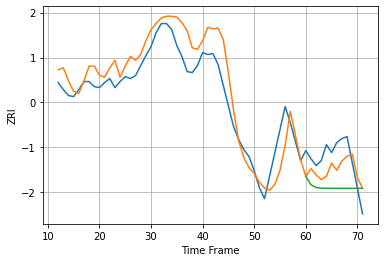

47374 20.43367169822725 20.016196988723955 34.52784369288267


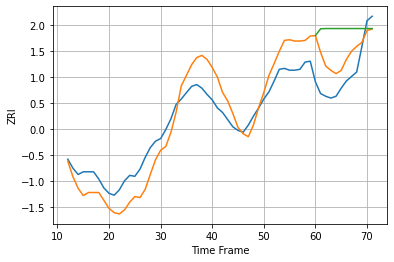

47401 23.377184955890787 29.396990293130088 56.86437484329436


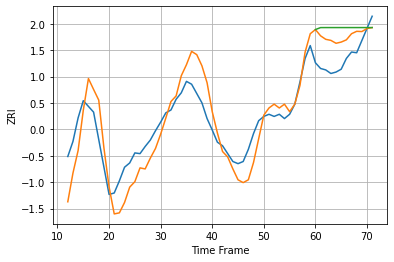

47408 30.575212344936265 34.030286801243776 45.769523383663625


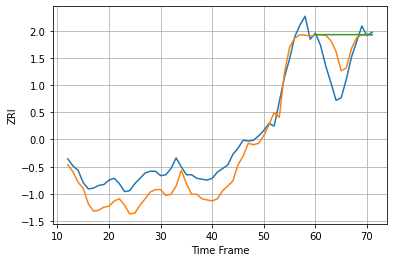

48186 20.236928074650123 25.71600999674224 38.97932308399133


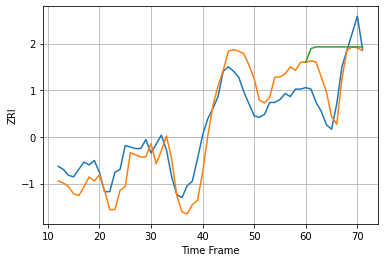

48195 14.715373998252726 16.53659660040229 32.003591157600944


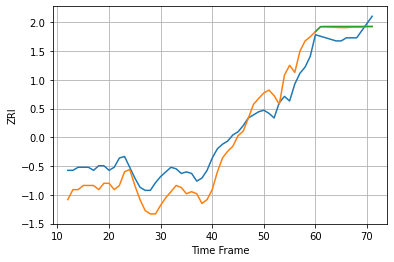

48235 13.037179091212154 6.460701196581745 6.838769669986133


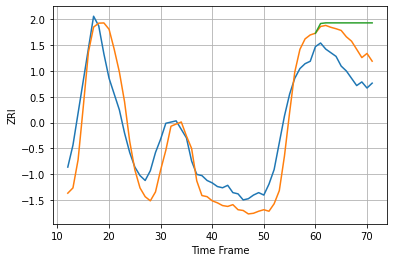

52001 20.4691288490993 23.521490332439285 38.12804845826983


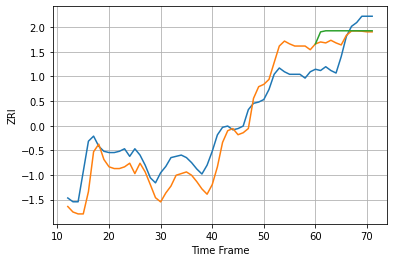

53140 16.485024097209955 15.825659830965456 20.72600220989282


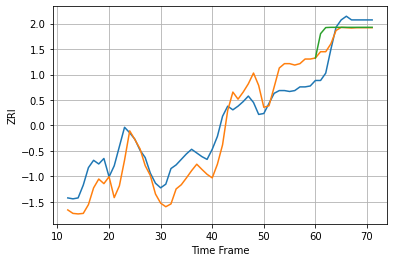

53143 23.609040742749684 15.16599834030869 23.76836843499566


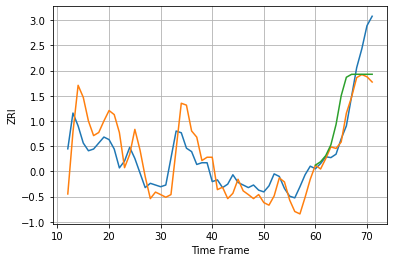

53202 25.395957702822347 30.264788326314488 37.237694416782325


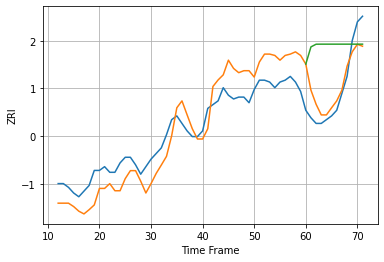

53204 11.578515449582948 11.014959072436314 30.580131253190377


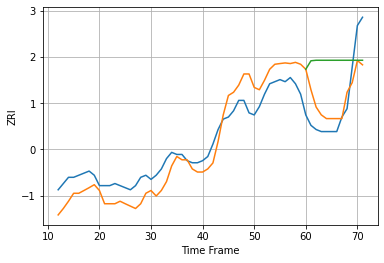

53206 8.871391899431478 12.914289368048587 27.79512328608667


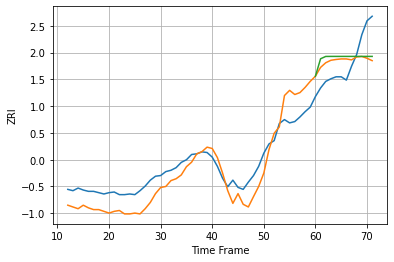

53207 26.328360438090872 35.32887353419009 37.30477840907603


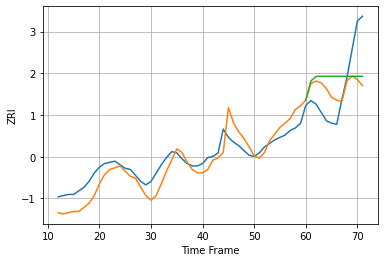

53208 11.491048658663765 27.737497048013328 31.60951054044523


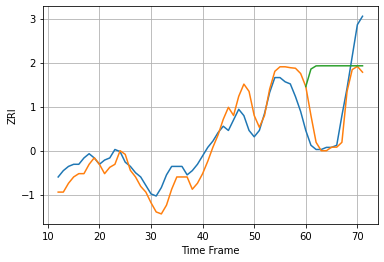

53209 7.755071880834356 12.691429598173391 30.080431231577986


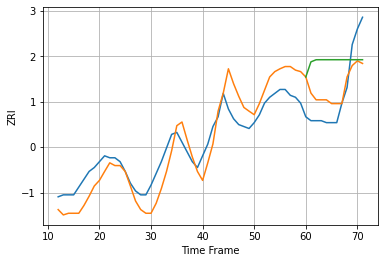

53210 10.232809316269211 13.368048894753528 25.614908145863517


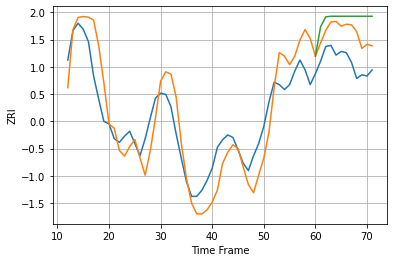

53211 21.35840503005671 23.425379400953556 35.779245435048665


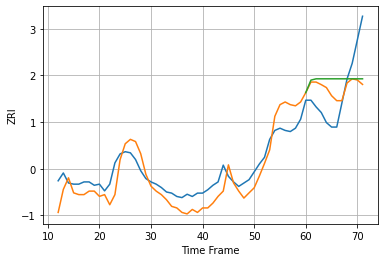

53212 14.027337706779974 27.316545786748584 31.823482879914565


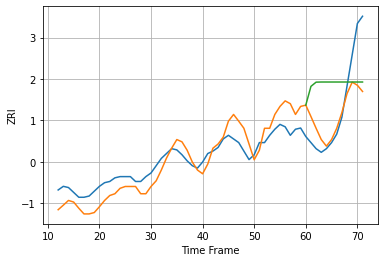

53215 12.264946934583998 26.663313520012476 43.86030786568868


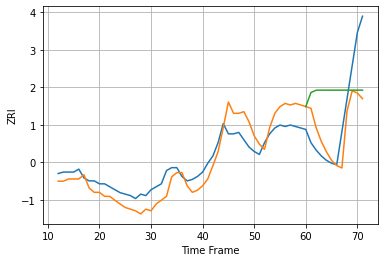

53216 10.384316176929199 24.121287913381135 38.26058708645558


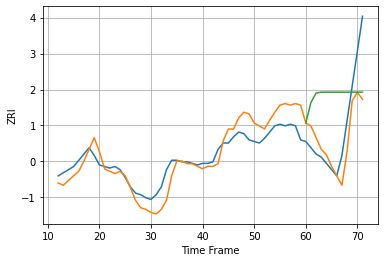

53218 9.033133809575078 20.117414226352704 37.22653376515992


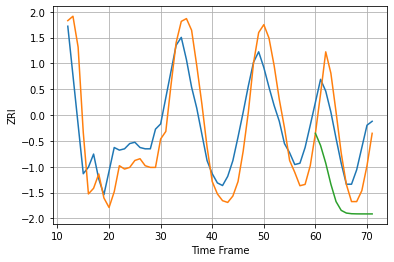

53403 23.85946515172286 21.99296876536321 47.450000203742256


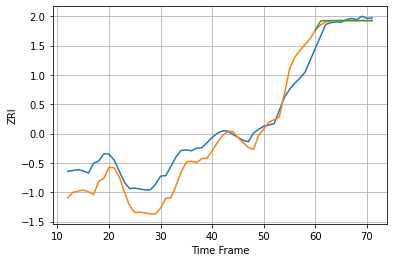

53590 43.25553665245401 15.246364653785857 16.809237714188107


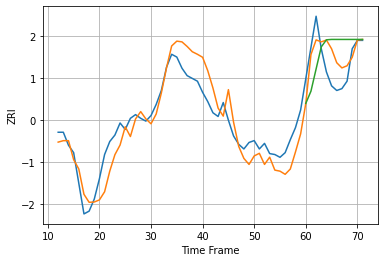

53703 20.141036354815277 22.359668553326607 38.539535838659454


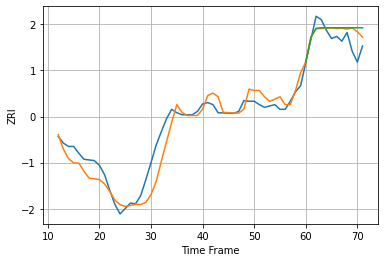

53704 19.007374235259196 19.814281091418447 22.15723402758527


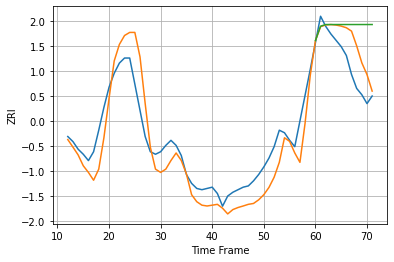

54220 17.662611860720613 19.350445793947806 35.8773483156186


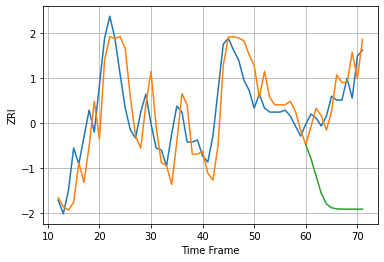

54601 14.691569615032462 10.146148086131168 52.59514586649796


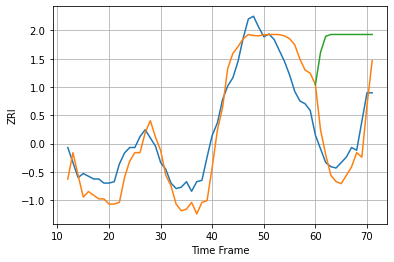

54901 16.213639925656505 17.464198355334485 77.62383047523602


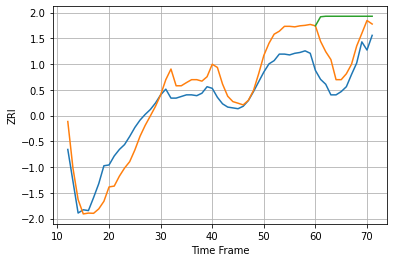

55101 23.85255076764003 31.17266077179696 71.95727932573647


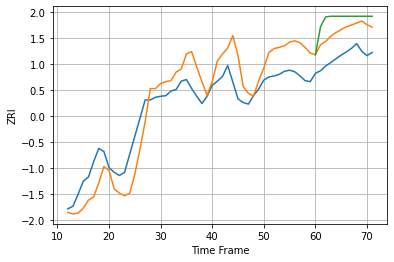

55104 46.12881730348623 48.84184464348494 72.8514653644818


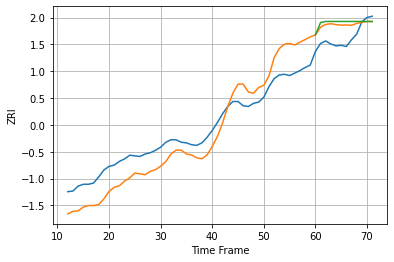

55106 32.65148059181906 25.242403860481218 29.308596603568972


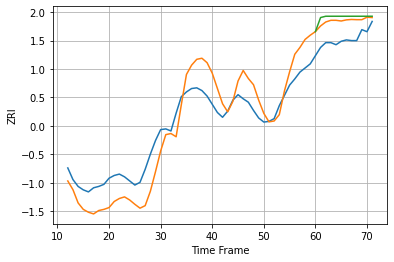

55306 32.149038834985596 28.54429051274951 33.98305536860755


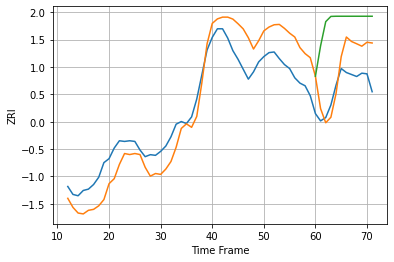

55401 37.30588284946826 42.37007609786598 101.22471860963333


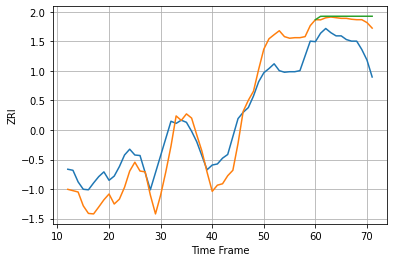

55403 45.0126379863583 48.16522257661612 56.02431825000004


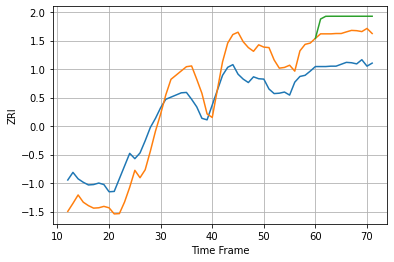

55404 68.24161647670644 83.63042701844144 122.30045332605955


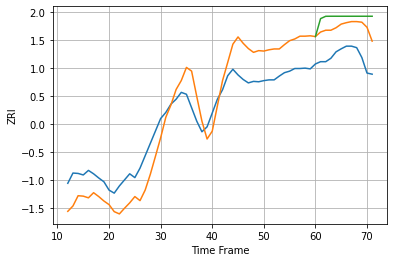

55407 67.7283999400276 79.44320783928747 107.2985792789314


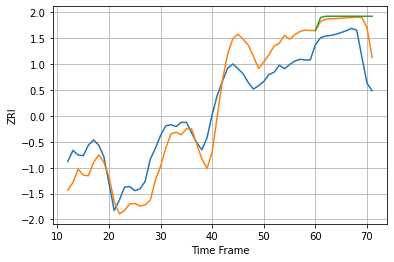

55408 40.16617278686562 43.231006987955794 58.953990038331874


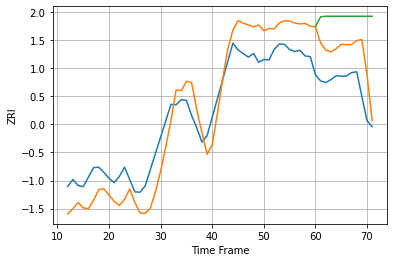

55411 63.28741359994593 90.13326188086887 179.7739231837024


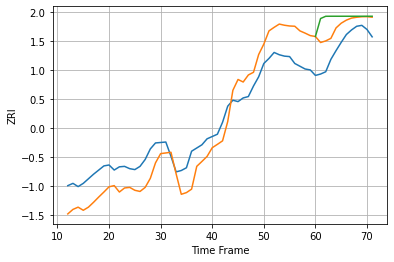

55413 51.82198512143804 48.02307409164456 70.8279545900577


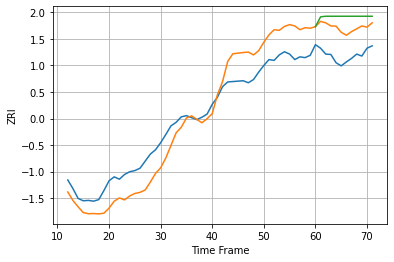

55414 54.821163656477296 70.78045190050473 97.64780776794973


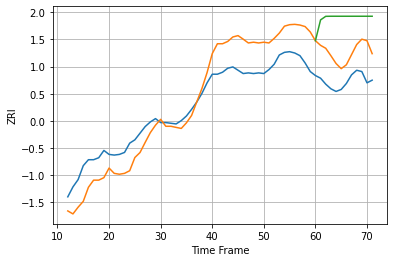

55416 35.614048977593406 45.33153446987031 95.36871397554754


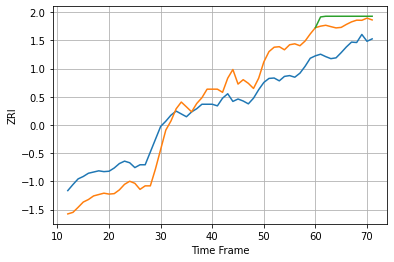

55418 54.793384830442534 62.49786949081565 79.76360880078859


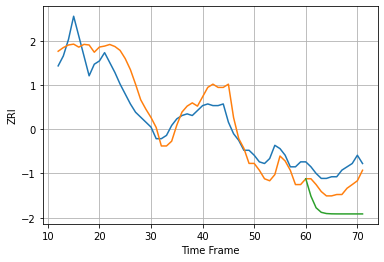

58103 10.816725746101845 10.903724638019582 24.750085130588815


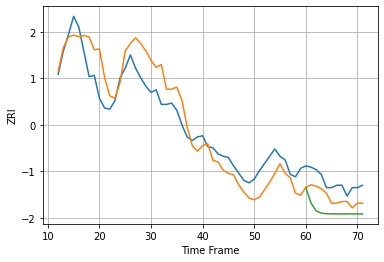

58104 17.31683547666223 13.333482868548616 24.49189334388439


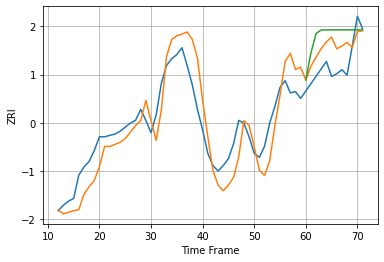

59601 16.93339980180276 15.823902727272992 24.583826581795126


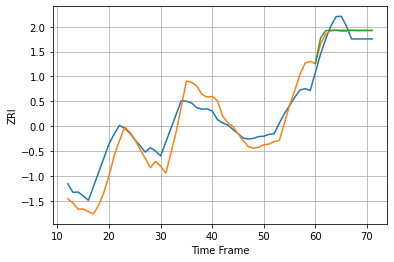

59718 46.148590029846574 25.486413865067494 27.72688690909542


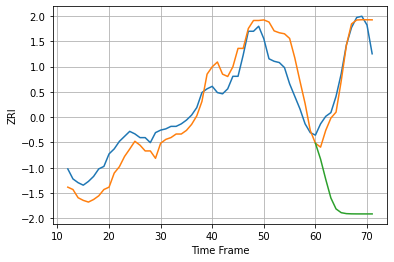

59801 16.571728748429692 11.178473969056121 114.57169912329203


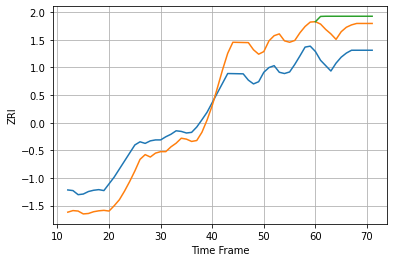

59901 72.2751835170358 93.02766723522096 127.33279664652271


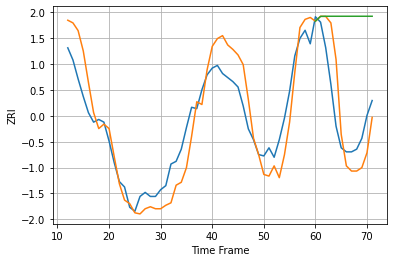

60085 18.507670424225036 24.39015779911999 74.44326011971965


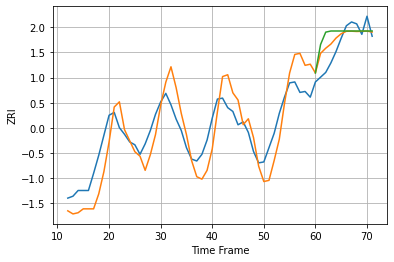

60201 23.864344760084265 14.250510297957288 20.73052446101652


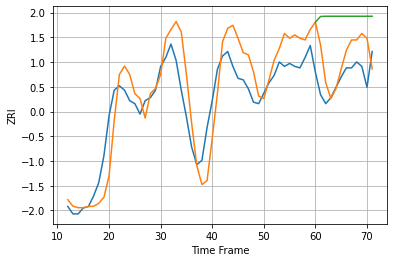

60202 17.828777320640988 20.174690454470042 42.377024564333624


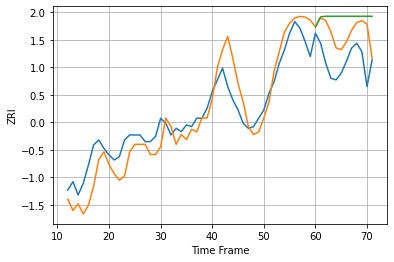

60402 12.08142595515823 19.112901986029424 27.881334079153397


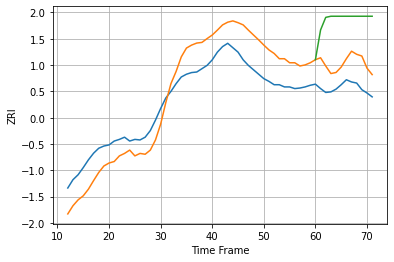

60540 44.174400177267216 45.676031509782334 123.68437440204988


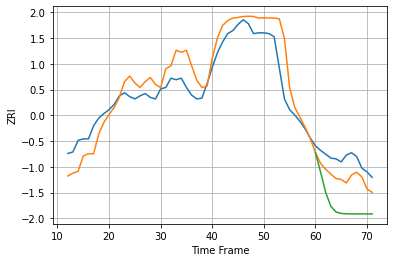

60563 25.827828937265558 22.279642508147123 59.960780501145095


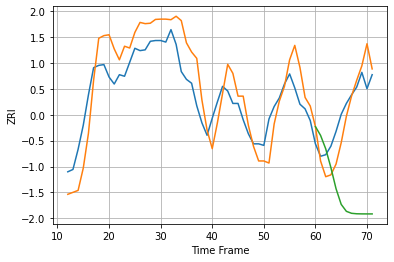

60601 34.48219509708625 28.325017620660613 122.92779247546929


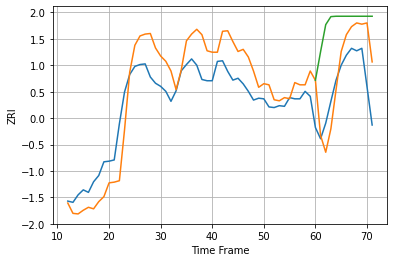

60605 42.5382253845034 55.57055995758352 108.26936083294721


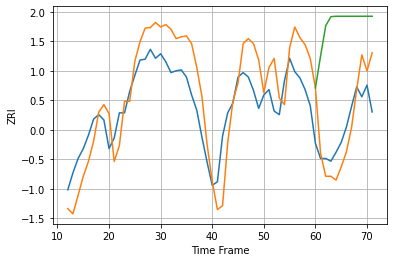

60606 36.65203010997982 34.65141841110402 117.33446334634367


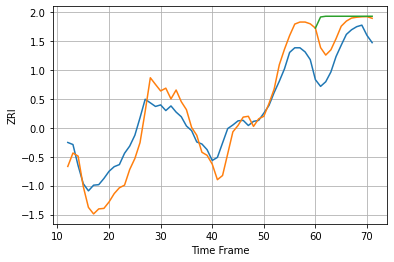

60607 37.79272785653856 48.465841900341054 77.5260417068507


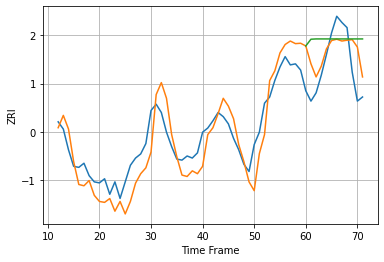

60608 20.247072322166964 26.80829068858763 39.0450280828097


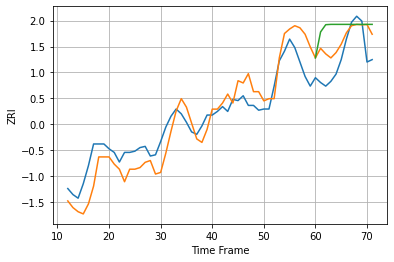

60609 16.447927877982224 18.611205352043715 30.90024279154965


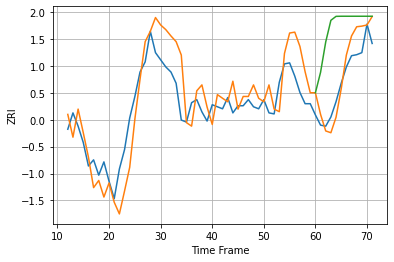

60610 25.81284969316373 17.639399284222705 56.01268311255493


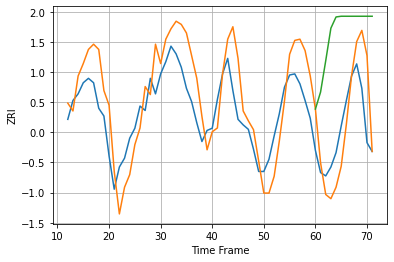

60611 29.837771539790083 34.90224382251762 91.53468378355102


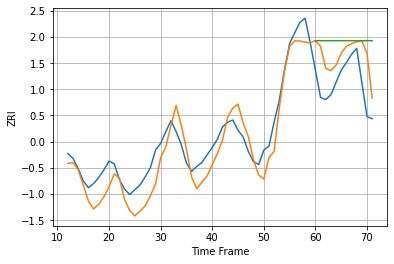

60612 26.44339320757592 46.706031199899066 69.98023799232405


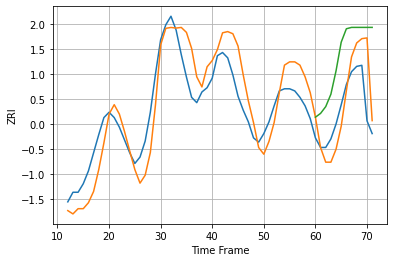

60613 23.617448716331662 28.16700844430788 54.14202165223594


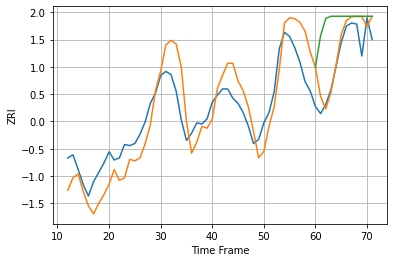

60614 24.42982911126681 18.211813321499314 45.130458738210784


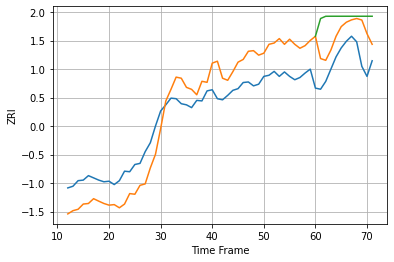

60615 45.945133501699964 53.61399203871279 85.33127523340472


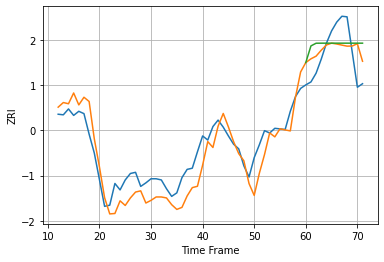

60616 30.745214178423957 38.634254434294604 45.68975391764535


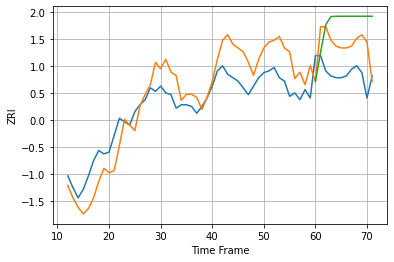

60617 14.302972364510723 19.668803703914442 32.43382231654999


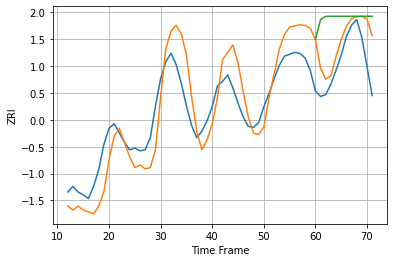

60618 27.494708593225145 31.734384795038217 56.3516674226936


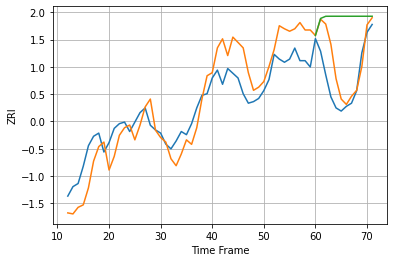

60619 15.09634969984807 16.106498814077437 41.510298512149284


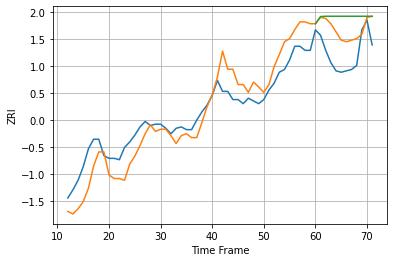

60620 14.280341432105919 19.71139205979705 29.166355678339677


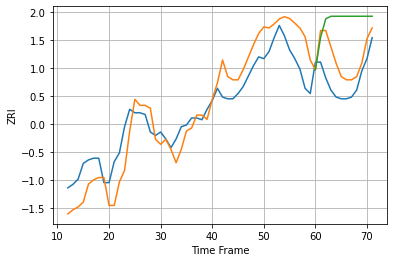

60621 13.60174259417248 14.983400510406552 35.824997457692696


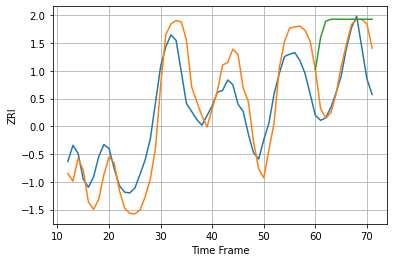

60622 35.35026182570261 32.75649145032319 76.48346664855754


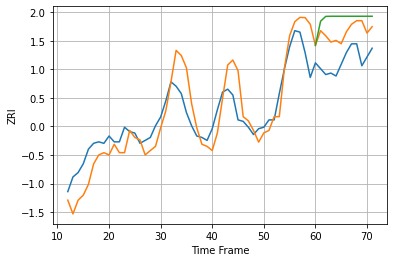

60623 15.08497558951892 20.048892888976372 29.94186628888797


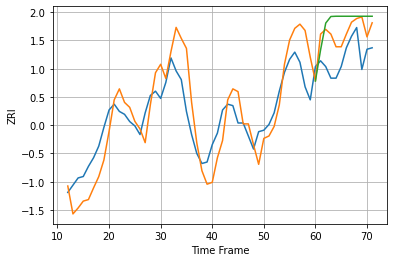

60624 18.150678894653662 19.590515628287562 27.392266518049336


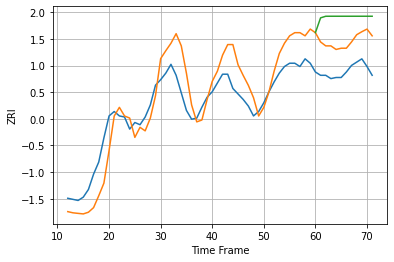

60625 21.227093303440657 28.56473625670887 49.32366450182961


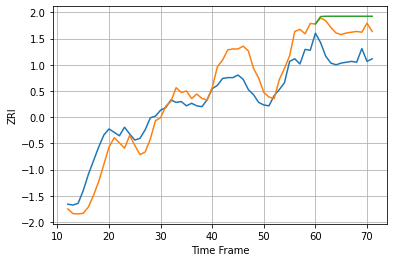

60626 22.821363678105207 34.05987831292417 48.048757835346066


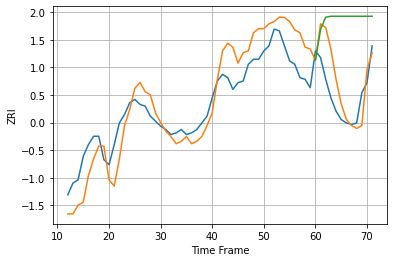

60628 14.284502096815832 16.261403867678272 47.748338808961556


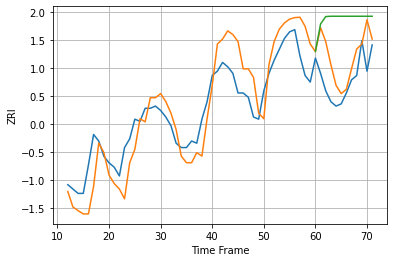

60629 11.81499600657256 13.209335114363256 29.24179455223978


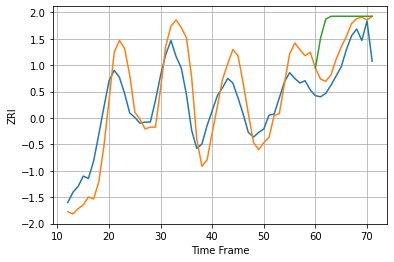

60630 23.87347251758641 17.712168811085277 39.660949010818555


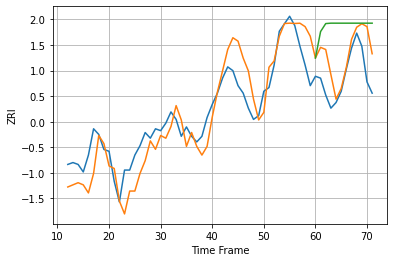

60632 12.298351240308307 15.178793899213721 29.778255892334204


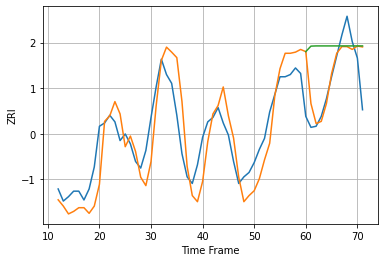

60634 23.423764669761272 26.290562201631047 46.41270199509293


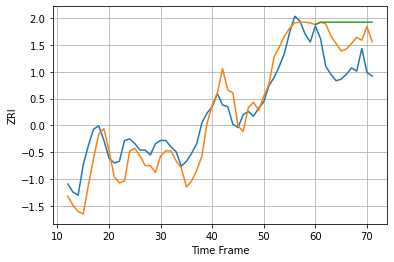

60636 11.997769812387372 19.163469609260886 28.27696375674884


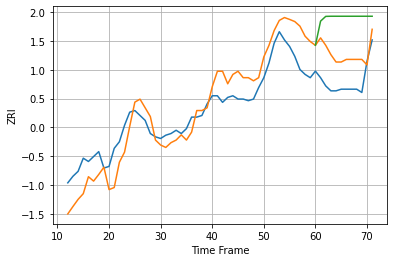

60637 13.295875762366899 18.140696518610042 39.099000644290335


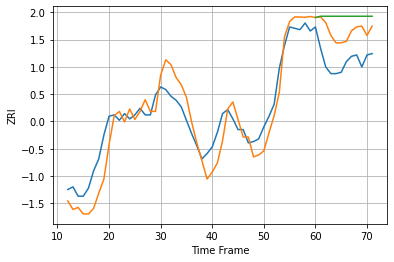

60639 14.421239312040923 22.688261186701048 33.6007129404258


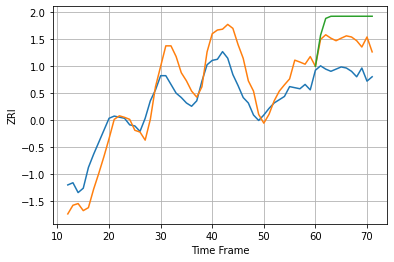

60640 21.36621451444081 27.894472357274626 47.151835298906576


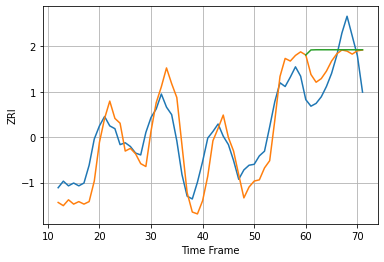

60641 23.91283924396691 27.210935815573293 38.496898562632154


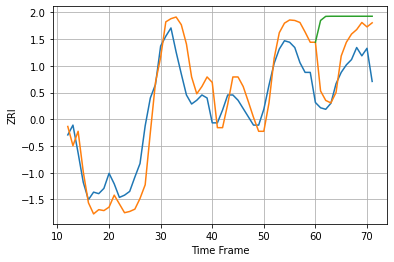

60642 33.03096756311296 39.870493142519685 83.28740656337719


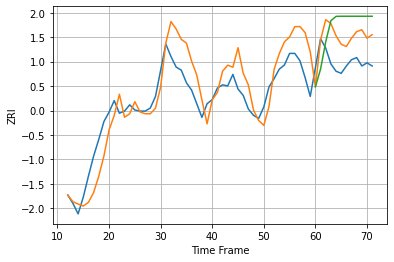

60644 21.79703530606775 26.592771676330074 41.42118066610403


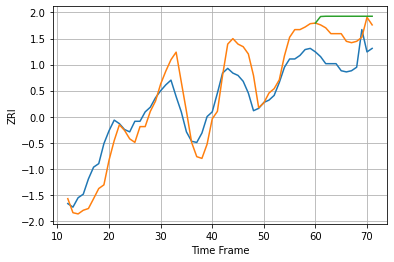

60645 18.54736720093336 25.15533384790906 37.4753667499726


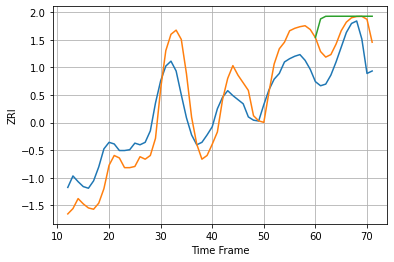

60647 30.320953812040237 33.920715920956965 55.280899856981684


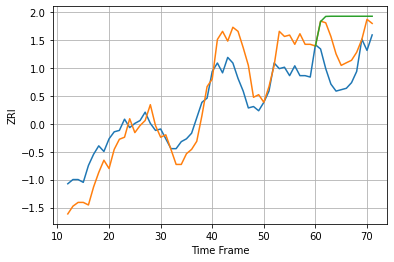

60649 17.446015672770653 20.290159974466746 37.781123671284334


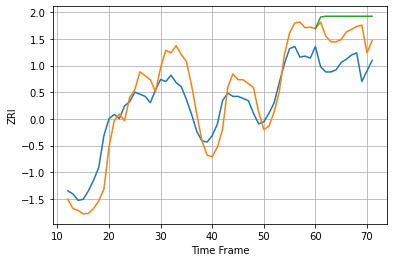

60651 20.89933385501254 29.563622220554233 45.42837058044343


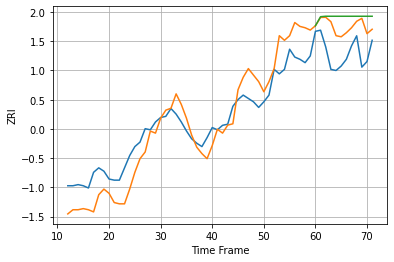

60653 19.40941454728245 25.71801815101045 34.34392742525227


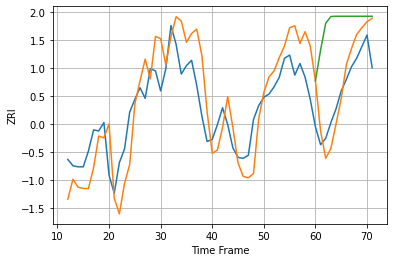

60654 30.410435527822724 24.089436426779823 68.1342045641772


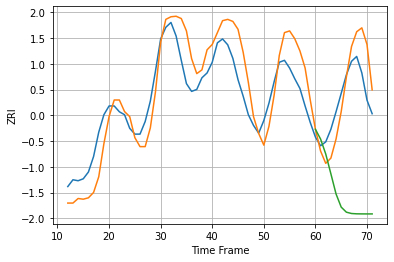

60657 26.788254405384397 28.186900893689206 107.82979241859113


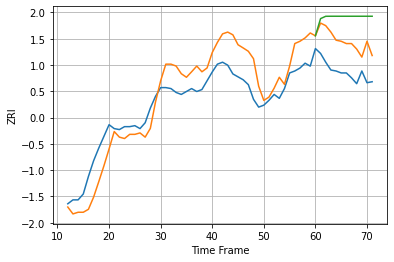

60660 22.869967899963008 31.907626897400448 55.98765133175141


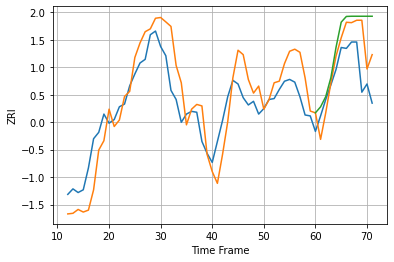

60661 28.986110704760716 32.630926211524844 46.80262938673398


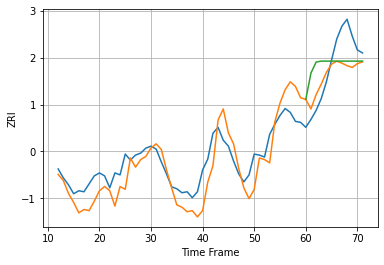

60804 19.596118436465407 23.8468584204892 31.04130640035719


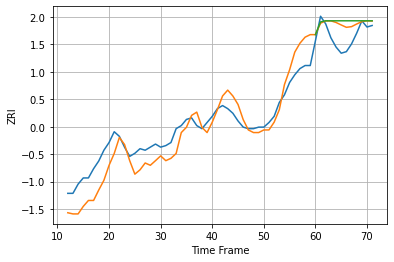

61104 11.27502503160327 9.95582653366706 11.57636982492702


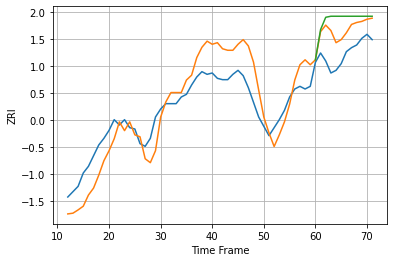

63104 16.970815707299238 18.458812542529643 26.767127103964075


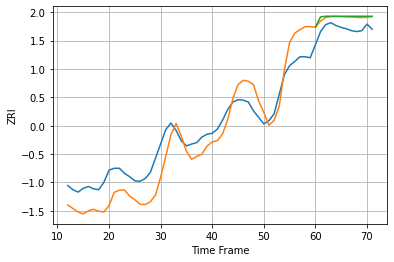

63105 44.46179089038053 24.79018132402897 26.833094611471886


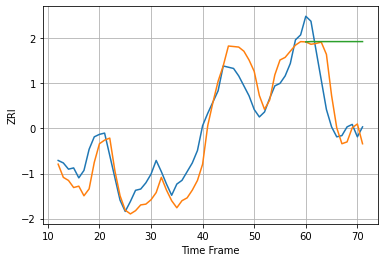

63107 16.280623586715286 20.15761554039714 58.24149870531929


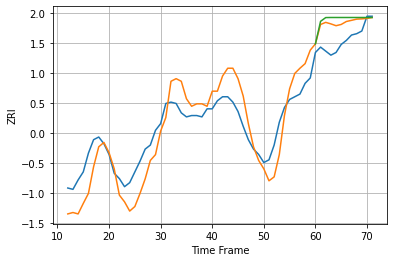

63108 16.77012742270394 14.346120160587539 17.362736318672237


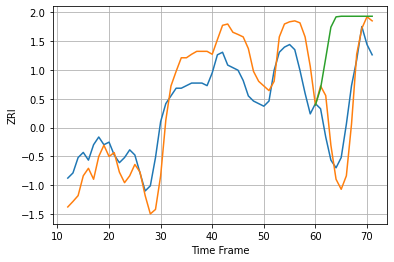

63109 11.417694380897924 11.065927725755584 33.308683788234916


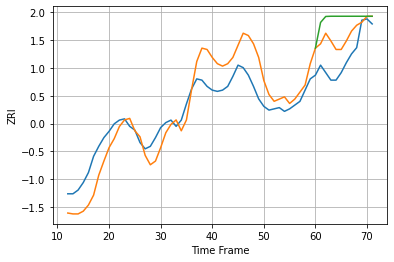

63110 17.494711960240426 19.76878741328402 34.0402588985936


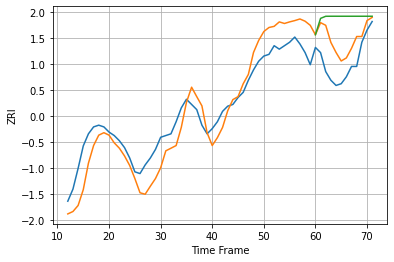

63111 11.843036405441072 14.904915355856634 27.675397334742787


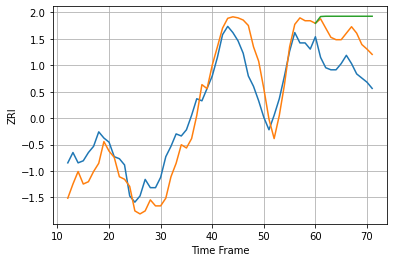

63112 11.139481168065764 15.700805932705904 25.33870823533731


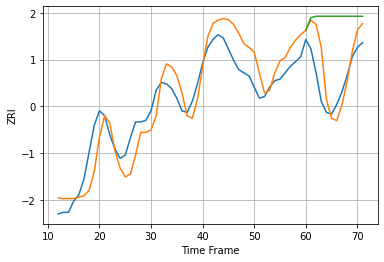

63113 13.436846394351607 15.779683331374045 40.9839884718123


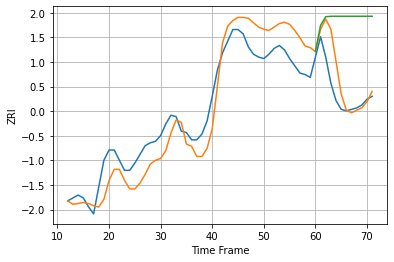

63115 15.323016399009454 15.7588316225768 52.32699842968047


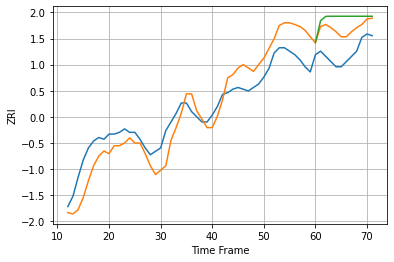

63116 11.805679902964568 14.508582416525373 21.06489738597179


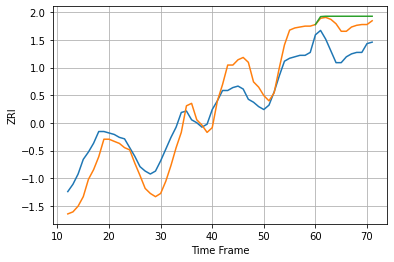

63118 14.43035172963029 17.54762483898824 22.83495390096549


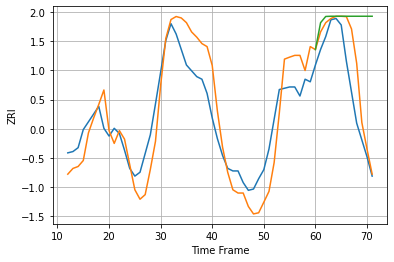

63130 21.392379779116602 23.157054378927757 63.686980460463765


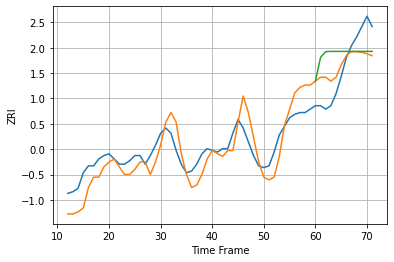

63139 10.019301887020621 13.65257402073859 20.113312445179737


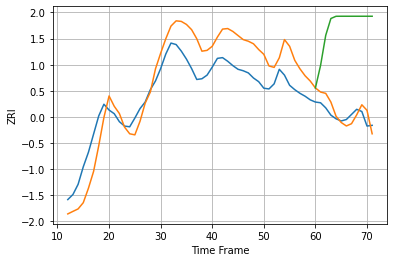

64111 35.14100367681235 13.88772631133769 125.20516340711492


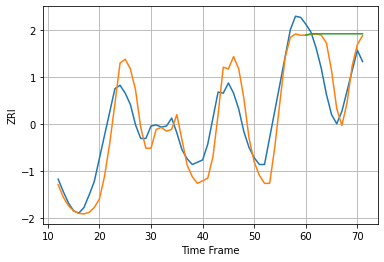

64801 20.259756079706207 21.769313233994882 45.247726120632294


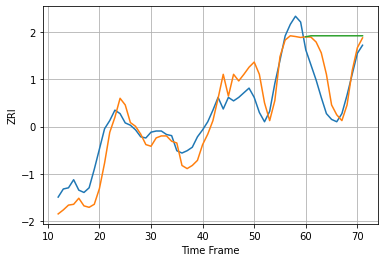

64804 15.964024708709552 19.95621845852972 48.96329110960634


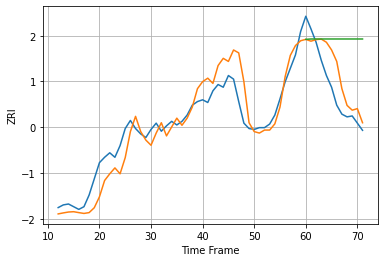

64834 19.213371983499847 26.17101454304628 66.0217816005536


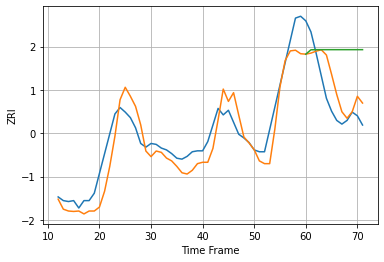

64836 19.823333844301906 26.491369733118944 60.86421409850496


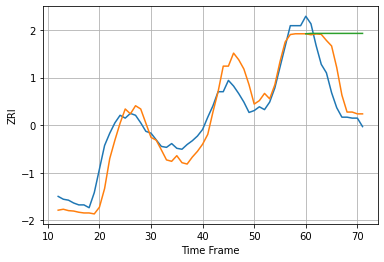

64870 17.80845624828275 25.67095176550086 67.86014904664293


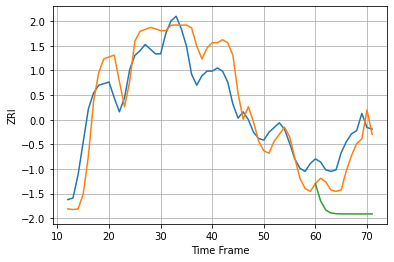

65201 15.329149358754936 13.880112571833129 42.98387233204566


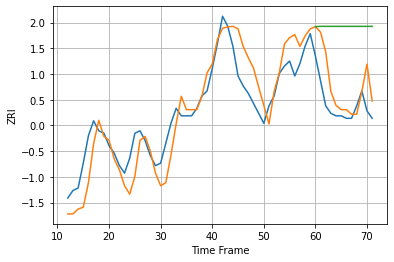

65202 9.193301869444117 11.24477337194681 32.123482189941164


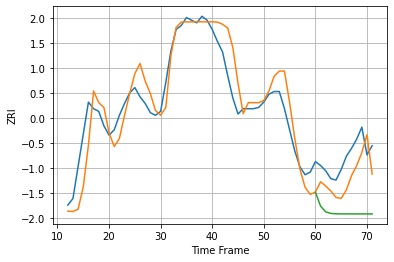

65203 16.205984594953783 18.490602480686594 42.29869018777645


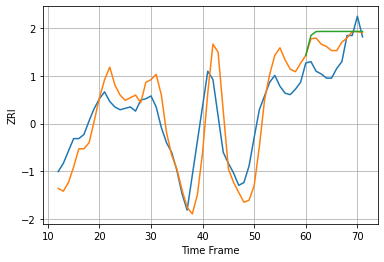

66061 19.02682724018936 15.288468121118292 22.081123192210764


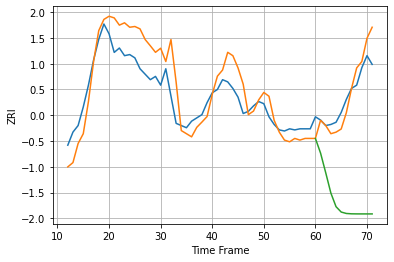

66213 20.608895555259274 14.770359024863572 98.80925451247683


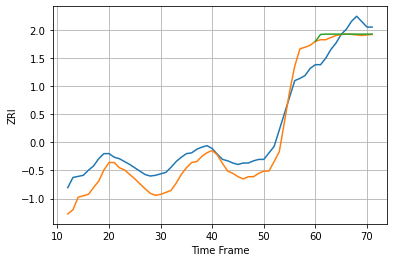

66214 23.284665945782116 20.19829979205961 22.306293934986552


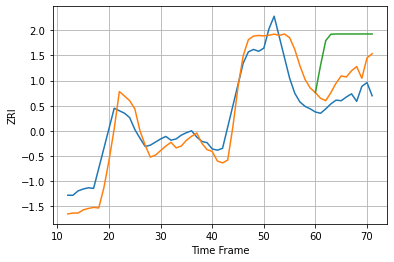

66215 31.675486381906644 36.557884258417594 94.57527601745825


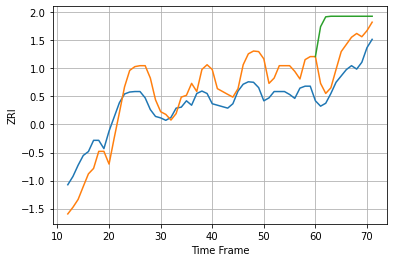

66223 46.932786615369054 50.57549443559518 120.31458217328424


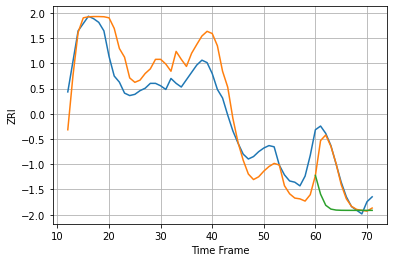

66502 19.10771679786818 11.9216770866355 32.88096828291178


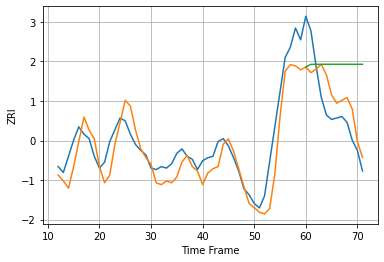

66614 13.071602330700681 19.53349259760547 41.04529882243198


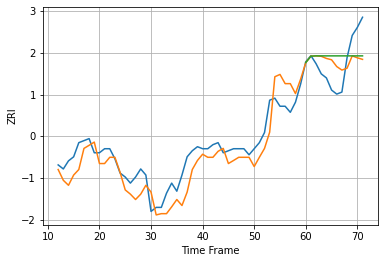

67218 8.359743813965359 11.18557936920032 12.39423619572097


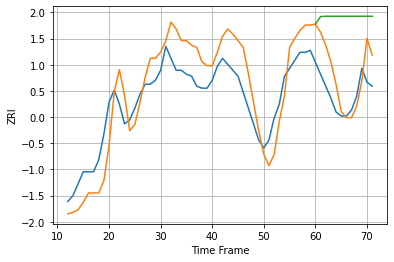

72205 13.514110656505357 14.653973191252161 39.08725409108061


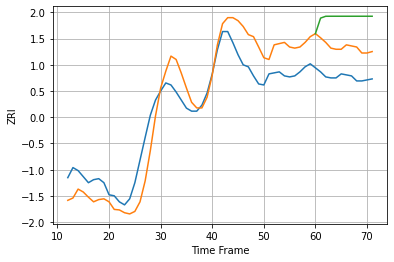

72712 23.968641013793363 30.099017714314357 58.72415387000012


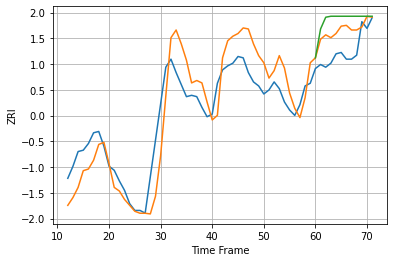

72764 19.537275020318027 17.1942532961283 25.681684876178615


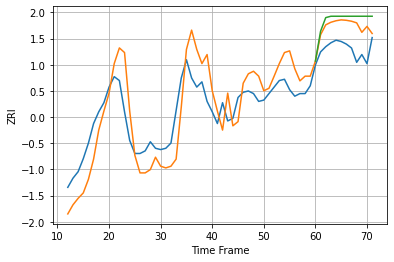

73071 20.047039090131484 18.267499256897523 23.54326933985335


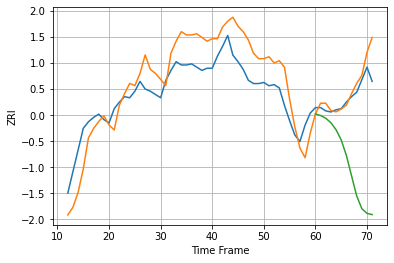

73159 23.07764259606583 12.915395498399237 73.38521434765453


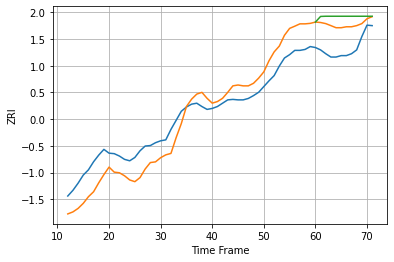

75001 40.31244566590469 52.05266421134093 68.39168068865155


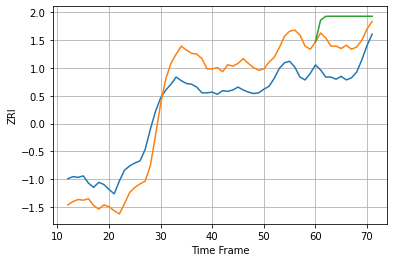

75010 36.93144073717078 39.73404990565387 72.09205548745969


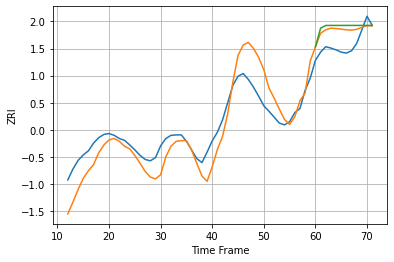

75013 42.73745389488456 37.384771574016 44.31209546263799


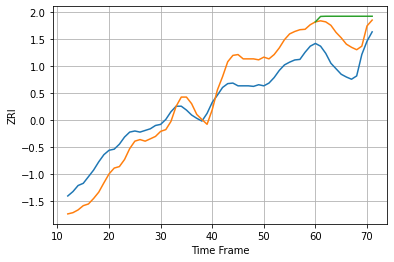

75024 37.42520799909959 50.85997625117793 82.22387269770127


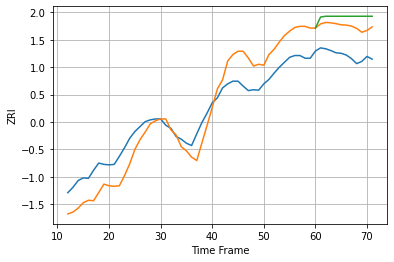

75039 49.12827345998247 64.143422245152 84.81349237109501


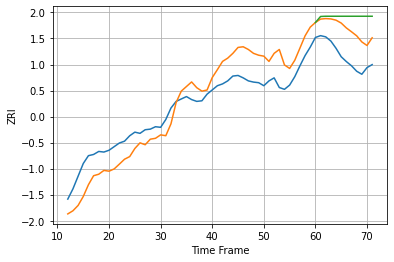

75050 34.60559507259634 45.52890333801232 67.99216439697459


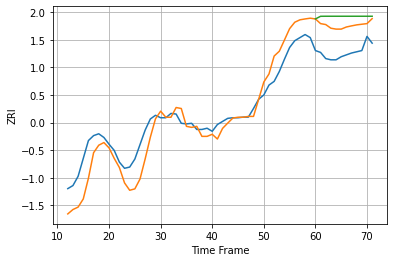

75052 27.653230472113503 45.372660947543366 59.14519178849651


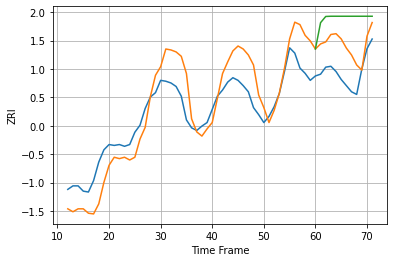

75056 28.52086671817271 33.52764971912821 62.706606755630105


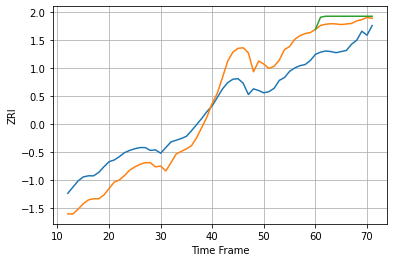

75063 40.33991698693275 40.85279286957113 51.30900442371999


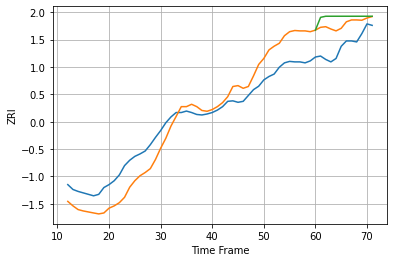

75067 41.28499495582015 47.30586042414495 62.680460507533525


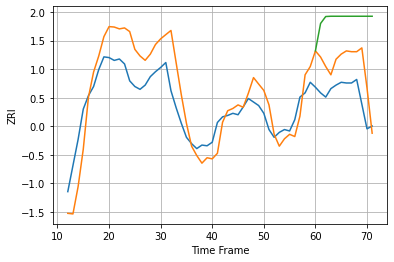

75070 36.84581517865719 46.39882314944011 110.02983769805252


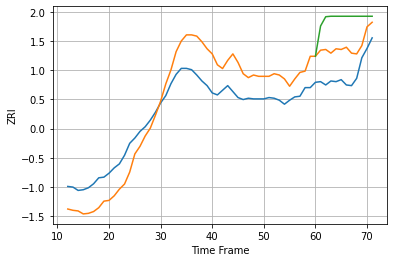

75074 38.482097469065 42.70593012950131 84.32747569636734


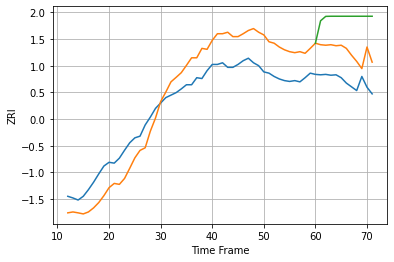

75081 60.57759584393846 74.0101133518717 151.89605581362633


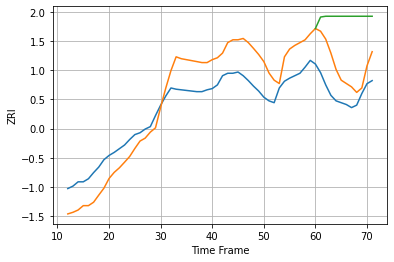

75093 42.83676838231847 48.40772247223481 123.31691598717538


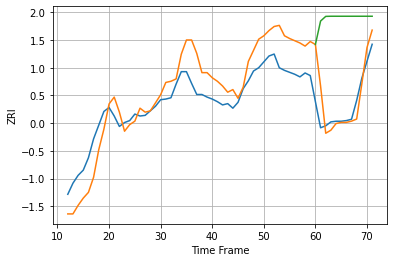

75201 36.81798069800624 34.04484131781471 136.45443246817382


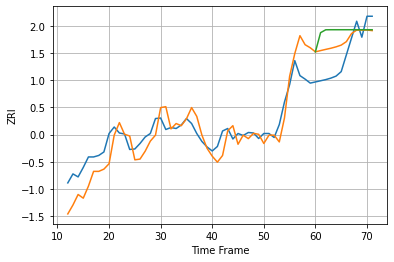

75202 34.526697729215876 44.444751766515054 66.31946439969789


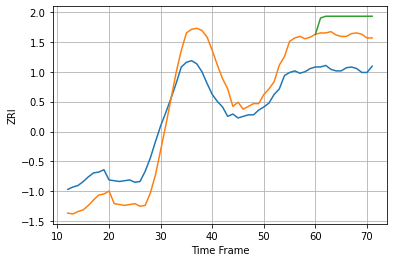

75204 33.33116885929148 43.527698121448424 65.26619028663241


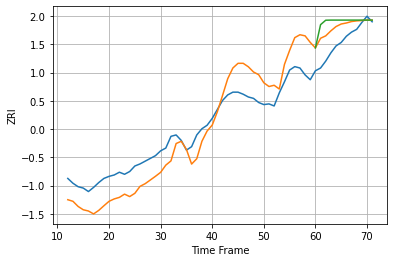

75206 32.46668364672635 25.18355566493573 34.55713029509206


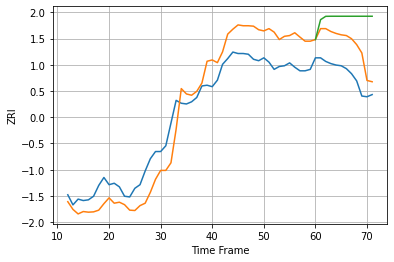

75214 33.33196973678477 42.33578655389316 80.21921155061237


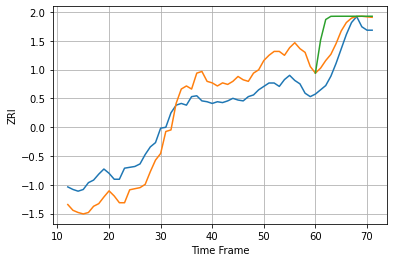

75219 28.40441049303985 19.595264960896554 41.531417938502145


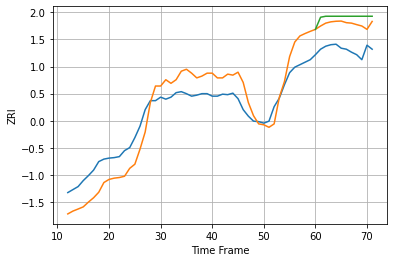

75235 40.93738911945274 52.02629291946986 65.48565092233139


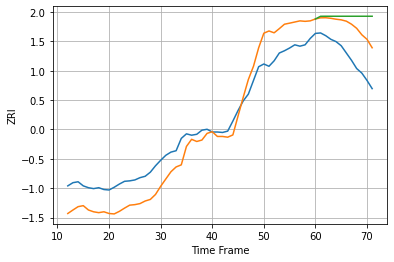

75243 47.294382724698245 66.73988460943433 92.80554375648565


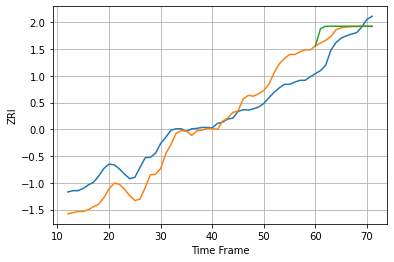

75244 43.121659218928954 35.09768200098188 47.51327990762364


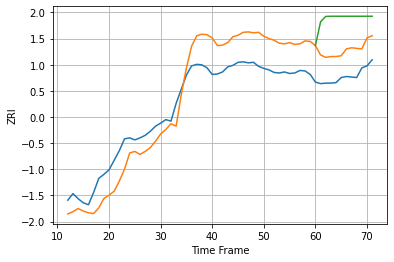

75248 48.997073941482824 53.61034916210325 114.38030605974453


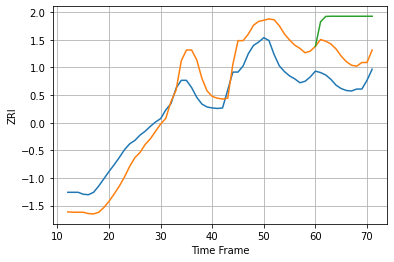

75287 49.0883373192819 59.16994877931486 132.0979109202687


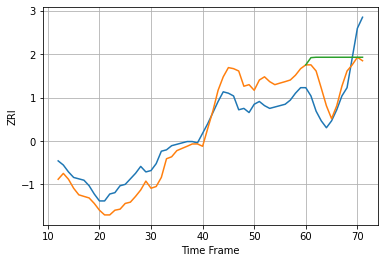

75703 13.361799641504561 18.484455233429735 33.421787367987896


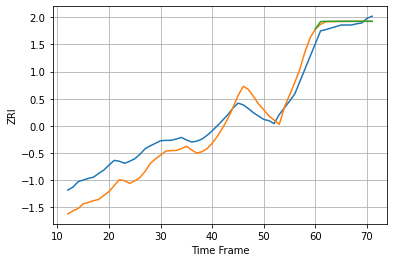

76006 39.972264322216 14.8537623450051 15.776974941422452


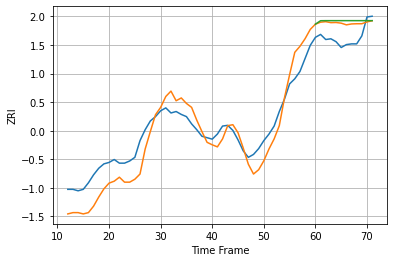

76010 24.722623737952663 22.626627075445803 25.507144617771296


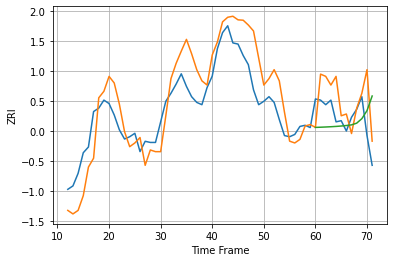

76012 22.9815688735364 25.35939355779731 23.92493906373054


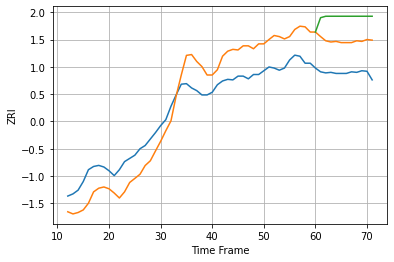

76015 47.00250233913143 60.5238528701637 102.80234353382251


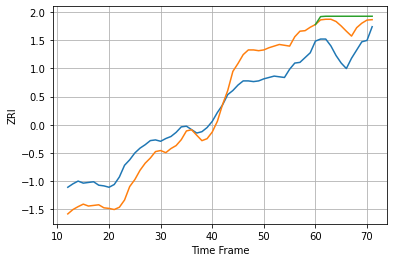

76017 32.74045777238534 36.37101018340562 47.79203200216412


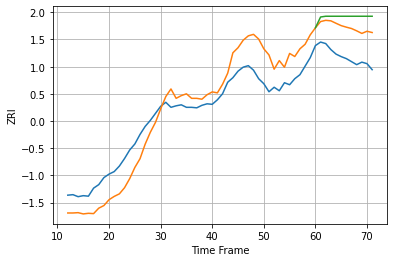

76039 43.711295877111496 58.919567279164696 79.83074416629258


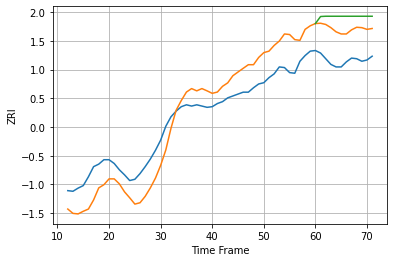

76051 37.0298042647059 49.80571322469383 68.58940410811843


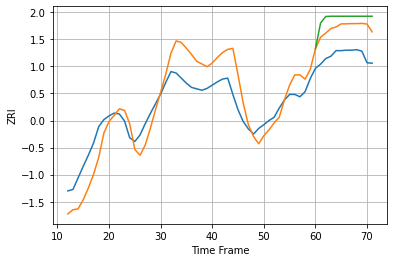

76107 46.741719874667716 59.173026417113356 80.33108890972866


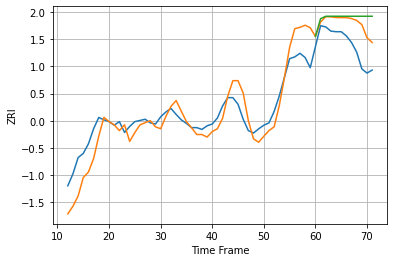

76108 28.513693760862946 39.4249812149766 53.24265459229506


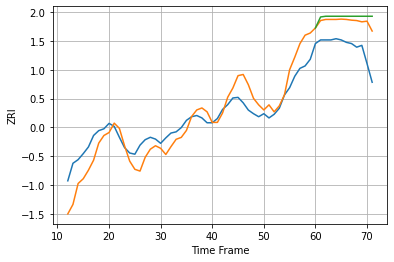

76116 27.80569772015408 45.325367788391965 53.960843273735264


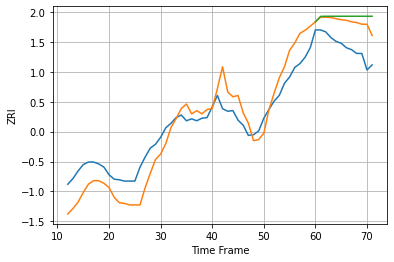

76132 31.791489421457747 41.17506906001737 50.69167504286187


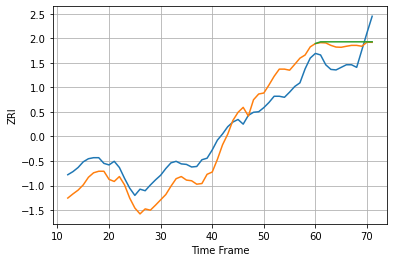

76133 35.54384899417231 36.29770289216956 41.50325480760846


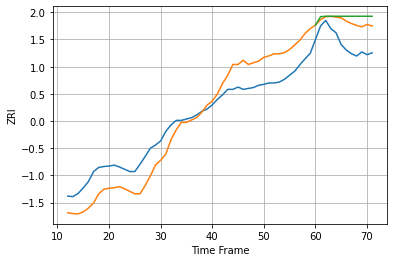

76137 47.353349445621724 50.32040840351979 62.52105985885581


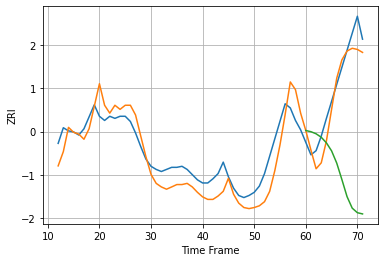

76522 16.93226816654603 16.092827197960776 105.11312591646507


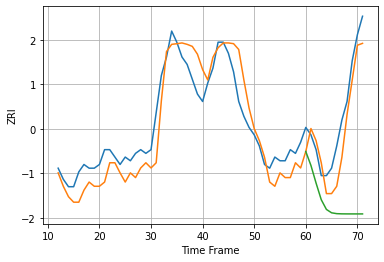

76543 5.863138943549645 6.149971509676439 27.76371393391943


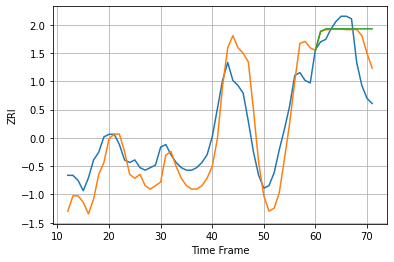

76549 10.163882562834324 9.802640871262952 13.975716569961158


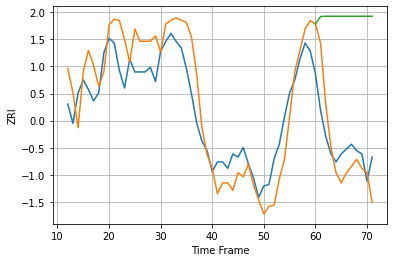

77004 18.169855649670975 20.09616124647987 80.92402832479608


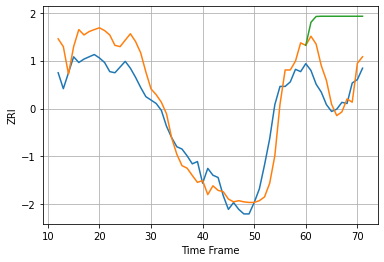

77006 20.216717731788364 18.582780699798153 64.49654700283703


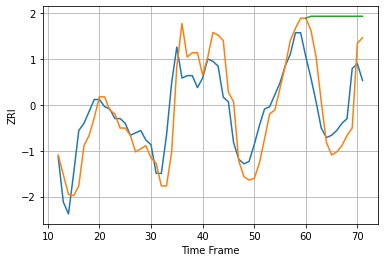

77007 10.782723202463645 14.278596188106196 37.937227962553266


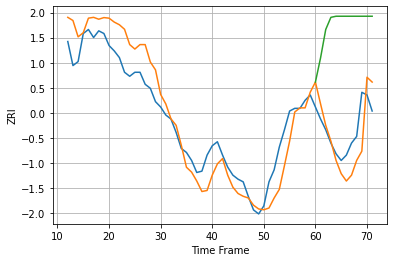

77019 16.824336754665026 19.301344844870155 81.03608249711202


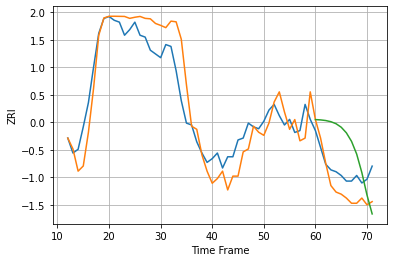

77027 12.122165298566163 10.822446365787114 19.97962471848852


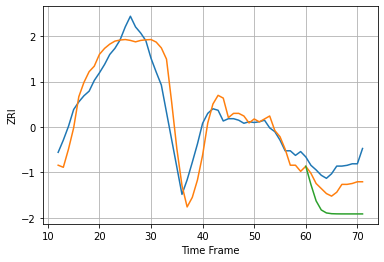

77042 25.162760317142183 25.167537141495526 55.54861836796791


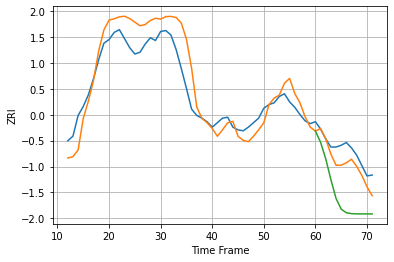

77054 21.19854478147612 14.915166594277538 51.97173315371636


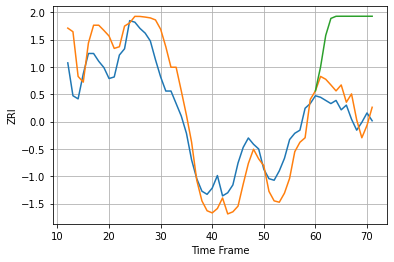

77056 17.382124270667994 10.5909064397108 55.73219792422561


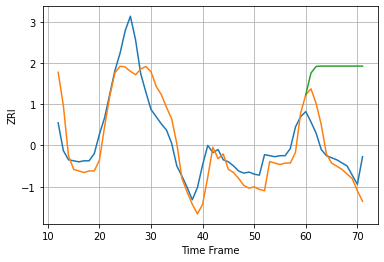

77057 21.842226378060722 20.10467398536302 85.73245371174141


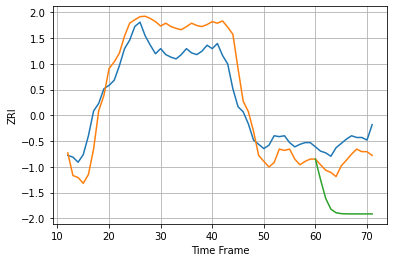

77063 27.584728132098004 22.504037922264967 76.89626739611731


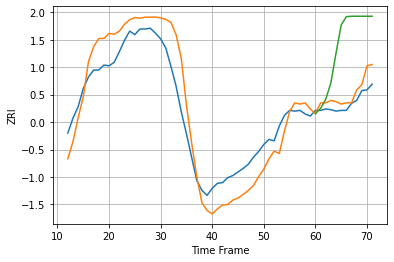

77077 33.23454823145465 15.704823654972255 91.67011791952731


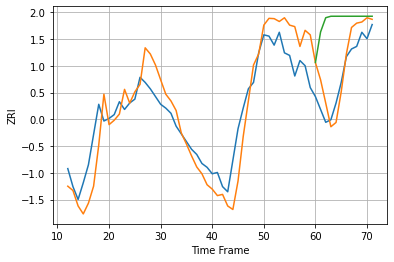

77090 19.852902055798182 15.061791397426122 47.691685948103974


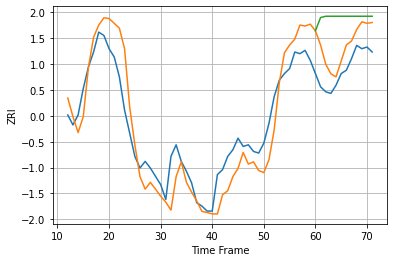

77098 14.970473968429442 15.877540512772088 32.67347088960344


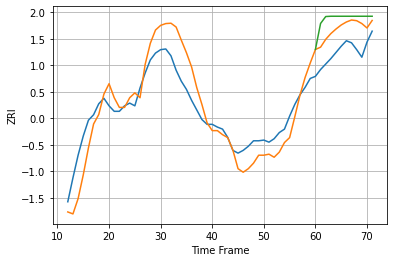

77380 30.476545815866082 34.26389140841825 50.000191188046124


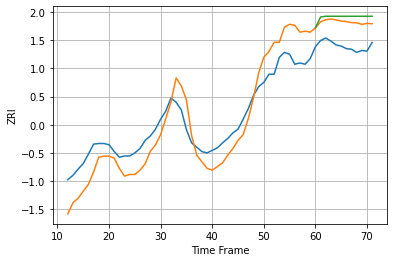

77429 34.23146348030696 38.40404297888171 46.764731880201936


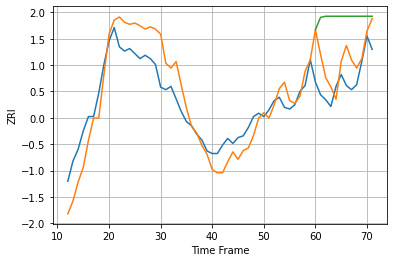

77494 26.920027403080052 33.165002537580015 77.29374491439316


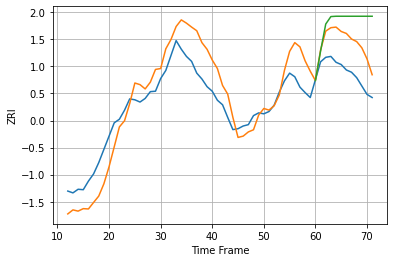

77550 51.26996266660867 66.88605040885527 118.8793729738061


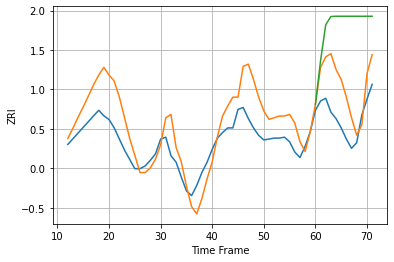

77584 28.35064833007031 38.692526526089836 102.7536915539213


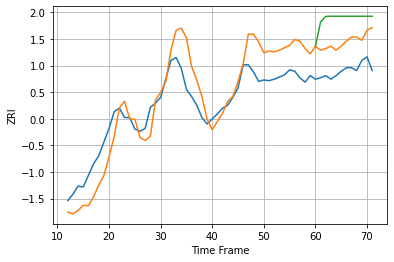

77598 33.41779050592531 41.23802633560167 72.59912480631311


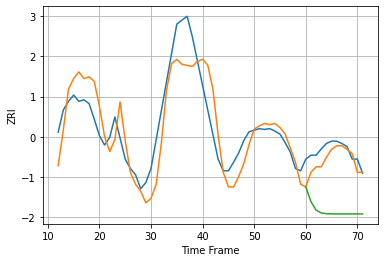

77840 30.829092279701946 16.599940355404144 76.43212919408884


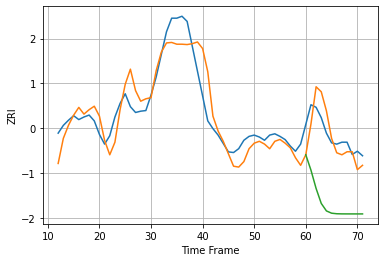

77845 27.88675877736083 27.069791609587966 105.86747896194785


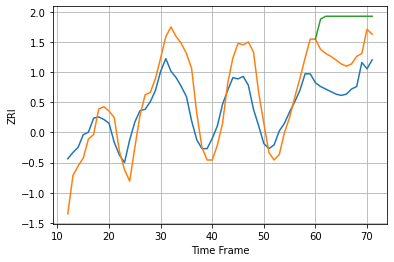

78130 20.80804925007863 25.529887571006462 52.36534557477976


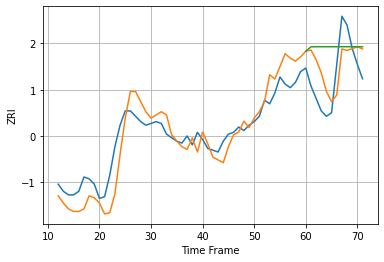

78201 9.854970926200759 15.424339917749355 23.328781013233137


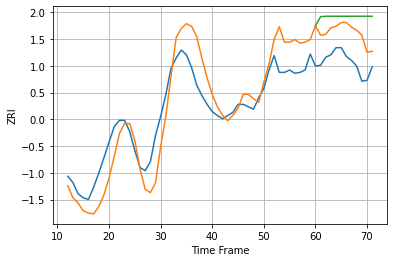

78209 29.899206482236167 38.81971641273201 58.306891119980506


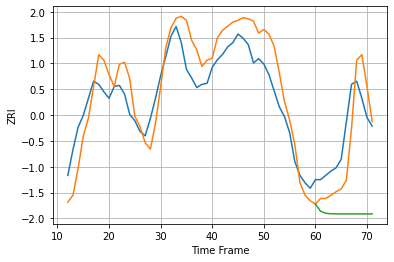

78210 24.117445082028496 29.742943478699004 77.75235995467462


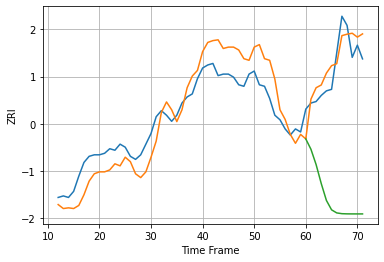

78212 14.069954467001972 11.875578227039963 88.61242116495607


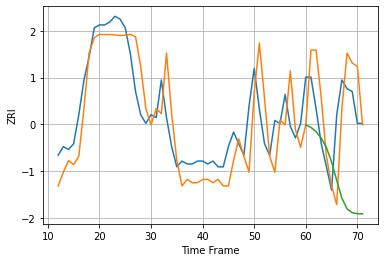

78213 10.293242012630966 15.089145841098208 26.422203376365726


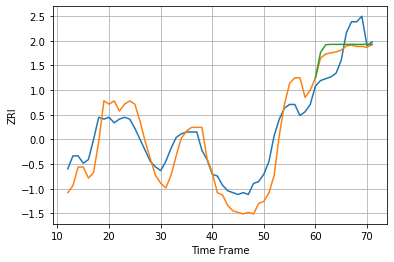

78216 10.756125148263907 10.622749557429083 12.28714295976243


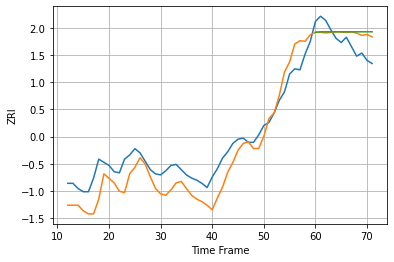

78229 18.26359623294496 15.431081719361435 16.86254527737696


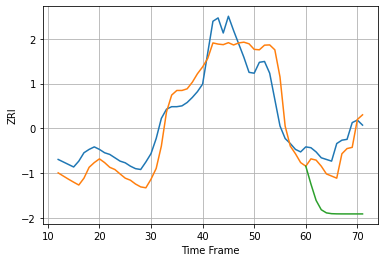

78233 23.837665738094977 19.659031414555876 79.60074969375222


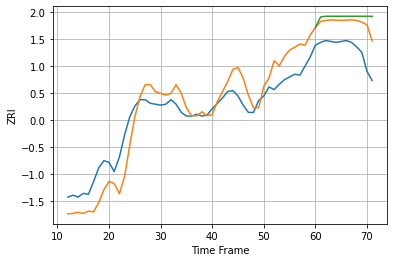

78240 21.655284753652055 29.844812779479398 37.82547437917006


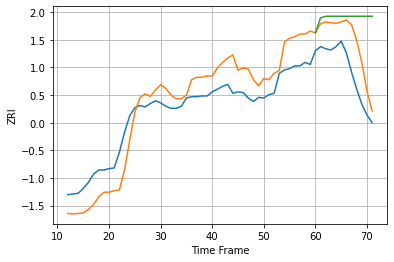

78249 32.8840854914526 44.86591727660977 87.85177934463088


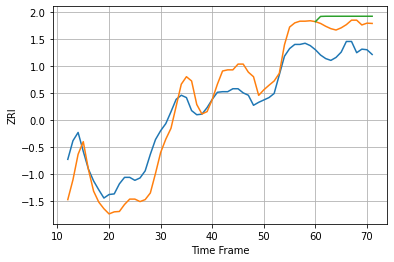

78256 35.403815174339584 46.940916181559466 60.38177315687337


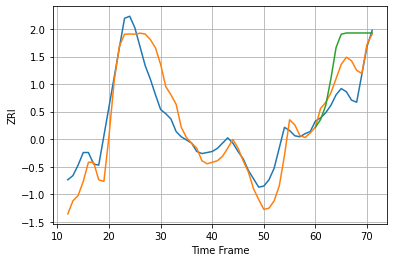

78521 20.645339196689097 19.476546693397214 39.560681339300665


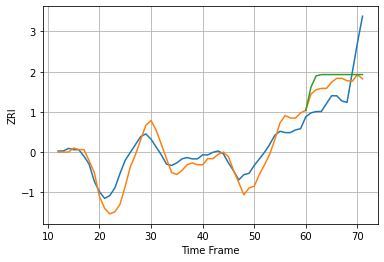

78550 9.271289118219514 19.754387157227296 22.975237169878998


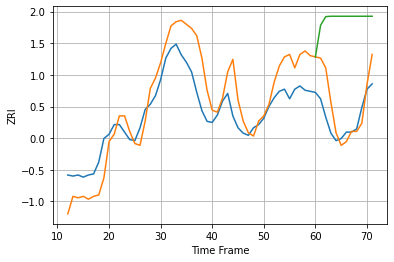

78613 24.844579117428985 23.53269860108692 92.65992221571088


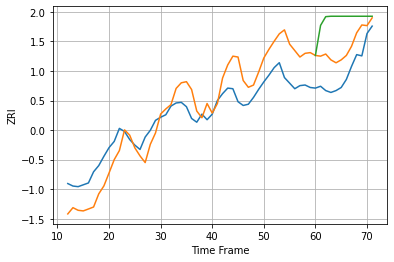

78660 38.641609463906285 42.79842520271831 89.08073476937626


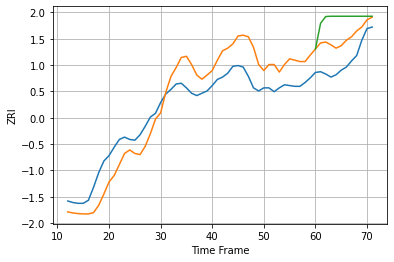

78664 29.386580949669423 31.390425247372328 57.1229725894089


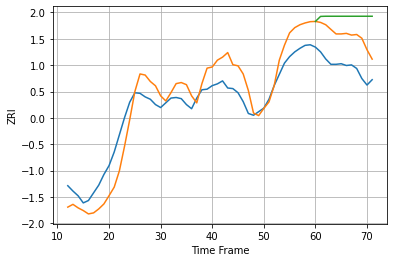

78666 33.8094574200124 53.604413060416874 85.50611324863117


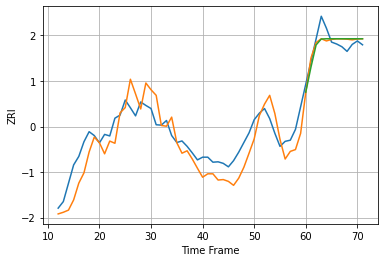

78701 47.06106497947041 24.380107208588743 24.77355625422581


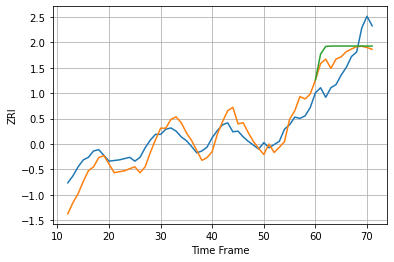

78702 20.591922917434264 34.339335456626316 45.61706576961875


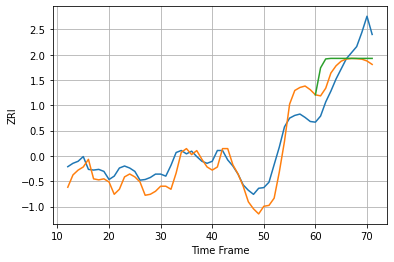

78703 23.510732249713882 32.290484688606945 42.202256916208604


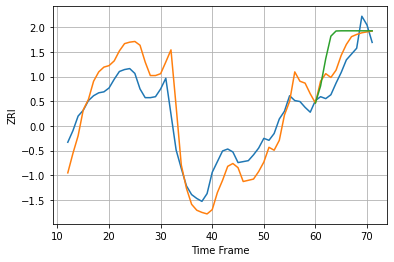

78704 24.61520247148404 15.782087645629307 32.16630446449763


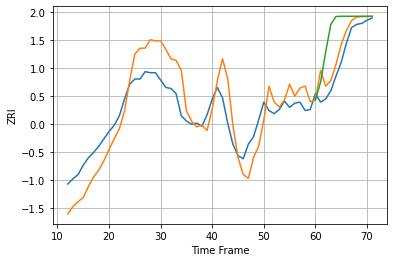

78705 22.762438729756457 12.561306960259026 32.20500552314129


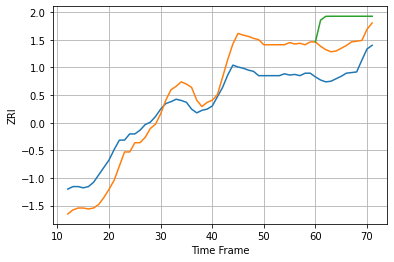

78728 37.67941803722037 46.02105899679923 86.1570714958258


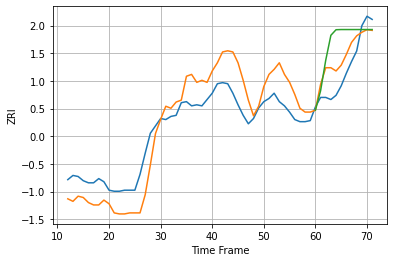

78729 22.96416109724771 18.136162136312496 35.40768332676027


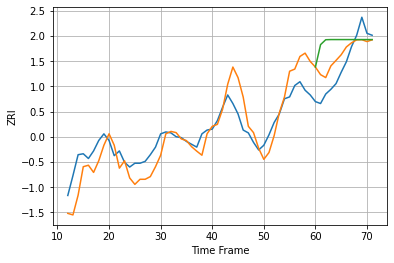

78735 19.81713081258247 20.518307674842223 36.29872342995654


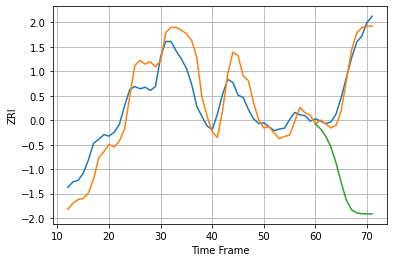

78741 27.298633713116896 9.671577033157403 157.3593324828994


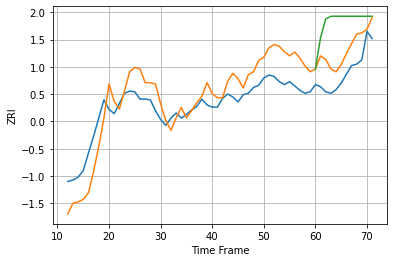

78744 30.26755371954149 31.87624367953844 73.54622343738201


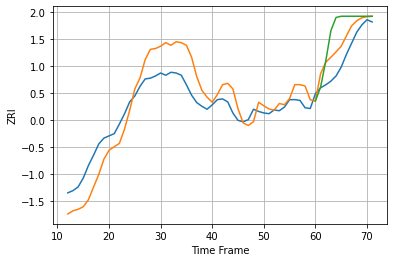

78745 27.73740817739946 22.13678148352244 42.298528195974804


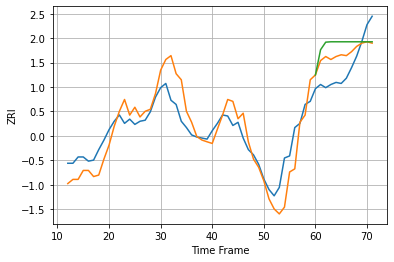

78746 18.26543579702896 20.80788167364078 29.89655674688498


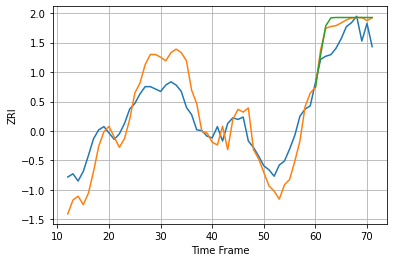

78748 28.910498127734318 22.584014174472482 26.160324927440747


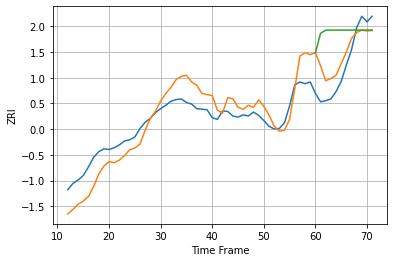

78749 30.655067550953135 36.54513890220523 79.8101224294599


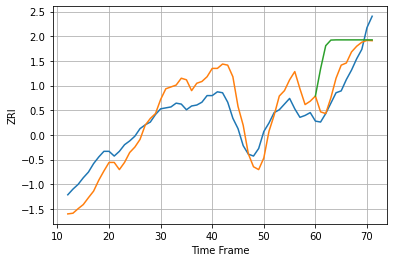

78750 21.95878391556965 17.30513421136346 44.364863889005015


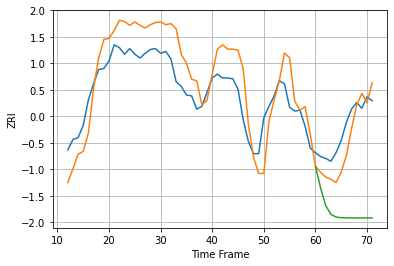

78751 29.17276889390928 21.69001638364436 91.92383515764593


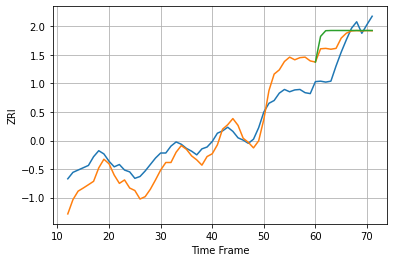

78752 40.929956007930784 41.93361604486413 61.86986892090246


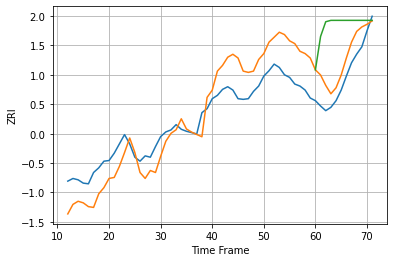

78753 37.59721780148544 30.261689790688678 86.22081507106356


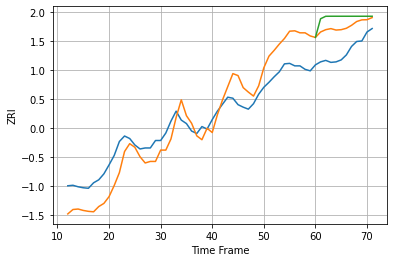

78754 43.512530870640774 51.643662651822495 70.4055326933456


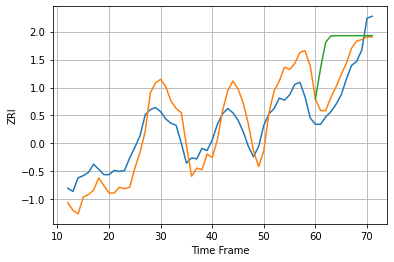

78757 22.455786067497634 16.589258081376176 45.777418250379625


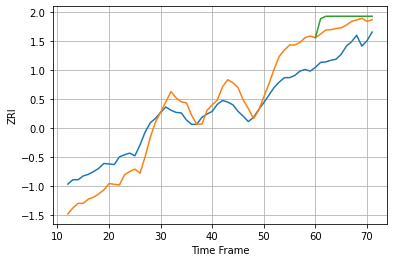

78758 37.655319843268956 46.62016952872461 62.33134176759082


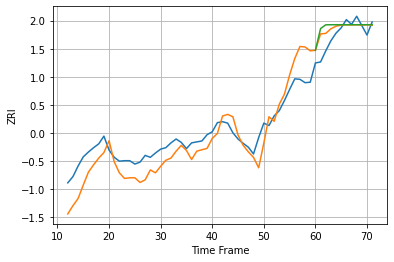

78759 36.634164834322824 24.494985643675633 30.011460463571055


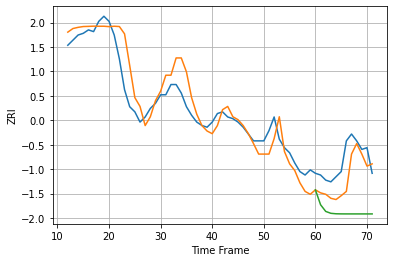

79912 10.228167224727898 12.631496416662946 30.970010632901612


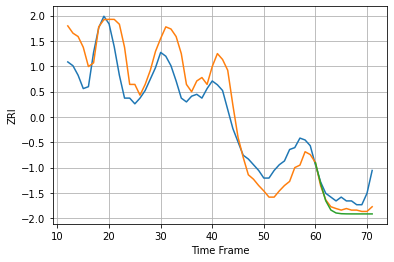

79936 13.163812510282332 7.180949746683519 8.931507355437189


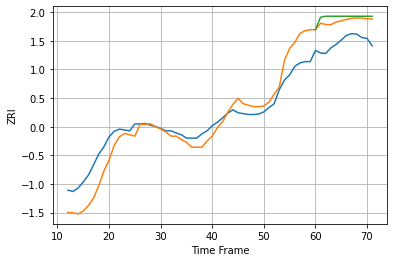

80021 38.22090857733557 51.09290219036345 61.04237082007756


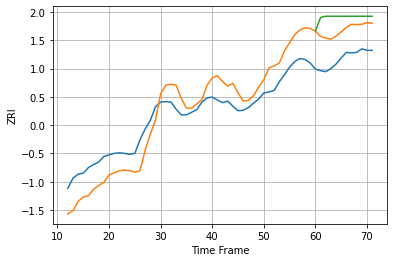

80027 40.86243777611036 57.96377266648167 83.34808572196535


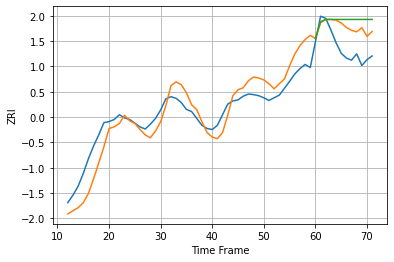

80033 30.650669526958747 43.92806641908444 57.848846241720224


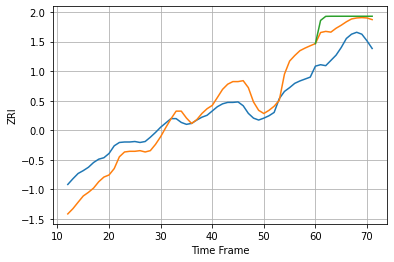

80111 37.835734998807375 50.96916306677266 67.38001203712953


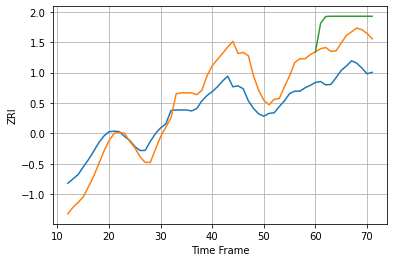

80112 46.65583638676518 68.75214196066725 113.7881698662311


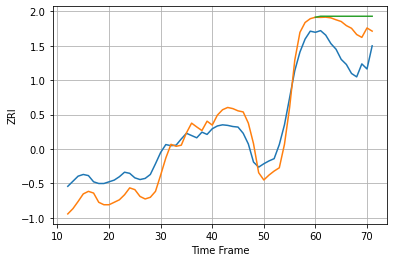

80120 30.682523785372304 55.197911453572864 71.80105454362412


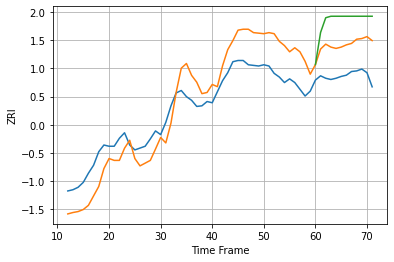

80124 41.11416345483832 51.63803423839511 91.54022201086626


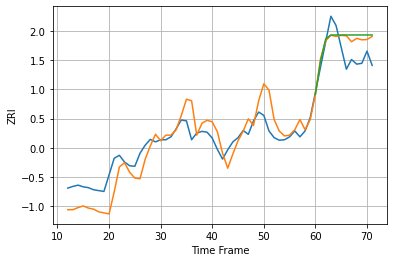

80129 41.56480486358342 45.16518760116394 49.82724487090051


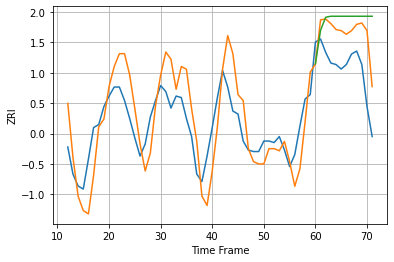

80202 20.346261127208617 26.09423364781409 38.02331159036782


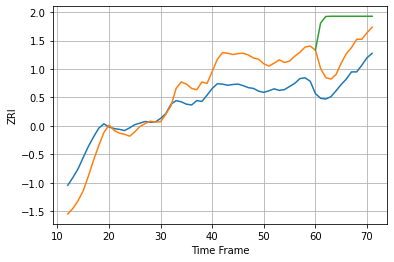

80203 57.45517731406189 67.85630642303455 158.4002007188661


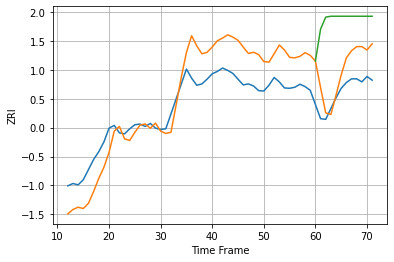

80204 78.98168163507859 80.31576533860496 217.9282920331708


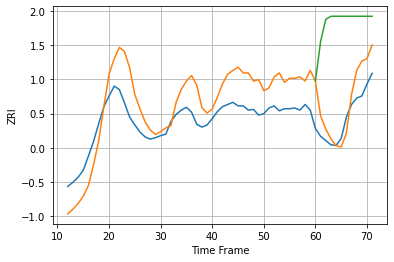

80205 39.19342954475803 33.44424071052639 137.19685557483004


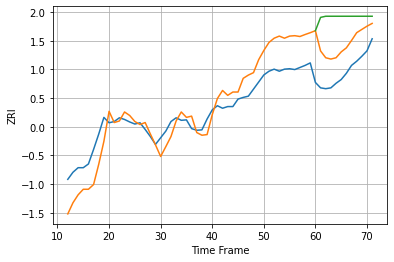

80210 49.44641772711748 72.45265039429958 134.48588839638492


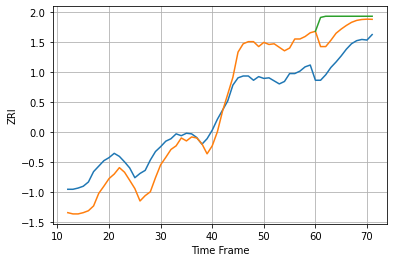

80211 39.807110421174166 45.23284803419111 66.92613379621068


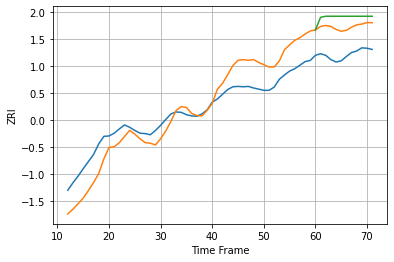

80214 49.746392794308875 70.63078886870315 94.90783732172227


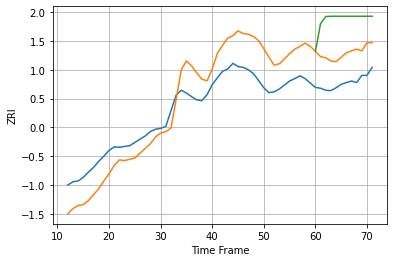

80218 64.28662783228035 74.85764890171598 158.82192081885654


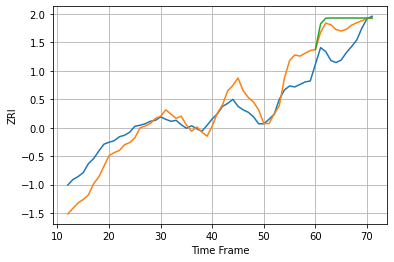

80226 33.94727277560932 44.262597304885695 58.16899051249326


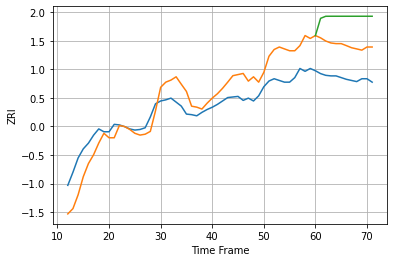

80229 35.900420733592284 58.425841834234305 105.23215131144802


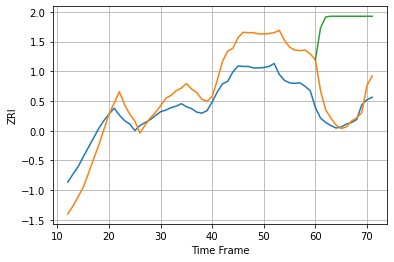

80231 49.72755395482547 36.74572395068066 195.67722302238838


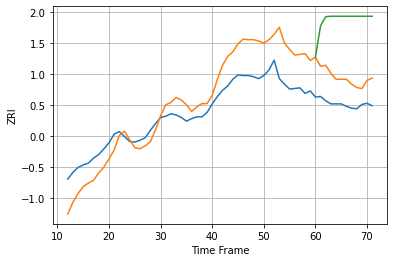

80233 40.1917158271589 44.96263599413073 136.67576828458925


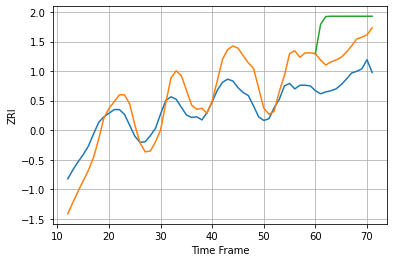

80237 37.558225528591436 51.51095407371738 101.2410620215873


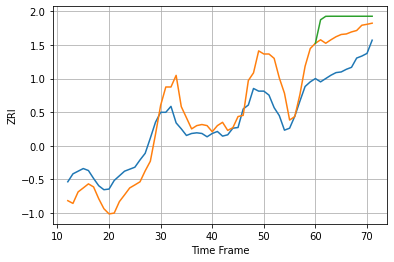

80301 34.52915443910553 50.7977564920633 74.86385950633995


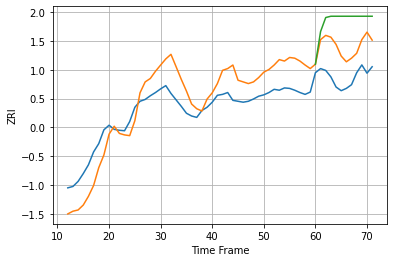

80401 50.13980506471743 67.38076508485018 124.93528974121406


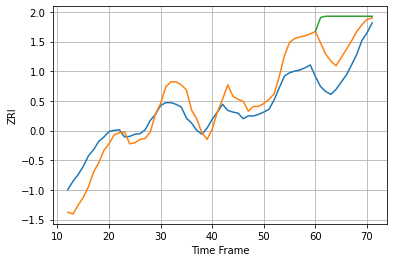

80503 33.54591563552478 51.59036158616474 99.51383970645712


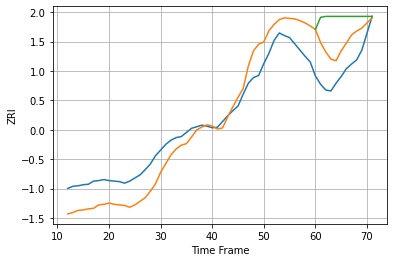

80904 40.66467007426169 57.02942282009998 102.78256799668857


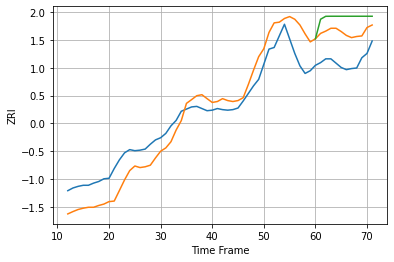

80915 37.30023550721555 54.21005031874788 81.06550232110757


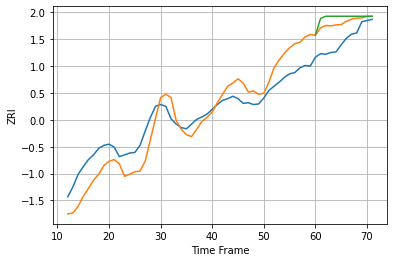

84047 32.27172664902097 33.128467727024095 42.893160022746756


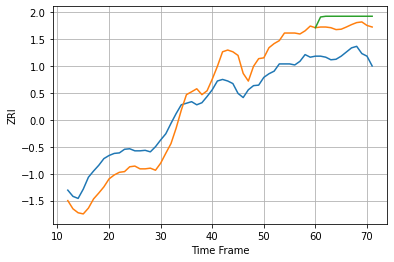

84095 43.42080923832936 56.88441069107539 74.85958799427176


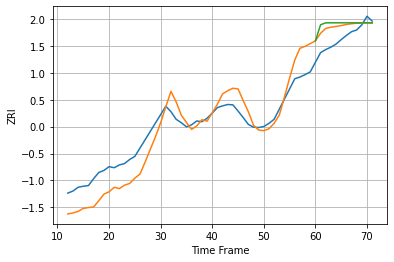

84102 51.29583897537437 41.72111442866928 50.5262698010726


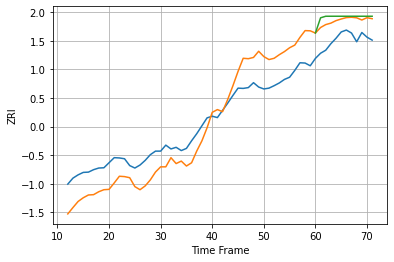

84103 84.44953954112094 73.60584160697948 88.14460223729688


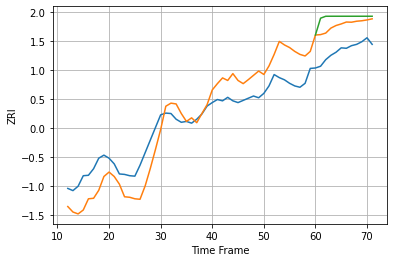

84106 51.422399436462115 58.960936584739464 77.1021676038584


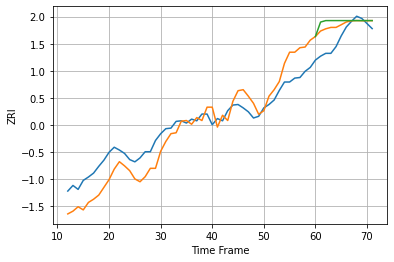

84119 32.56490962806569 28.492189988732644 35.99424384721429


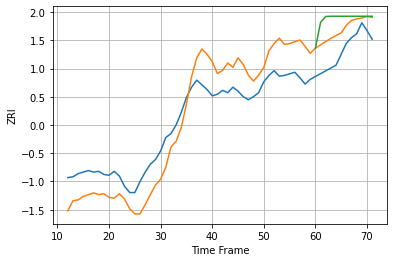

84403 33.05517356638658 29.00945409328271 45.24500033763115


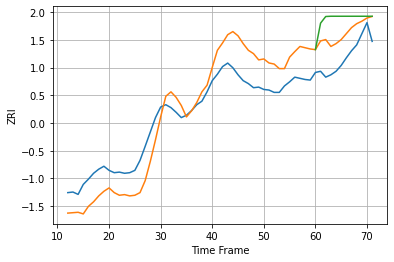

85008 42.06609928856309 42.53253330053097 69.83354311482401


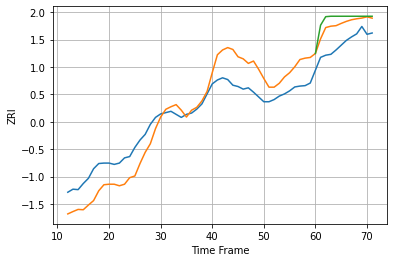

85014 49.2907149105297 45.612184504940195 60.27749957934653


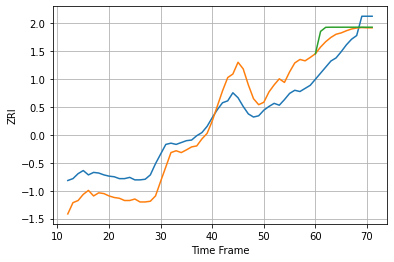

85015 34.46583056333195 30.10415825017164 40.332538615287795


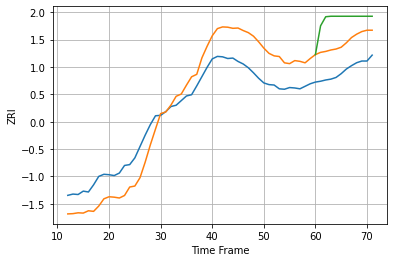

85016 59.2641690828749 66.80406234173365 122.11771479860441


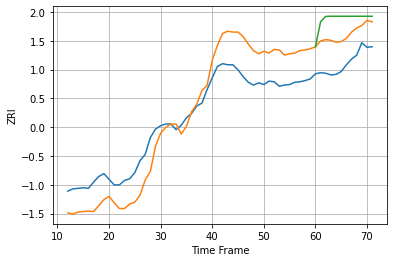

85018 46.120073883193314 50.73223633499309 80.54558876063521


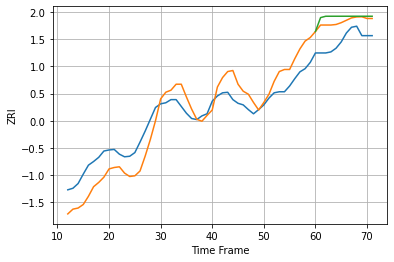

85020 36.014200852058394 38.75479580924321 48.12610768891785


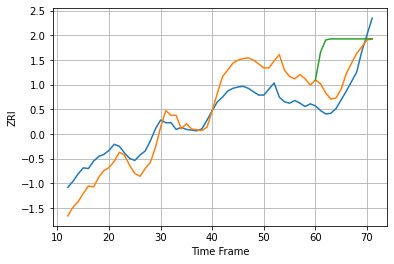

85027 31.088659980032237 26.160485863926258 74.07792070515863


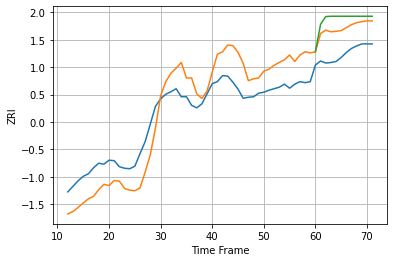

85032 48.54686721033765 50.8851048211946 70.4474262428991


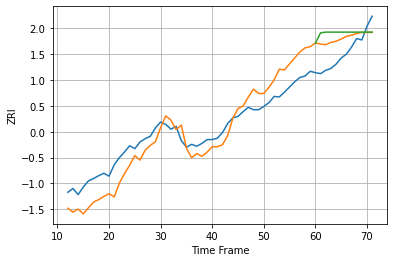

85044 37.4299724897351 42.230846231745566 54.83480523420626


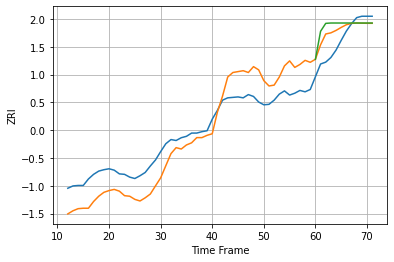

85201 47.597192342731155 33.22754045298324 45.47344847625803


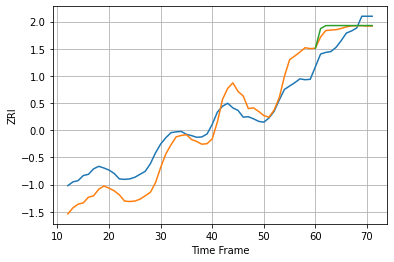

85204 46.08936170283328 33.53953763851438 40.24058827532199


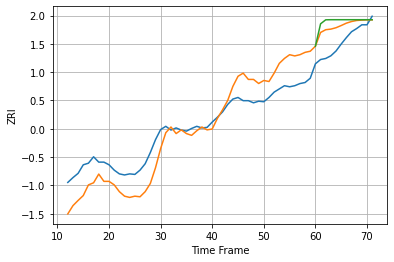

85224 38.92502252432552 33.74320362983038 43.74116258541967


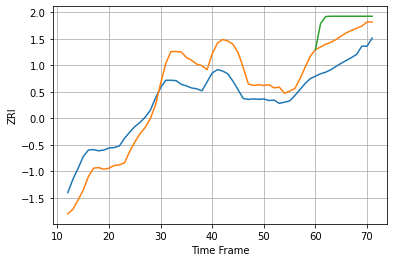

85251 54.24526841734236 63.1212471268978 103.8708205609251


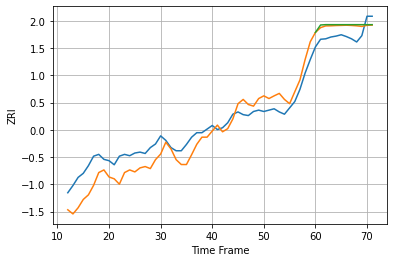

85260 35.23330476137444 25.986858201985683 27.894967744357245


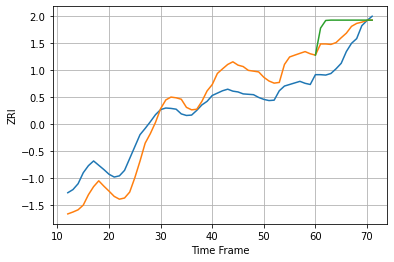

85281 54.95209941259442 53.913926617051125 88.7365167821601


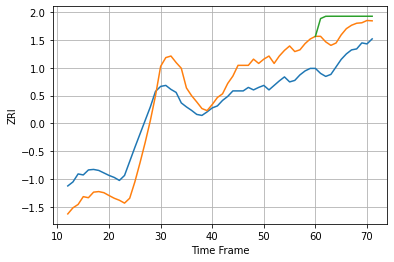

85282 48.32915898507421 54.132507550647425 83.77142997198699


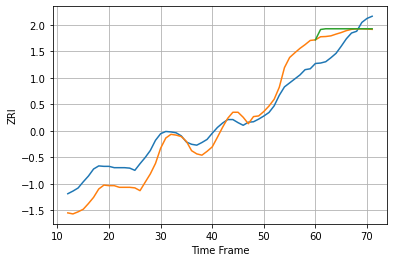

85283 39.327615308611946 37.740161905598455 45.98386391960579


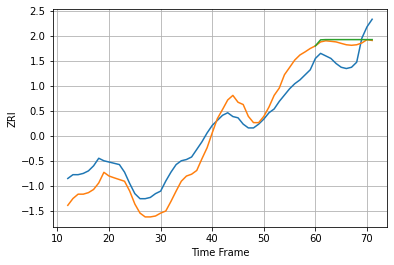

85705 14.441488160833089 14.146210647753385 16.132228723251412


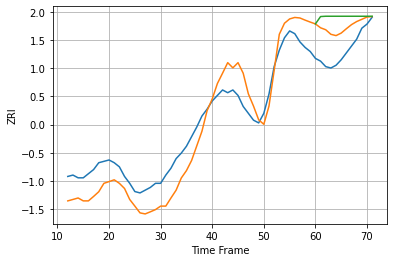

85716 15.762375734521068 18.65571964454637 26.3071855088695


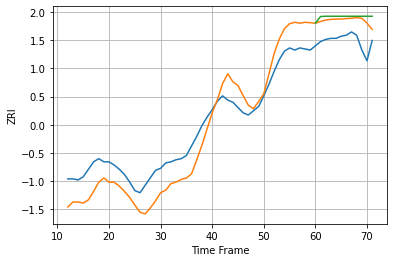

85719 20.092298082000447 20.339870382753457 23.82389149103997


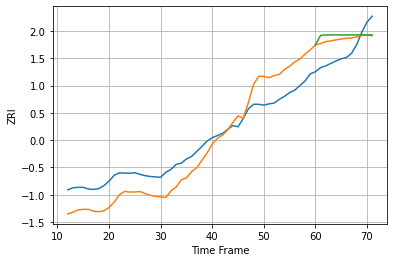

86314 49.49506806188667 46.13395470863272 54.68113004172093


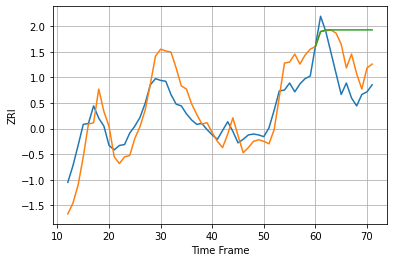

87111 23.81130615443985 31.320345204532366 57.87393625238782


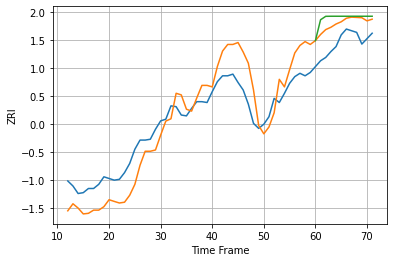

89030 27.360878490436146 24.816673577167084 32.38221471995662


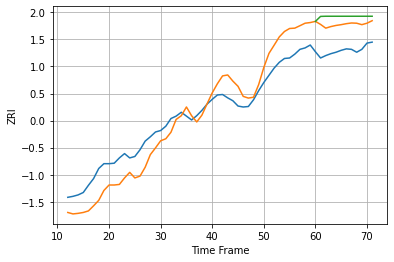

89052 40.0336945266798 55.560726828486274 71.08998449697378


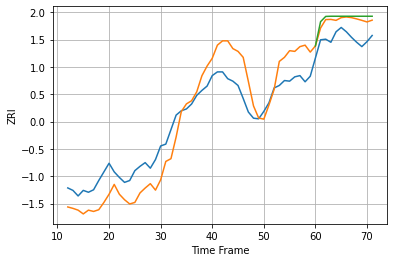

89101 38.55748210533682 29.16500421785152 34.18650110225767


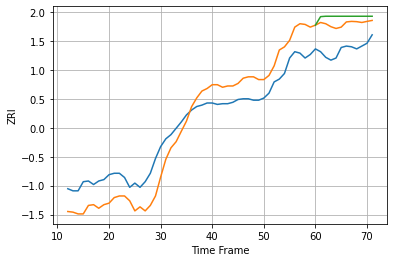

89108 31.793544679957012 37.123849963300806 46.80417334287273


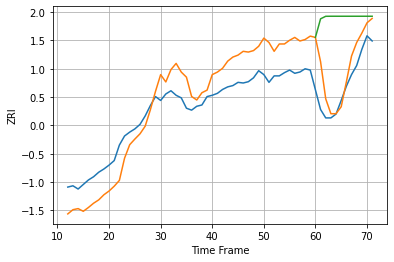

89117 38.96117908732722 38.10070801780607 110.38182421183461


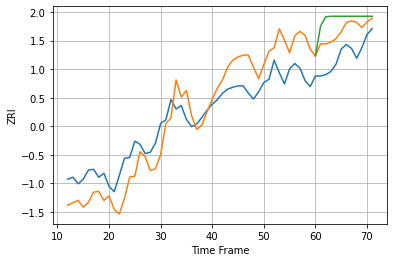

89119 38.83616232012302 37.762872611077576 58.526535763592335


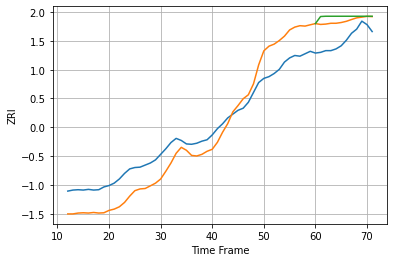

89502 62.049106269629696 60.49696289824361 73.58455283732087


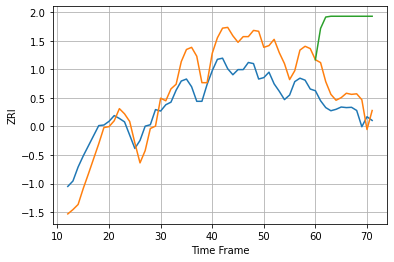

90001 93.45653825943802 72.66874941050253 317.8399499398252


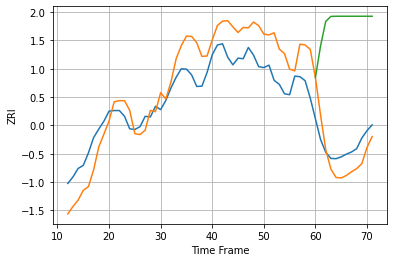

90002 89.01877837015219 70.47036195197623 404.6428667072585


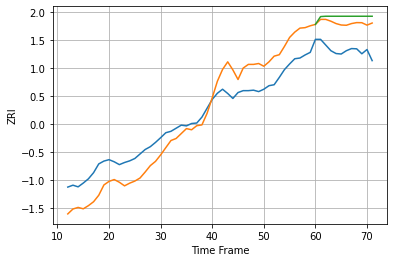

90003 92.14451686018081 114.72077016957246 141.12903087627637


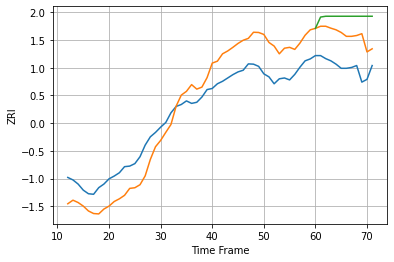

90004 88.66402430018691 116.6029973150804 179.55748606376062


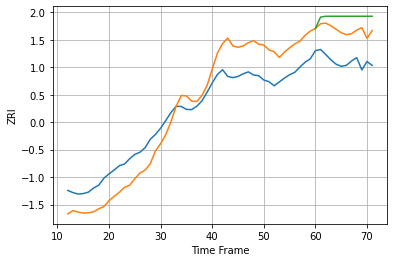

90006 99.52623925534567 129.43345124496236 182.6831127884869


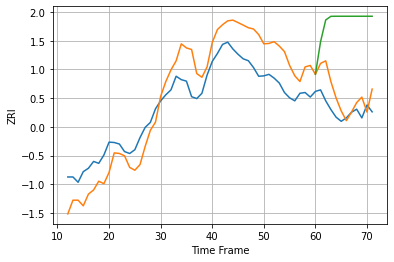

90007 70.66325465610512 53.40805647049938 234.46780959764544


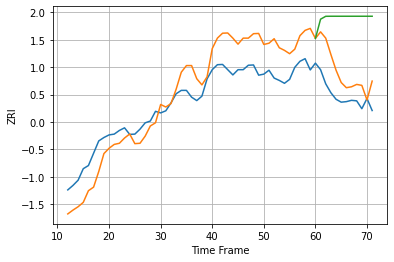

90011 94.24471525272124 103.90835637921965 298.9625308770222


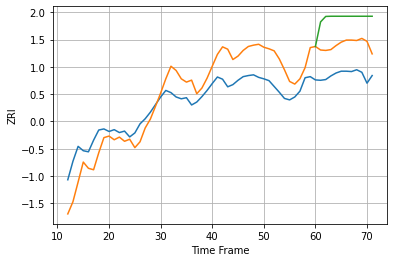

90012 62.5825507011533 84.71698861035175 155.7723504648899


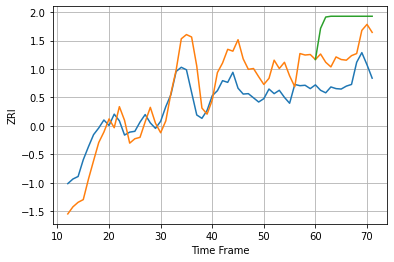

90015 60.017144695623685 72.25787351409556 146.21745998498588


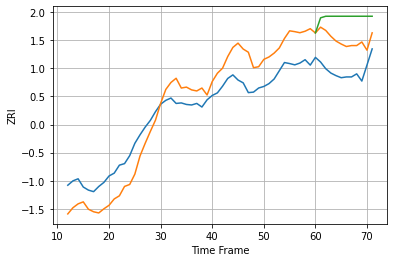

90016 94.36463233121289 121.26516369578002 207.45989382637725


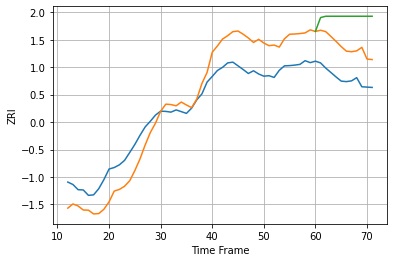

90018 98.45585444549104 131.88188749789995 245.82999466677947


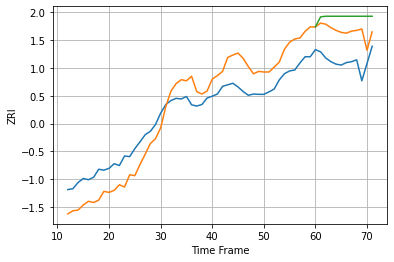

90019 73.96066823034147 100.82887780414818 143.98761350165594


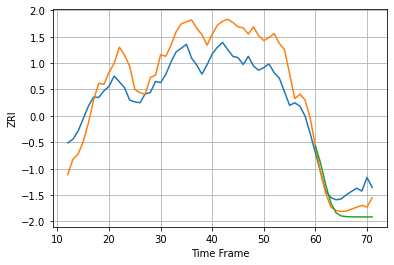

90022 97.59617298447903 55.63256818747759 83.15823798002863


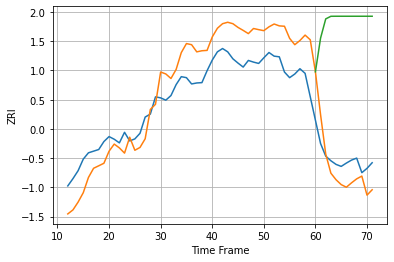

90023 84.40522992653318 72.36711753771131 417.3909168662601


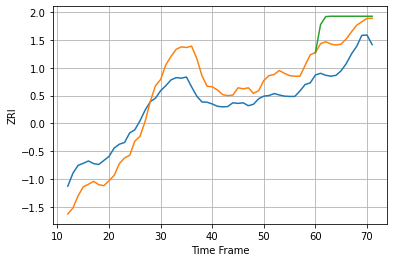

90024 74.66843797248816 88.3427732471637 149.32399034538153


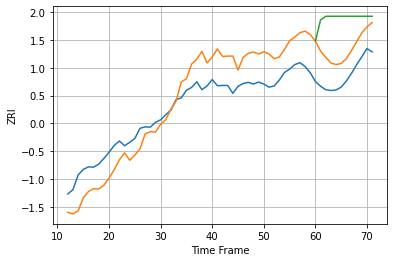

90025 87.89254326988853 98.8729104720091 207.76260438069193


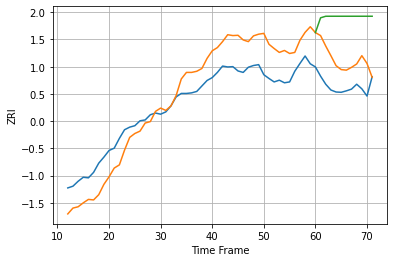

90026 84.51168856854189 100.96105832516564 239.1912561783204


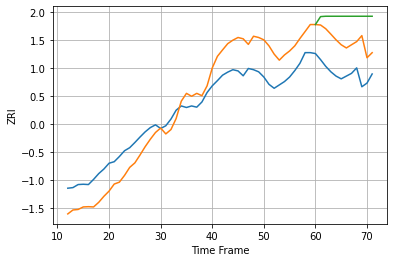

90027 78.0256051509162 109.51534230078036 184.8825877394203


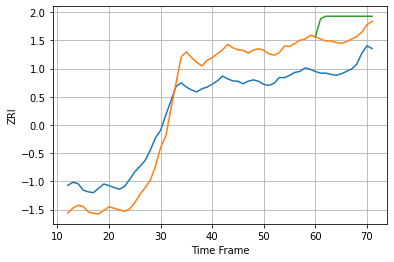

90028 113.47196661416983 124.14317503982275 204.5946772469783


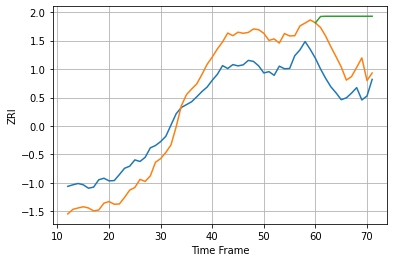

90029 97.52055708978659 119.76551735892033 271.64720529017774


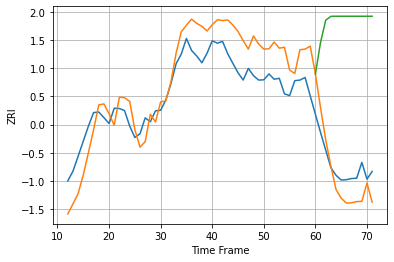

90031 91.13449392446847 82.55528469907364 495.5504131425432


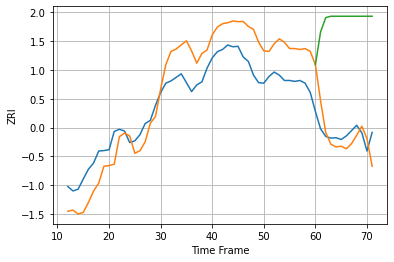

90032 62.58297868116864 45.7129580055953 256.21795239680284


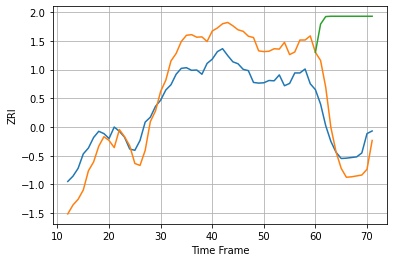

90033 84.52957385151304 78.88687951062268 373.2250141895134


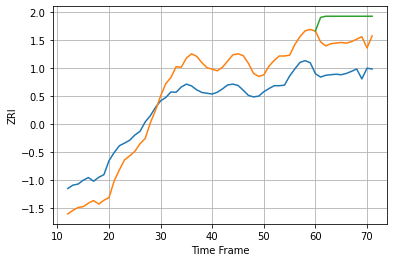

90034 93.81338241312937 125.46411920186672 214.36472133371254


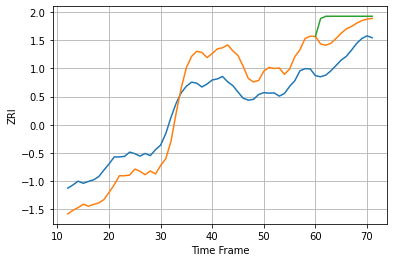

90035 92.85672064643303 98.36009472545824 153.72578494027775


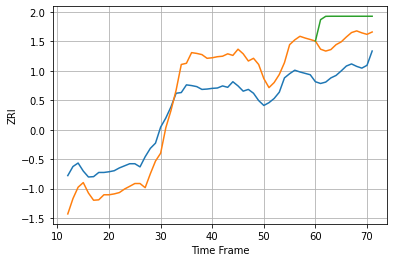

90036 77.33770422064451 90.77585056627737 152.37443461398288


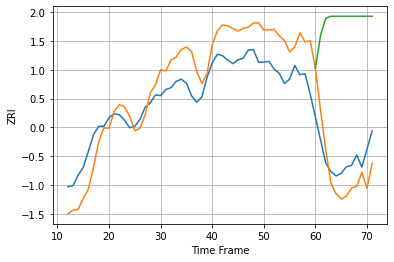

90037 87.74408969993468 88.91153003815755 434.12427378053445


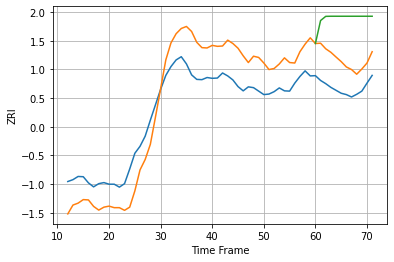

90038 107.22392212190142 110.12139748452063 260.5901887792716


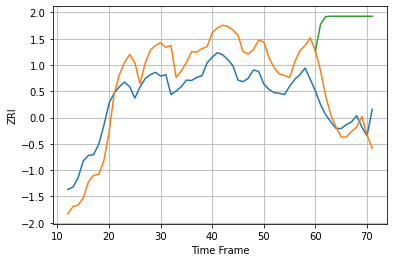

90039 69.93625901157095 53.43162631133144 258.41488791555514


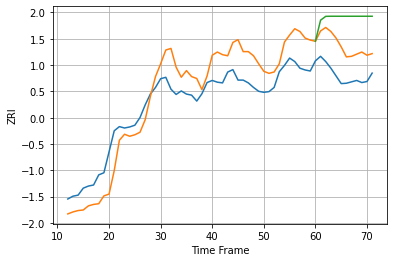

90041 68.78237527305144 84.02452673876951 163.73017350633052


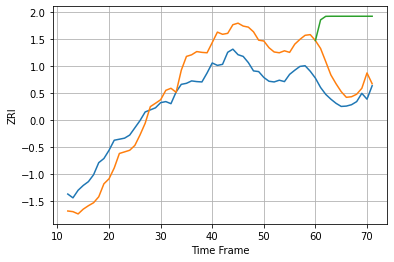

90042 72.5901462139902 65.39546807966364 229.9421675488263


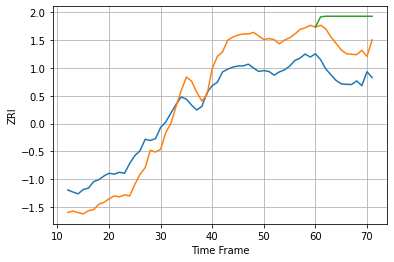

90043 108.71315314228006 143.1835740370972 259.80801926140595


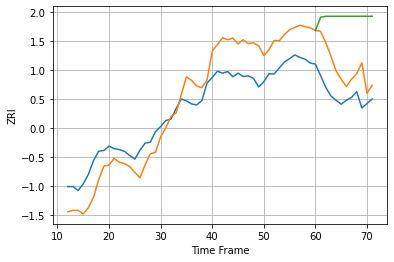

90044 82.2653688827922 99.73570887141254 252.86661856463593


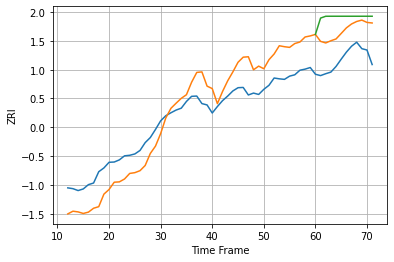

90045 87.18371638453687 112.0604924428135 162.84880495190347


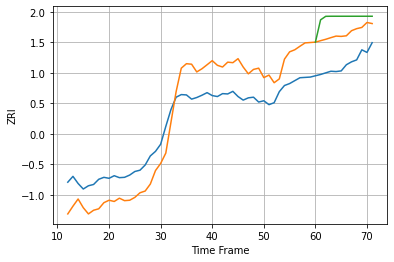

90046 83.56008823033325 95.51389365568158 143.0668058020441


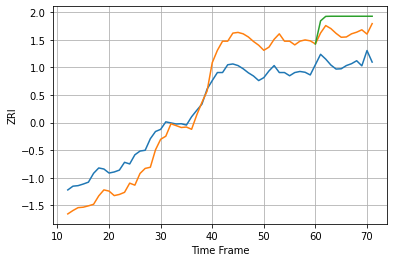

90047 93.28082337888378 113.88177035257443 165.8131072250433


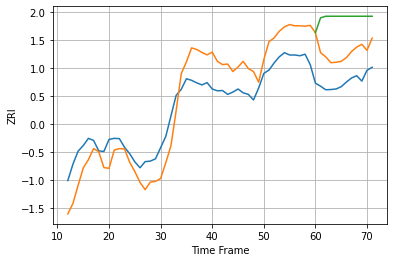

90048 99.00659527778444 121.26753205261886 251.564465017336


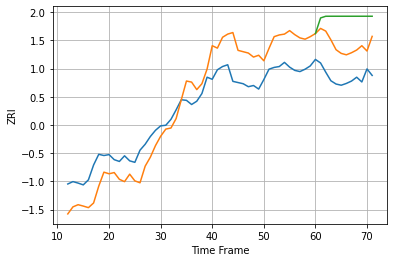

90061 86.50165371243884 110.6962263374492 200.32192875126864


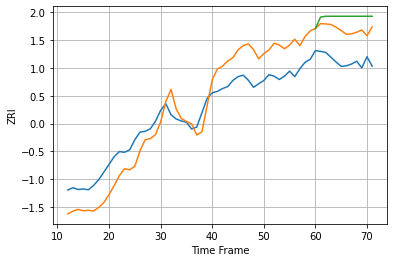

90062 92.56225472249024 123.97325060199377 172.35831113869585


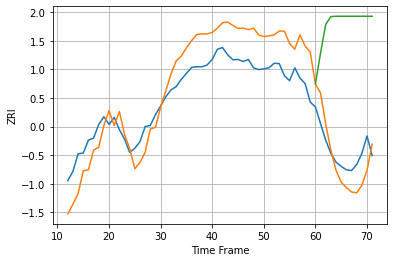

90063 79.57632485095296 63.72612856110982 372.56326652829995


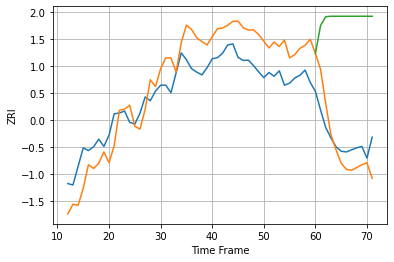

90065 79.06204439355406 70.13674401947019 352.29328305712306


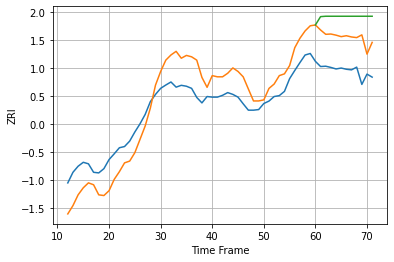

90066 74.89976048621402 112.95579579529664 176.57271184809935


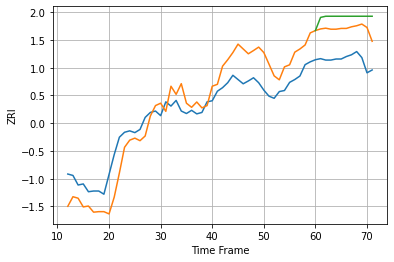

90068 63.75309919765339 88.48264914660417 121.53895760147462


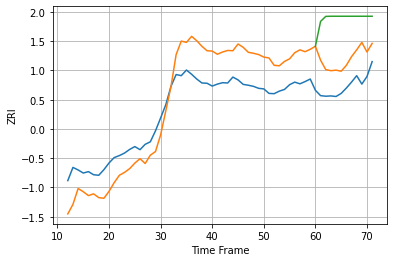

90069 98.74859021692892 103.76271873115628 242.48946576491858


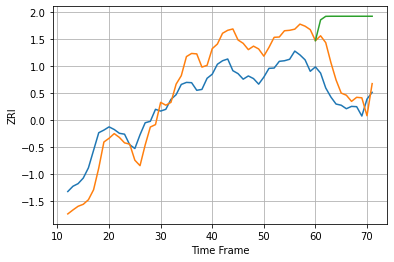

90220 85.9503472118058 82.71100702482137 276.00763575380347


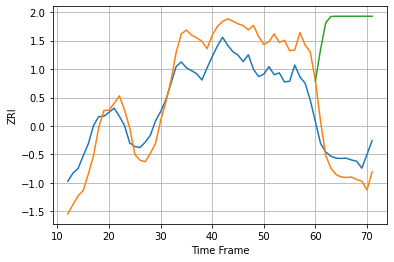

90221 89.01396471240058 73.58286561767045 420.001454502536


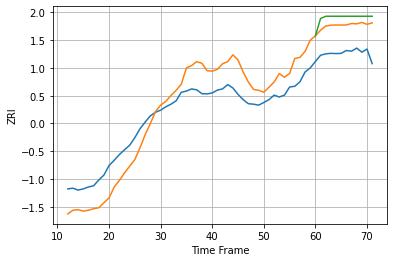

90232 91.24306895885809 118.74642001322945 151.05881556064952


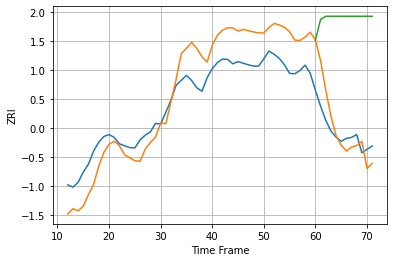

90247 84.15985940607844 75.40171946109892 363.69582686656287


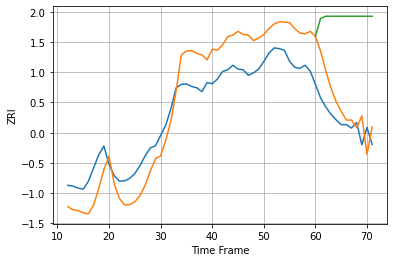

90250 82.70991142319721 78.86039769098504 299.60934728355244


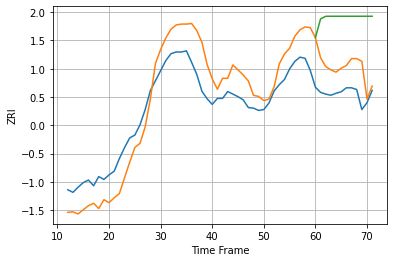

90254 89.14763330908417 104.39146616012394 264.90563711095416


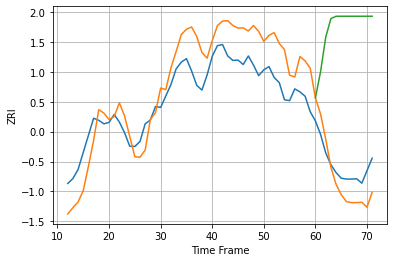

90255 97.81991114165297 76.36518054986253 482.6263344696217


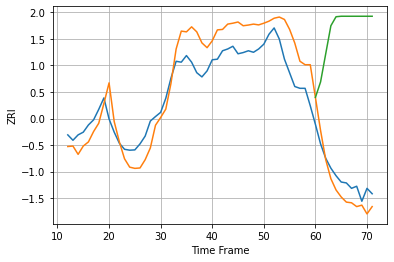

90260 80.43782590394392 54.95964242025785 499.5708043269493


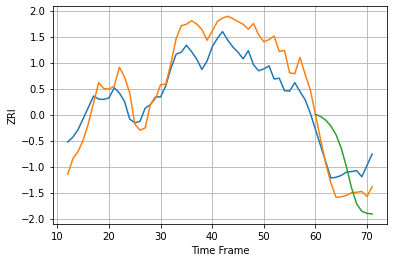

90262 92.70015649462833 77.94272494411253 143.96747522175593


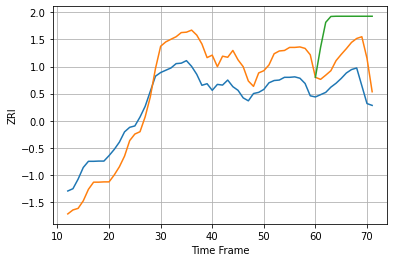

90266 116.29237891544224 120.71205506810684 282.8763189940217


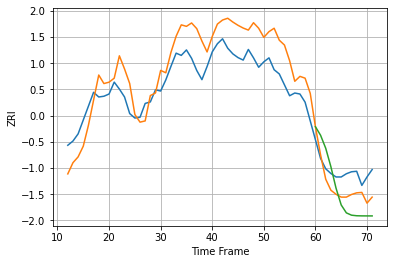

90270 102.44515658194148 76.39995579586353 128.06305948769545


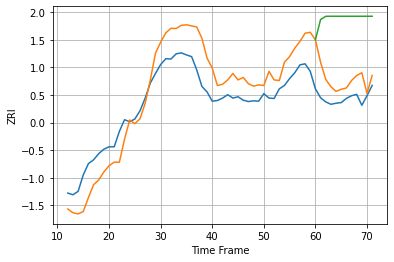

90277 70.8515747884987 68.73195587554936 233.38614506022577


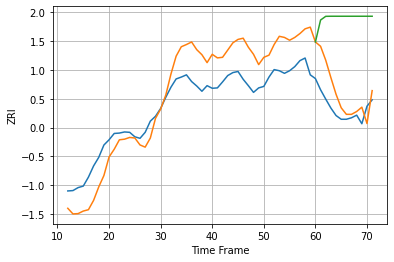

90278 72.49158122944914 64.50802213967269 243.6276256085599


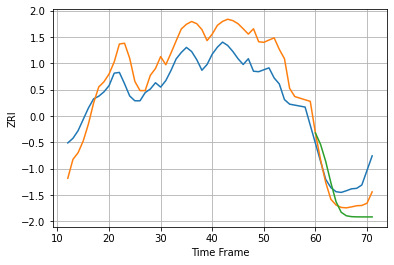

90280 105.99276292301225 79.36976337078382 122.14805418418412


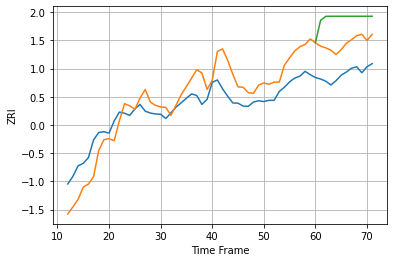

90291 87.43263694818278 129.64680399102267 233.42795517181918


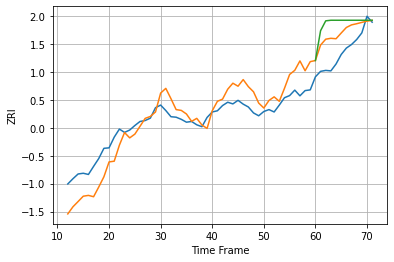

90292 73.7556488476286 88.37083111795208 132.77270790151087


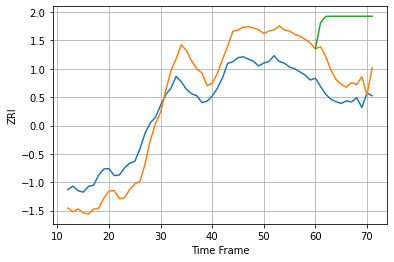

90301 95.1276753880271 90.59503919837123 275.3959194739517


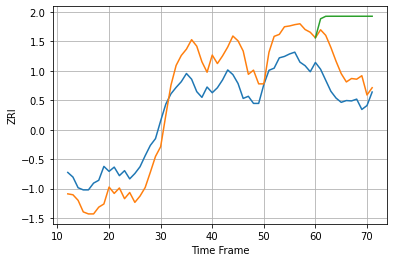

90302 78.95315143200405 84.30877078440523 215.43510336274016


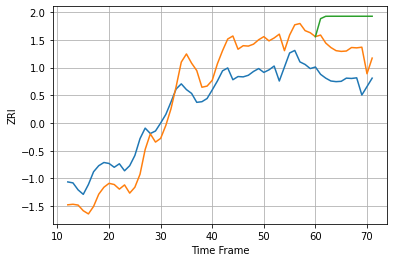

90303 81.7252087395043 99.79199062203043 196.62667536721136


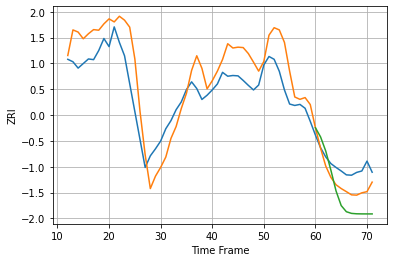

90304 75.62189457746759 49.34769380947296 93.0469423394212


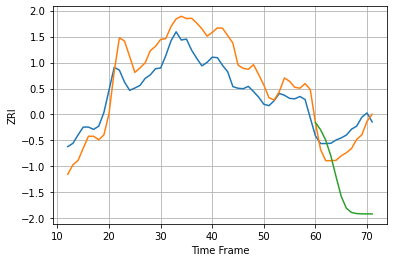

90404 100.98317883841594 65.46735486635944 283.0676000244918


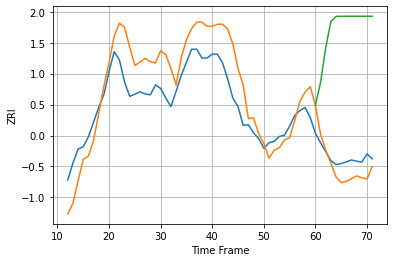

90405 94.89270581927033 54.66969549291854 429.62899303766426


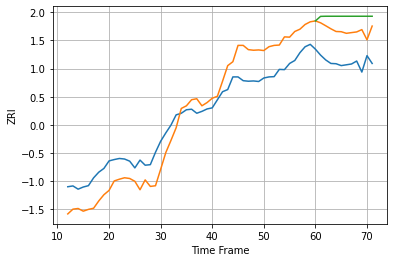

90501 86.61756016718489 120.74455372470136 168.4390583812034


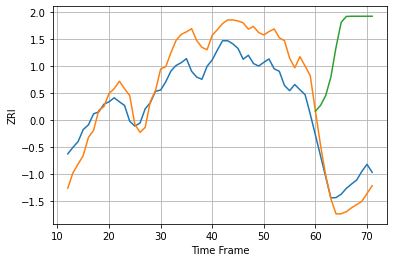

90640 83.18062977761599 66.12555771916452 450.75812617203945


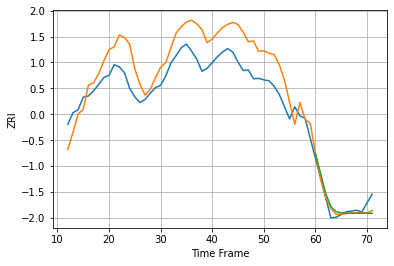

90723 111.70782836170524 29.288774280476957 35.14139256607164


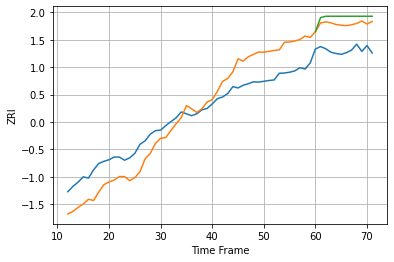

90731 82.23889664681016 98.66038595427443 123.5171413859365


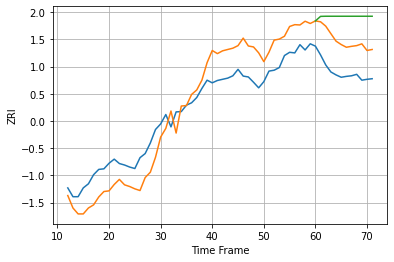

90744 81.07928727939736 109.80843123244689 189.87614871018638


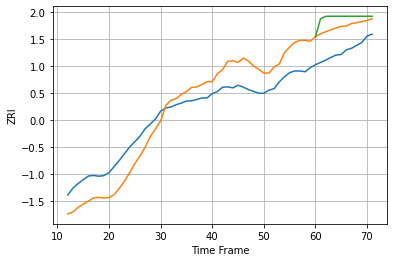

90802 110.59021622432441 127.45685211753562 174.22164682770858


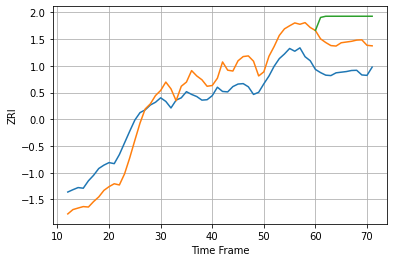

90803 102.97636602309323 145.76374349239234 259.92434674375687


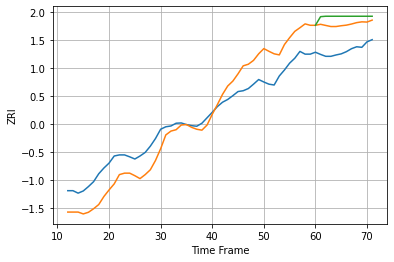

90804 77.57191717223449 96.81993479192768 123.64161480704716


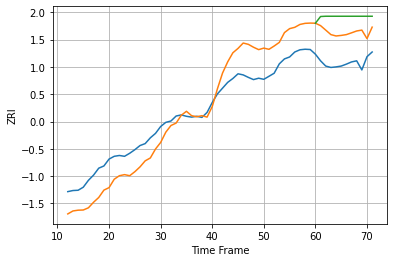

90805 78.81075891322145 112.71670212394504 166.19868896533853


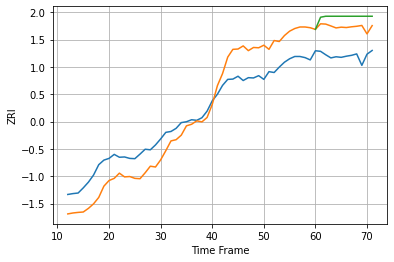

90806 79.7093674254397 100.53537345900304 134.28851747987878


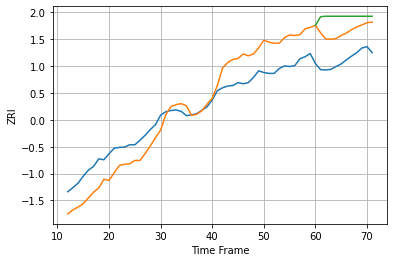

90807 75.01757031889554 102.26198781461753 151.60716606692765


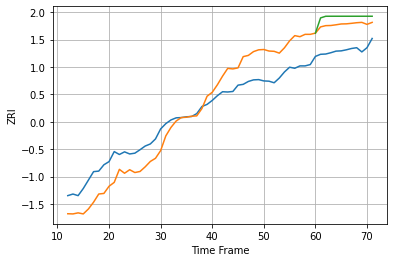

90813 83.95537250786946 97.08003827120517 124.58186499228763


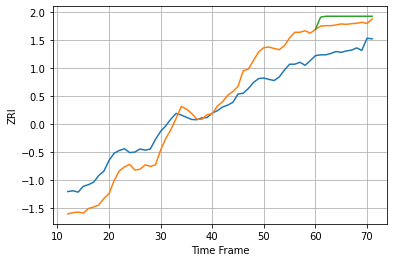

90814 76.85826457242646 93.78027382515704 119.2953450165345


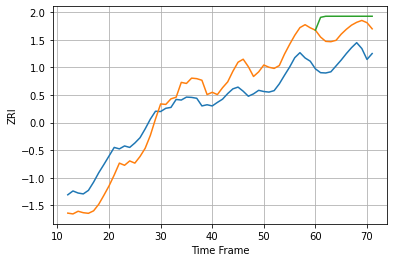

90815 71.63306946704839 99.36403925621013 147.5819019385839


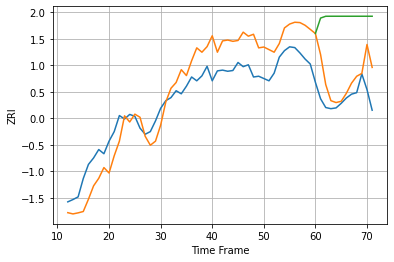

91016 64.2138400246199 72.67691889091714 210.9980702097137


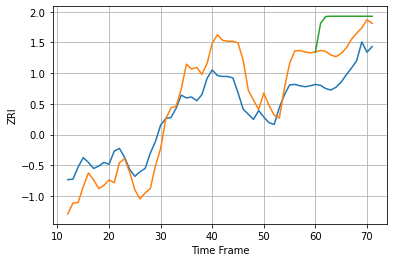

91101 55.838355591073196 64.00493995944501 117.05972267402684


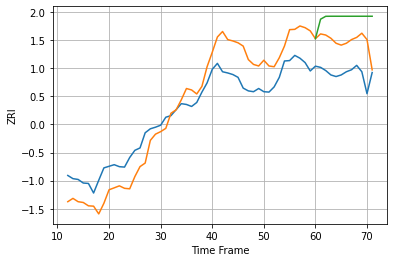

91104 61.976534859895104 83.80521449374062 139.50766805807407


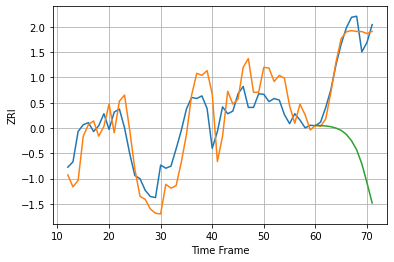

91105 46.89655844486482 18.74015840118262 192.2432337374722


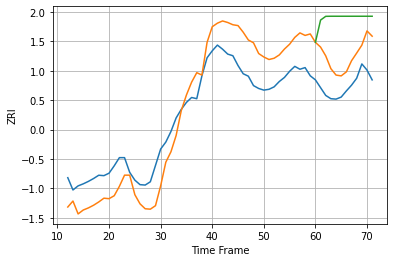

91106 67.35479099400081 77.06756898444391 166.66816529114666


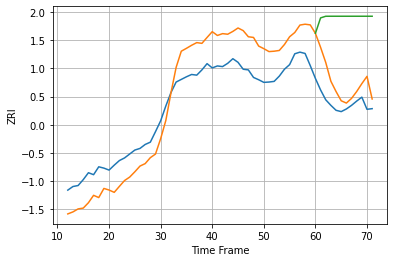

91107 83.11206328347843 77.75495901992265 260.0164509623867


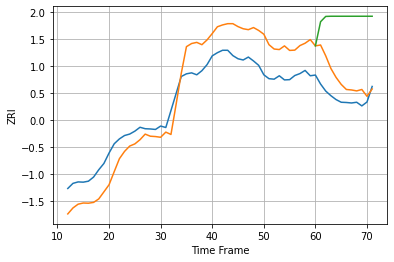

91205 105.12513370522275 91.63924388460606 322.51082717495586


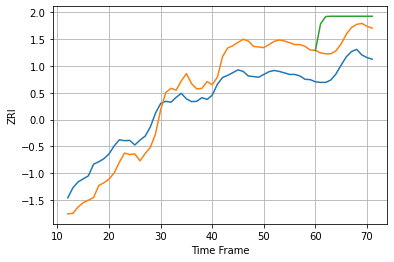

91355 77.62159230148043 89.76014005135748 156.93701635463086


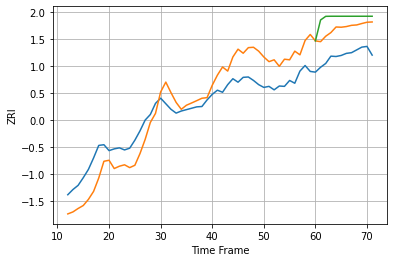

91367 63.47372838688091 78.51785404350665 109.61885892926259


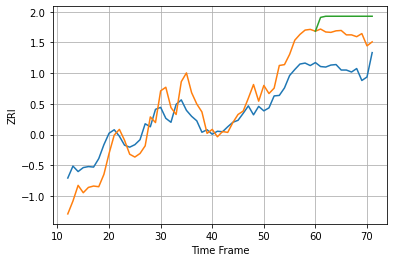

91505 41.092487205219506 69.38810423270516 102.909258080757


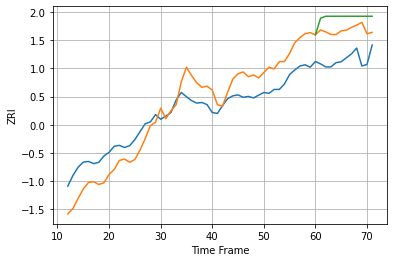

91601 69.02461644886658 99.06339393539821 140.61850319976594


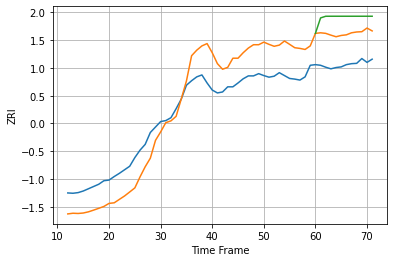

91730 79.56654323249987 97.41370164793275 145.7318317941725


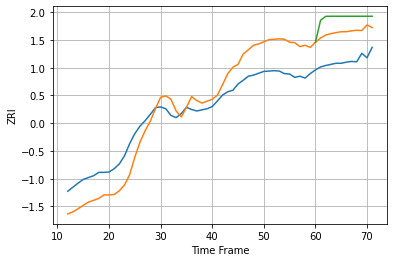

91764 61.70057531446957 79.08215625866201 116.81298786681138


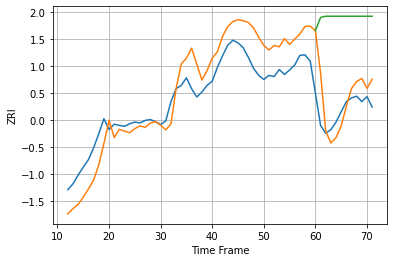

91766 57.082033627169075 65.62703226631089 223.84943562036966


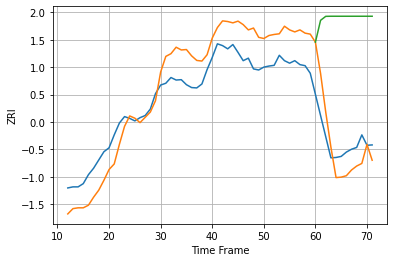

91776 73.32303013006528 73.95812472238511 347.7557895711472


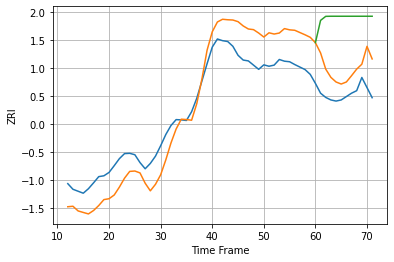

91801 89.87412519899839 100.53481502043815 268.2381379513509


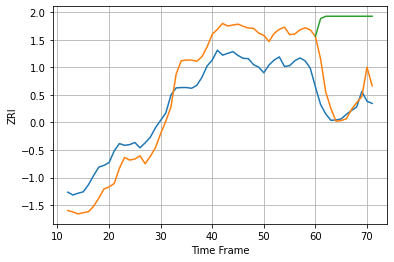

91803 73.35409924730955 67.45685358840899 257.52361380724903


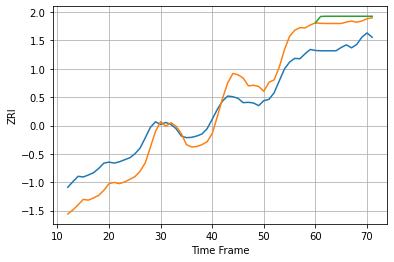

91913 59.38057817182919 72.6287424487212 88.55775273148389


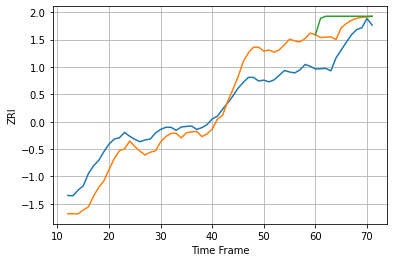

92008 68.61470776585907 74.27360651034553 112.40595562042091


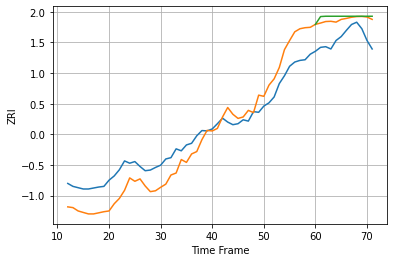

92101 62.13104239047343 63.49123237196739 72.87185474661263


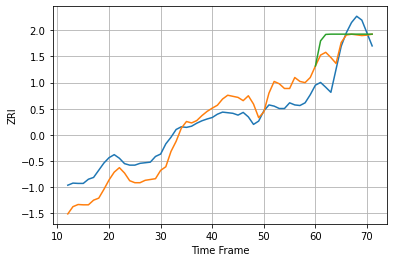

92103 59.92745587534875 64.35499803254585 98.48918677667845


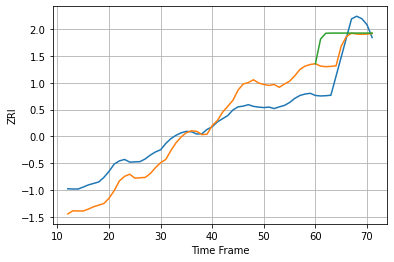

92104 78.42057788574185 81.46637015610776 147.13048527606367


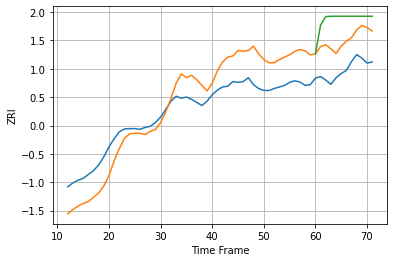

92108 61.741326145283324 77.36448447724116 132.88235356984967


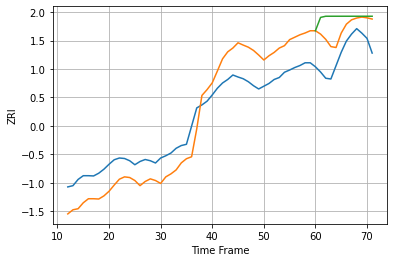

92117 101.46607117079563 106.4010594177665 159.7758610229721


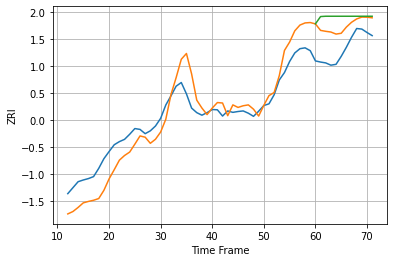

92122 64.24720670609953 87.01509031544988 121.43267477926968


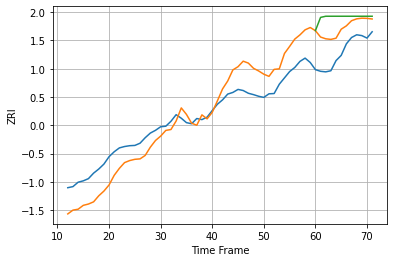

92123 74.54863355866975 92.08397597172113 135.62809803503234


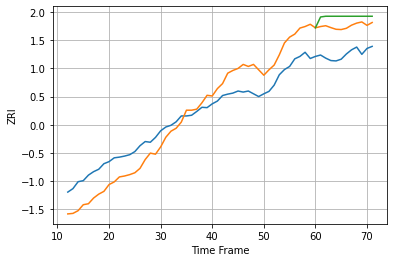

92126 60.850186848748635 81.89192634730543 107.84681087749509


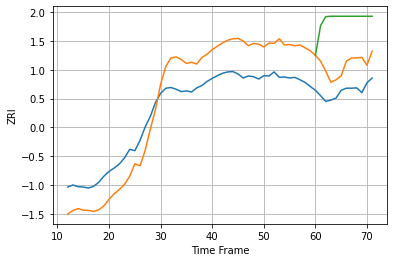

92128 84.07759079085095 80.6913606857869 211.80843844856744


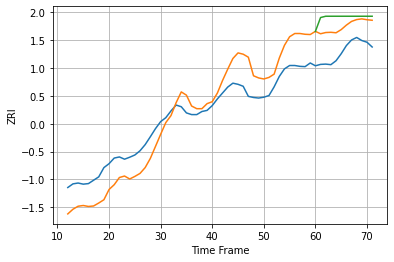

92130 78.12506388435825 93.80418970686229 128.08993823729918


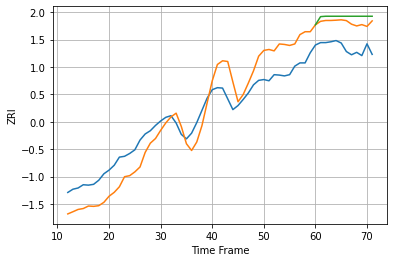

92410 53.9633394228066 62.50649677532585 76.32333764189349


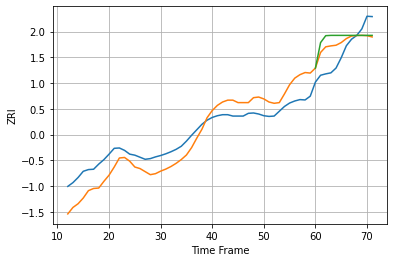

92507 48.94289091639065 52.00783152056838 68.24130175996595


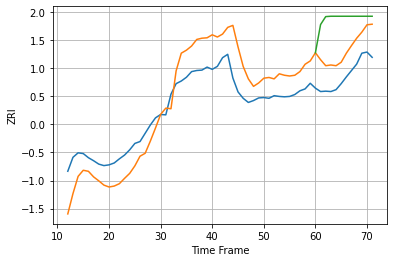

92602 65.58913541962524 71.99469089333985 153.83798450677293


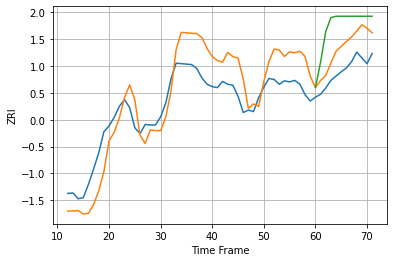

92603 52.7952149153787 48.7730974203001 97.8220472589718


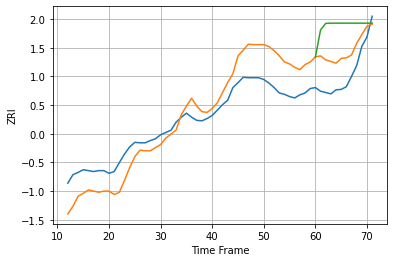

92612 50.85813661166276 57.83325351705664 116.44289167876553


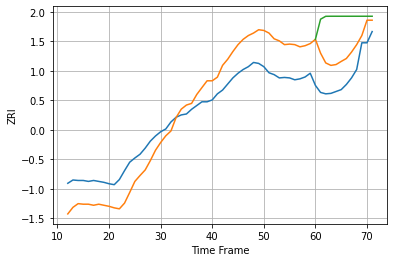

92618 54.45089162162055 60.34035742424746 128.4823021235097


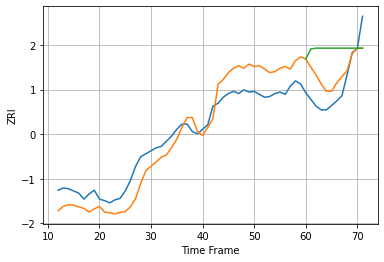

92620 25.43911725827758 30.323154696752752 61.165625107810776


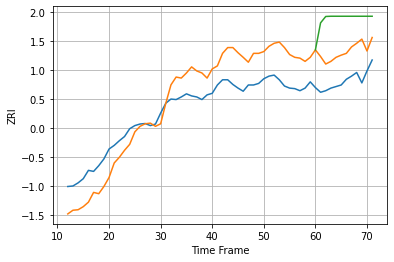

92626 48.624074294363595 58.34762436536095 119.76845715759667


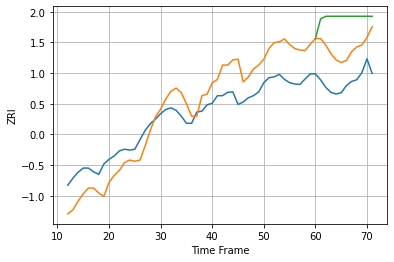

92627 58.33990240403411 82.53762863347994 152.84640866274864


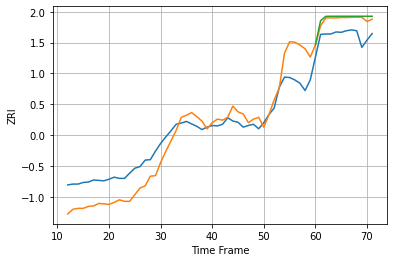

92647 49.84300142095962 39.73097533477256 44.40311153762057


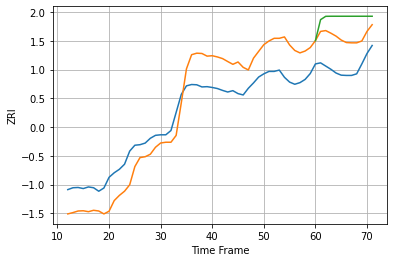

92648 98.95503816239805 114.43602657600078 184.56254185633273


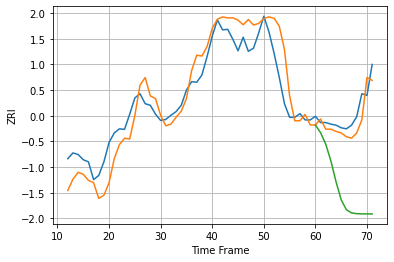

92651 40.51083954800843 24.481232832672465 160.5686480689462


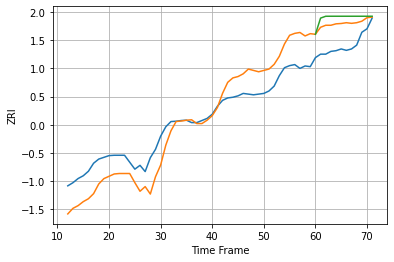

92656 62.11153380063459 66.07804748696415 84.1515598366266


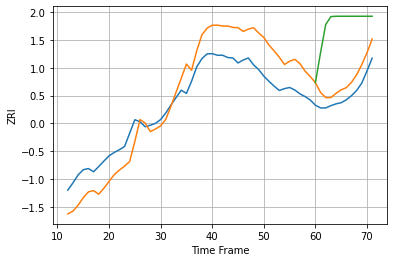

92660 112.06375931845999 67.32901453219763 315.4862929273499


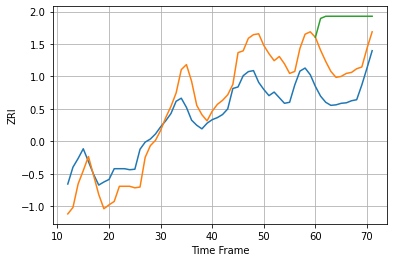

92663 51.9031236296087 63.192663677877334 148.8472839882326


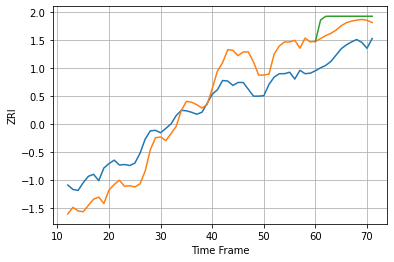

92672 48.531781672370734 50.898483316559044 70.93185935336382


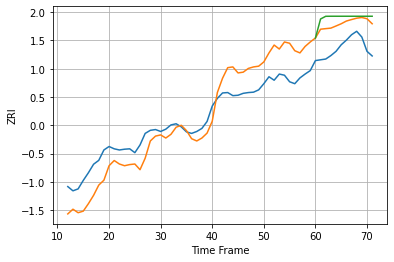

92673 56.51206638538833 64.69738360879028 81.98337968035963


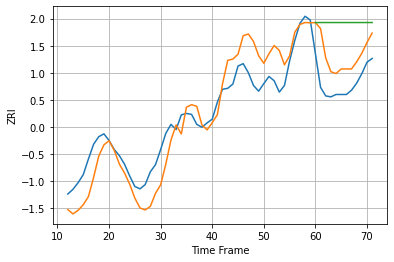

92677 47.08046241348699 62.649528259298265 129.62819808102694


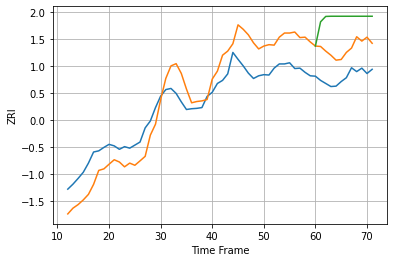

92691 64.01980375138646 76.20736194731188 153.02968228109864


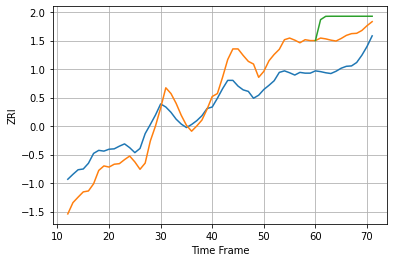

92692 59.9495566304687 76.6821001368355 121.79740581787607


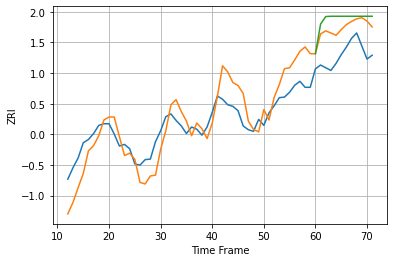

92707 37.81286755660849 51.54908684316542 69.48855474321505


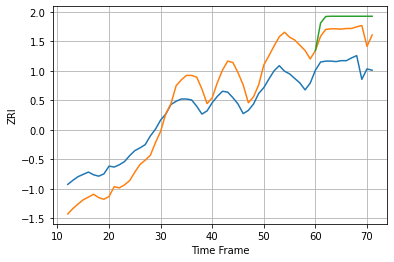

92780 53.271652647090484 70.82827990708167 99.71899124010994


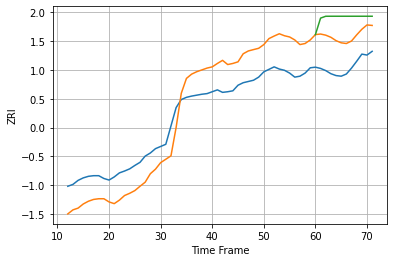

92782 85.12605584180953 100.48958477445986 158.60377564180794


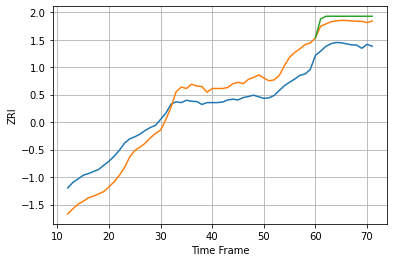

92805 73.26445445952717 87.17420984303446 106.33680801815991


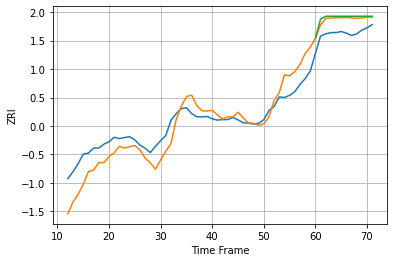

92806 59.788757964179254 52.86340386942247 59.544857207230926


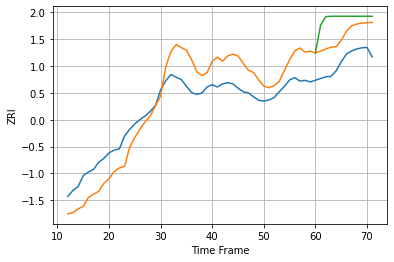

92832 59.45107411810209 67.36255659580651 112.29147606246029


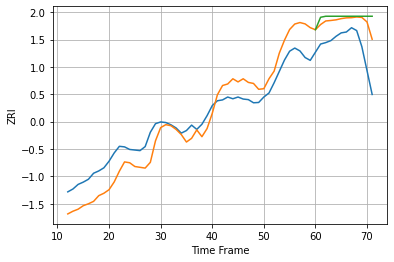

93001 67.41545399547508 95.52215535842268 118.23059067132327


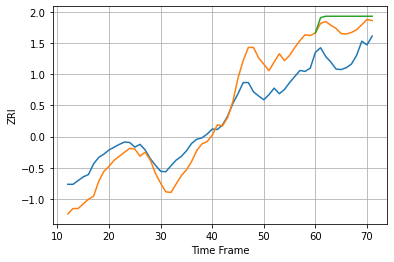

93010 48.927435068161465 63.494212836648146 85.47745562567528


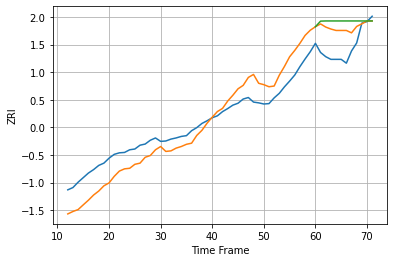

93030 47.24494978072032 59.82919553390284 76.24361371237708


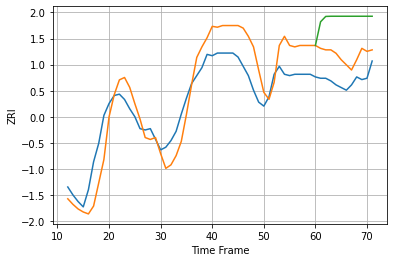

93304 18.477139440810664 19.96061321764673 46.535874158543756


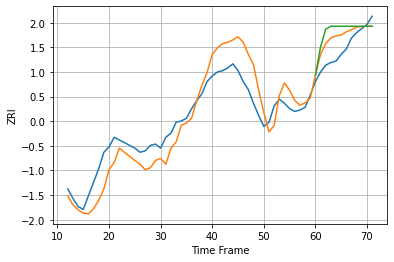

93305 14.521094329762086 11.508649590465843 16.563378326320016


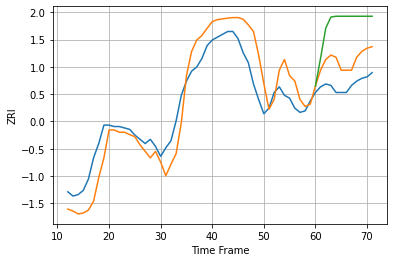

93307 16.14250245643471 17.14205372408108 43.53741801373278


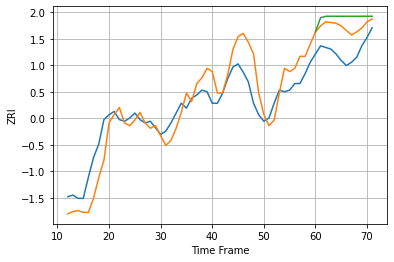

93308 12.426185431500167 15.389496283209612 21.12708384252813


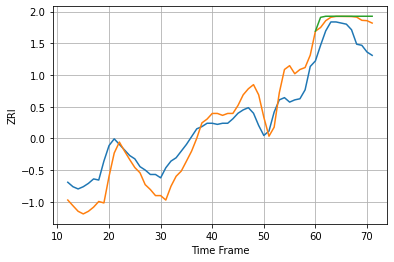

93309 17.84304107872217 18.366183900055912 21.177083365454823


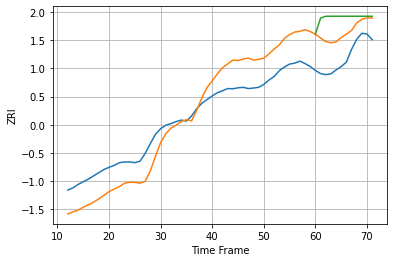

93906 95.94822794100371 109.4389008592186 172.7796164380313


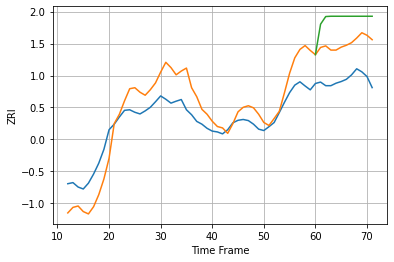

94010 81.40225759501655 131.14247125417015 219.95475993355674


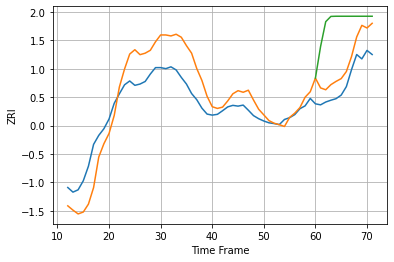

94025 88.1629607445715 81.24787060115985 236.5922097421005


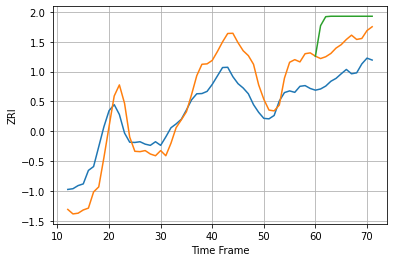

94040 102.96359181815585 128.5151687063787 229.42144204858678


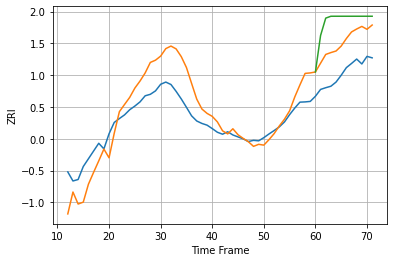

94061 88.21501733360842 125.318483092223 215.41249321189196


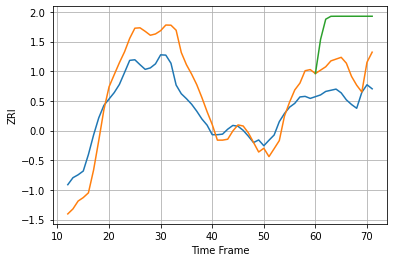

94066 83.60796486566475 95.82959260087091 252.36233088694124


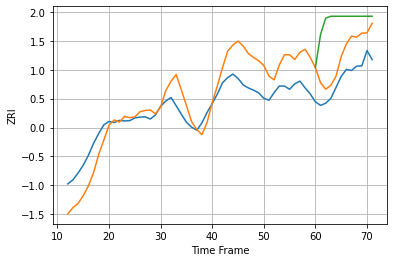

94085 84.37449434149528 94.40335694714096 218.71309233517692


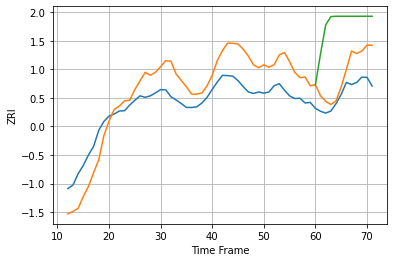

94086 83.10187612367488 78.54020133829019 237.8560422481366


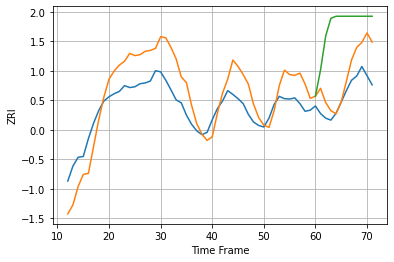

94087 66.05460174190468 61.34494722465885 184.48516578479013


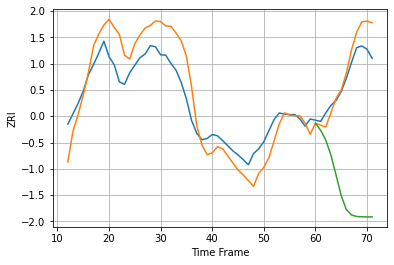

94103 59.321277131499336 41.94240157371232 299.55116666333845


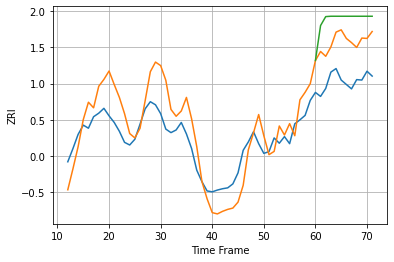

94105 55.197497025715684 89.28307736889275 139.7605063929759


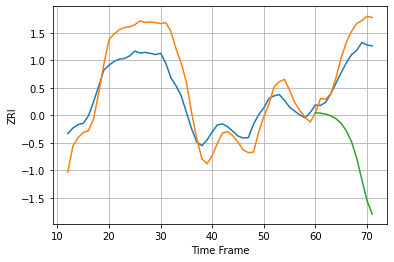

94107 70.17478369294318 58.29610244745749 285.21561501359065


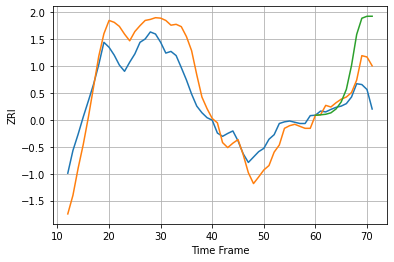

94109 57.119091005756324 43.87420445672432 103.47880048723944


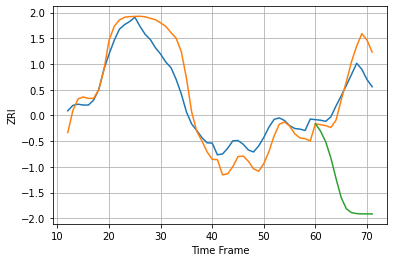

94110 65.62608103759493 70.56338233249177 363.73964203666714


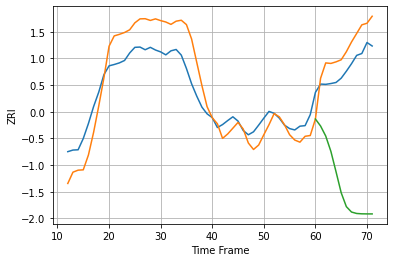

94115 85.43772823752532 81.84511971084058 456.0181106698564


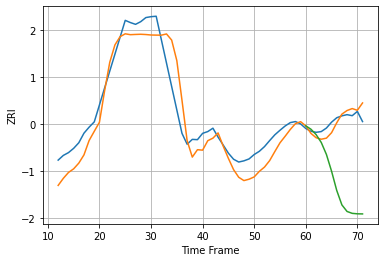

94158 124.5802367484329 53.93982254020916 457.6233090086973


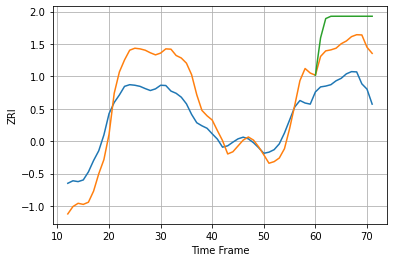

94401 91.21896483754807 132.82885411552655 225.424087015652


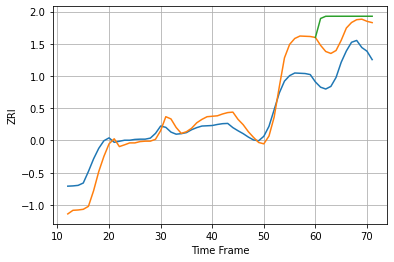

94403 65.9625670639798 119.65371664280394 188.27735588840238


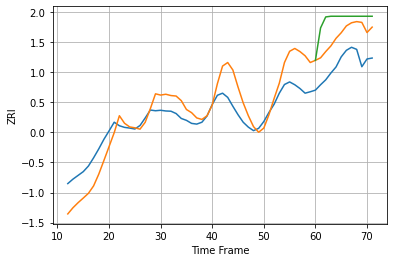

94404 86.05335565531695 124.07596357510567 194.30931850227194


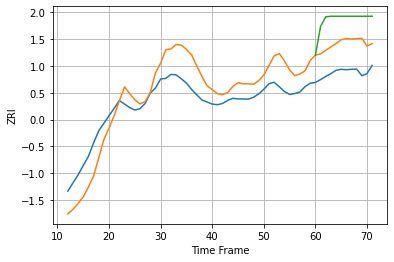

94501 103.57798645978265 139.0836238199535 257.99369893945266


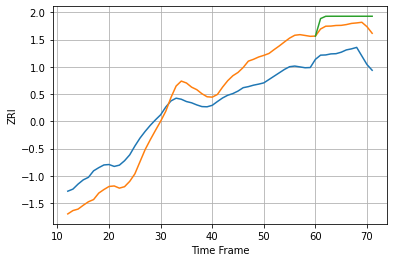

94509 104.99466786759857 138.66191604441204 181.8456339936915


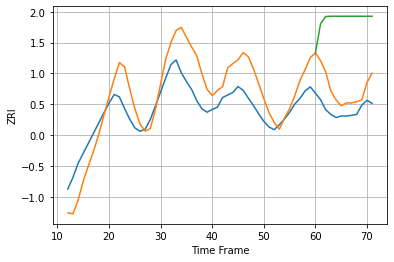

94530 82.18665367818204 78.57928845270162 288.4130710362384


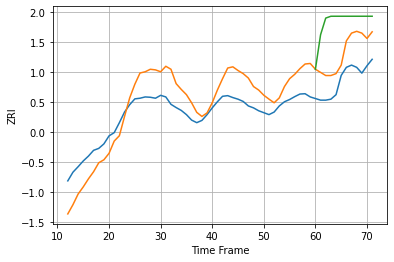

94538 68.34897234041412 87.32805330942948 187.31701970631764


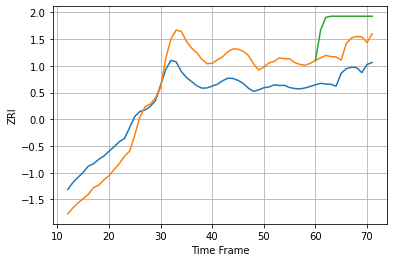

94541 128.94751300527093 140.9640474504837 284.2433927757656


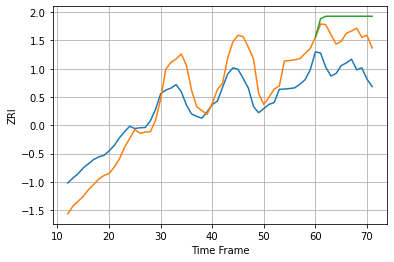

94549 94.08042515954685 137.54931299713783 208.57244613173225


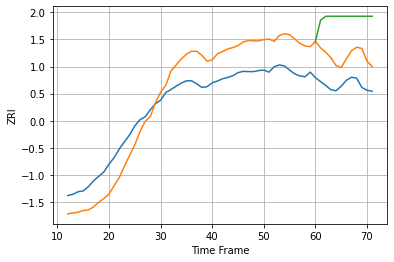

94565 100.49364998854695 116.68285467453921 261.36849558405453


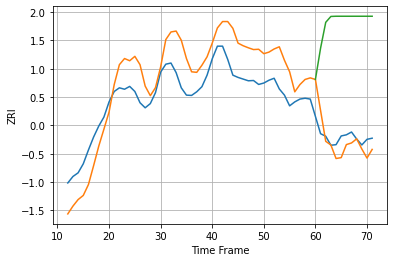

94568 100.57965264879148 58.911907621154846 407.9372235966644


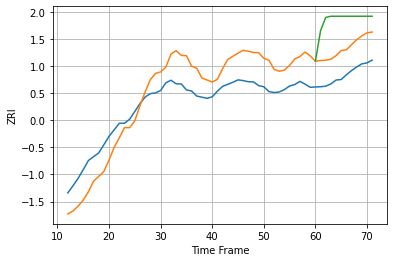

94603 127.99992433744833 143.65170138399142 296.32185312294865


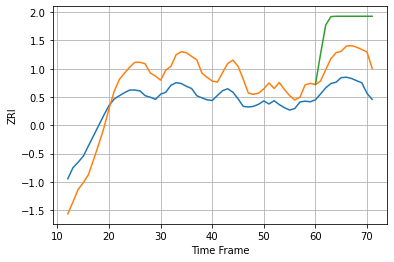

94608 105.80823397451354 131.7842082913481 288.93161001848716


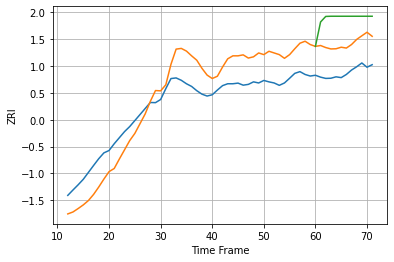

94621 153.45761948122006 185.35371225713615 342.84767927157066


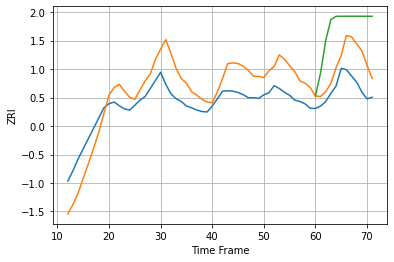

94703 106.22151191190007 119.80161827442139 287.95080654164303


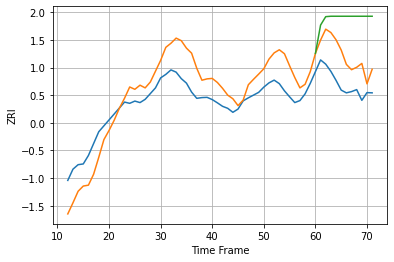

94801 90.79727084900806 118.54531729193582 264.1477655856325


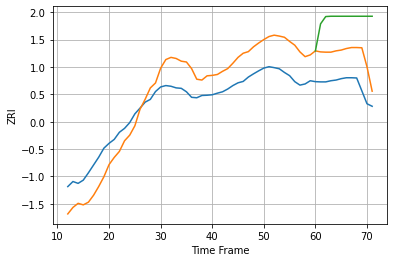

94806 107.89510825999955 133.70821512489056 289.9565965543397


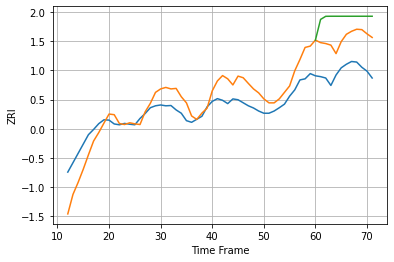

94901 63.50946147229542 122.94634418624888 196.69957666267106


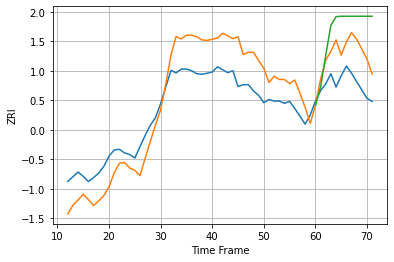

94903 99.92064742987301 114.71364678215436 213.72797767622927


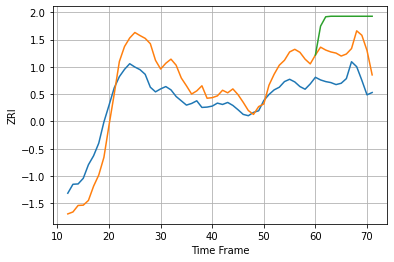

95008 70.8173095490988 93.9097522756917 186.42383204408918


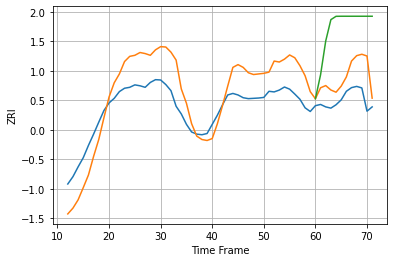

95014 85.89459562357762 82.08345746750106 242.32261722123985


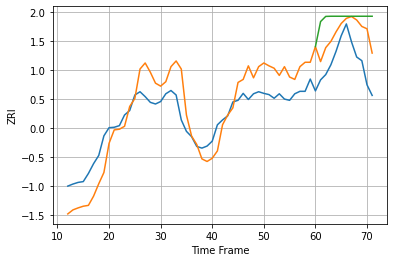

95050 56.697742048402155 78.19514059511818 118.32437847170971


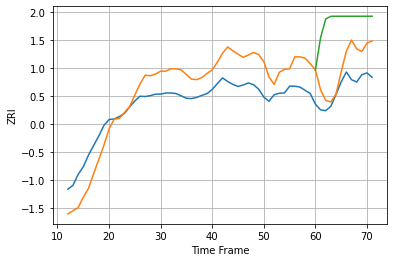

95051 81.9054206388381 85.52572641826765 229.53207369652714


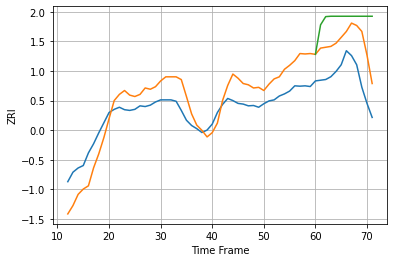

95112 59.68431467242293 100.03192600509246 173.91090391939835


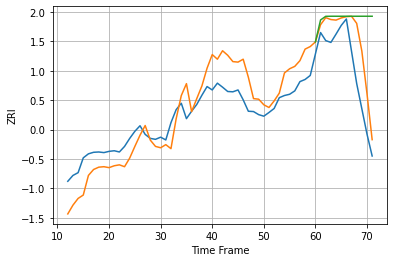

95116 71.37065701544262 100.63926603562038 208.5696688457748


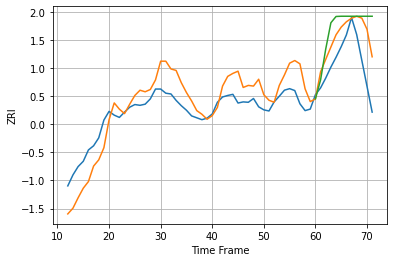

95117 53.15150111711325 78.28690284460215 113.7249806007752


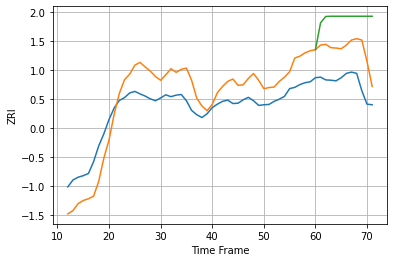

95123 74.21758581542097 109.11953592255252 208.73540313397865


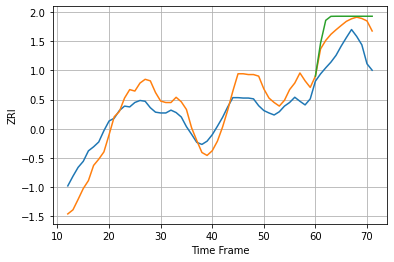

95128 45.60647463786149 64.37267991994226 87.09028520256582


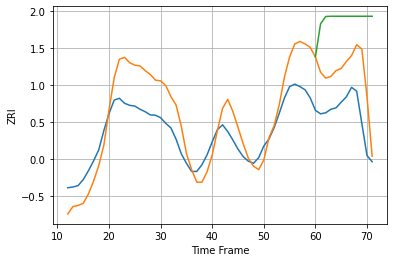

95134 78.54230948641592 123.34520857646984 275.598475609807


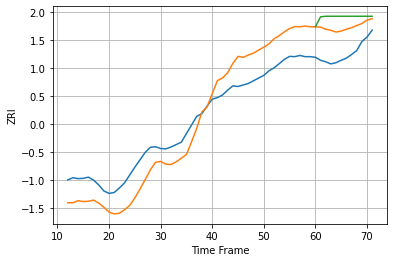

95207 77.21018153752756 90.61708467560982 124.70476533110339


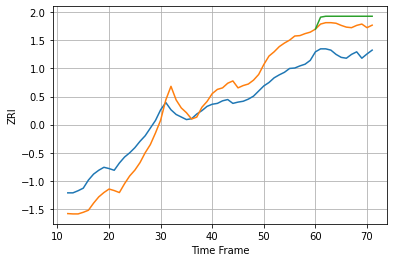

95608 49.31332160610118 65.77656467300191 84.88315579734517


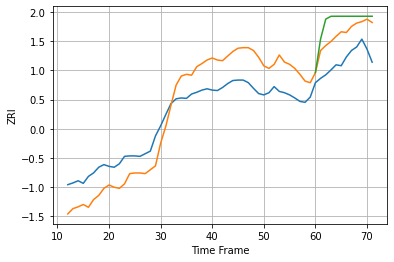

95678 59.46882747785757 62.93434277527225 93.51965492836776


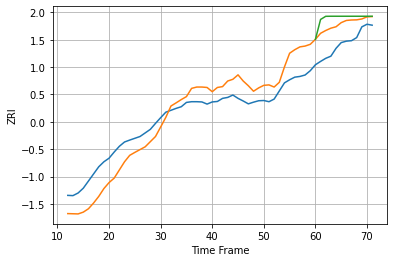

95816 78.34079830586387 87.51100754960375 117.55205891967312


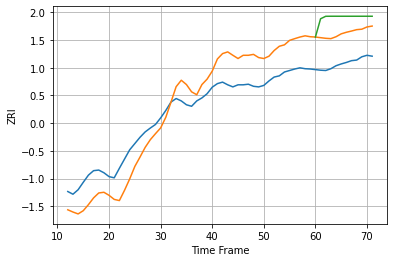

95826 80.96893338747951 101.52429962469765 152.84603450847507


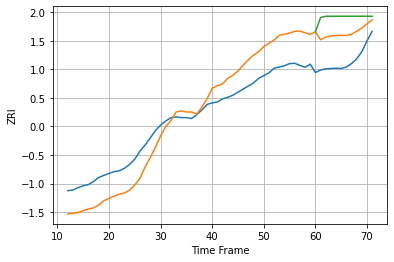

95831 74.84750010807225 96.07824954335942 145.96414394316238


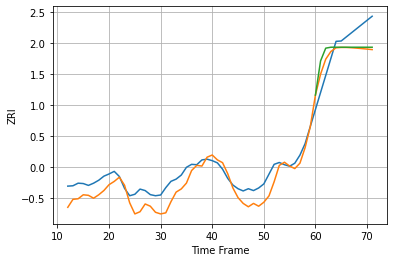

95928 34.98120765618395 50.50673773179927 55.339422876587584


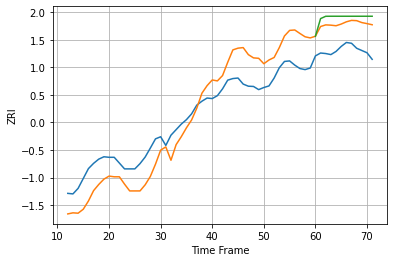

96150 89.87321668806845 100.92282878766261 126.84476762831568


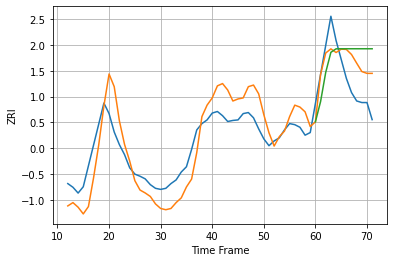

96826 42.33927610828579 53.114951203271104 76.83866665832171


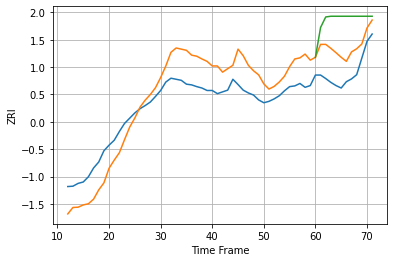

97030 67.43896148410134 73.6088606317461 154.10029213823137


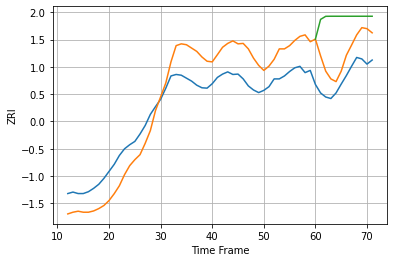

97035 70.09126014520079 74.5586120717075 165.5592317938121


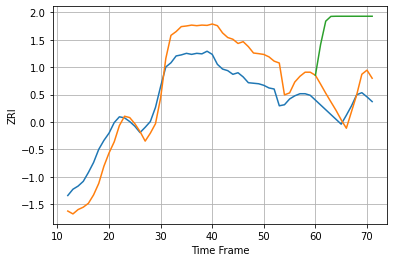

97062 48.429315193520694 32.00030882961384 162.85500762008107


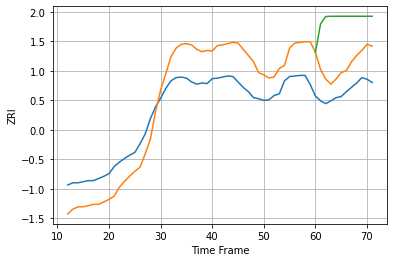

97070 52.19527105793482 52.84911681439084 133.6458033061241


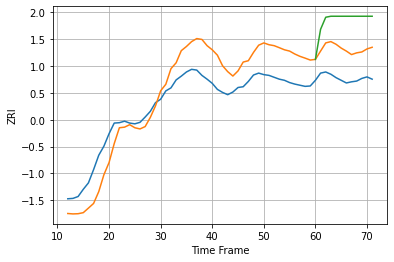

97124 64.31669619311174 76.39908675352666 154.50255638566907


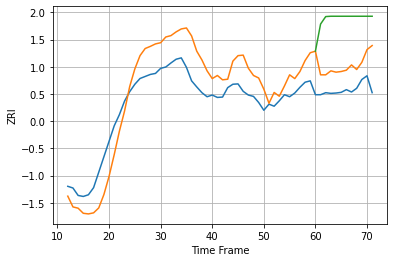

97209 72.96752369145405 79.44717265636328 209.2360621726814


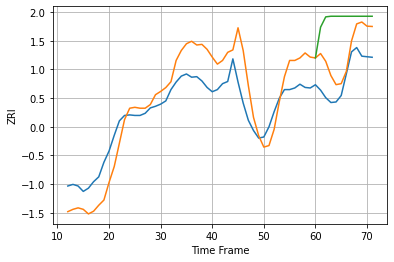

97214 47.90652219790224 48.766655193906786 110.79228744292269


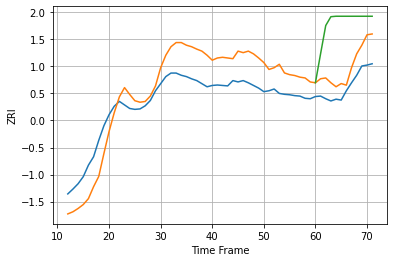

97229 55.40295996227445 44.39056832122909 144.22762956284993


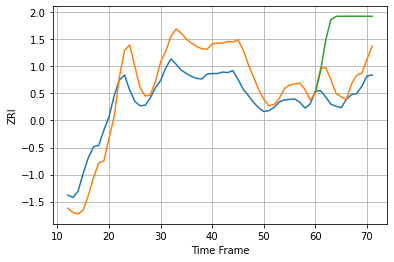

97239 51.82219900809779 37.396061629204986 142.69314107396704


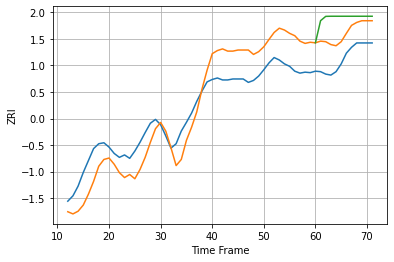

97401 49.596602165093 51.87559413065724 85.33999717517449


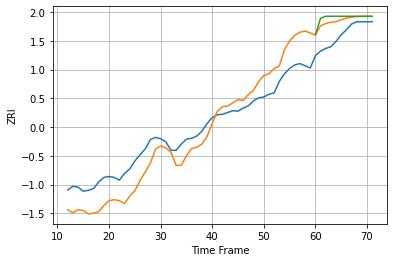

97402 46.60630014619538 36.66353466200633 45.037994378386266


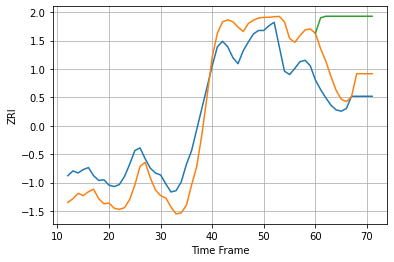

97477 37.31779390088488 39.568715886797456 120.43251094009027


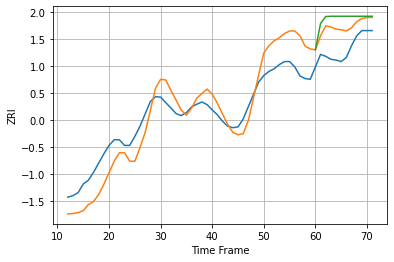

97501 54.44685047486405 60.56061200159665 84.48384206050618


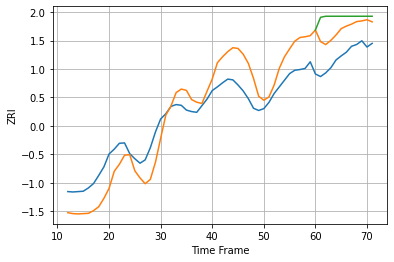

98004 62.27547843561604 75.7691752788704 110.87224091199954


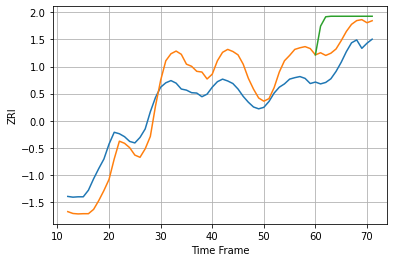

98005 63.84504201136331 64.78767151460538 117.49201399441621


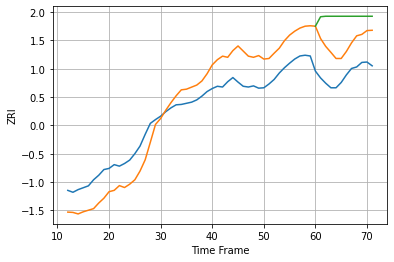

98012 64.01904533843373 86.36128179210056 153.05636540760932


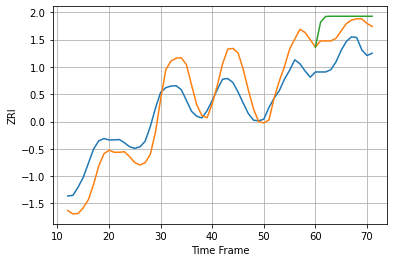

98029 68.84548582961706 78.50435393411048 117.46386649917702


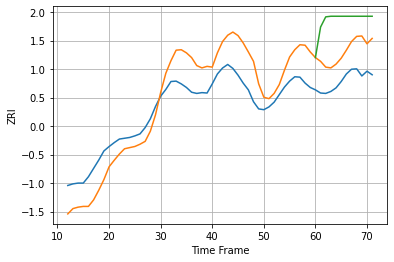

98034 64.56952241992332 74.39415282080422 154.68975402225055


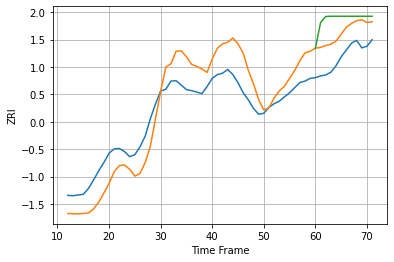

98052 69.7049455167152 72.67805829289465 117.04344363518074


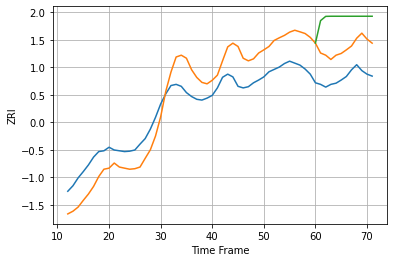

98056 64.12396490531506 78.3481415310398 151.54794622478428


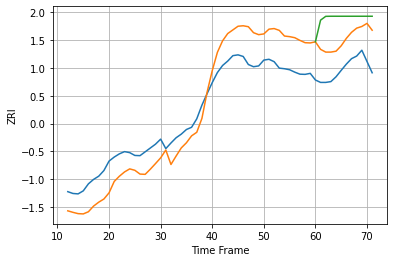

98101 123.5985359477218 154.2842525981085 259.22627933810605


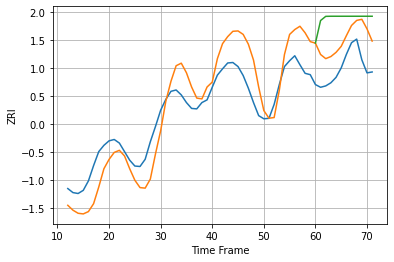

98102 55.46957828216273 66.78183936444387 116.0273923262543


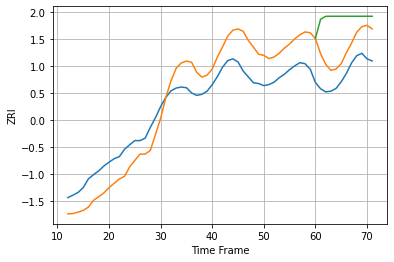

98103 71.27819940380986 80.05397578754634 165.60668473406997


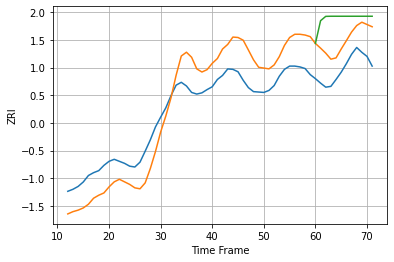

98105 64.52115662204223 72.43487009129967 127.97432588461608


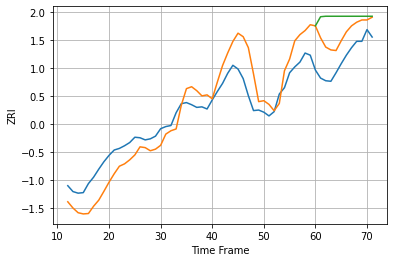

98107 39.750293095664304 51.51798992088901 83.80711402039553


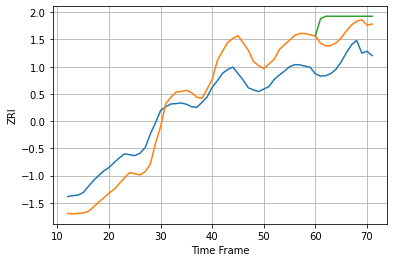

98109 75.83956929944083 90.68000730434031 142.2421377739462


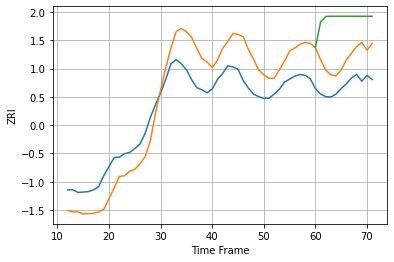

98115 63.78442335898124 68.30849176767427 158.33929890800297


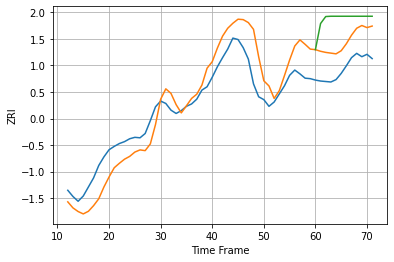

98119 45.377888892939744 57.52526854279298 105.64063294327079


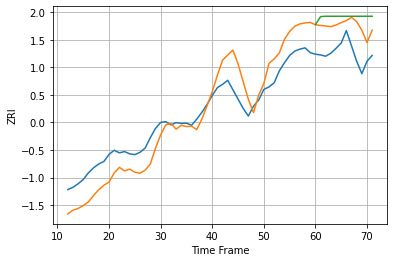

98121 81.87923826587982 111.96099091038194 148.5269748659011


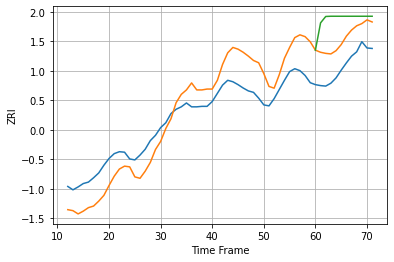

98122 50.35742528901942 58.36135910448156 101.69558301219831


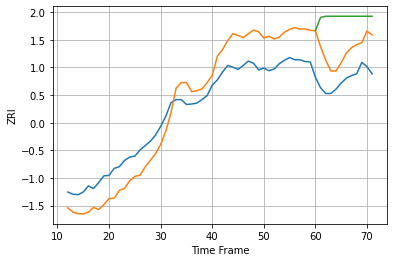

98133 56.250218238132184 71.11372826786702 143.57303686958505


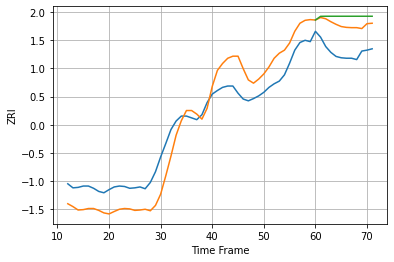

98201 49.668230833752595 61.05440231306678 78.69843334580563


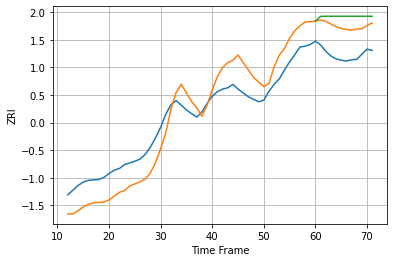

98203 50.670059413752654 67.21093147402276 89.2523695930828


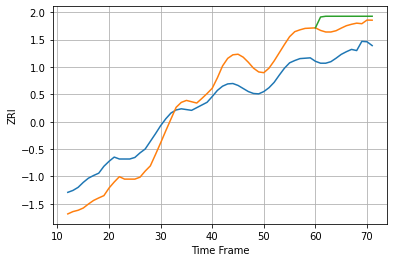

98204 57.29971570062806 71.38206340814814 96.51030317847977


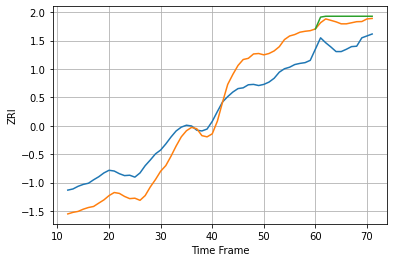

98405 61.08998111414595 59.448199616810975 71.97526927380429


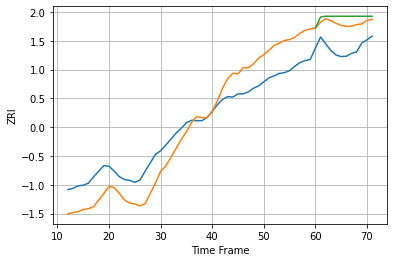

98409 58.120168234799316 62.55456998311206 78.24104077133498


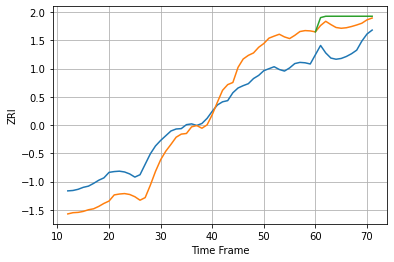

98444 58.96974820980211 64.80291365907432 84.54820463757545


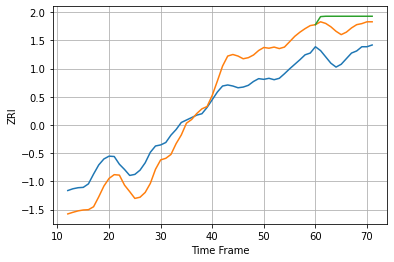

98466 67.32489390061154 80.83372912585378 108.69273905583226


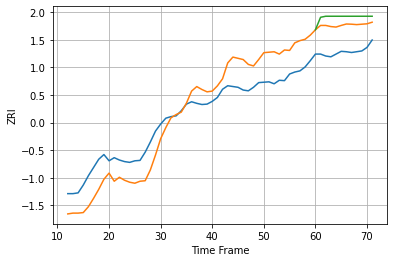

98498 57.971003827953226 68.28618720098078 88.61669049205582


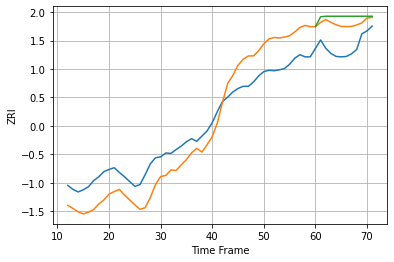

98499 54.83265824561759 56.197111374447076 71.27872049037838


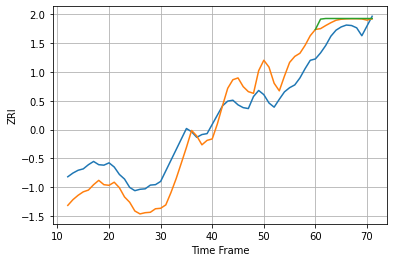

99207 47.19989927137557 32.239057999123524 38.322378048850105


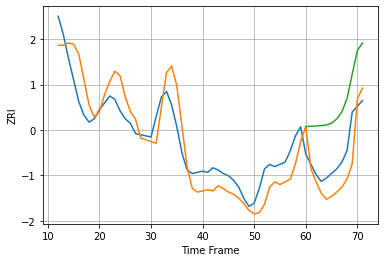

99501 19.15376078299765 20.910330245665534 42.88122262084164


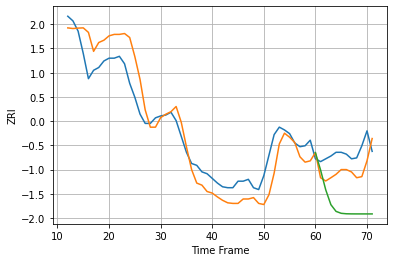

99504 22.41471210659162 21.604904425800644 58.63753971836422


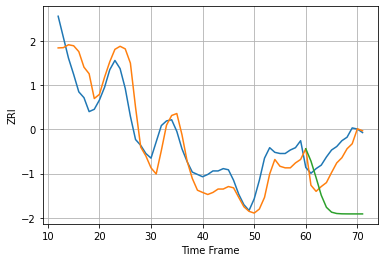

99508 18.340842633508657 14.840156220803074 52.541370822262515


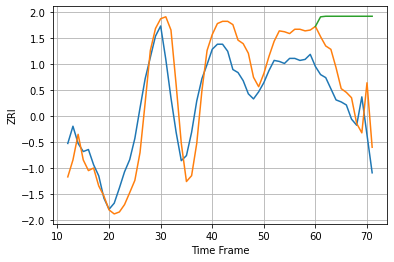

99654 28.17224198268086 31.35702621928789 91.81572662977439


In [9]:
time_train = list(range(SPLIT));
time_test = list(range(SPLIT, len(single_city_series)))

score_dict = {"zip":[], "RMSE_train":[], "RMSE_test":[], "RMSE_pure":[], "forecast":[]};

for zip_num in multi_data["zip"].unique():
    test = multi_data[multi_data["zip"] == zip_num];
    city_mean = cities_stats[zip_num]["mean"];
    city_std = cities_stats[zip_num]["std"];
    
    single_city_series = (np.array(test["zri"]) - city_mean)/city_std;
    
    forecast = []
    results = []
    for time in range(len(single_city_series) - WINDOW_SIZE):
        forecast.append(model.predict(single_city_series[time:time + WINDOW_SIZE, np.newaxis, np.newaxis]))

    #print(forecast)

    # forecast = forecast[SPLIT - WINDOW_SIZE:]
    # print(np.array(forecast).shape)
    results = np.array(forecast)[:, -1, 0]
    actual = single_city_series[WINDOW_SIZE:]
    time_actual = range(WINDOW_SIZE, len(single_city_series));

    pure_forecast = list(single_city_series[SPLIT - WINDOW_SIZE: SPLIT]);
    for time in range(SPLIT, len(single_city_series)):
        # print(model.predict(pure_forecast[-WINDOW_SIZE:][np.newaxis]))
        pure_forecast.append(np.array(model.predict(np.array(pure_forecast[-WINDOW_SIZE:])[..., np.newaxis, np.newaxis]))[-1,0])
    pure_forecast = np.array(pure_forecast[WINDOW_SIZE:]);
    
    M_train = mean_squared_error(actual[:-TEST_LENGTH], results[:-TEST_LENGTH])**0.5 * city_std;
    M_test = mean_squared_error(actual[-TEST_LENGTH:], results[-TEST_LENGTH:])**0.5 * city_std;
    M_pure = mean_squared_error(actual[-TEST_LENGTH:], pure_forecast[-TEST_LENGTH:])**0.5 * city_std;
    forecast = list(np.array(pure_forecast[-TEST_LENGTH:]) * city_std + city_mean);
    
    plot_series(time_actual, actual);
    plot_series(time_actual, results);
    plot_series(time_test, pure_forecast);
    plt.show();
    
    score_dict["zip"].append(zip_num);
    score_dict["RMSE_train"].append(M_train);
    score_dict["RMSE_test"].append(M_test);
    score_dict["RMSE_pure"].append(M_pure);
    score_dict["forecast"].append(forecast);
    print(zip_num, M_train, M_test, M_pure)


In [11]:
print(sum(score_dict["RMSE_test"])/len(score_dict["RMSE_test"]), sum(score_dict["RMSE_pure"])/len(score_dict["RMSE_pure"]));

46.859102546025376 100.49164458389157


In [ ]:
#score_dict["zip"]

In [ ]:
NN_1_summary = pd.read_csv('./NN_1_summary.csv', index_col = 0);


In [ ]:
NN_1_summary[NN_1_summary.index.isin(score_dict["zip"])]["RMSE_pure"].mean()

### Then, we need to tune the hyperparameters...

#### Starting from here, we need a train/validation/test split

#### Wrapping to GridSearchCV in sklearn...

Plan: use the `tf.keras.wrappers.scikit_learn.KerasRegressor` wrapper

https://www.tensorflow.org/api_docs/python/tf/keras/wrappers/scikit_learn/KerasRegressor

In [ ]:
# model.save('saved_model/my_model')
# new_model = tf.keras.models.load_model('saved_model/my_model')